In [1]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import os,sys, gc
import keras


dirpath = os.getcwd().split("code")[0]+"code/"
sys.path.append(dirpath)
from pre_process import clean_LC,generate_representation
from evaluation import calculate_metrics, evaluate_metadata, evaluate_metadata_raw


folder = "../../KOI_Data/"
folder_lc = "/work/work_teamEXOPLANET/KOI_LC/"

Using TensorFlow backend.


In [2]:
def impute_on_pandas(df):
    return df.fillna(df.median(),inplace=False)

df_meta = pd.read_csv(folder+"/kepler_dataset.csv")
all_labels = df_meta["NExScI Disposition"]
mask_conf = (all_labels=="CONFIRMED").values
mask_fp = (all_labels=="FALSE POSITIVE").values
mask_cand = (all_labels=="CANDIDATE").values

metadata_used = ["Period", "Duration", "Time of Transit Epoch", "r/R", "a/R",
                 "Inclination", "Limb Darkening Coeff1", "Limb Darkening Coeff2",
                 "Teq", "Fitted Stellar Density",
                "Teff","Stellar Radius", "Stellar Mass"]
#dividir duration por 24??
df_meta["Duration"] = df_meta["Duration"]/24

#df_meta["Time of Transit Epoch"] = df_meta["Time of Transit Epoch"]- time_kepler[:,0] #modificacion

df_meta_obj = df_meta[metadata_used]
mask_nan = pd.isna(df_meta_obj)

df_meta_obj = impute_on_pandas(df_meta_obj)

df_meta_obj.head()

,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Limb Darkening Coeff1,Limb Darkening Coeff2,Teq,Fitted Stellar Density,Teff,Stellar Radius,Stellar Mass
0,8.884923,0.086252,169.991686,0.114,36.466,89.89,0.497,0.204,770.0,11.62061,5332.0,0.843,0.821
1,5.092465,0.152458,357.535940,0.014,10.670,89.14,0.551,0.165,844.0,0.88510,5037.0,0.751,0.727
2,275.073650,0.140417,315.248600,0.014,512.000,89.93,0.437,0.243,303.0,33.55994,5604.0,1.187,0.864
3,8.460439,0.197288,133.774490,0.478,14.087,85.68,0.299,0.306,804.0,0.73874,5951.0,0.702,0.796
4,21.761298,0.051792,166.540438,0.032,137.070,89.95,0.627,0.108,486.0,102.86534,4859.0,0.720,0.781


In [3]:
df_sets = pd.read_csv(folder+"/koi_sets.csv") 
mask_train = (df_sets["Set"] == "Train").values
mask_test = (df_sets["Set"] == "Test").values
mask_unlabeled = (df_sets["Set"] == "Unlabeled").values

mask_train_conf = mask_train & mask_conf
mask_test_conf = mask_test & mask_conf

In [4]:
Y_train = df_meta_obj.values[mask_train_conf]
Y_test = df_meta_obj.values[mask_test_conf]
Y_train.shape

(1610, 13)

In [5]:
#pre-process: scale metadata
from sklearn.preprocessing import StandardScaler, RobustScaler
#scaler_meta = RobustScaler()
scaler_meta = StandardScaler()

Ystd_train = scaler_meta.fit_transform(Y_train)
Ystd_test = scaler_meta.transform(Y_test)

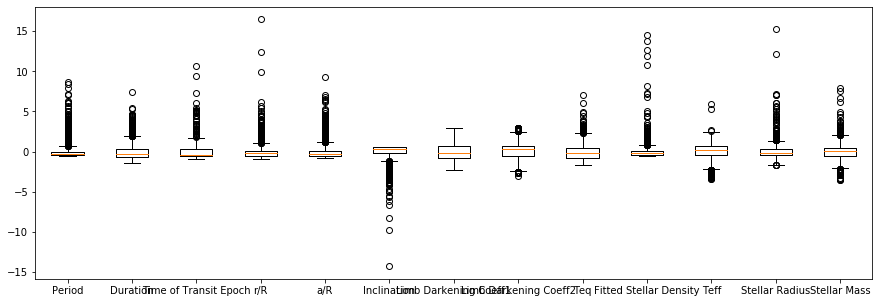

,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Limb Darkening Coeff1,Limb Darkening Coeff2,Teq,Fitted Stellar Density,Teff,Stellar Radius,Stellar Mass
count,1.610000e+03,1.610000e+03,1.610000e+03,1.610000e+03,1.610000e+03,1.610000e+03,1.610000e+03,1.610000e+03,1.610000e+03,1.610000e+03,1.610000e+03,1.610000e+03,1.610000e+03
mean,-3.054837e-17,7.499867e-16,5.907007e-15,-1.612582e-15,1.519764e-15,-6.772423e-14,-2.639779e-15,2.343305e-14,2.427320e-17,6.172502e-16,2.711427e-16,-2.270130e-15,3.242375e-15
std,1.000311e+00,1.000311e+00,1.000311e+00,1.000311e+00,1.000311e+00,1.000311e+00,1.000311e+00,1.000311e+00,1.000311e+00,1.000311e+00,1.000311e+00,1.000311e+00,1.000311e+00
min,-5.908227e-01,-1.450501e+00,-8.906004e-01,-8.851677e-01,-8.407552e-01,-1.431460e+01,-2.258535e+00,-3.089904e+00,-1.728111e+00,-5.335584e-01,-3.395382e+00,-1.703084e+00,-3.525412e+00
25%,-4.821600e-01,-6.703882e-01,-5.516610e-01,-5.040630e-01,-5.662212e-01,-1.426957e-01,-8.013483e-01,-5.591437e-01,-7.441942e-01,-4.219073e-01,-4.824721e-01,-4.884028e-01,-5.372881e-01
50%,-3.365976e-01,-2.669818e-01,-4.050554e-01,-2.076482e-01,-3.274285e-01,3.226130e-01,-1.761280e-01,2.596318e-01,-1.479202e-01,-2.298973e-01,1.926621e-01,-1.801033e-01,9.894913e-03
75%,-1.750069e-03,3.716218e-01,3.663228e-01,1.311116e-01,1.281076e-01,5.689991e-01,7.206023e-01,7.062367e-01,4.921406e-01,8.804824e-02,6.795483e-01,2.726248e-01,5.044431e-01
max,8.616681e+00,7.401561e+00,1.070401e+01,1.647627e+01,9.296306e+00,6.317726e-01,2.932537e+00,2.983921e+00,7.011231e+00,1.447999e+01,5.973887e+00,1.529320e+01,7.896348e+00


In [6]:
### boxplot de las variables..
plt.figure(figsize=(15,5))
plt.boxplot(Ystd_train)
plt.xticks(np.arange(len(metadata_used))+1,metadata_used)
plt.show()
aux_df = pd.DataFrame(Ystd_train)
aux_df.columns = metadata_used
aux_df.describe()

### Read light curves processed (detrended)

(8054, 71427)


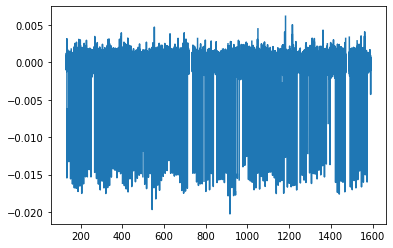

In [6]:
time_kepler = np.load(folder_lc+"npy/KOI_LC_time.npy")
#lc_kepler = np.load(folder_lc+"npy/KOI_LC_init.npy" )
process_lc = np.load(folder_lc+'/cleaned/LC_kepler_processed.npy')
N, T = time_kepler.shape
print((N,T))

plt.plot(time_kepler[0],process_lc[0])
plt.show()

time_kepler = time_kepler[mask_conf]
process_lc = process_lc[mask_conf]
N, T = time_kepler.shape
print((N,T))

In [7]:
#borrar nans... arreglo variable
coupled_lc = []
coupled_time = []
delta_time = []
for i in range(N):
    mask_nan_aux = np.isnan(process_lc[i])
    coupled_lc.append(process_lc[i][~mask_nan_aux])
    
    time = time_kepler[i][~mask_nan_aux]
    # calculate delta time --> this could be done after padding is done..
    delta_time.append(np.hstack([[0],np.diff(time)]))
    coupled_time.append(time)
    
coupled_lc = np.asarray(coupled_lc)
coupled_time = np.asarray(coupled_time)
delta_time = np.asarray(delta_time)
coupled_time

array([array([ 131.5127147,  131.5331494,  131.553584 , ..., 1590.9606391,
       1590.9810737, 1591.0015084]),
       array([ 352.3965737,  352.4374395,  352.4578724, ..., 1590.9606362,
       1590.9810707, 1591.0015055]),
       array([ 131.5944506,  131.6148853,  131.6353198, ..., 1590.9606445,
       1590.9810791, 1591.0015138]),
       ...,
       array([ 131.5119643,  131.5323986,  131.5528328, ..., 1590.9604946,
       1590.9809286, 1591.0013629]),
       array([ 131.5119643,  131.5323986,  131.5528328, ..., 1590.9604946,
       1590.9809286, 1591.0013629]),
       array([ 131.5119548,  131.532389 ,  131.5528232, ..., 1590.9604892,
       1590.9809233, 1591.0013576])], dtype=object)

#pre-process seleccionado

coupled_lc_scaled = []
for i in range(coupled_lc.shape[0]):
    std_i = coupled_lc[i].std(keepdims=True) #o std de todo
    
    coupled_lc_scaled.append( coupled_lc[i]/std_i )
coupled_lc_scaled = np.asarray(coupled_lc_scaled)
coupled_lc_scaled.shape

In [8]:
coupled_lc_scaled = coupled_lc

In [9]:
### data augm

flip_coupled_lc_scaled = []
flip_delta_time = []
flip_time = []
for i in range(coupled_lc.shape[0]):    
    flip_coupled_lc_scaled.append( coupled_lc_scaled[i][::-1] )
    flip_delta_time.append(  np.hstack([[0], delta_time[i][1:][::-1]]) )
    flip_time.append( coupled_time[i][0] + np.cumsum(flip_delta_time[-1]))
    
flip_coupled_lc_scaled = np.asarray(flip_coupled_lc_scaled)
flip_delta_time = np.asarray(flip_delta_time)
flip_time = np.asarray(flip_time)

delta_time = np.concatenate([delta_time, flip_delta_time])
coupled_lc_scaled = np.concatenate([coupled_lc_scaled, flip_coupled_lc_scaled])
coupled_time = np.concatenate([coupled_time, flip_time])

del flip_delta_time, flip_coupled_lc_scaled, flip_time
gc.collect()
coupled_lc_scaled.shape

(16108,)

### Folded

In [10]:
from fold import *

In [12]:
def folded_exampl(n):
    per, t0, dur = df_meta_obj[["Period", "Time of Transit Epoch","Duration"]].values[mask_conf][n]
    
    t = coupled_time[n][:]
    y = coupled_lc_scaled[n][:]

    #mask_nan = np.isnan(y)
    #t = t[~mask_nan]
    #y = y[~mask_nan]

    plt.plot(t, y, '.-')
    plt.show()

    t_fold, val_fold = phase_fold_and_sort_light_curve(t, y, period= per, t0= t0)

    plt.figure(figsize=(10,5))
    plt.plot(t_fold, val_fold, '.-')
    plt.title("folded")
    plt.show()

    plt.plot(t_fold)
    plt.show()
    
    t_glo = global_view(t_fold, val_fold, period=per, num_bins=1000, bin_width_factor=1 / 1000)
    
    plt.figure(figsize=(10,5))
    plt.plot(t_glo, '.-')
    plt.title("global view")
    plt.show()
    
    t_loc = local_view(t_fold, val_fold, period = per, duration=dur, num_bins=201, 
                       bin_width_factor=0.16,  num_durations=4)
    
    plt.figure(figsize=(10,5))
    plt.plot(t_loc, '.-')
    plt.title("local view")
    plt.show()

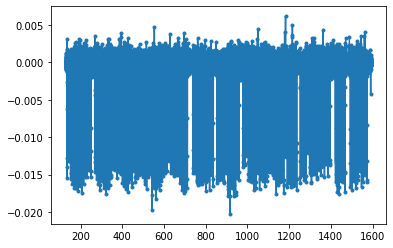

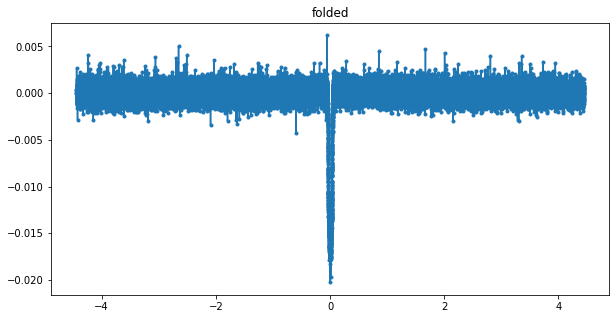

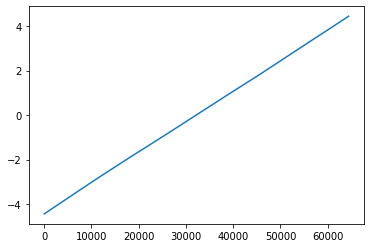

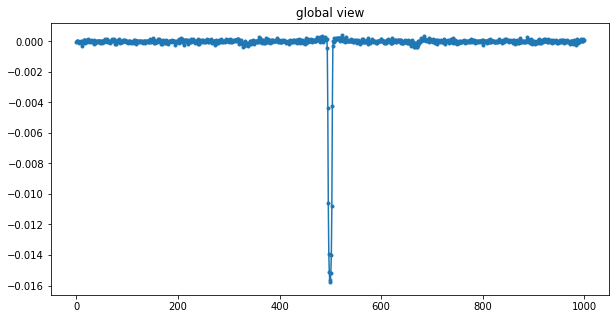

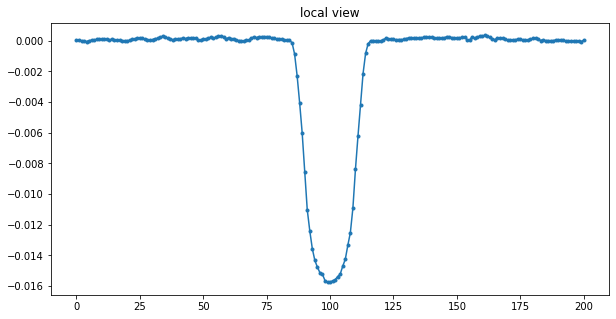

In [14]:
folded_exampl(0)

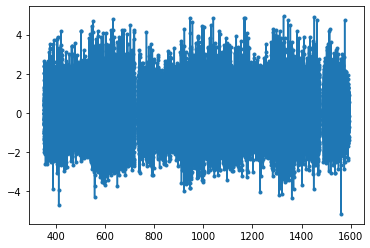

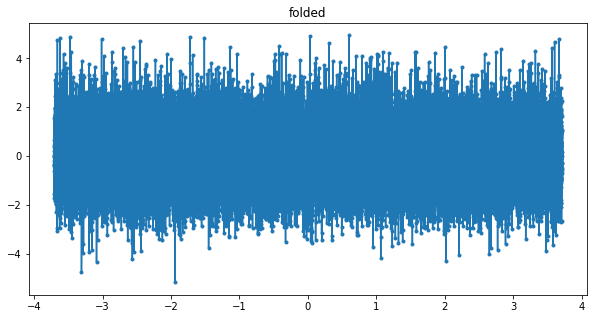

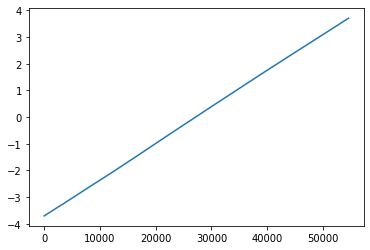

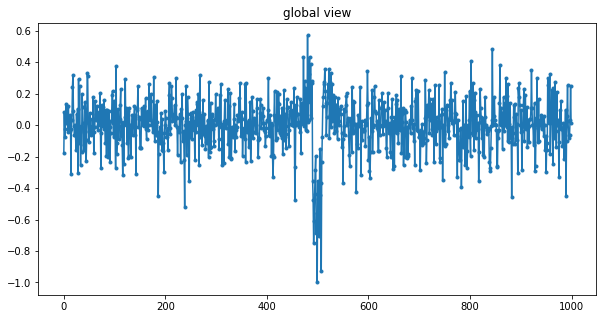

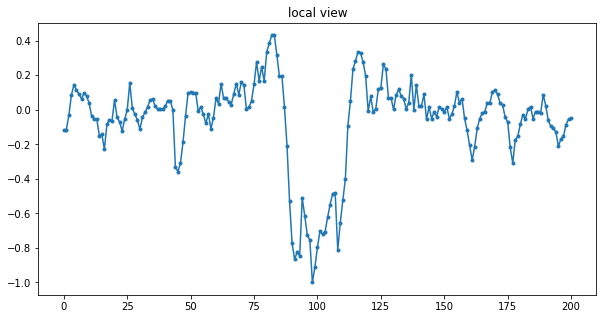

In [60]:
folded_exampl(5)

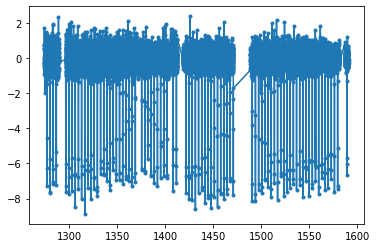

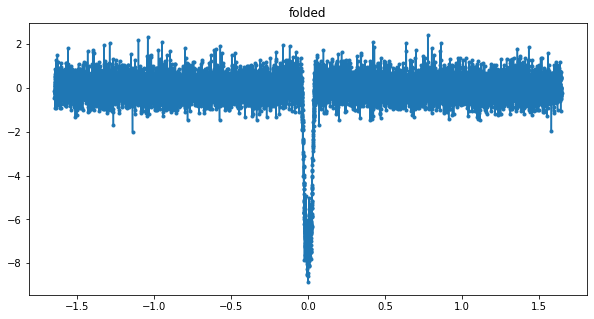

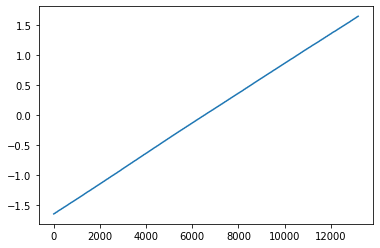

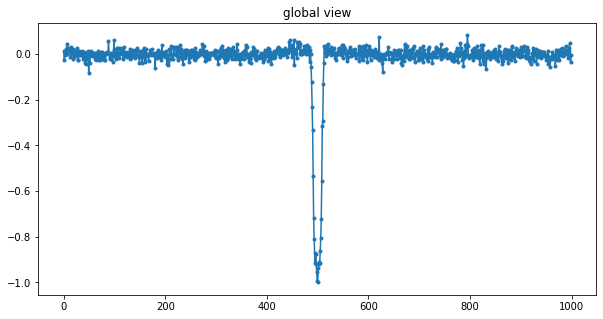

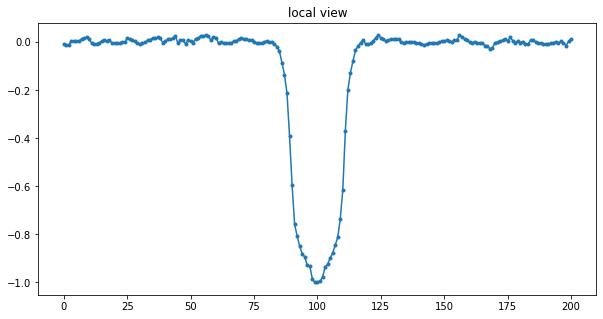

In [61]:
folded_exampl(9)

Dis score 0.999000, not transit flag 0.0 sec flag 0.0


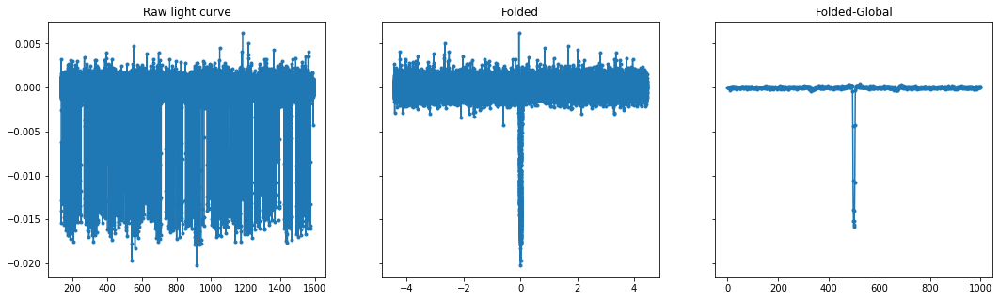

Max power:  0.01651041692909292
Second Max:  0.01629895050451847


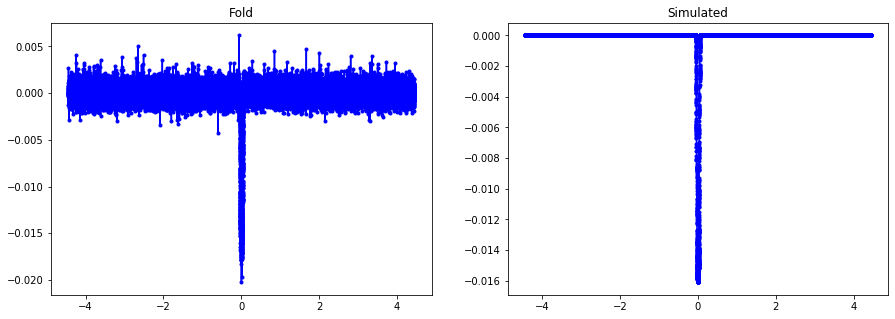

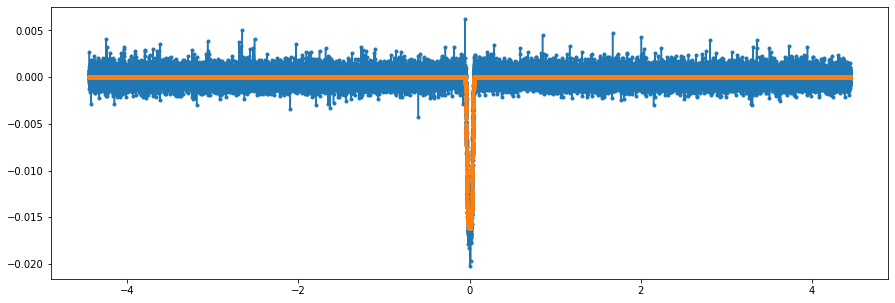

error en fold=  0.44638464955946544


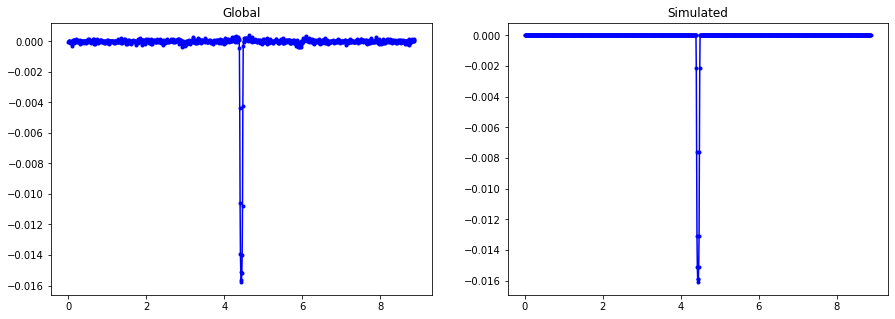

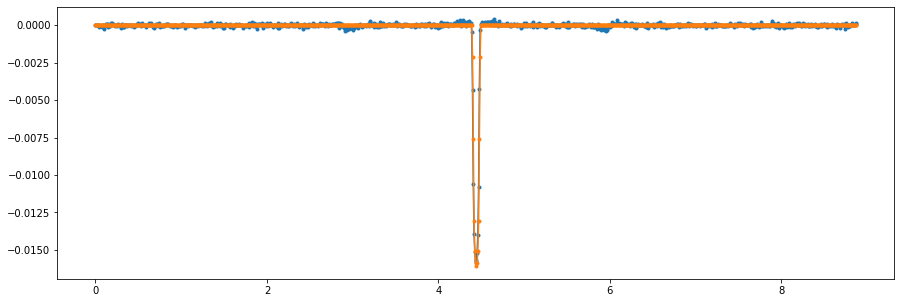

error en global=  0.16774346716884928
----------------------------------------------------------------
Dis score 0.000000, not transit flag 0.0 sec flag 0.0


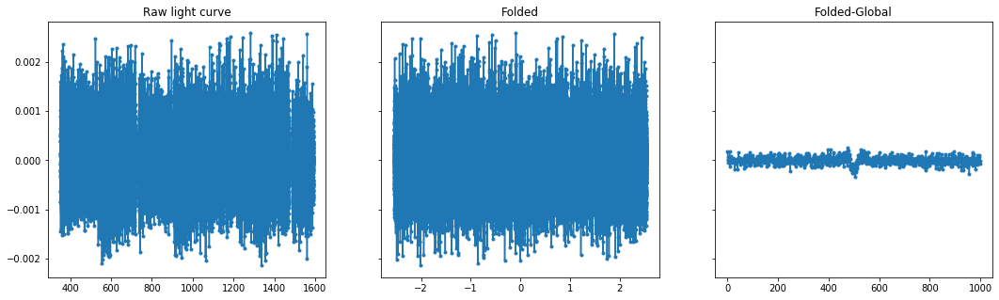

Max power:  0.0006483682012974057
Second Max:  0.0006326643548913594


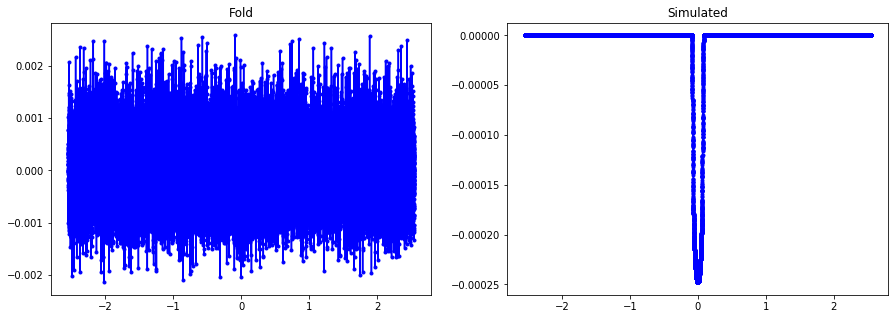

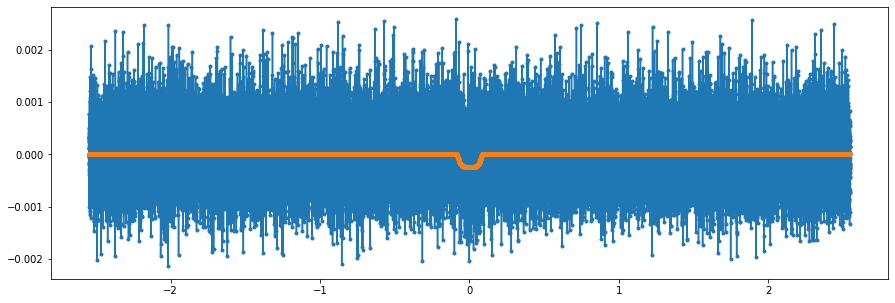

error en fold=  0.9991862642357472


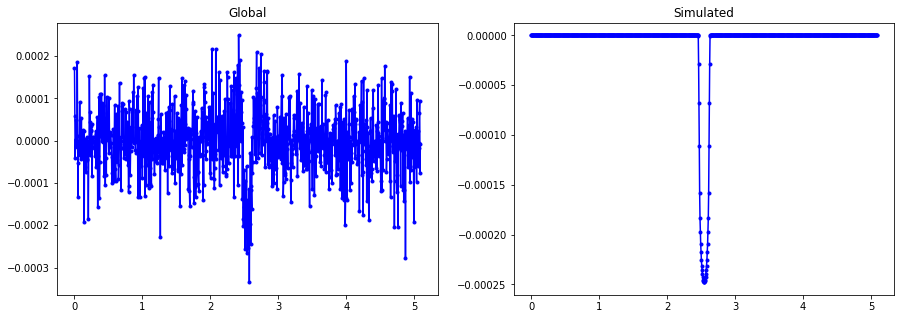

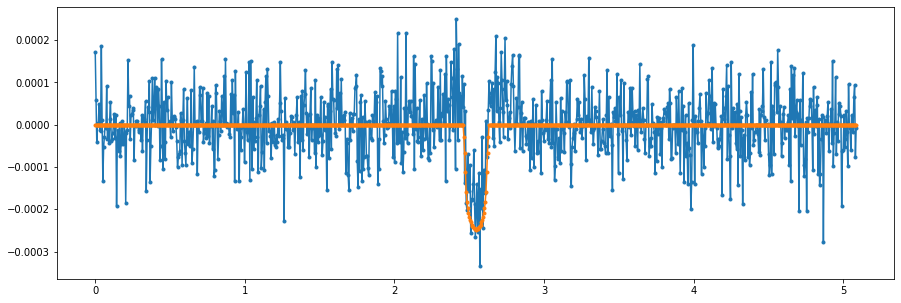

error en global=  0.9467179375635241
----------------------------------------------------------------
Dis score 0.000000, not transit flag 1.0 sec flag 0.0


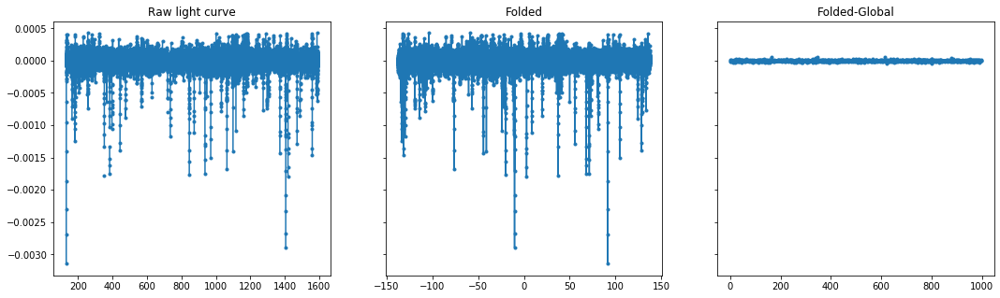

Max power:  0.002051330453735966
Second Max:  0.0020182015651735333


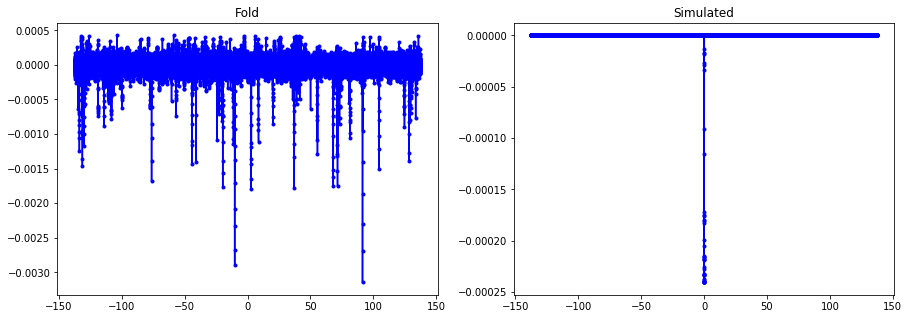

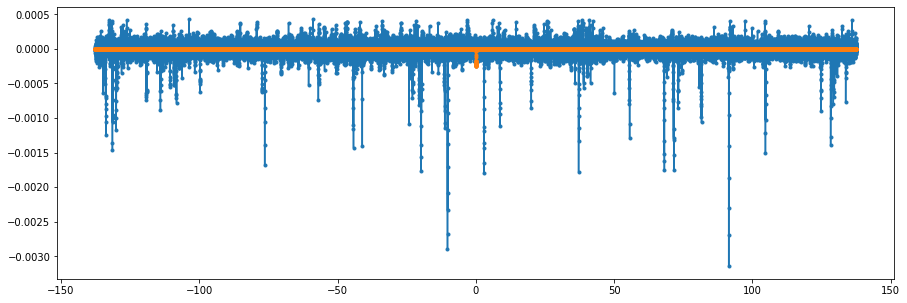

error en fold=  1.0009912711640052


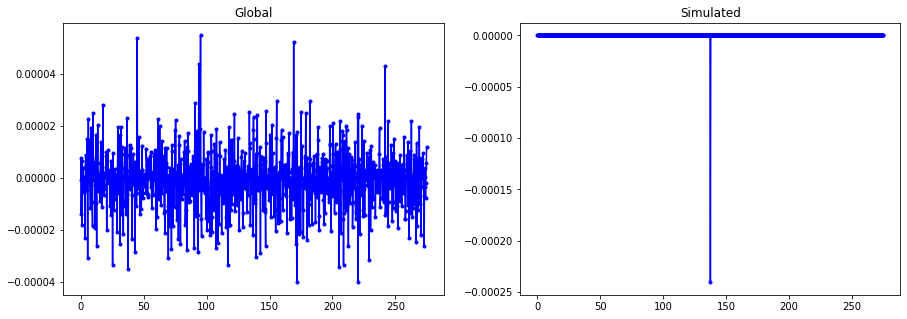

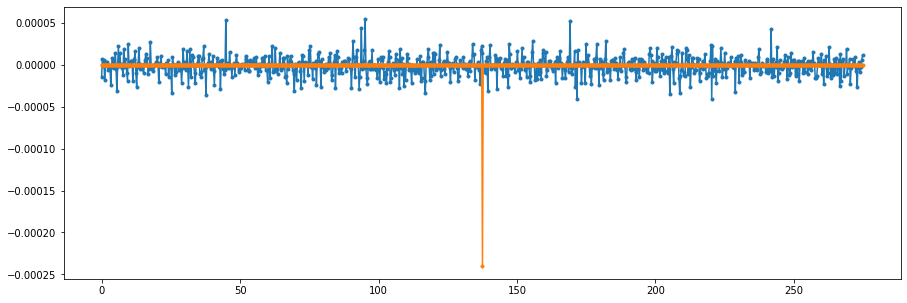

error en global=  1.24189700040365
----------------------------------------------------------------
Dis score 0.000000, not transit flag 0.0 sec flag 1.0


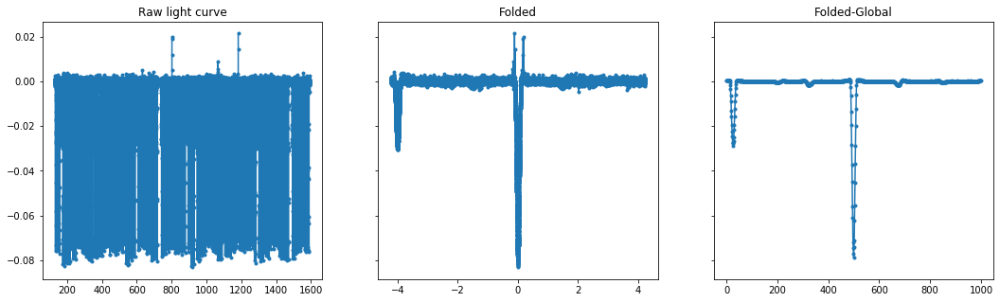

Max power:  0.051056663520437605
Second Max:  0.04993643100910115


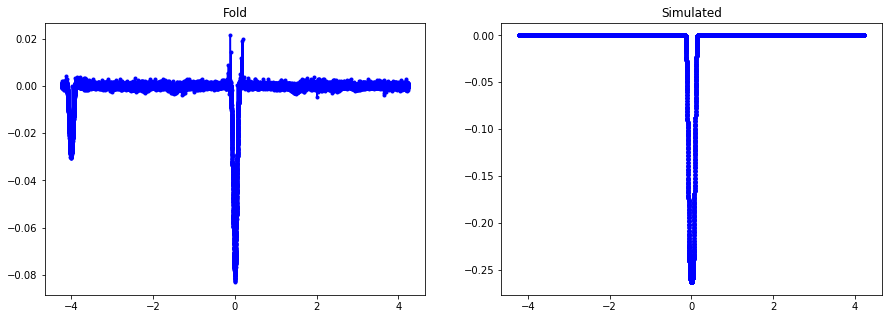

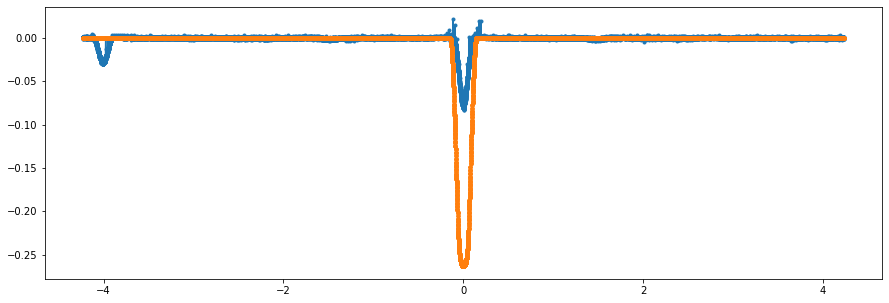

error en fold=  3.4103407221758504


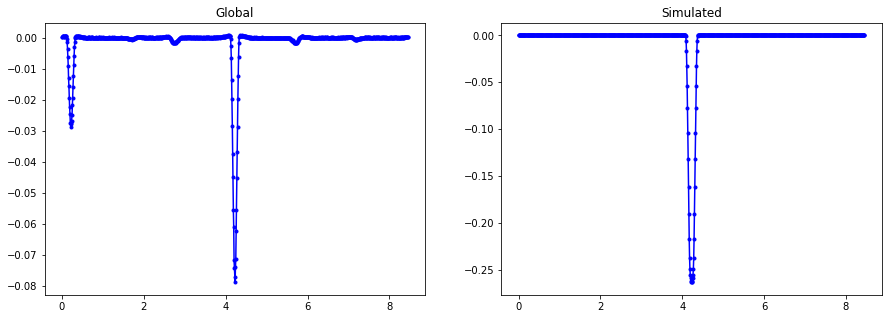

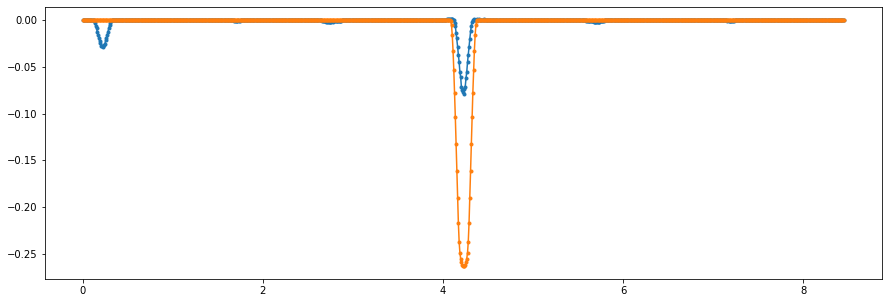

error en global=  3.3947226569410534
----------------------------------------------------------------
Dis score 1.000000, not transit flag 0.0 sec flag 0.0


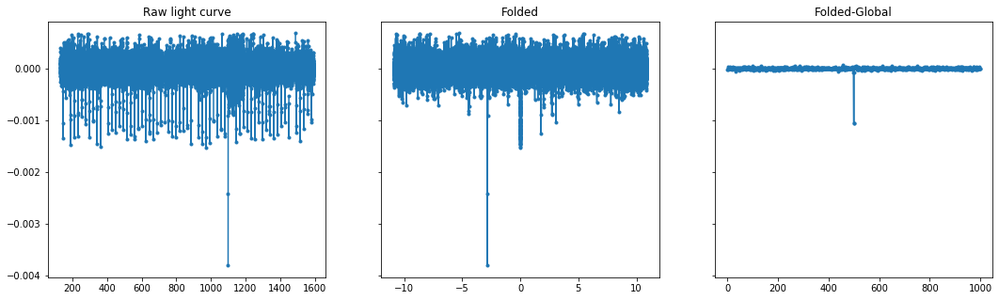

Max power:  0.0017397497971179195
Second Max:  0.0017266899322505656


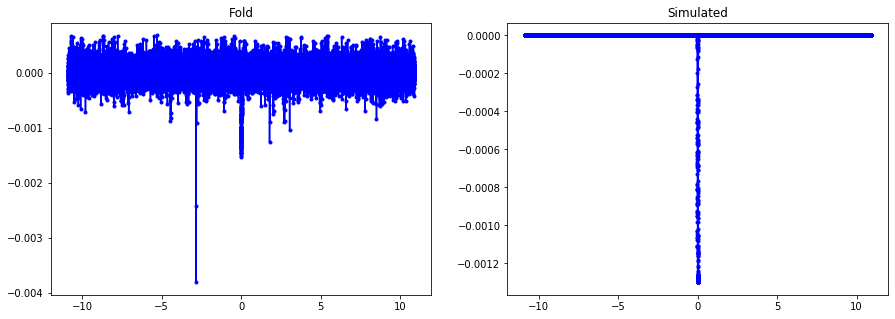

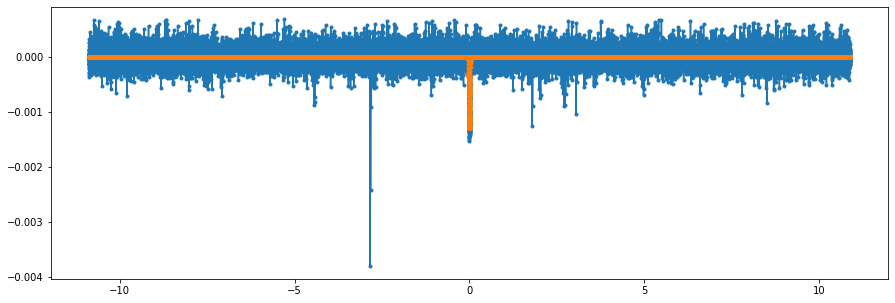

error en fold=  0.9295480041285176


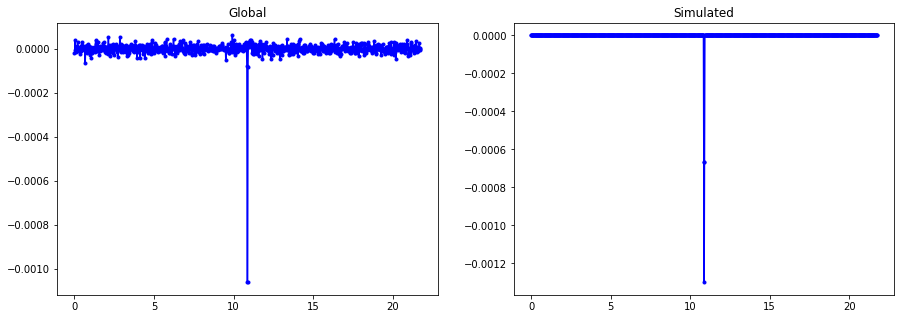

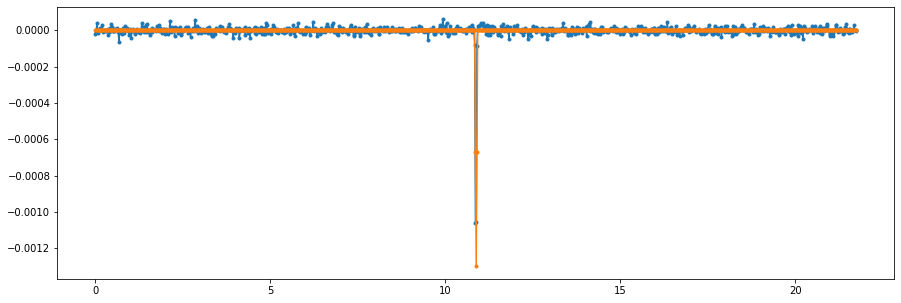

error en global=  0.5616590219329349
----------------------------------------------------------------
Dis score 0.711000, not transit flag 0.0 sec flag 0.0


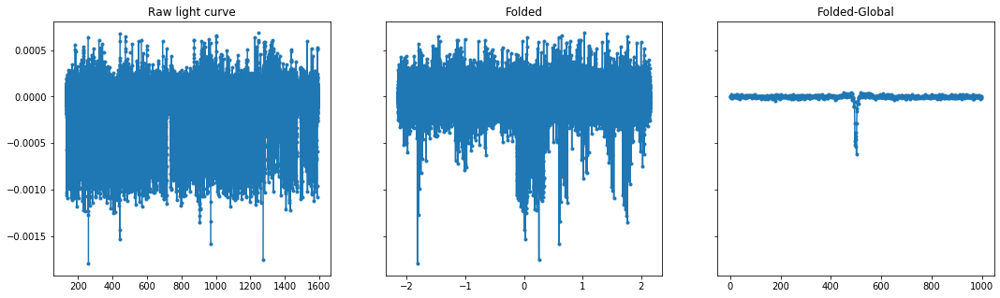

Max power:  0.009539617797954982
Second Max:  0.009181027667659332


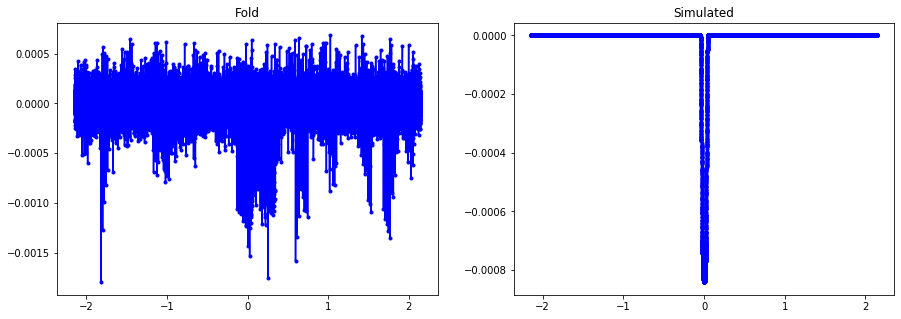

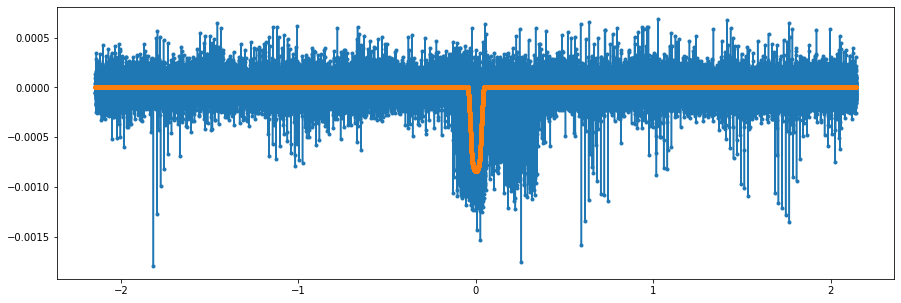

error en fold=  0.9683772505803664


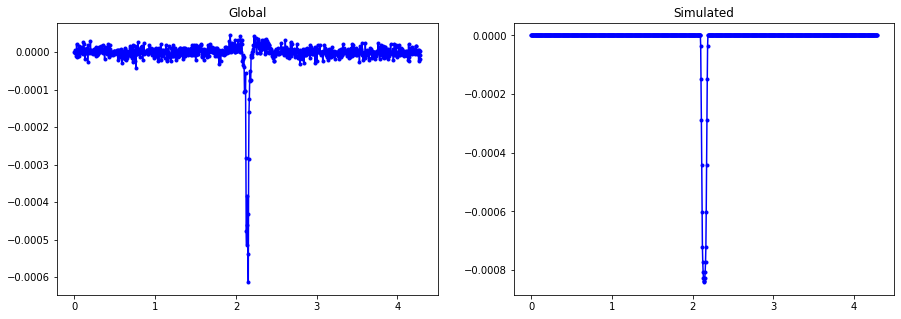

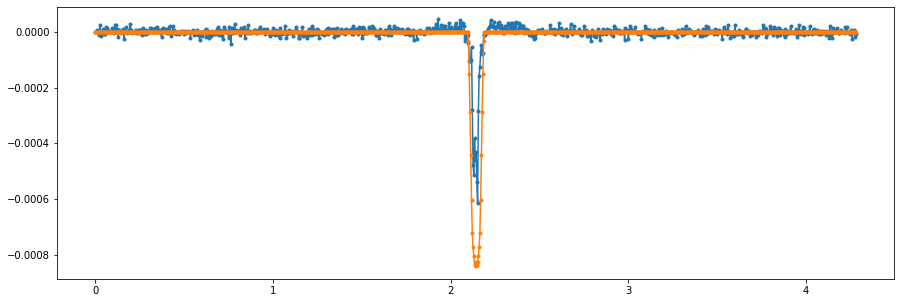

error en global=  1.2170465735507687
----------------------------------------------------------------
Dis score 0.000000, not transit flag 1.0 sec flag 0.0


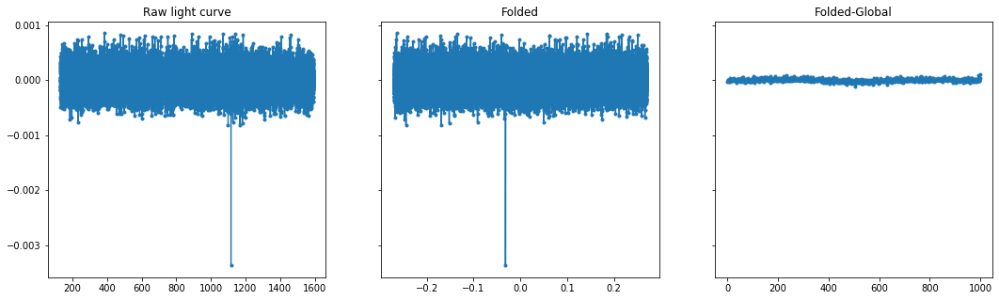

Max power:  0.005524835877858315
Second Max:  0.004967826138864129
ERROR, CURVA ELIMINADO DE INMEDIATO
Dis score 0.000000, not transit flag 0.0 sec flag 0.0


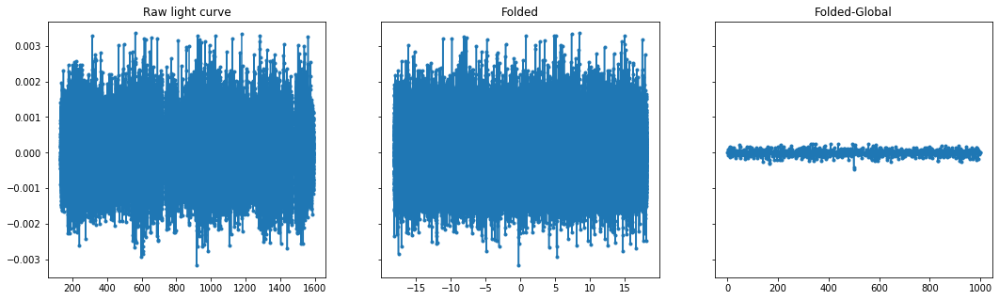

Max power:  0.0006349190499272646
Second Max:  0.0005906376869540984


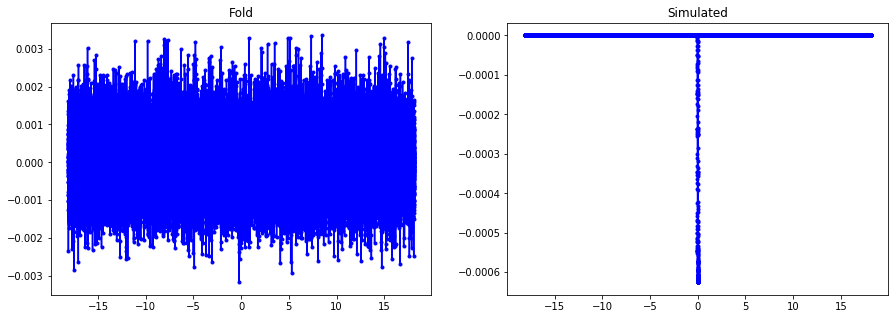

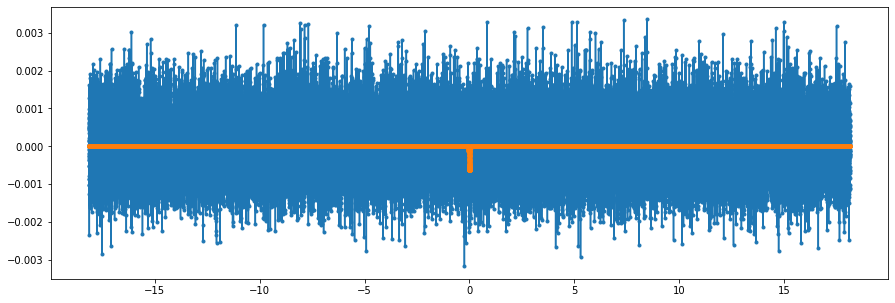

error en fold=  0.9996453766935064


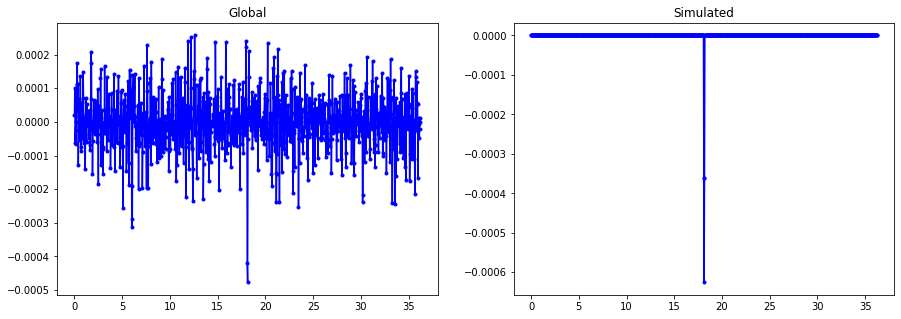

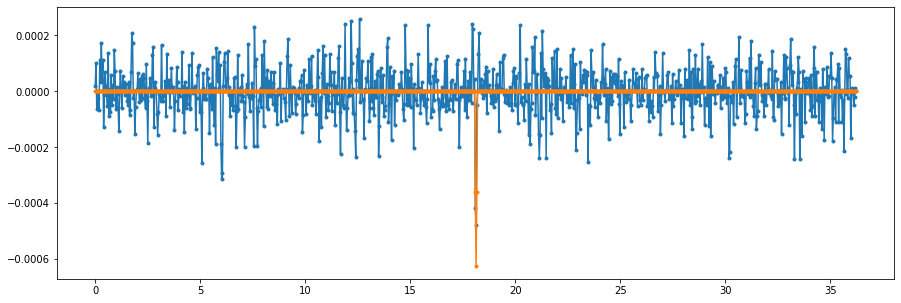

error en global=  0.9793635259391136
----------------------------------------------------------------
Dis score 0.990000, not transit flag 0.0 sec flag 0.0


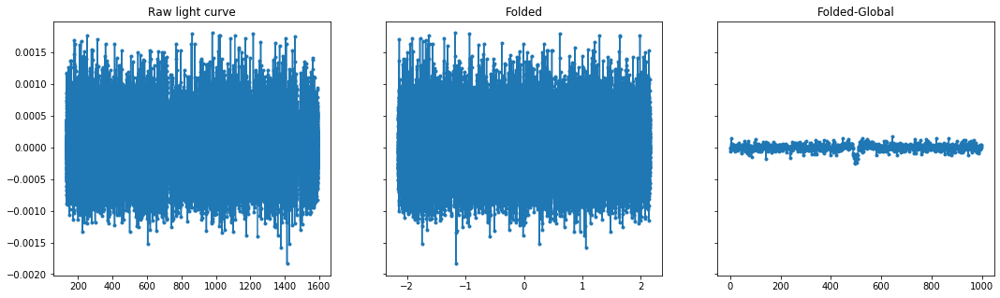

Max power:  0.0006735950004446992
Second Max:  0.0006616936664212258


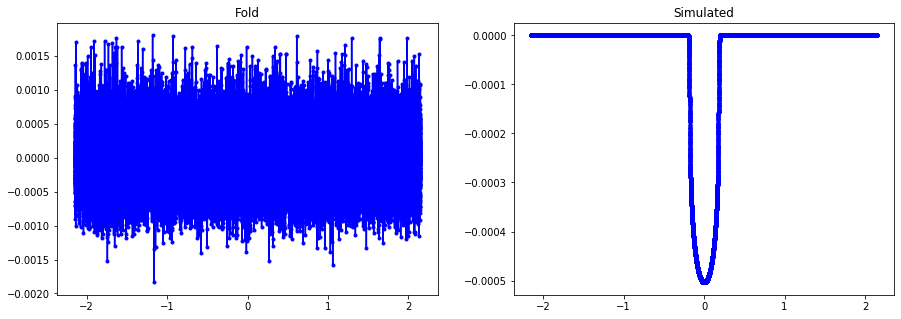

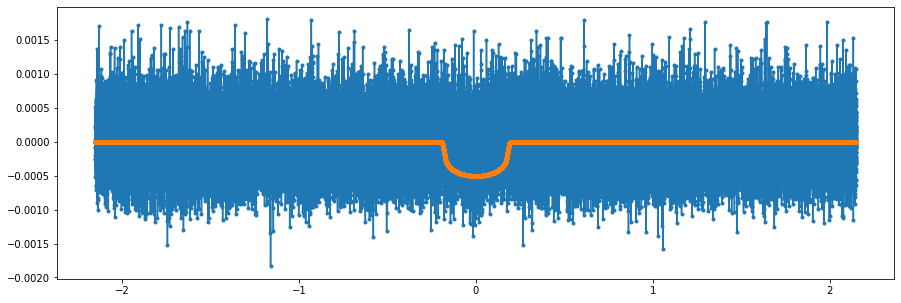

error en fold=  1.0575111346489647


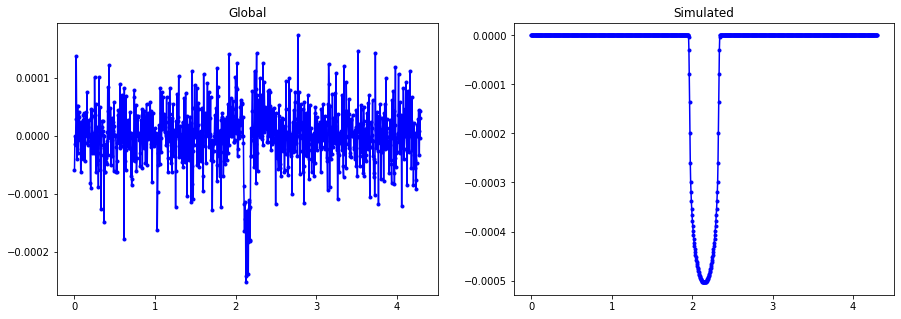

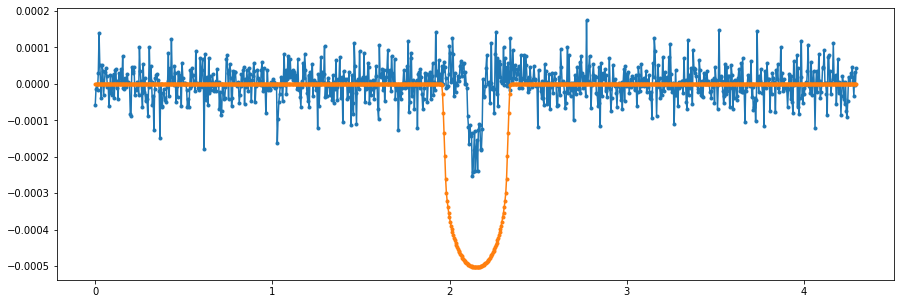

error en global=  2.6235731418762684
----------------------------------------------------------------
Dis score 0.000000, not transit flag 0.0 sec flag 1.0


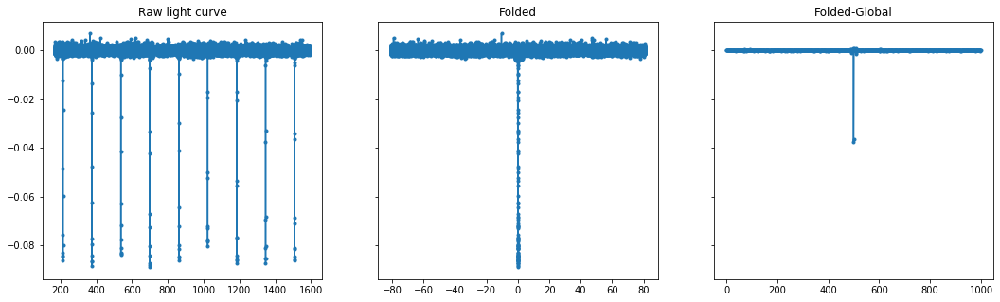

Max power:  0.002441208876449781
Second Max:  0.002425719489599352


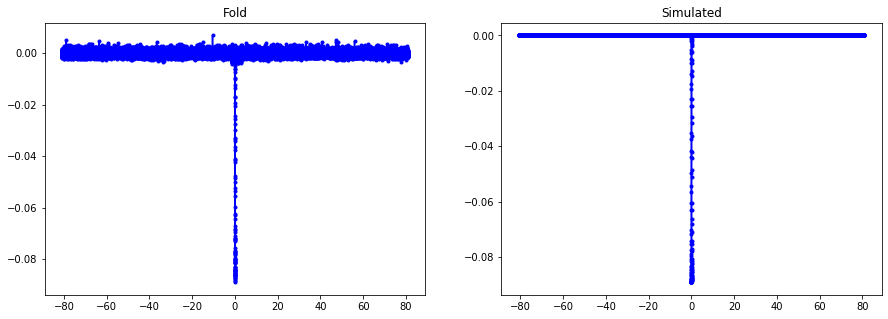

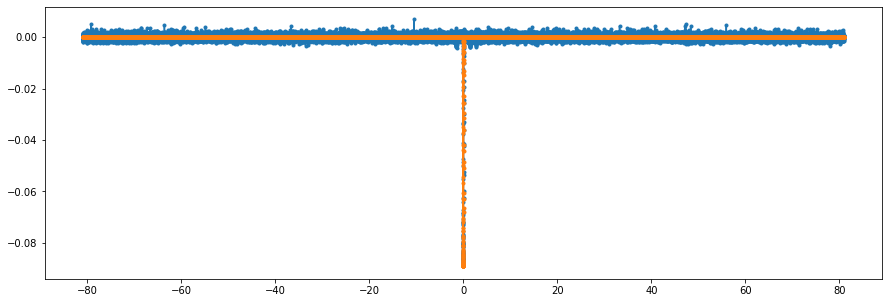

error en fold=  0.2879796961283174


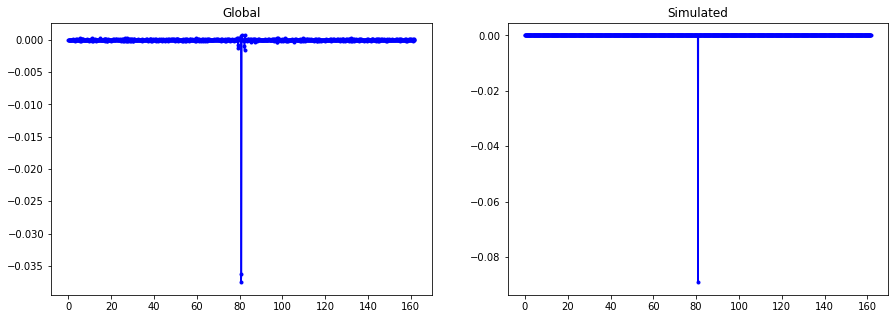

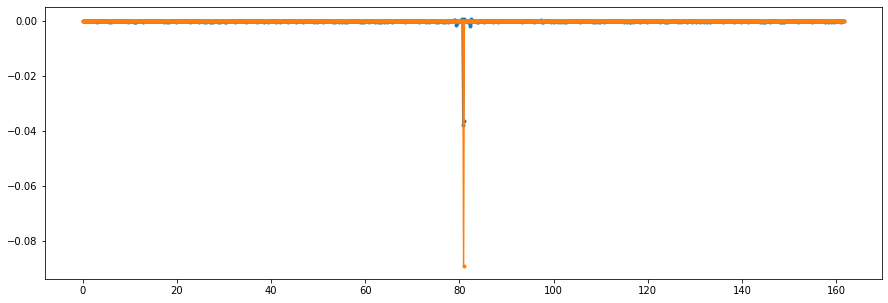

error en global=  1.2428837023085182
----------------------------------------------------------------
Dis score 0.848000, not transit flag 0.0 sec flag 0.0


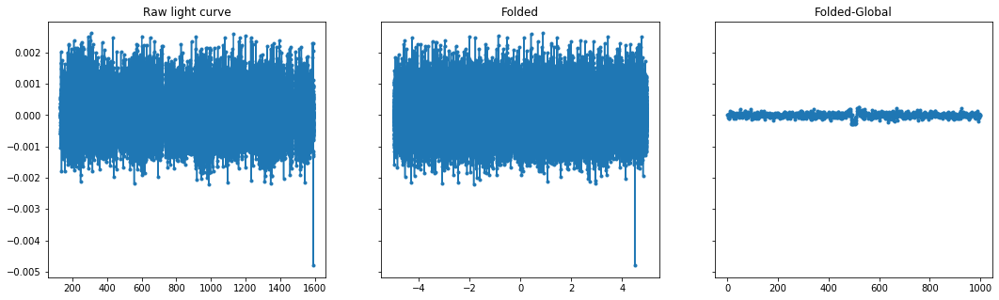

Max power:  0.0007378330366658628
Second Max:  0.0007249314177854135


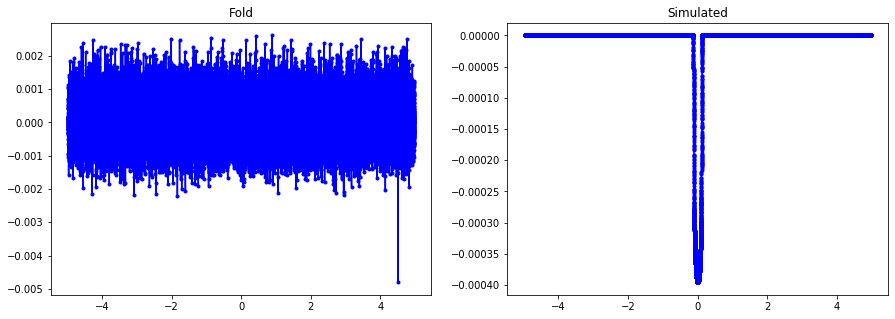

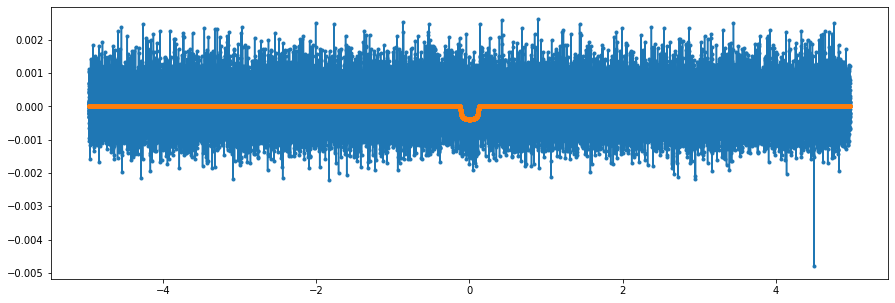

error en fold=  1.000027541625103


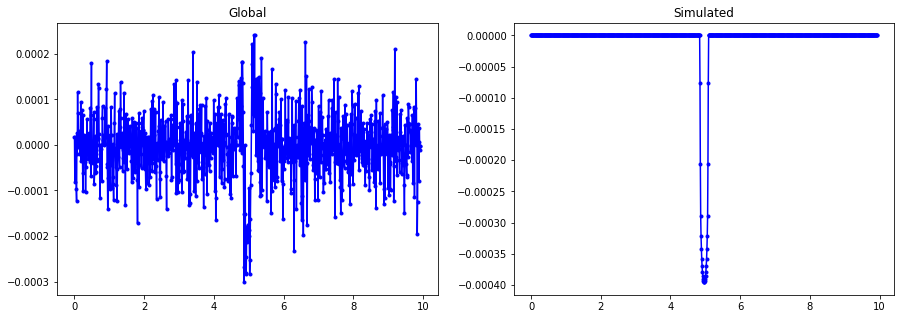

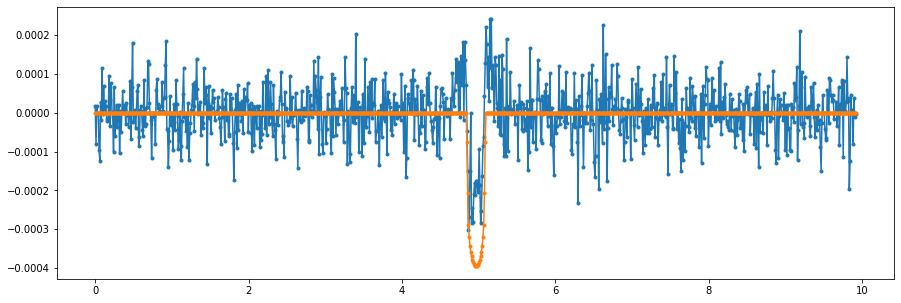

error en global=  0.9931752054454506
----------------------------------------------------------------
Dis score 0.961000, not transit flag 0.0 sec flag 0.0


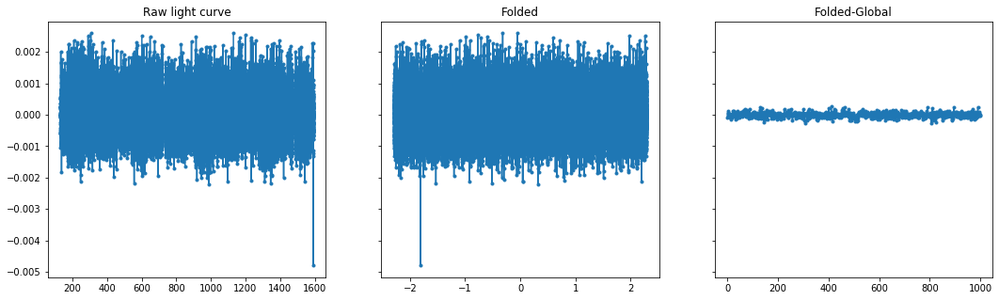

Max power:  0.0005774585565079944
Second Max:  0.000518196580738387


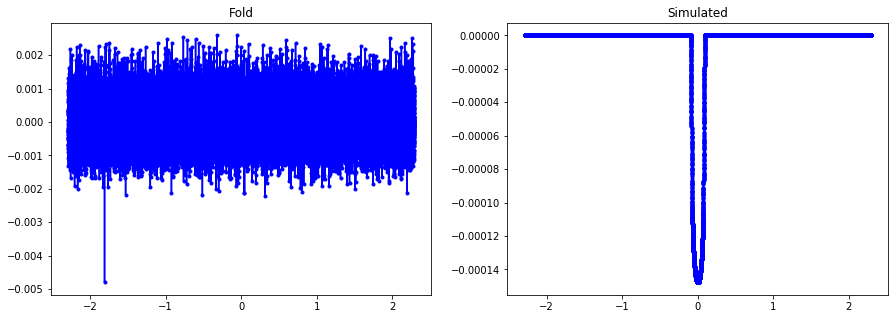

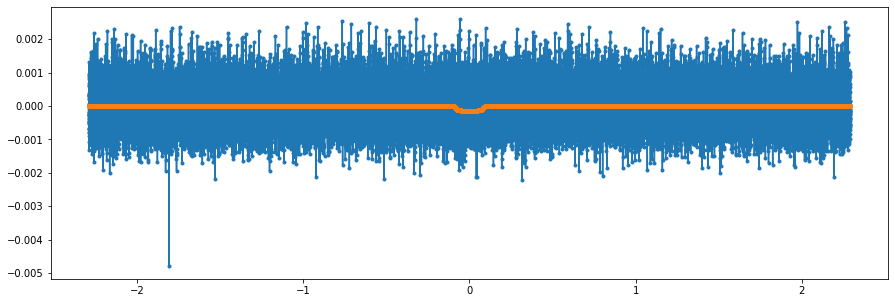

error en fold=  1.0002719013583765


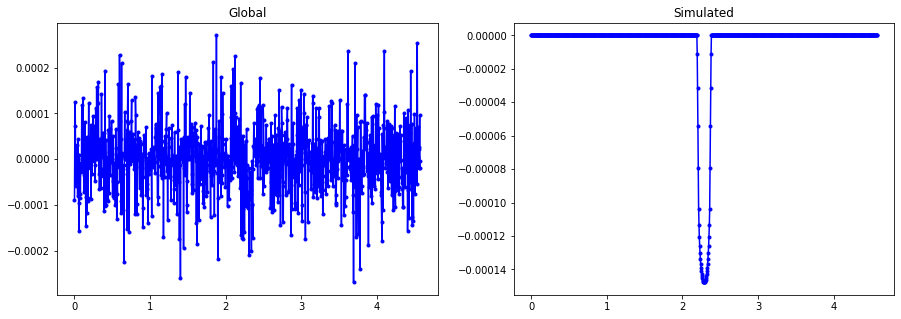

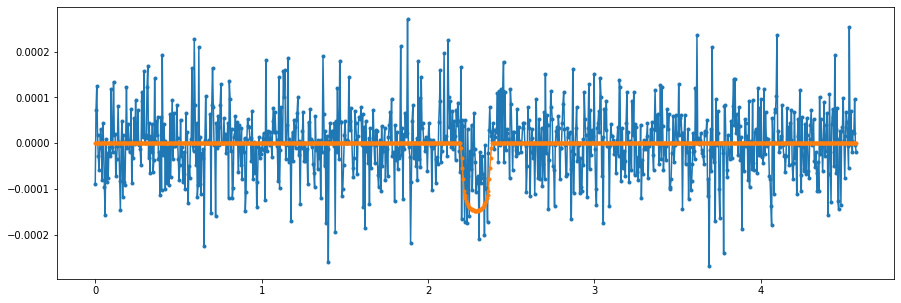

error en global=  1.0028943761941476
----------------------------------------------------------------
Dis score 0.000000, not transit flag 0.0 sec flag 1.0


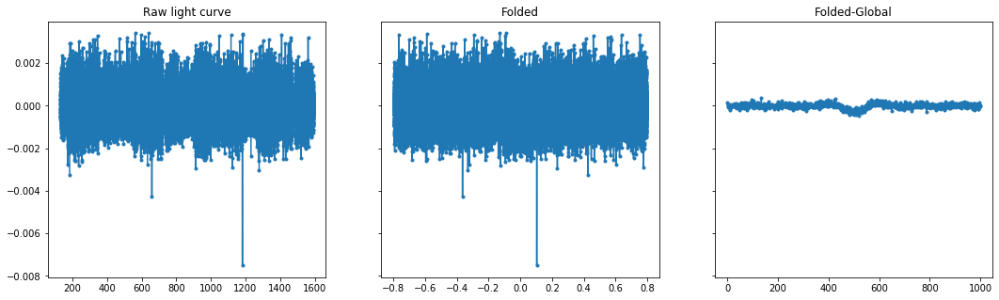

Max power:  0.0032573025205181708
Second Max:  0.003067494249560733


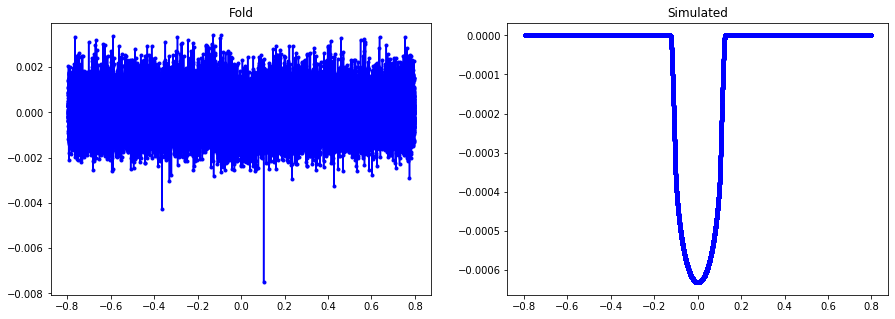

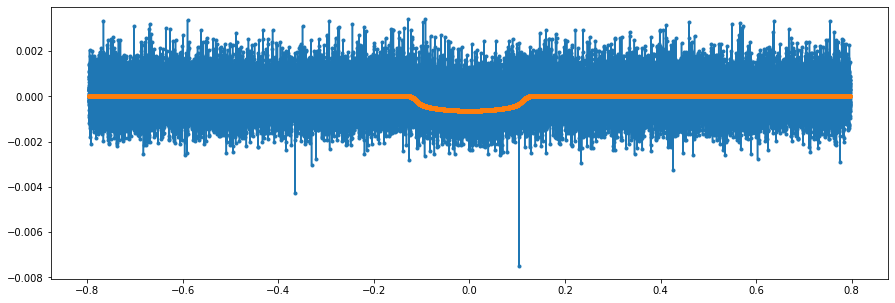

error en fold=  1.0194307703831524


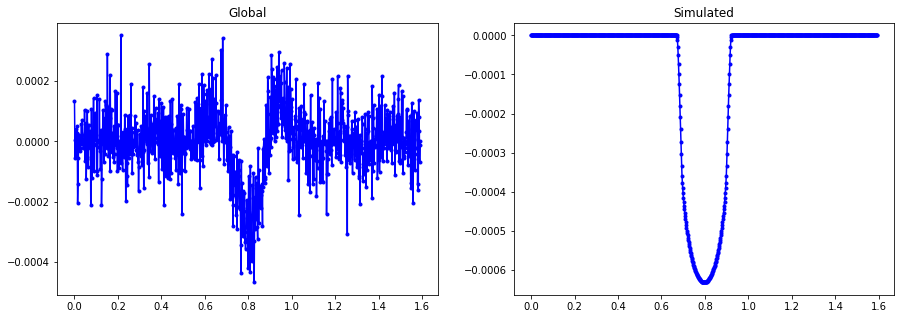

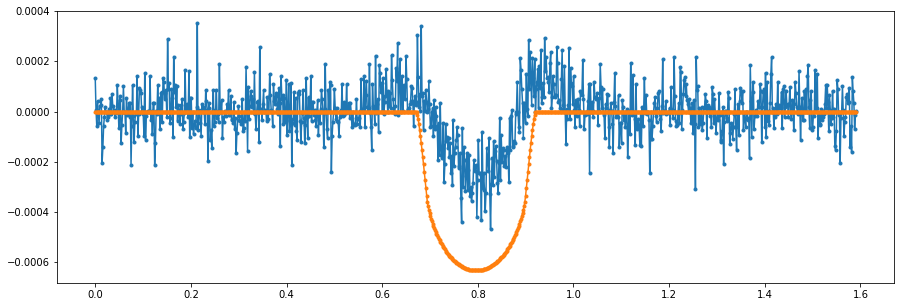

error en global=  1.5951818162394094
----------------------------------------------------------------
Dis score 0.000000, not transit flag 0.0 sec flag 1.0


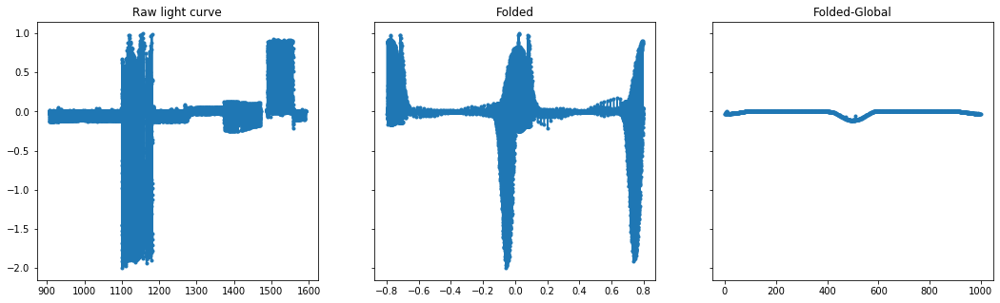

Max power:  0.05503674569438176
Second Max:  0.05332028598246893


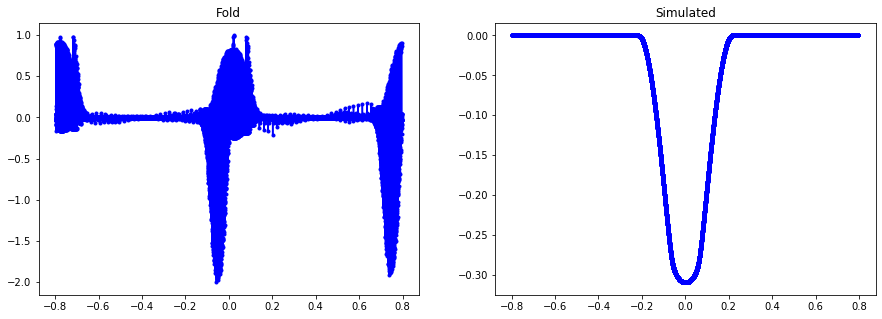

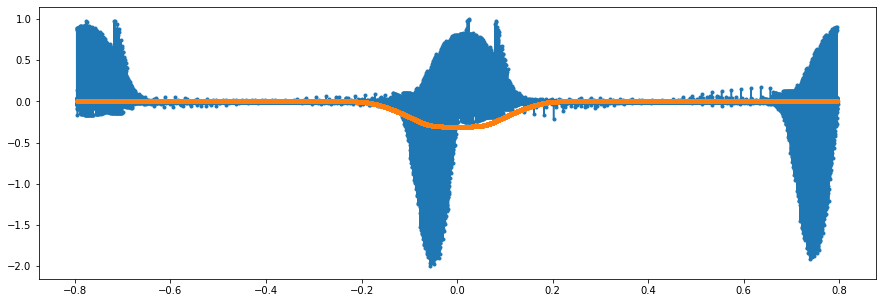

error en fold=  1.0744918490873367


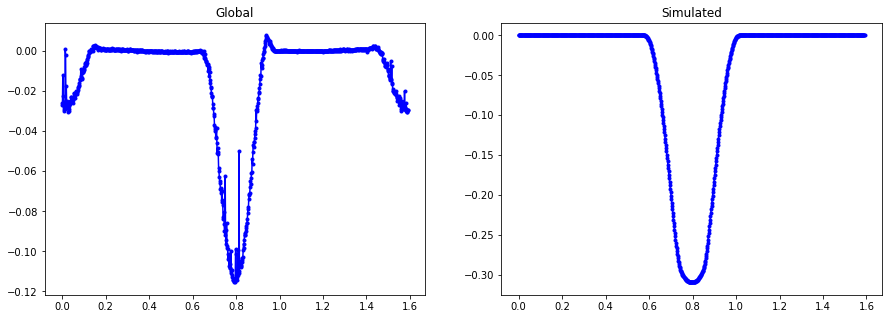

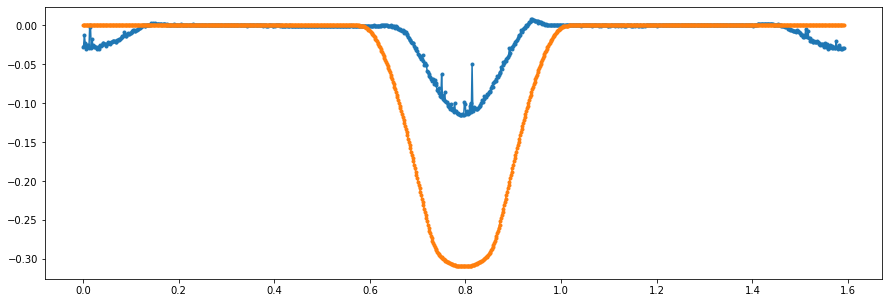

error en global=  2.7225541620494154
----------------------------------------------------------------
Dis score 0.014000, not transit flag 0.0 sec flag 0.0


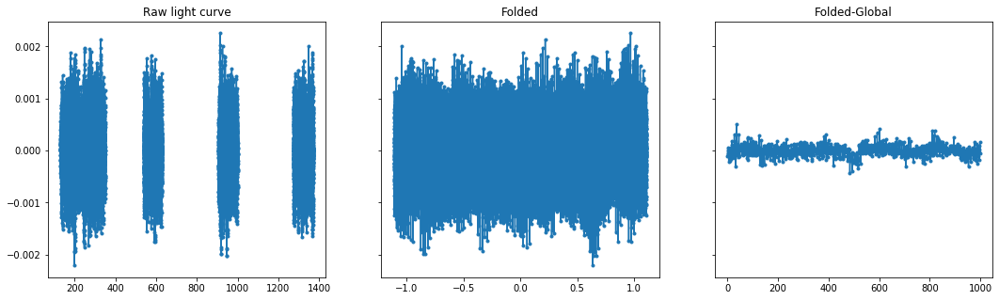

Max power:  0.019372655732853735
Second Max:  0.01662269214289748


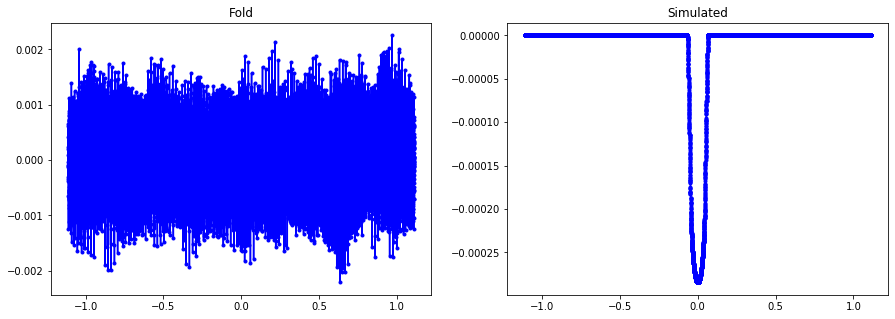

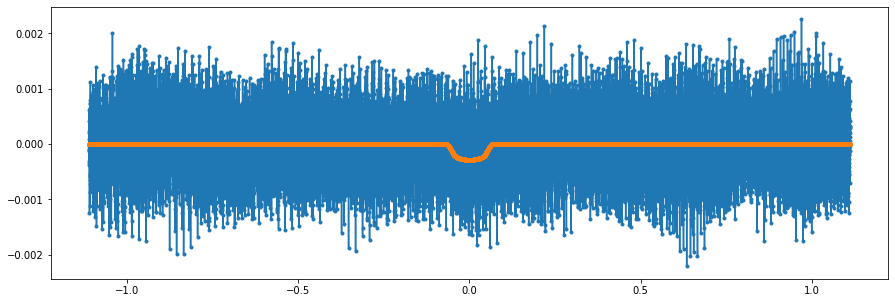

error en fold=  0.9979567694515884


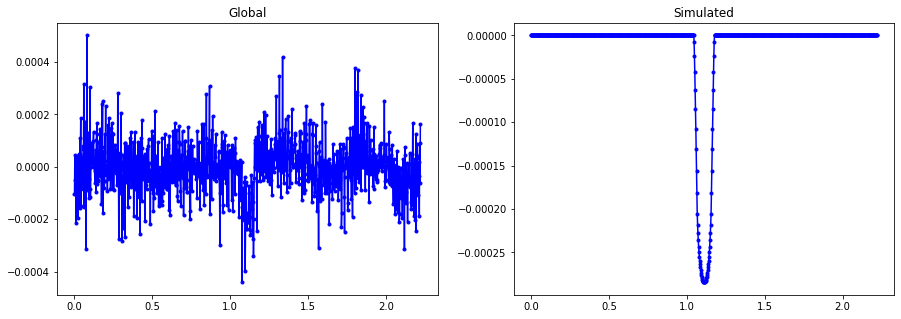

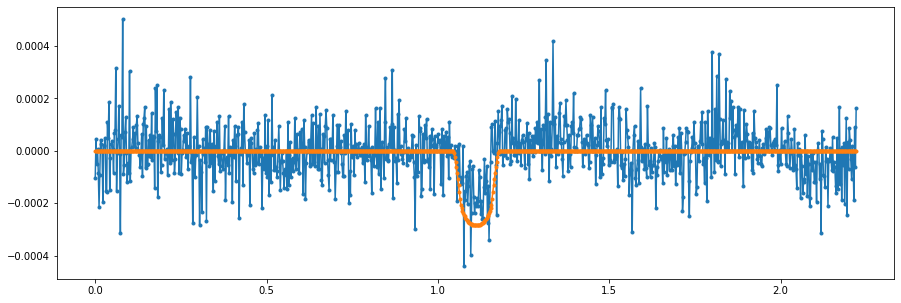

error en global=  0.9794204096761047
----------------------------------------------------------------
Dis score 0.004000, not transit flag 0.0 sec flag 1.0


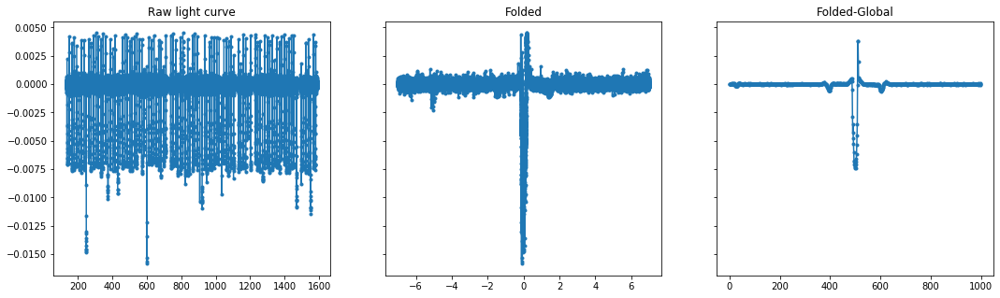

Max power:  0.033156710607891174
Second Max:  0.03301236173890698


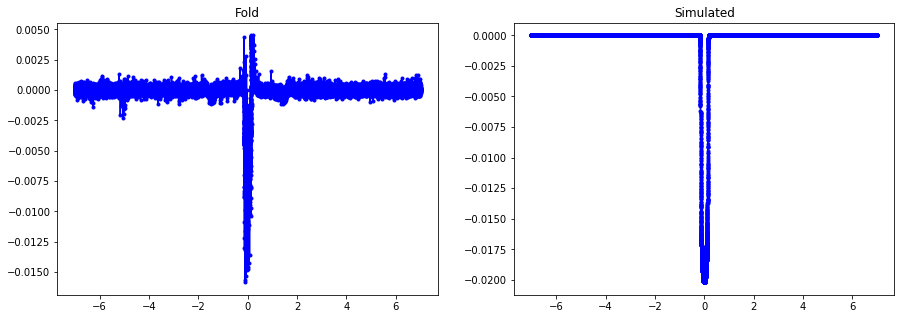

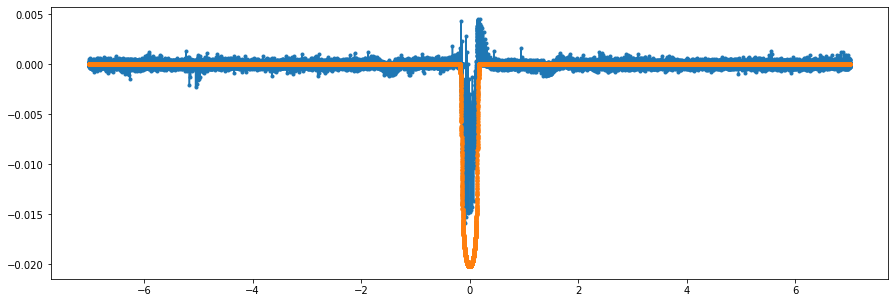

error en fold=  2.0555799215218338


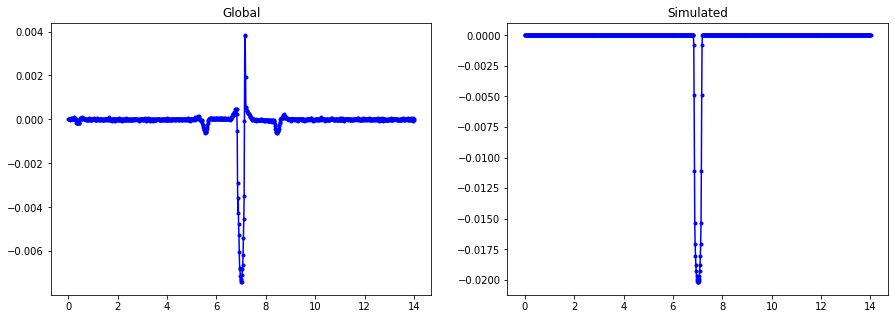

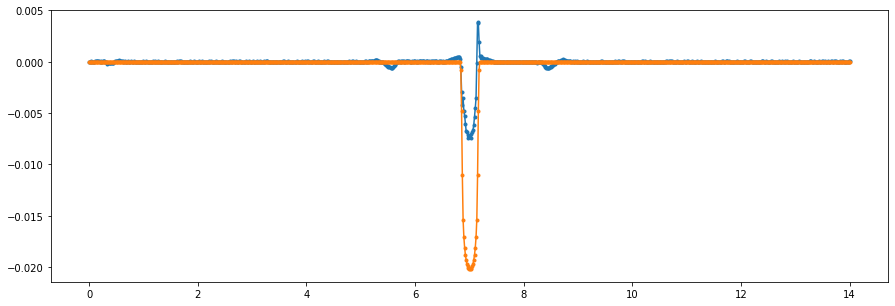

error en global=  2.178629367502311
----------------------------------------------------------------
Dis score 0.000000, not transit flag 0.0 sec flag 0.0


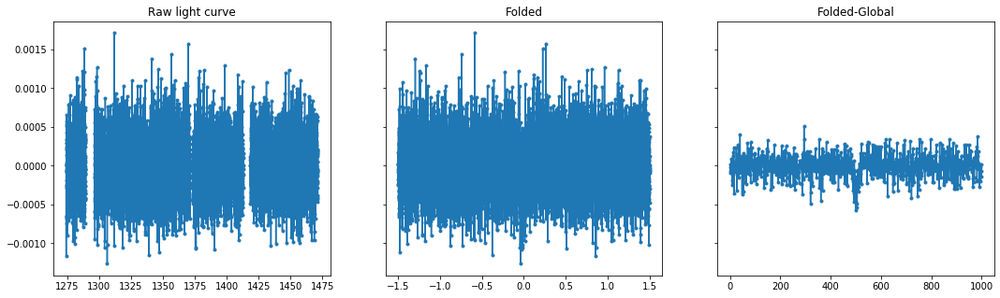

Max power:  0.003098188177176645
Second Max:  0.002922742996738641


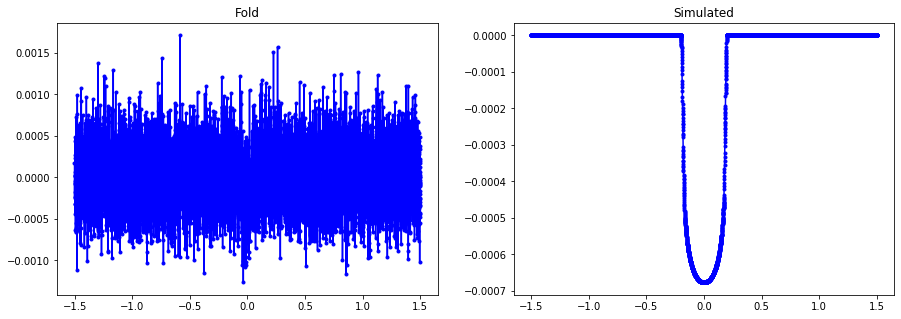

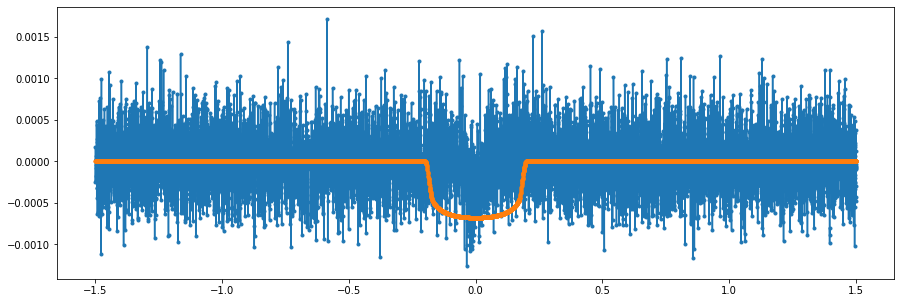

error en fold=  1.1664809402271534


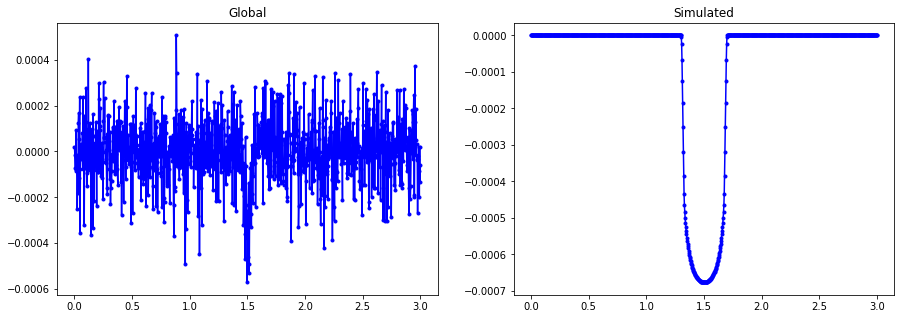

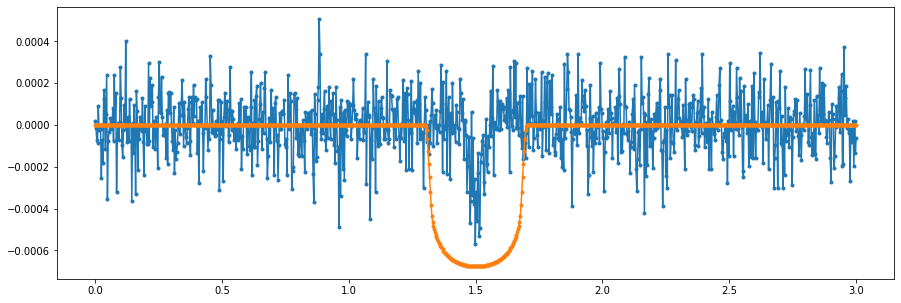

error en global=  1.7545998371418732
----------------------------------------------------------------
Dis score 0.000000, not transit flag 0.0 sec flag 1.0


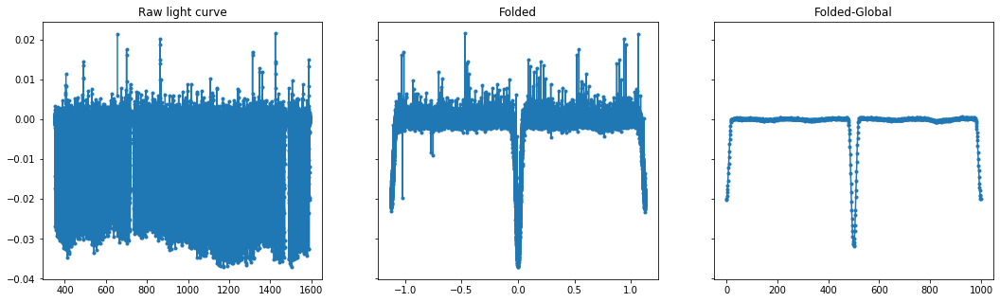

Max power:  0.11461868218600141
Second Max:  0.11410389245458238


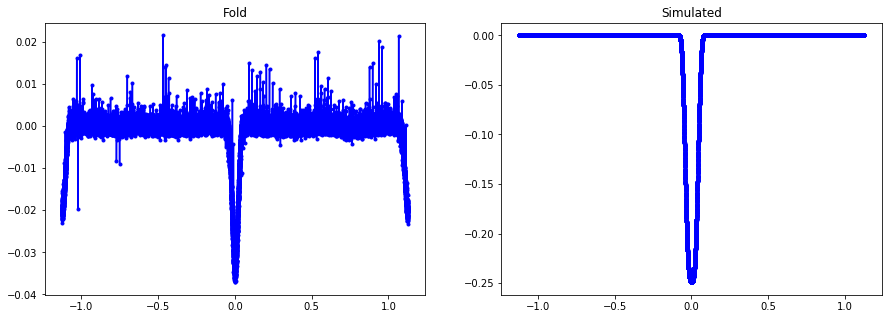

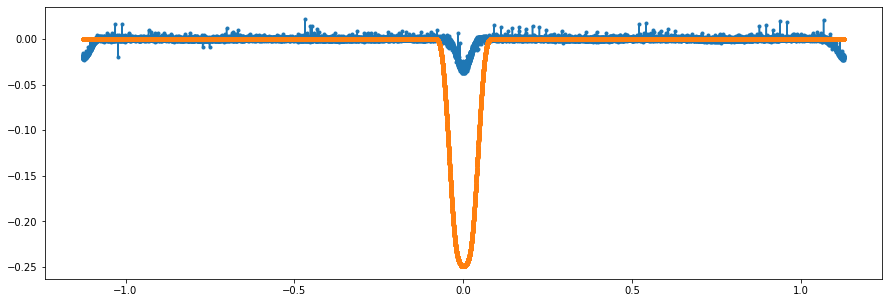

error en fold=  8.534093657938273


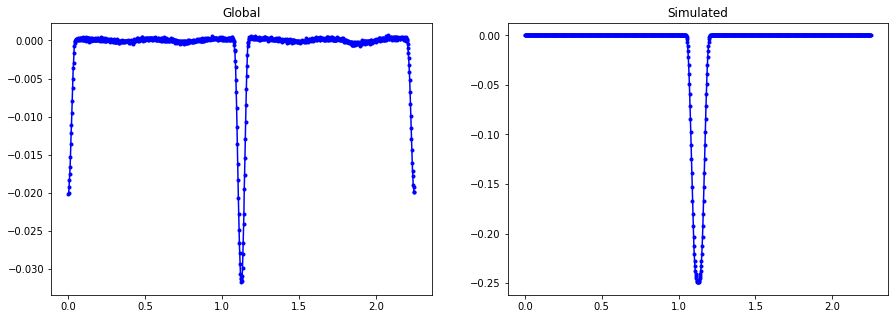

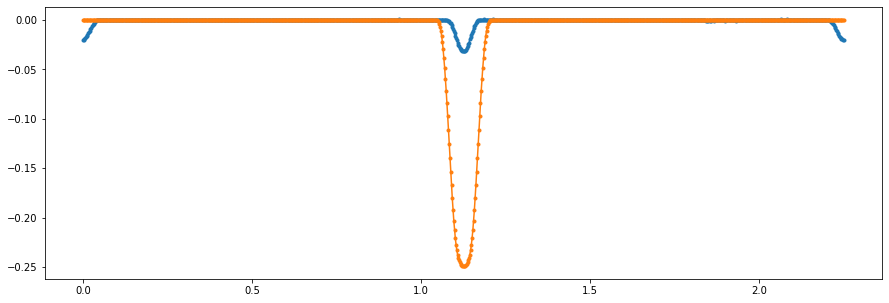

error en global=  8.772526785811728
----------------------------------------------------------------
Dis score 1.000000, not transit flag 0.0 sec flag 0.0


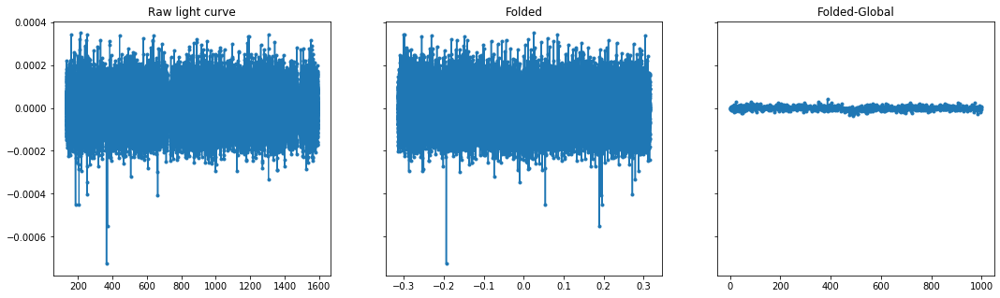

Max power:  0.0012081670513617389
Second Max:  0.0011419504862556543


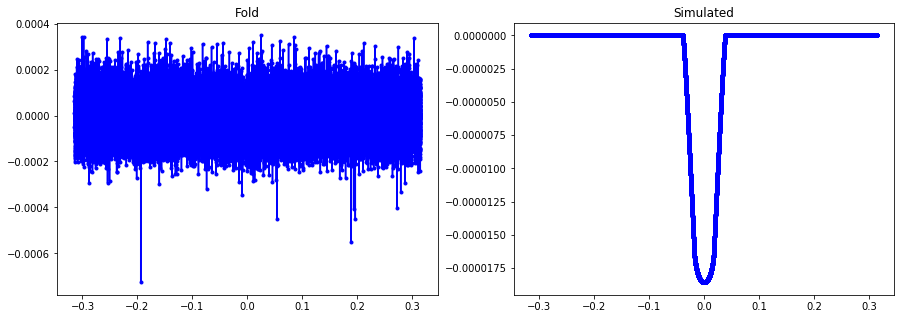

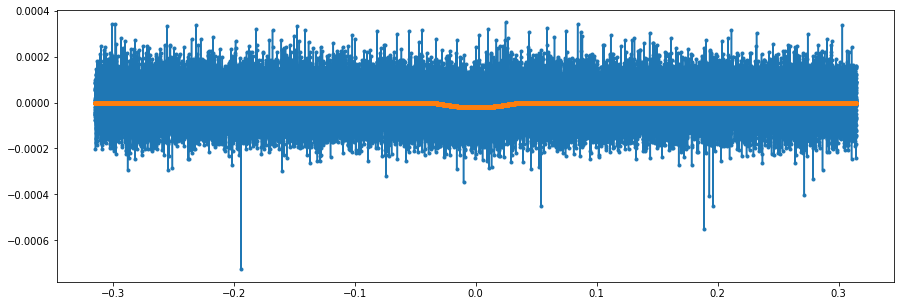

error en fold=  0.9992929381980348


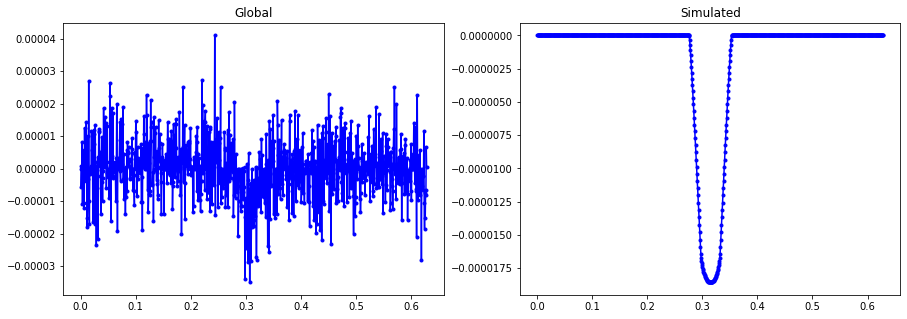

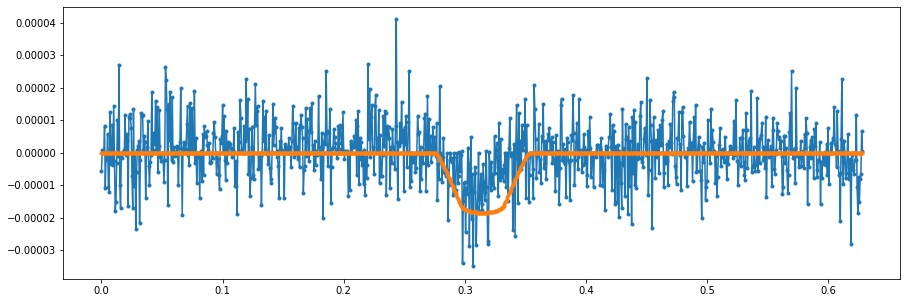

error en global=  0.9995560997114266
----------------------------------------------------------------
Dis score 1.000000, not transit flag 0.0 sec flag 0.0


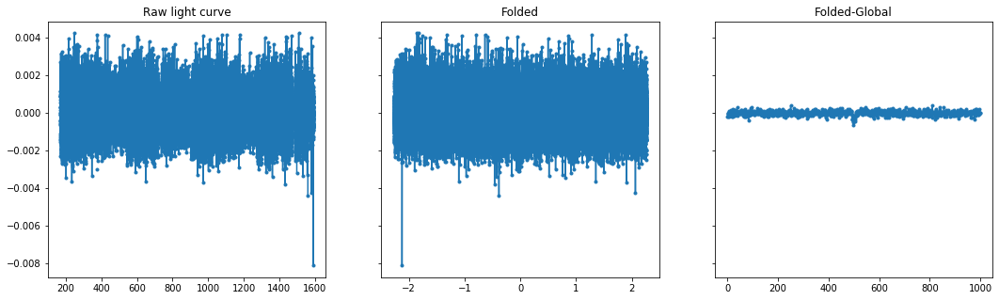

Max power:  0.0006973997199550415
Second Max:  0.0006766991205279238


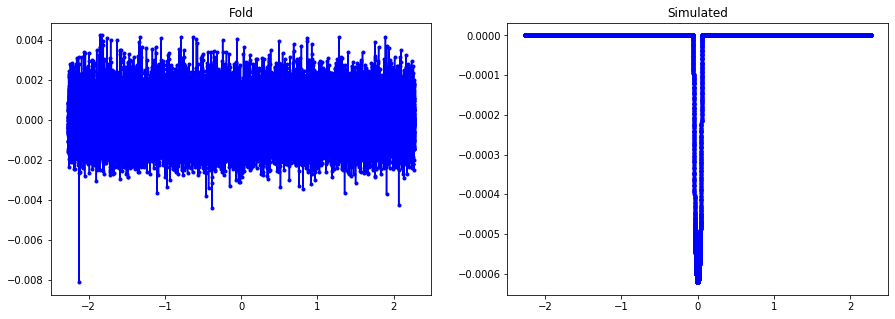

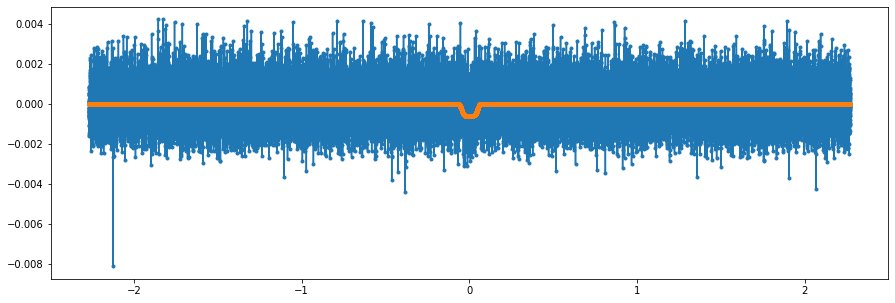

error en fold=  1.000463899095241


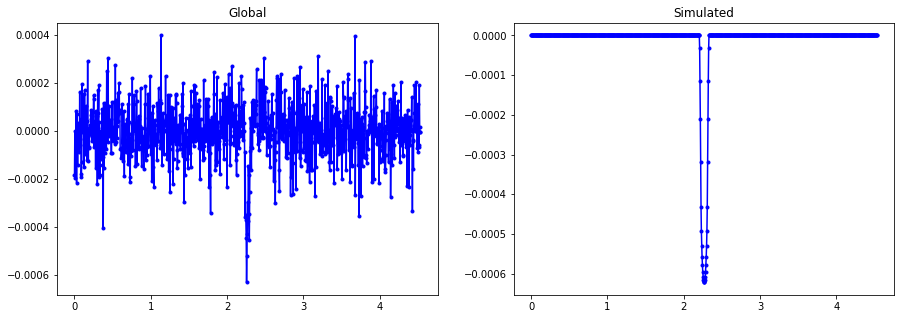

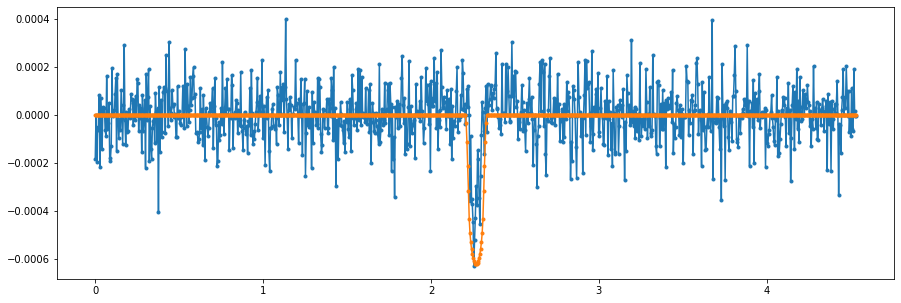

error en global=  1.0071467011349187
----------------------------------------------------------------
Dis score 0.858000, not transit flag 0.0 sec flag 0.0


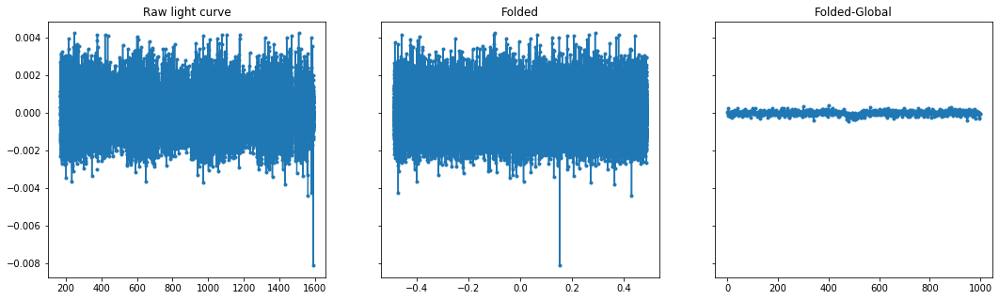

Max power:  0.0007223172441119813
Second Max:  0.0006991935155170176


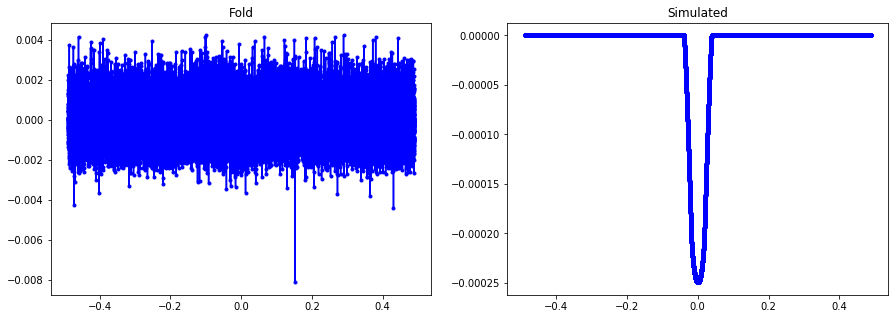

KeyboardInterrupt: 

In [17]:
from astropy.timeseries import BoxLeastSquares, LombScargle
import os, sys
dirpath = os.getcwd().split("code")[0]+"code/"
sys.path.append(dirpath)
from pre_process import *
import pysyzygy as ps


to = -1 #2000
T = 1000
for i in range(N):
    nflag, ds, sflag = df_meta[["Transit Flag","Disposition Score","Secondary Flag"]].values[i]
    
    print("Dis score %f, not transit flag %s sec flag %s"%(ds,nflag,sflag))
    #error de la curva real vs mandel agol? con librerias?
    
    f, axarr = plt.subplots(1,3, figsize=(18,5), sharey=True)
    
    axarr[0].plot(time_kepler[i][:to],process_lc[i][:to], '.-')
    axarr[0].set_title("Raw light curve")
    #plt.show()
    
    per, t0, dur = df_meta_obj[["Period", "Time of Transit Epoch","Duration"]].values[i]
    t = coupled_time[i]
    y = coupled_lc_scaled[i]

    t_fold, val_fold = phase_fold_and_sort_light_curve(t, y, period= per, t0= t0)

    val_glo = global_view(t_fold, val_fold, period=per, num_bins=T, bin_width_factor=1 / T)
    
    axarr[1].plot(t_fold, val_fold, '.-')
    axarr[1].set_title("Folded")
    #plt.show()
    
    axarr[2].plot(val_glo, '.-')
    axarr[2].set_title("Folded-Global")
    plt.show()
    
    
    model = LombScargle(t, y, center_data=False, fit_mean=True)
    freqs_t, periodogram = model.autopower(method='fast')
    periods_t = 1/freqs_t    
    val_s = np.sort(periodogram)[::-1]
    print("Max power: ",val_s[0])
    print("Second Max: ",val_s[1])
    plt.show()
    
    metadata_n = df_meta.iloc[i]
    period = metadata_n["Period"]
    duration = metadata_n["Duration"]/24
    a_R = metadata_n["a/R"]
    t_0 = 0 #trabajando con folds.. #metadata_n["Time of Transit Epoch"]-t[0] #start on 0
    r_R = metadata_n["r/R"]
    inclination = metadata_n["Inclination"]
    u1 = metadata_n["Limb Darkening Coeff1"]
    u2 = metadata_n["Limb Darkening Coeff2"]
    model = ps.Transit(per = period, RpRs = r_R, t0 = t_0, u1=u1,u2=u2, aRs= a_R, maxpts=65000) 
    try:
        lc_simulated = model(t_fold) #primer error/contratiempo encontrado (TIEMPO)
    except:
        print("ERROR, CURVA ELIMINADO DE INMEDIATO")
        continue
    
    #pre-process simualted
    #lc_simulated = process_found(lc_simulated, plot_show=False, divided=False)
    lc_simulated -=1 #approx the same..

    f, (ax1, ax2) = plt.subplots(1, 2, sharex=True,figsize= (15,5))
    ax1.plot(t_fold, val_fold , 'b.-')
    ax1.set_title("Fold")
    ax2.plot(t_fold, lc_simulated, 'b.-')
    ax2.set_title("Simulated")
    plt.show()

    plt.figure(figsize=(15,5))
    plt.plot(t_fold, val_fold , '.-')
    plt.plot(t_fold, lc_simulated, '.-')
    plt.show()
    
    mse_resid = np.sqrt(np.nanmean(np.square(val_fold - lc_simulated)))
    mse_resid /= np.std(val_fold)
    print("error en fold= ",mse_resid)

    
    t_glo = np.cumsum(np.concatenate([[0], np.tile(per/T, T-1)]) )
    t_0 = t_glo[int(np.round(T/2))]
    model = ps.Transit(per = period, RpRs = r_R, t0 = t_0, u1=u1,u2=u2, aRs= a_R, maxpts=65000) 
    lc_simulated = model(t_glo)-1 
    
    f, (ax1, ax2) = plt.subplots(1, 2, sharex=True,figsize= (15,5))
    ax1.plot(t_glo, val_glo , 'b.-')
    ax1.set_title("Global")
    ax2.plot(t_glo, lc_simulated, 'b.-')
    ax2.set_title("Simulated")
    plt.show()

    plt.figure(figsize=(15,5))
    plt.plot(t_glo, val_glo , '.-')
    plt.plot(t_glo, lc_simulated, '.-')
    plt.show() 
    
    mse_resid = np.sqrt(np.nanmean(np.square(val_glo - lc_simulated)))
    mse_resid /= np.std(val_glo)
    print("error en global= ",mse_resid)
    
    print("----------------------------------------------------------------")

In [ ]:
from transitleastsquares import transitleastsquares as TLS


#chequear..

if transit and not seq eclipse: #borrar seq eclipse??
    if dis_score > 0.55: #mayor o igual a 0.3 minimo  (o 0.55)
        save..
    else: #egunda opcion
        if max_power > 0.0007: #o que sea dis score + esto??
            save
#el resto se borra 

In [13]:
from astropy.timeseries import BoxLeastSquares, LombScargle
import os, sys
dirpath = os.getcwd().split("code")[0]+"code/"
sys.path.append(dirpath)
from pre_process import *
import pysyzygy as ps
T = 1000

mask_train = np.zeros(N, dtype='bool')
for n in range(N):
    if n%500 == 0:
        print("Va en el, ",n)
        
    nflag, ds, sflag = df_meta[["Transit Flag","Disposition Score","Secondary Flag"]].values[n]

    if not nflag and not sflag: #borrar seq eclipse??
        if ds > 0.55: #mayor o igual a 0.3 minimo  (o 0.55)
            mask_train[n] = True
        else:
            #usar Mandel-Agol
            per, t0, dur = df_meta_obj[["Period", "Time of Transit Epoch","Duration"]].values[n]
            t = coupled_time[n]
            y = coupled_lc_scaled[n]

            t_fold, val_fold = phase_fold_and_sort_light_curve(t, y, period= per, t0= t0)
            val_glo = global_view(t_fold, val_fold, period=per, num_bins=T, bin_width_factor=1 / T)
            
            metadata_n = df_meta.iloc[n]
            period = metadata_n["Period"]
            duration = metadata_n["Duration"]/24
            a_R = metadata_n["a/R"]
            r_R = metadata_n["r/R"]
            inclination = metadata_n["Inclination"]
            u1 = metadata_n["Limb Darkening Coeff1"]
            u2 = metadata_n["Limb Darkening Coeff2"]
            
            t_glo = np.cumsum(np.concatenate([[0], np.tile(per/T, T-1)]) )
            t_0 = t_glo[int(np.round(T/2))]
            model = ps.Transit(per = period, RpRs = r_R, t0 = t_0, u1=u1,u2=u2, aRs= a_R, maxpts=65000) 
            try:
                lc_simulated = model(t_glo)-1 #primer error/contratiempo encontrado (TIEMPO)
            except:
                print("ERROR, CURVA ELIMINADO DE INMEDIATO")
                continue

            mse_resid = np.sqrt(np.nanmean(np.square(val_glo - lc_simulated)))
            mse_resid /= np.std(val_glo)
            if mse_resid < 2:
                mask_train[n] = True
    else:        
        pass #ya se elimina
print("Cantidad de datos dejados, ",np.sum(mask_train))

Va en el,  0
Va en el,  500
Va en el,  1000
Va en el,  1500
Va en el,  2000
ERROR, CURVA ELIMINADO DE INMEDIATO
Va en el,  2500
Va en el,  3000
Va en el,  3500
ERROR, CURVA ELIMINADO DE INMEDIATO
ERROR, CURVA ELIMINADO DE INMEDIATO
Va en el,  4000
ERROR, CURVA ELIMINADO DE INMEDIATO
Va en el,  4500
Va en el,  5000
Va en el,  5500
Va en el,  6000
ERROR, CURVA ELIMINADO DE INMEDIATO
Va en el,  6500
Va en el,  7000
Va en el,  7500
ERROR, CURVA ELIMINADO DE INMEDIATO
Va en el,  8000
Cantidad de datos dejados,  4712


In [14]:
np.save("./data/mask_transit_LC_v2.npy",mask_train)

### Create dataset

In [15]:
def std_scaler(x):
    mu = np.nanmean(x, axis=-1, keepdims=True)
    std = np.nanstd(x, axis=-1, keepdims=True)+1e-9
    return (x- mu)/std

def global_std_sca(x, mu=None,std=None):
    return (x- mu)/std

def minmax_scaler(x, max_v,min_v):
    scale = 1 / (max_v - min_v)
    return scale * x - min_v * scale

#pre-process light curve
def set_scaler(x):
    return x #o +1
    #return std_scaler(x)

opciones:
0. std individual
1. Igual (de-trenden) escala original
2. Igual + 1 (simi a mandel-agol)
3. min-max scaler global
4. std global

### elimimandor con mascara.. creacion de dataset

In [24]:
T = 600 # CANTIDAD DE PUNTOS EN LA CURVA GLOBAL

X_fold_lc = []
X_fold_lc_aug = [] #con curvas invertidas
X_fold_time = []
for n in range(N):
    if n%500 == 0:
        print("Va en el, ",n)
        
    nflag, ds, sflag = df_meta[["Transit Flag","Disposition Score","Secondary Flag"]].values[n]
    
    #if mask_train[n]: 
    per, t0, dur = df_meta_obj[["Period", "Time of Transit Epoch","Duration"]].values[n]
    t = coupled_time[n]
    y = coupled_lc_scaled[n]

    t_fold, val_fold = phase_fold_and_sort_light_curve(t, y, period= per, t0= t0)

    val_glo = global_view(t_fold, val_fold, period=per, num_bins=T, bin_width_factor=1 / T)
    #preprocess global..
    val_glo = set_scaler(val_glo)

    X_fold_lc.append(val_glo)

    #dos opciones para revertir
    t_fold_aug = t_fold#*-1
    val_fold_aug = val_fold[::-1]

    val_glo = global_view(t_fold_aug, val_fold_aug, period=per, num_bins=T, bin_width_factor=1 / T)
    #preprocess global..
    val_glo = set_scaler(val_glo)

    X_fold_lc_aug.append(val_glo)

    #t_glo = np.linspace(0, per, T)
    t_glo_diff = np.concatenate([[0], np.tile(per/T, T-1)])  #np.diff(t_glo)
    X_fold_time.append(t_glo_diff) #differences values

X_fold_lc = np.asarray(X_fold_lc)
X_fold_lc_aug = np.asarray(X_fold_lc_aug)
X_fold_time = np.asarray(X_fold_time)
X_fold_lc.shape

Va en el,  0
Va en el,  500
Va en el,  1000
Va en el,  1500
Va en el,  2000
Va en el,  2500
Va en el,  3000
Va en el,  3500
Va en el,  4000
Va en el,  4500
Va en el,  5000
Va en el,  5500
Va en el,  6000
Va en el,  6500
Va en el,  7000
Va en el,  7500
Va en el,  8000


(8054, 600)

In [25]:
np.save("data/LC_global_%dT.npy"%T,X_fold_lc)
np.save("data/LC_globalA_%dT.npy"%T,X_fold_lc_aug)
np.save("data/Time_global_%dT.npy"%T,X_fold_time)
print("Saved")

Saved


In [28]:
T = 200
X_fold_lc = np.load("data/LC_global_%dT.npy"%T)
X_fold_lc_aug = np.load("data/LC_globalA_%dT.npy"%T)
X_fold_time = np.load("data/Time_global_%dT.npy"%T)
mask_transit = np.load("data/mask_transit_LC.npy")  #

X_fold_lc.shape

(8054, 200)

In [29]:
## NEW : set mask
X_fold_lc = X_fold_lc[mask_transit]
X_fold_lc_aug = X_fold_lc_aug[mask_transit]
X_fold_time = X_fold_time[mask_transit]

In [30]:
#scale
def set_scaler(x, mean=None, std=None):
    return x
    #return std_scaler(x)
    #return minmax_scaler(x, max_v,min_v)
    #return global_std_sca(x,mu=mean,std=std)

#min_v = np.min(X_fold_lc)
#max_v = np.max(X_fold_lc)
mean = np.mean(np.mean(X_fold_lc, axis=-1))
std = np.mean(np.std(X_fold_lc,axis=-1))
for i in range(X_fold_lc.shape[0]):
    X_fold_lc[i] = set_scaler(X_fold_lc[i], mean=mean, std=std)
    X_fold_lc_aug[i] = set_scaler(X_fold_lc_aug[i], mean=mean, std=std)

In [31]:
mask_train = np.random.rand(X_fold_lc.shape[0])< 1#0.75
mask_test = ~mask_train

In [32]:
#X_train = np.concatenate([X_fold_lc[mask_train[mask_conf]], X_fold_lc_aug[mask_train[mask_conf]]], axis=0)
X_train_t = np.concatenate([X_fold_time[mask_train], X_fold_time[mask_train]], axis=0)
#X_train = np.concatenate([X_fold_lc[mask_train[mask_conf]], X_fold_lc_aug[mask_train[mask_conf]]], axis=0)
X_train = np.concatenate([X_fold_lc[mask_train], X_fold_lc_aug[mask_train]], axis=0)

if Ystd_train.shape[0] != X_train.shape[0]:
    Ystd_train = np.tile(Ystd_train, (2,1))

#X_test = X_fold_lc[mask_test[mask_conf]]
X_test = X_fold_lc[mask_test]
#X_test_t = X_fold_time[mask_test[mask_conf]]
X_test_t = X_fold_time[mask_test]

X_train = np.expand_dims(X_train, axis=-1)
X_test = np.expand_dims(X_test, axis=-1)

X_train_t = np.expand_dims(X_train_t, axis=-1)
X_test_t = np.expand_dims(X_test_t, axis=-1)

print("X train shape: ",X_train.shape)
print("X train time shape: ",X_train_t.shape)
print("X test shape: ",X_test.shape)
print("Y train shape: ",Ystd_train.shape)
print("Y test shape: ",Ystd_test.shape)

X train shape:  (8634, 200, 1)
X train time shape:  (8634, 200, 1)
X test shape:  (0, 200, 1)
Y train shape:  (3220, 13)
Y test shape:  (671, 13)


###  NEW

In [33]:
def scaled_MSE(y_true,y_pred,scale):
    return np.mean(np.mean( scale**2 * np.mean( (y_true - y_pred)**2 , axis=1), axis=0))

S_train = 1/np.std(X_train, axis=1)
S_test = 1/np.std(X_test, axis=1)

S_mu = np.mean(S_train)
S_std = np.std(S_train)

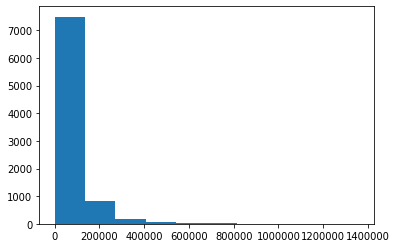

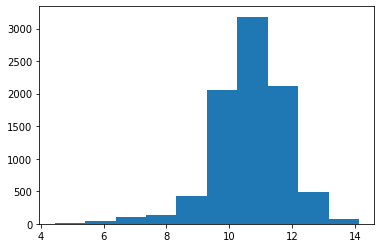

In [34]:
plt.hist(S_train)
plt.show()
plt.hist(np.log(S_train))
plt.show()

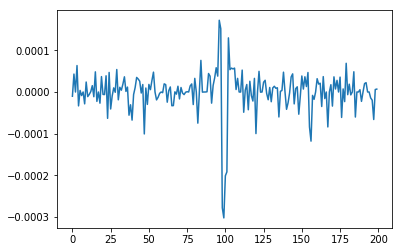

IndexError: index 1 is out of bounds for axis 2 with size 1

In [12]:
plt.plot(X_train[13,:,0])
plt.show()

plt.plot(X_train[13,:,1])
plt.show()

### Keras models

In [35]:
import keras
from keras import backend as K
from keras.models import Sequential, Model
from keras.layers import *

from IPython.display import SVG
from keras.utils.vis_utils import model_to_dot
import matplotlib.pyplot as plt
def plot_n_lc(real_lc, decoded_lc, n = 10, s=None):
    for _ in range(n):
        n_sampled = np.random.randint(0, real_lc.shape[0])
        
        if s !=None:
            print("Real scale = %f\nPred scale = %f"%(s[0][n_sampled], s[1][n_sampled] ))
        f, (ax1, ax2) = plt.subplots(1, 2, sharex=True,figsize= (15,5))
        ax1.plot(real_lc[n_sampled], 'b.-')
        ax1.set_title("Real")
        ax2.plot(decoded_lc[n_sampled], 'b.-')
        ax2.set_title("Reconstructed")
        plt.show()  

        plt.figure(figsize=(15,5))
        plt.plot(real_lc[n_sampled], 'bo-', label="Real")
        plt.plot(decoded_lc[n_sampled], 'g*-', label="Reconstructed")
        plt.title("Over")
        plt.legend()
        plt.show()
        print("----------------------------------------------------------------")

In [36]:
latent_dim = 32
_, T, channels = X_train.shape
D_dim = 5 #o variar: Period", "Duration", "Time of Transit Epoch", "r/R", "a/R",

In [37]:
X_train = X_train*S_train[:,None,:]
X_test = X_test*S_test[:,None,:]

## Regular VAE

In [27]:
l = 0.001 #kl weight

In [28]:
def sampling(args):
    z_mean, z_log_var = args
    epsilon = K.random_normal(shape=(K.shape(z_mean)[0], K.shape(z_mean)[1]), mean=0., stddev=1.)
    return z_mean + K.exp(0.5*z_log_var) * epsilon

def KL_loss(y_true, y_pred):
    return - 0.5 * K.sum(1 + z_log_var - K.square(z_mean) - K.exp(z_log_var), axis=-1)

#### IF THIS IS USED,, KL WEIGHT NEEDED TO BE LOW ######
def MSE_loss(y_true, y_pred):
    v = K.mean( K.square( y_true - y_pred ), axis=1) #on time axis..    
    return K.flatten(v)

#### HAS TO BE USED IN ORDER TO LEARN #######
def SSE_loss(y_true, y_pred):
    v = K.sum( K.square( y_true - y_pred ), axis=1) #on time axis..    
    return K.flatten(v)

def vae_loss(y_true, y_pred):
    return MSE_loss(y_true, y_pred) + l*KL_loss(y_true, y_pred)

### Con tiempo, asimilando la arquitectura de Naul

In [17]:
x_lc = Input(shape = (T, channels) , name="LC_inp")
x_t = Input(shape = (T, channels) , name ="T_inp")

x = Concatenate(axis=-1)([x_t, x_lc]) #add time encode

f1 = Bidirectional(GRU(64, return_sequences=True))(x) #bidirectional
f1 = Bidirectional(GRU(64, return_sequences=False))(f1) #bidirectional

z_mean = Dense(latent_dim,activation='linear')(f1)
z_log_var = Dense(latent_dim,activation='linear')(f1)

encoder = Model([x_t, x_lc], z_mean, name="encoder")
z = Lambda(sampling, output_shape=(latent_dim,), name='sample')([z_mean, z_log_var])
samp_encoder = Model([x_t, x_lc], z, name="encoder_sampling")


decoder_input = Input(shape=(latent_dim,))

decode = RepeatVector(T)(decoder_input)

decode = Concatenate(axis=-1)([x_t, decode]) #add time decode

decode = Bidirectional(GRU(64, return_sequences=True))(decode) #bidirectional
decode = Bidirectional(GRU(64, return_sequences=True))(decode) #bidirectional

decode = TimeDistributed(Dense(1, activation='linear'))(decode)
generator = Model([x_t, decoder_input], decode, name="generator")

# instantiate VAE model
out = generator([x_t, samp_encoder([x_t, x_lc]) ])
vae = Model([x_t, x_lc], out)

vae.compile(optimizer='adam', loss=vae_loss, metrics = [KL_loss, MSE_loss])
vae.summary()

batch_size = 128
vae.fit([X_train_t,X_train], X_train, epochs=50, batch_size=batch_size, 
        validation_data=([X_test_t,X_test], X_test))

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
T_inp (InputLayer)              (None, 200, 1)       0                                            
__________________________________________________________________________________________________
LC_inp (InputLayer)             (None, 200, 1)       0                                            
__________________________________________________________________________________________________
encoder_sampling (Model)        (None, 32)           108096      T_inp[0][0]                      
                                                                 LC_inp[0][0]                     
__________________________________________________________________________________________________
generator (Model)               (None, 200, 1)       111873      T_inp[0][0]                      
          

KeyboardInterrupt: 

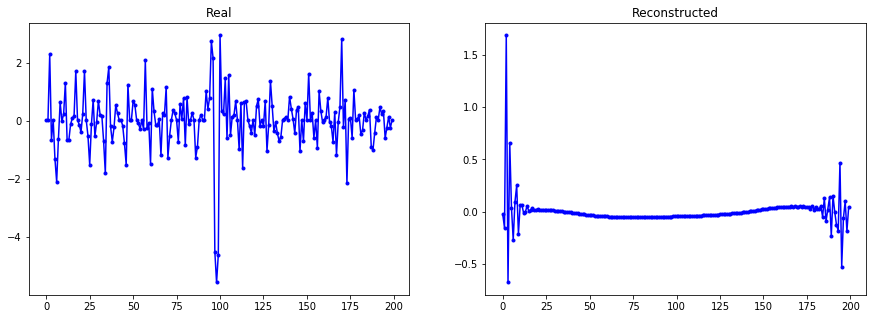

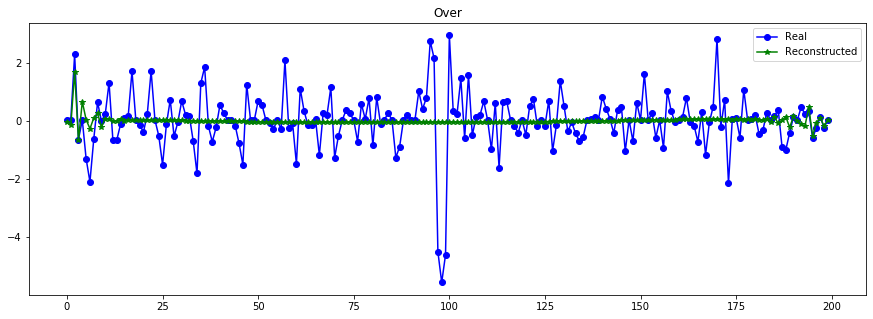

----------------------------------------------------------------


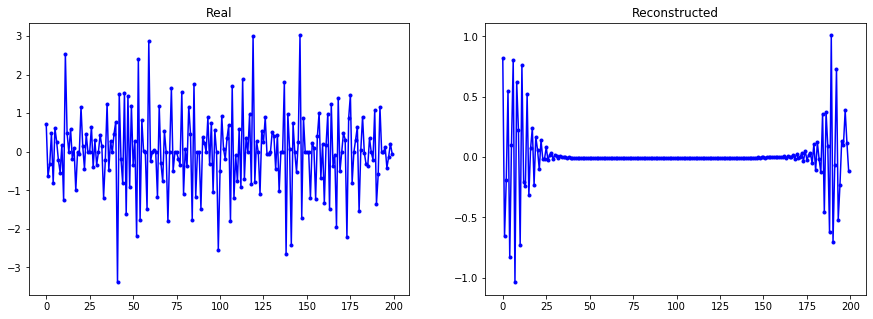

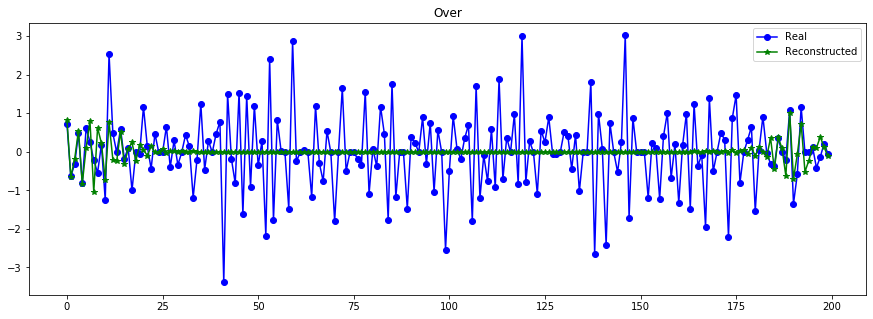

----------------------------------------------------------------


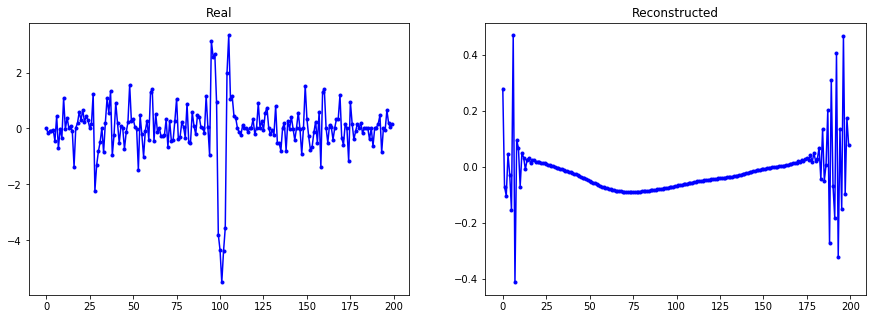

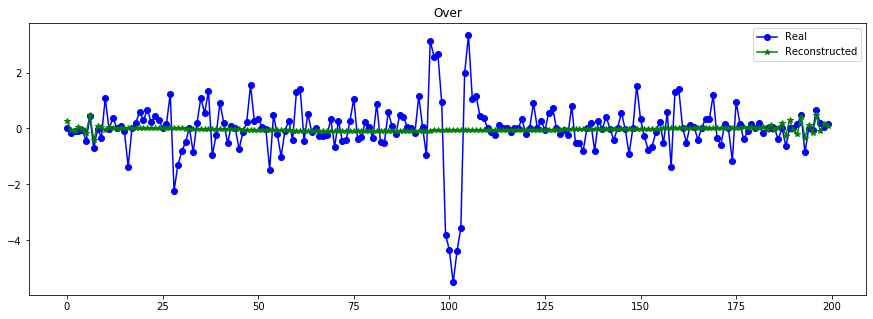

----------------------------------------------------------------


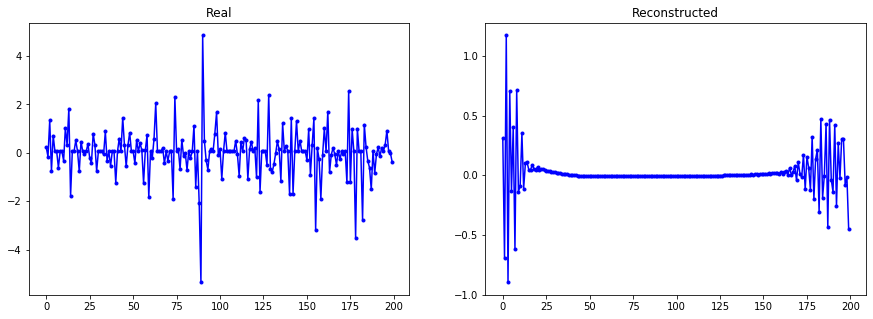

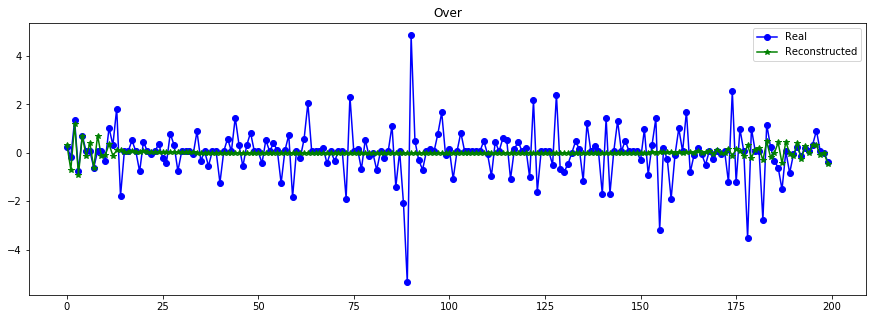

----------------------------------------------------------------


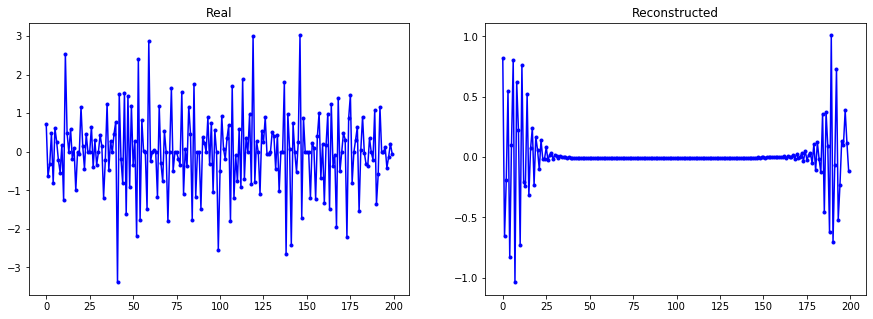

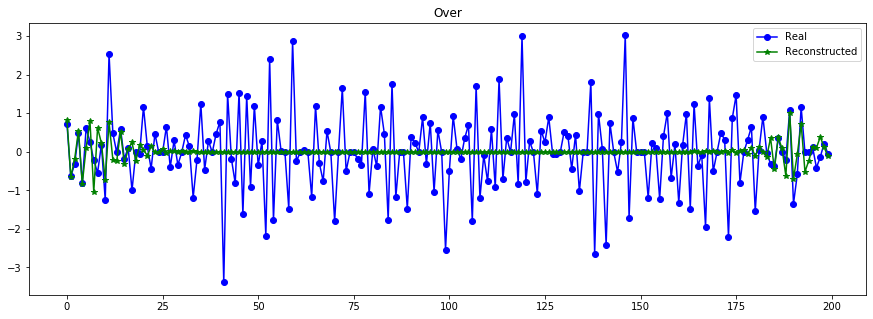

----------------------------------------------------------------


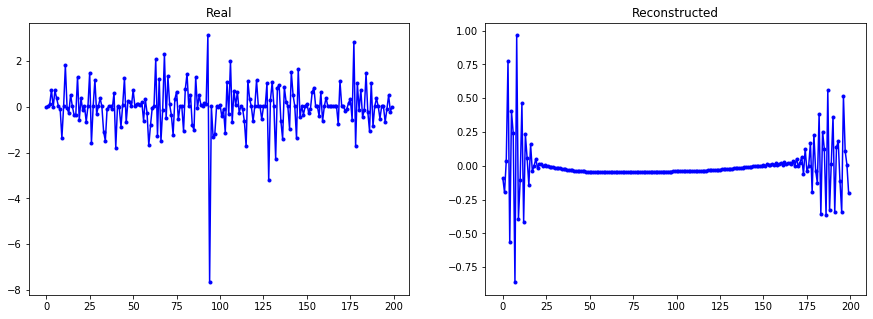

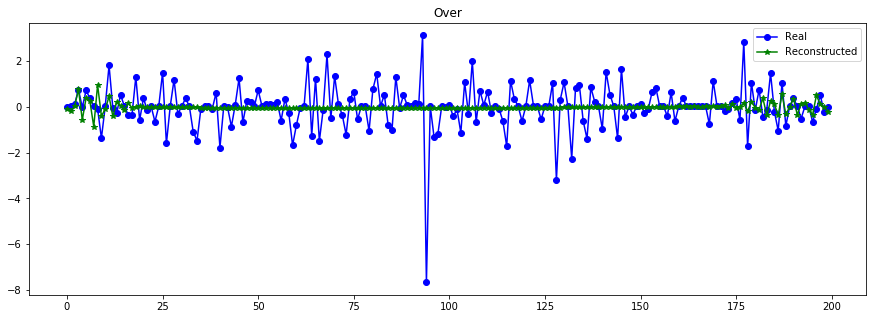

----------------------------------------------------------------


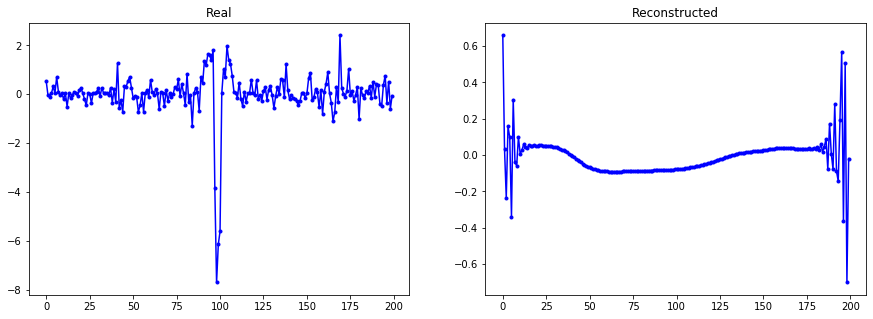

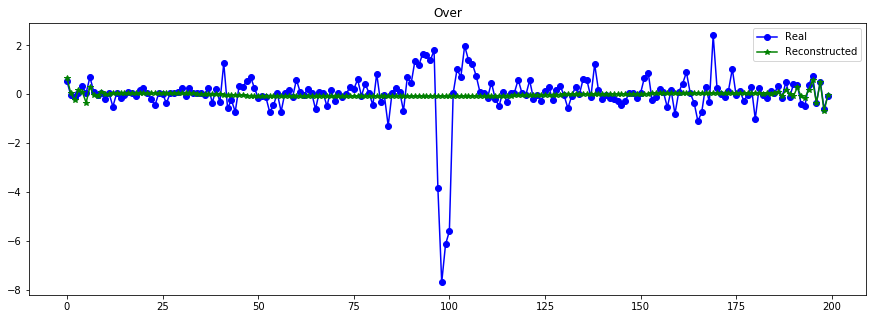

----------------------------------------------------------------


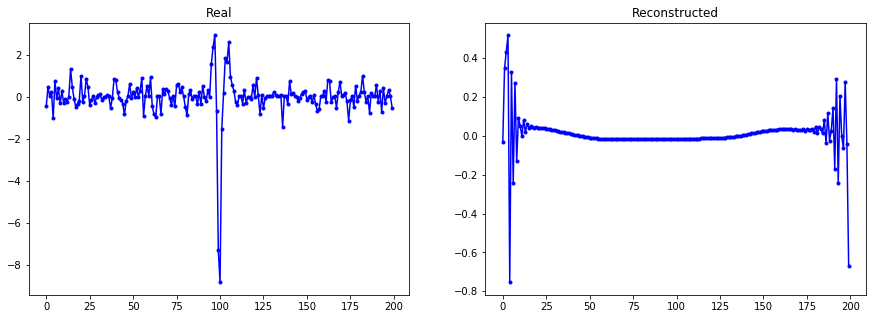

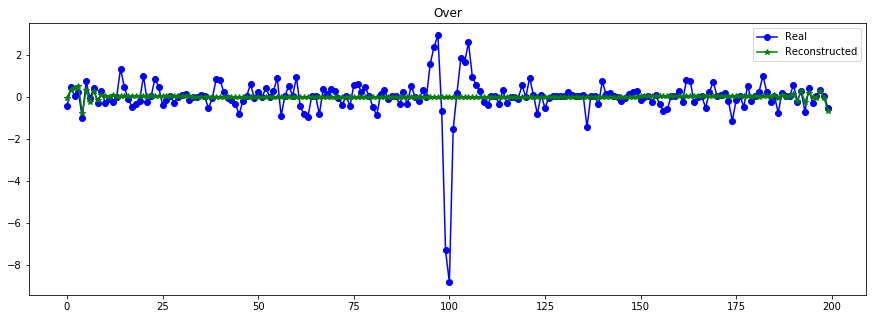

----------------------------------------------------------------


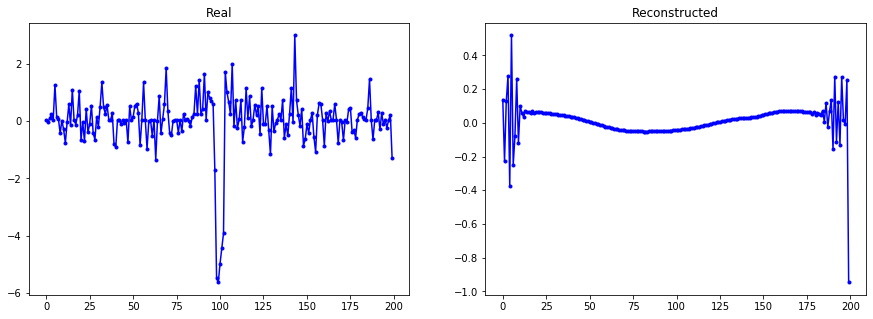

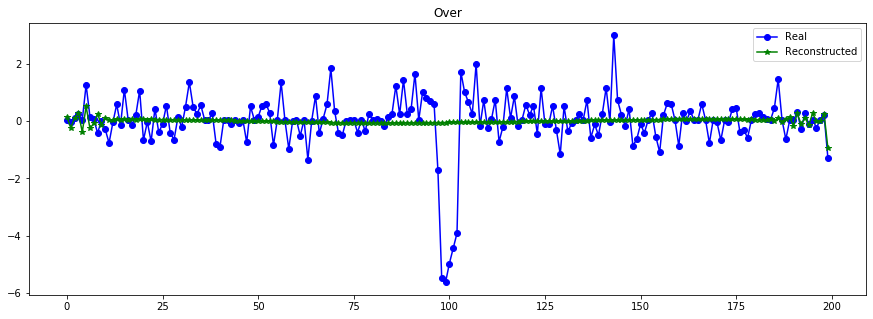

----------------------------------------------------------------


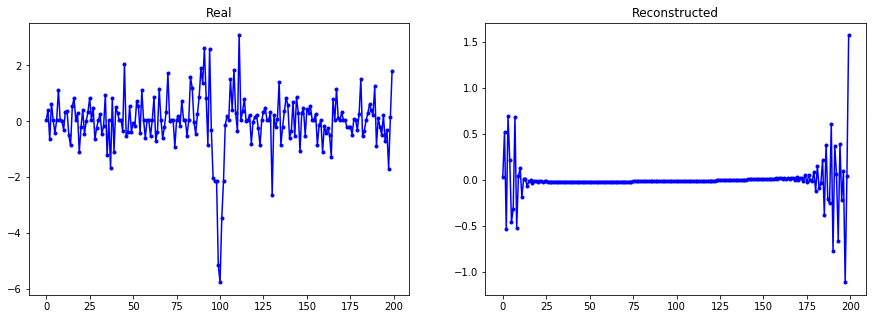

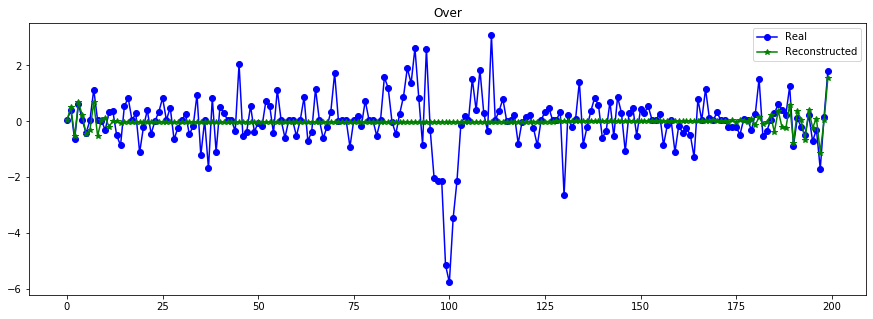

----------------------------------------------------------------


In [28]:
X_train_hat = vae.predict([X_train_t,X_train], batch_size=512)
plot_n_lc(X_train, X_train_hat, n= 10)

### KL 0.5

In [64]:
x_lc = Input(shape = (T, channels) , name="LC_inp")
x_t = Input(shape = (T, 1) , name ="T_inp")

x = Concatenate(axis=-1)([x_t, x_lc]) #add time encode

f1 = Bidirectional(CuDNNGRU(64, return_sequences=True))(x) #bidirectional
f1 = Bidirectional(CuDNNGRU(64, return_sequences=False))(f1) #bidirectional

z_mean = Dense(latent_dim,activation='linear')(f1)
z_log_var = Dense(latent_dim,activation='linear')(f1)

encoder = Model([x_t, x_lc], z_mean, name="encoder")
z = Lambda(sampling, output_shape=(latent_dim,), name='sample')([z_mean, z_log_var])
samp_encoder = Model([x_t, x_lc], z, name="encoder_sampling")


decoder_input = Input(shape=(latent_dim,))

decode = RepeatVector(T)(decoder_input)

decode = Concatenate(axis=-1)([x_t, decode]) #add time decode

decode = Bidirectional(CuDNNGRU(64, return_sequences=True))(decode) #bidirectional
decode = Bidirectional(CuDNNGRU(64, return_sequences=True))(decode) #bidirectional

decode = TimeDistributed(Dense(1, activation='linear'))(decode)
generator = Model([x_t, decoder_input], decode, name="generator")

# instantiate VAE model
out = generator([x_t, samp_encoder([x_t, x_lc]) ])
vae = Model([x_t, x_lc], out)

vae.compile(optimizer='adam', loss=vae_loss, metrics = [KL_loss, MSE_loss])
vae.summary()

batch_size = 64
vae.fit([X_train_t,X_train], X_train, epochs=200, batch_size=batch_size, 
        validation_data=([X_test_t,X_test], X_test))

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
T_inp (InputLayer)              (None, 200, 1)       0                                            
__________________________________________________________________________________________________
LC_inp (InputLayer)             (None, 200, 1)       0                                            
__________________________________________________________________________________________________
encoder_sampling (Model)        (None, 32)           108864      T_inp[0][0]                      
                                                                 LC_inp[0][0]                     
__________________________________________________________________________________________________
generator (Model)               (None, 200, 1)       112641      T_inp[0][0]                      
          

6530/6530 [==============================] - 17s 3ms/step - loss: 0.7673 - KL_loss: 4.8821e-05 - MSE_loss: 0.7672 - val_loss: 0.7089 - val_KL_loss: 1.1740e-05 - val_MSE_loss: 0.7089
Epoch 78/200
6530/6530 [==============================] - 21s 3ms/step - loss: 0.7588 - KL_loss: 1.5413e-05 - MSE_loss: 0.7588 - val_loss: 0.6826 - val_KL_loss: 1.6097e-05 - val_MSE_loss: 0.6826
Epoch 79/200
6530/6530 [==============================] - 19s 3ms/step - loss: 0.7740 - KL_loss: 2.3892e-05 - MSE_loss: 0.7740 - val_loss: 0.9548 - val_KL_loss: 1.1787e-05 - val_MSE_loss: 0.9548
Epoch 80/200
6530/6530 [==============================] - 18s 3ms/step - loss: 0.7805 - KL_loss: 2.2189e-05 - MSE_loss: 0.7805 - val_loss: 0.7242 - val_KL_loss: 1.7963e-05 - val_MSE_loss: 0.7242
Epoch 81/200
6530/6530 [==============================] - 18s 3ms/step - loss: 0.7554 - KL_loss: 1.7855e-05 - MSE_loss: 0.7554 - val_loss: 0.7844 - val_KL_loss: 1.2110e-05 - val_MSE_loss: 0.7844
Epoch 82/200
6530/6530 [==============

Epoch 119/200
6530/6530 [==============================] - 17s 3ms/step - loss: 0.7506 - KL_loss: 1.2152e-05 - MSE_loss: 0.7506 - val_loss: 0.6418 - val_KL_loss: 1.0946e-05 - val_MSE_loss: 0.6418
Epoch 120/200
6530/6530 [==============================] - 17s 3ms/step - loss: 0.7439 - KL_loss: 1.4340e-05 - MSE_loss: 0.7439 - val_loss: 0.6517 - val_KL_loss: 8.5505e-06 - val_MSE_loss: 0.6517
Epoch 121/200
6530/6530 [==============================] - 18s 3ms/step - loss: 0.7670 - KL_loss: 2.2331e-05 - MSE_loss: 0.7670 - val_loss: 0.6657 - val_KL_loss: 1.5566e-05 - val_MSE_loss: 0.6657
Epoch 122/200
6530/6530 [==============================] - 18s 3ms/step - loss: 0.7624 - KL_loss: 2.2253e-05 - MSE_loss: 0.7624 - val_loss: 0.6441 - val_KL_loss: 8.4511e-06 - val_MSE_loss: 0.6441
Epoch 123/200
6530/6530 [==============================] - 18s 3ms/step - loss: 0.7539 - KL_loss: 1.3007e-05 - MSE_loss: 0.7539 - val_loss: 0.6588 - val_KL_loss: 1.4984e-05 - val_MSE_loss: 0.6588
Epoch 124/200
6530/6

1052/1052 [==============================] - 0s 380us/step
Errores  [168.48011599928708, 4.803458476701164, 0.83039196702464]


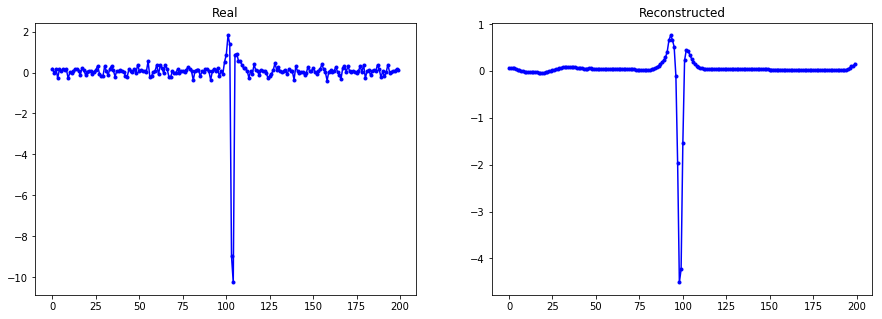

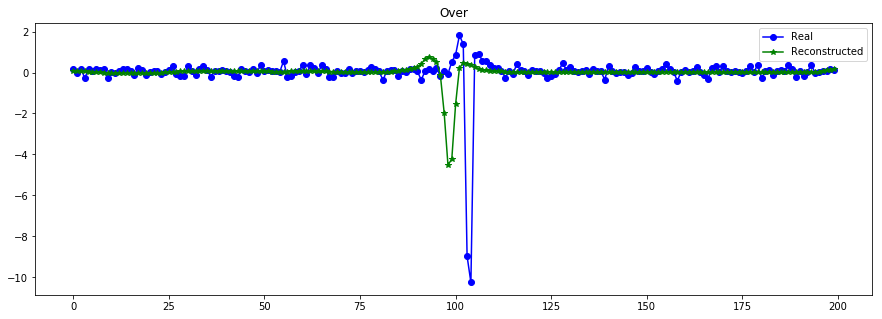

----------------------------------------------------------------


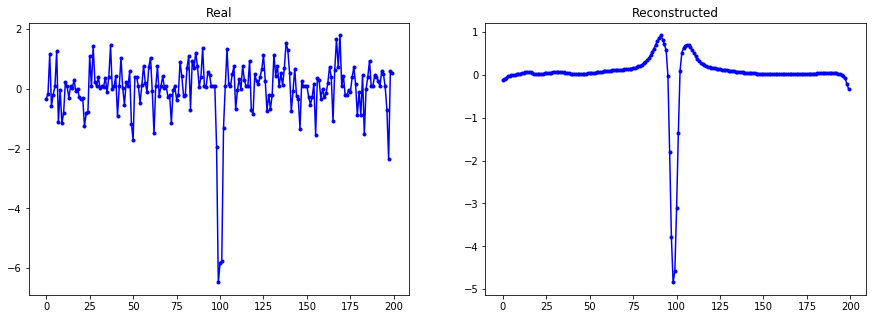

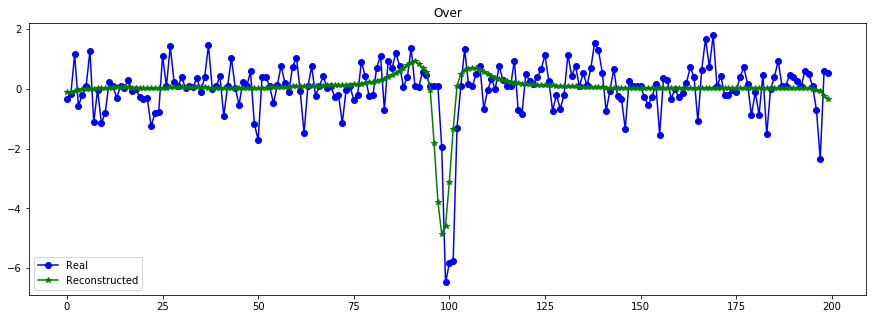

----------------------------------------------------------------


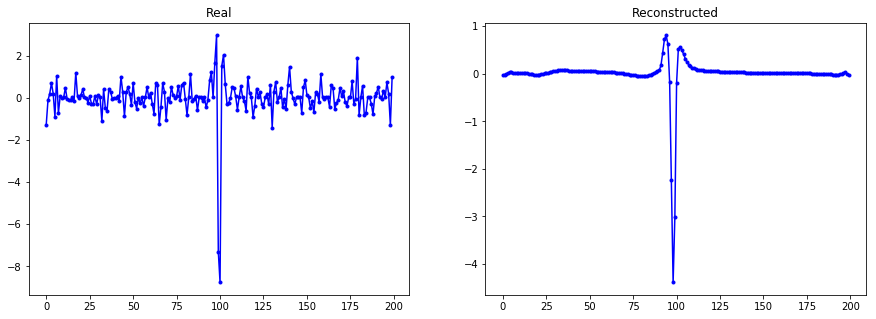

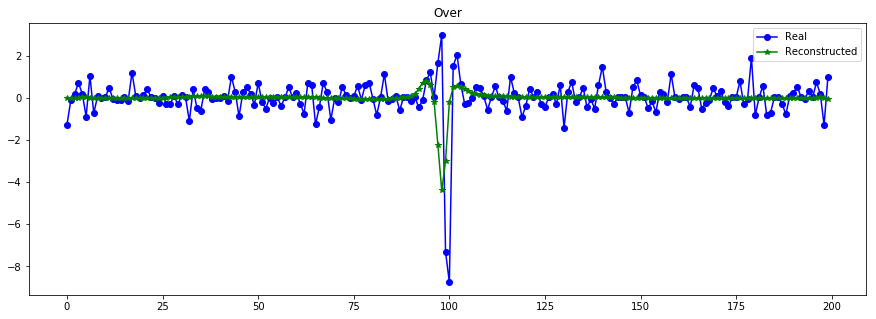

----------------------------------------------------------------


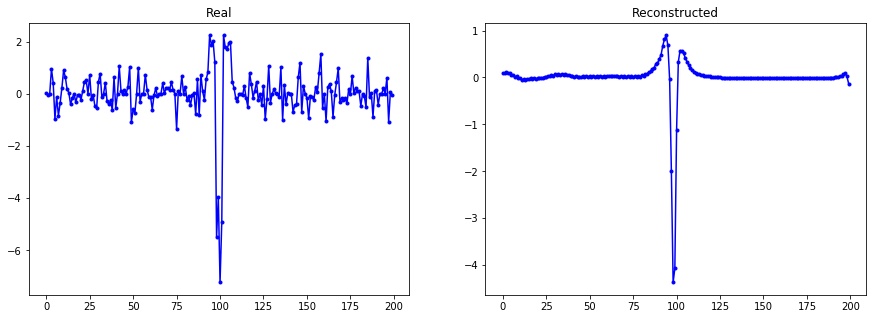

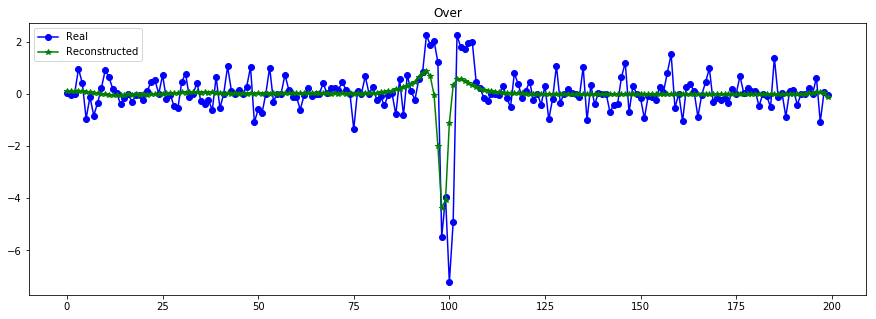

----------------------------------------------------------------


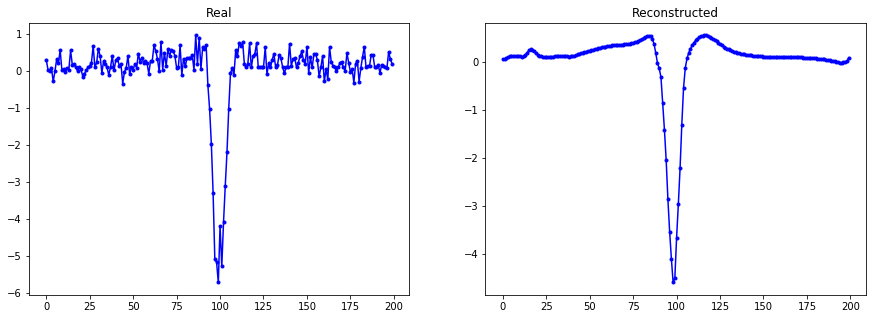

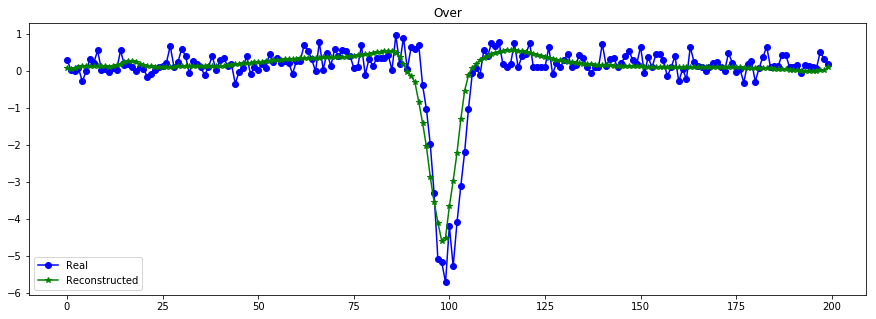

----------------------------------------------------------------


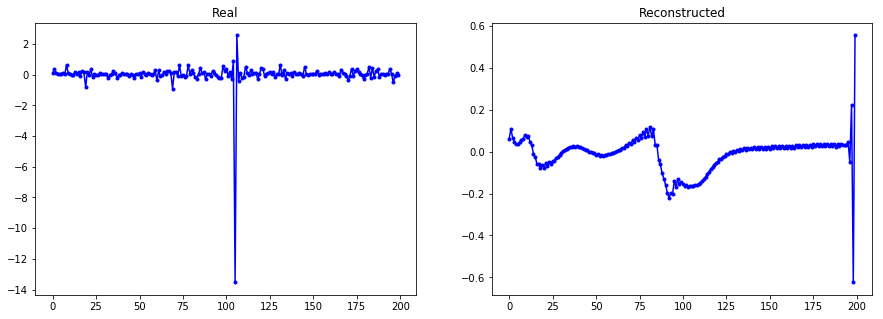

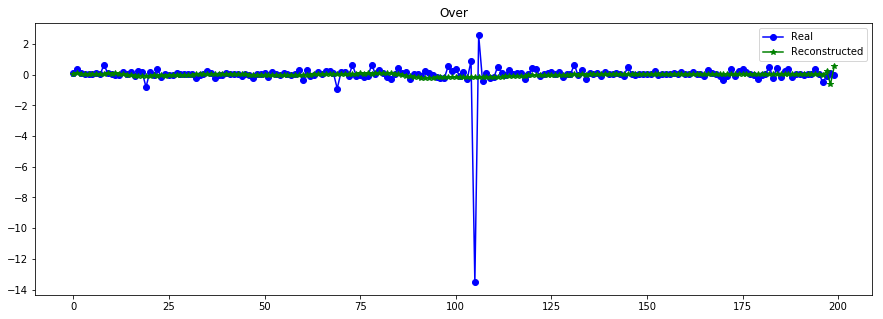

----------------------------------------------------------------


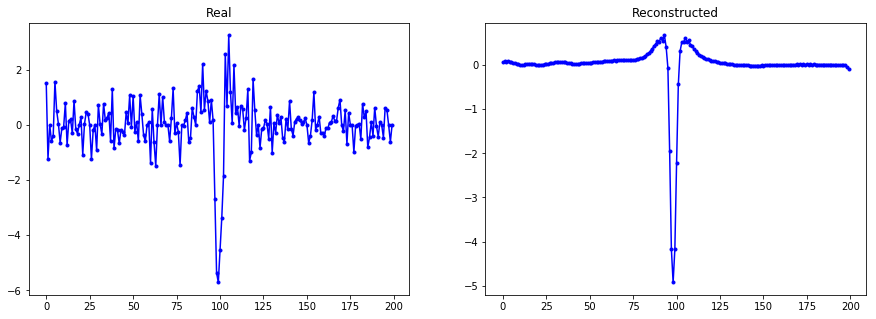

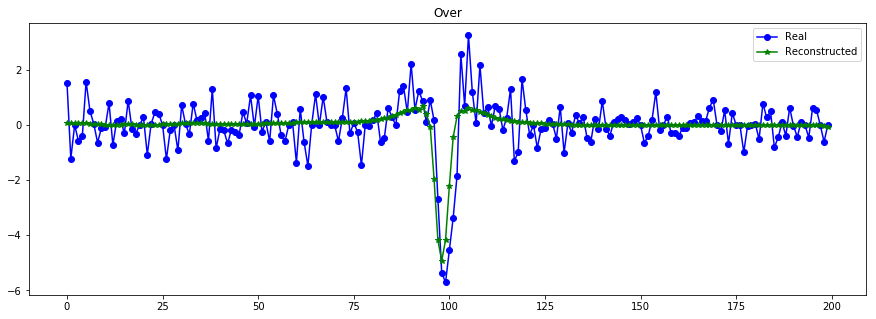

----------------------------------------------------------------


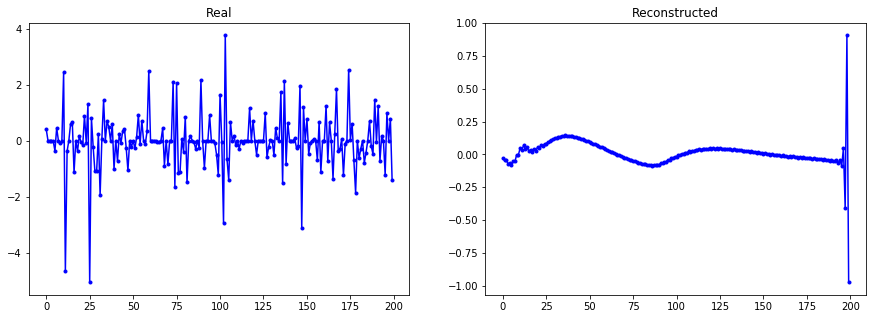

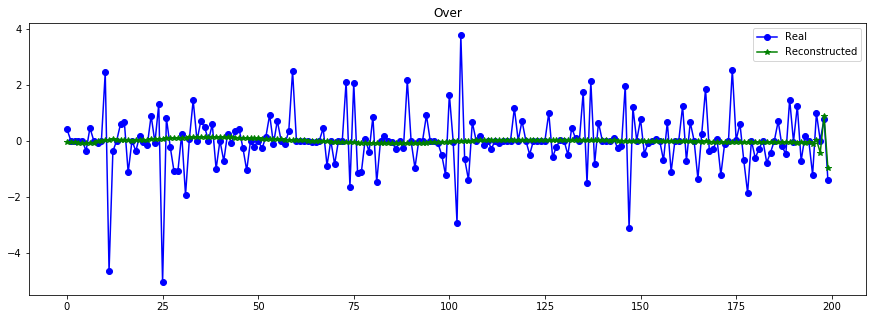

----------------------------------------------------------------


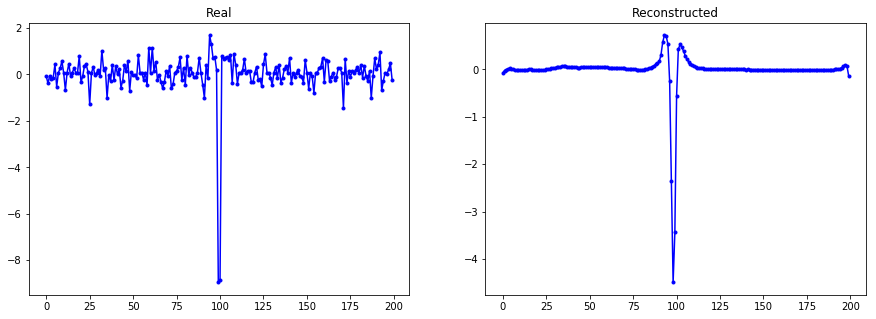

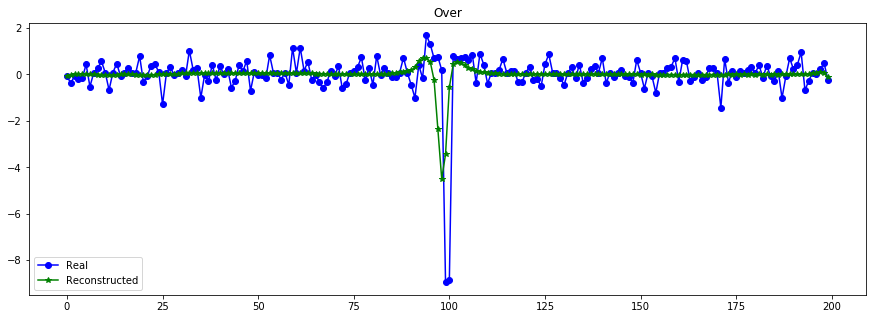

----------------------------------------------------------------


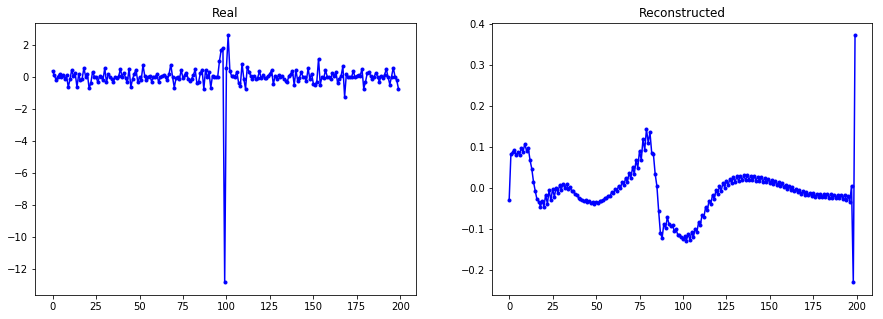

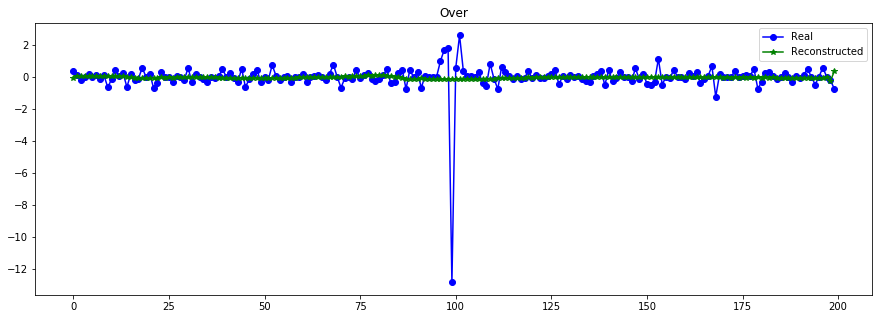

----------------------------------------------------------------


In [62]:
print("Errores ",vae.evaluate([X_test_t,X_test], X_test, batch_size=512))
X_train_hat = vae.predict([X_train_t,X_train], batch_size=512)
plot_n_lc(X_train[:,:,0], X_train_hat, n= 10) ###con 200 epochs T=200 global (CURVAS TRANSITO) std rep 

1052/1052 [==============================] - 0s 336us/step
Errores  [0.6544913889790669, 0.00013613938826478013, 0.6544232873862234]


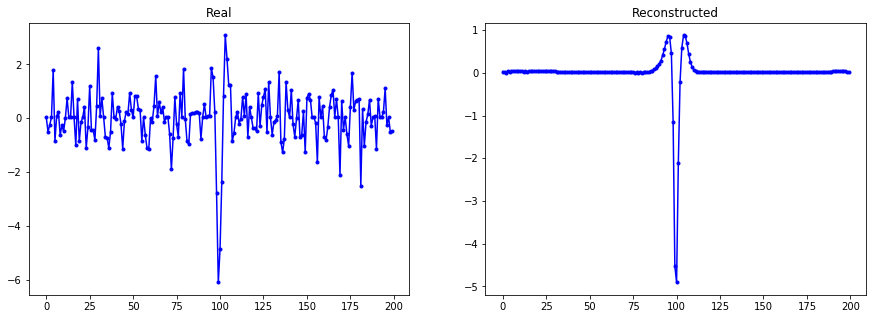

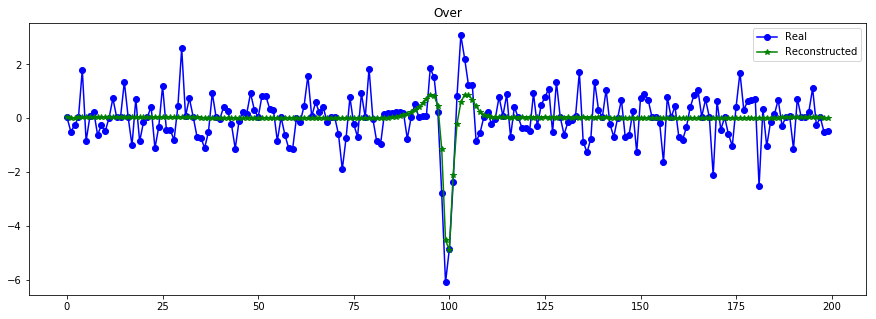

----------------------------------------------------------------


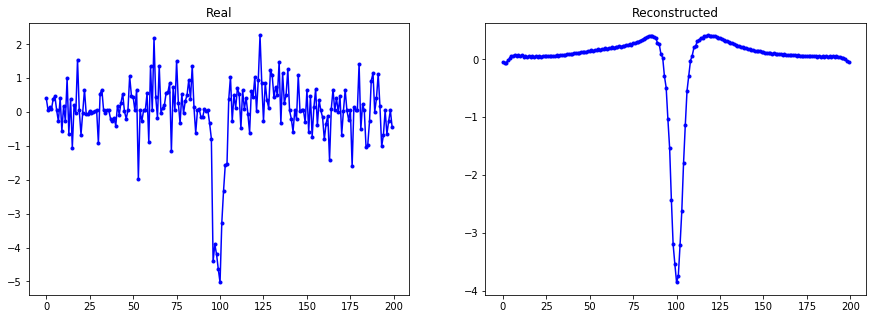

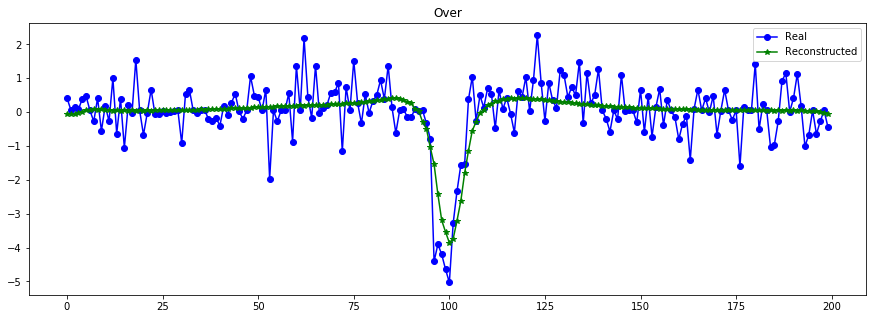

----------------------------------------------------------------


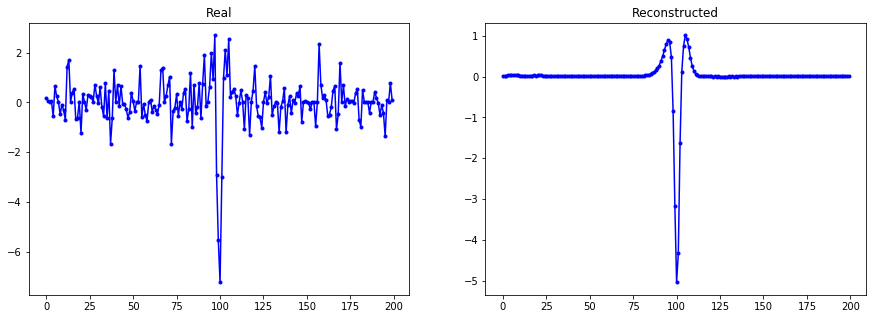

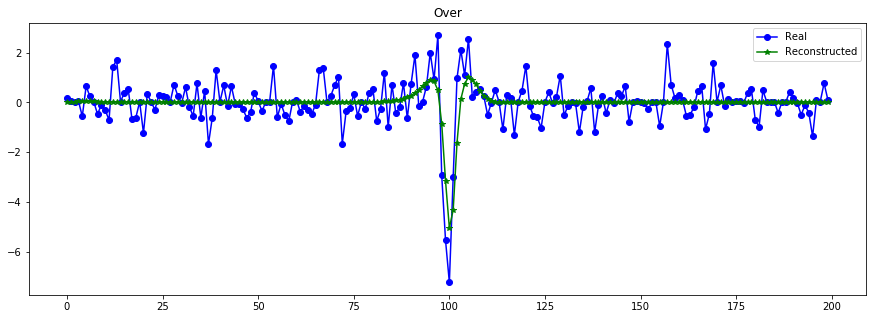

----------------------------------------------------------------


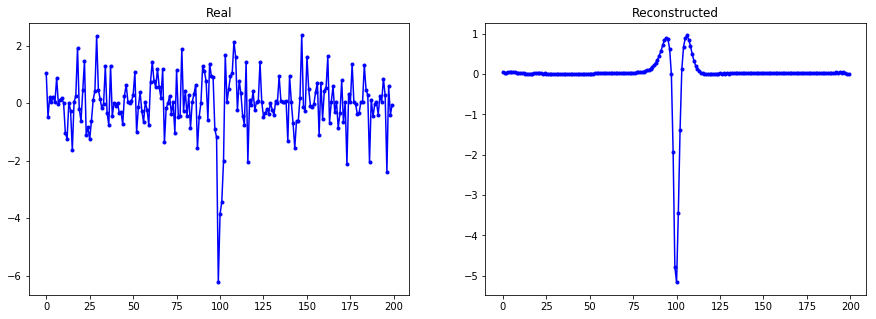

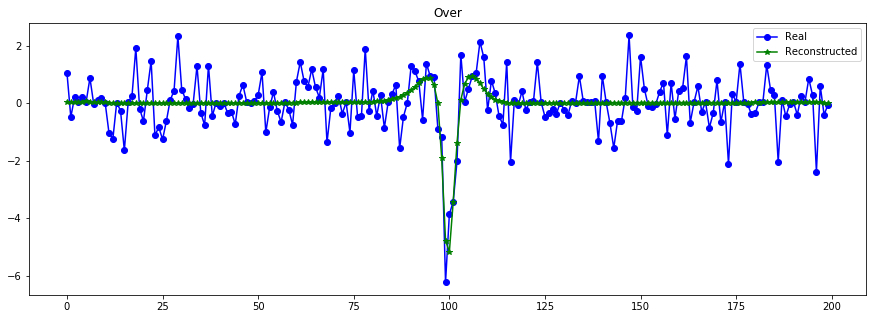

----------------------------------------------------------------


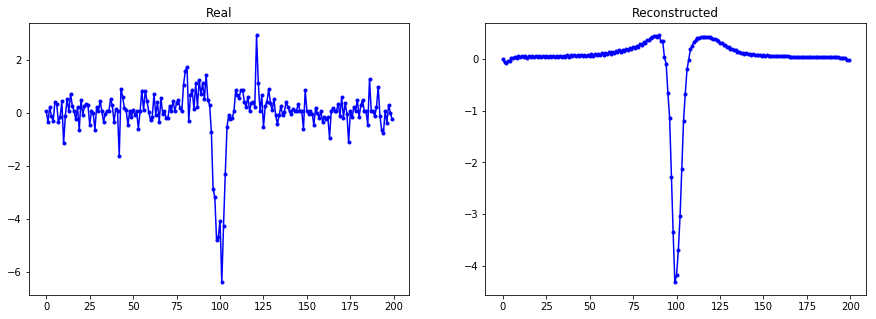

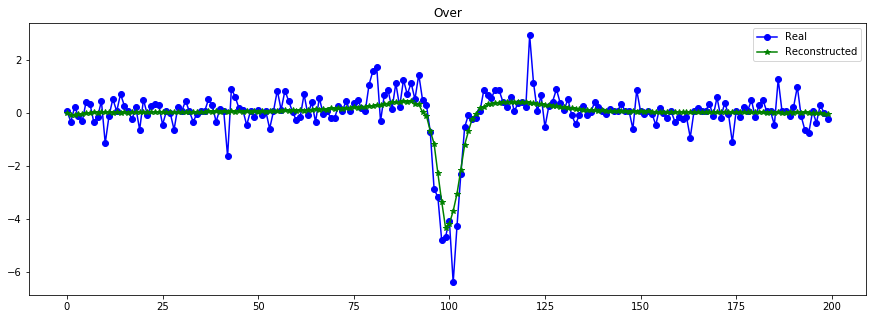

----------------------------------------------------------------


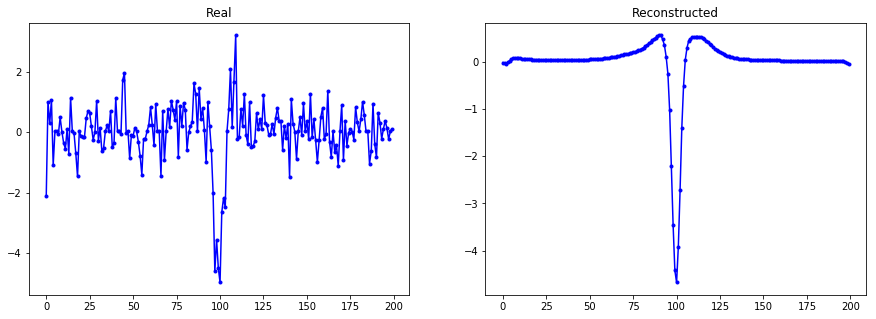

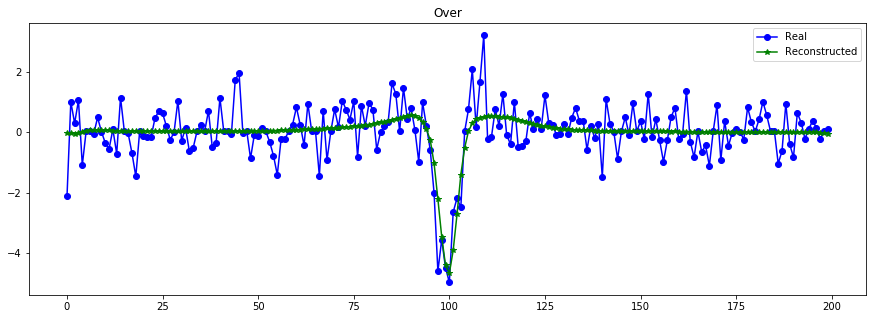

----------------------------------------------------------------


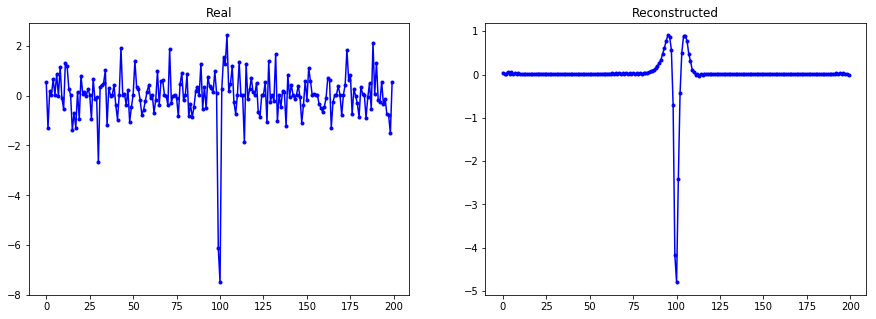

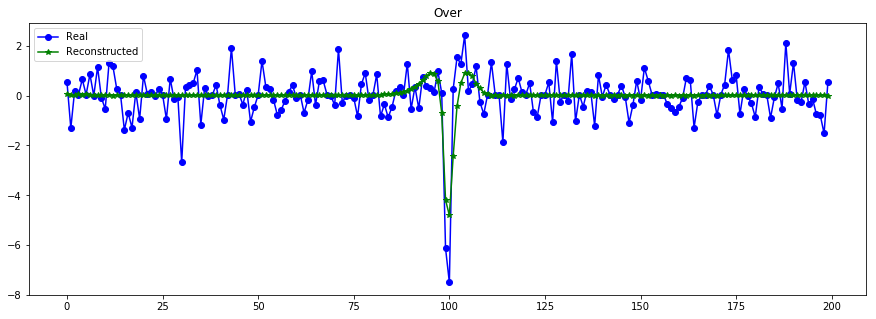

----------------------------------------------------------------


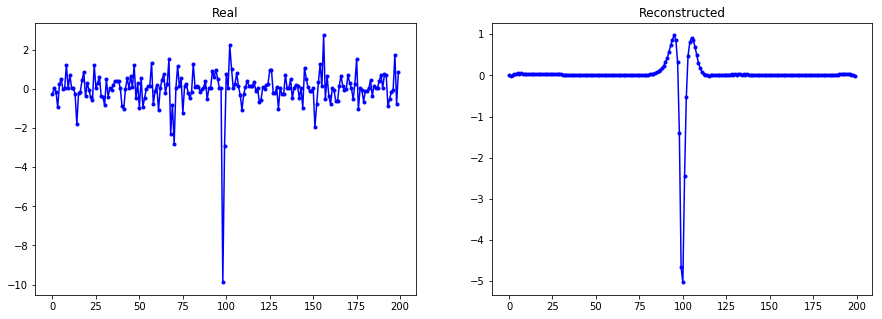

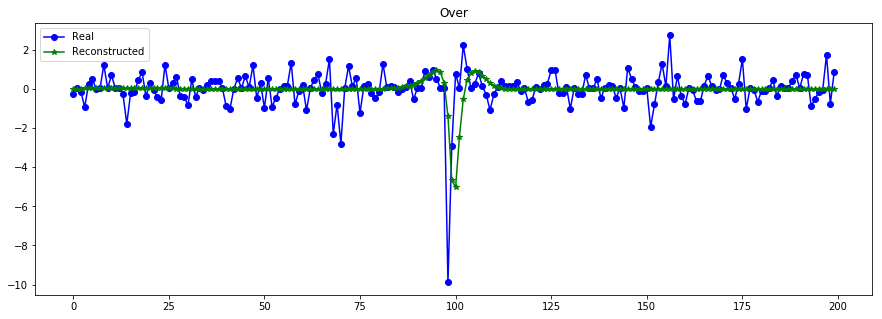

----------------------------------------------------------------


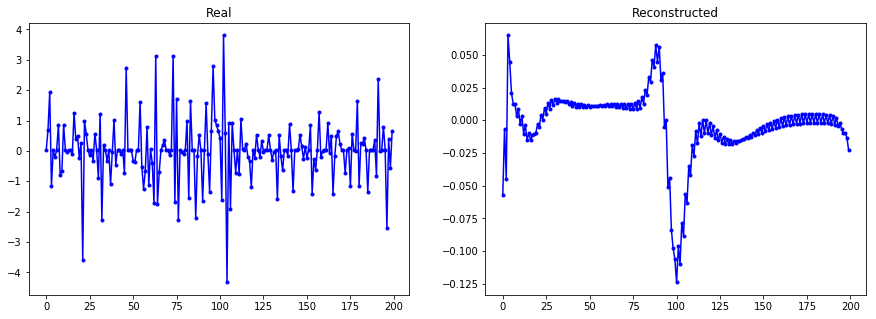

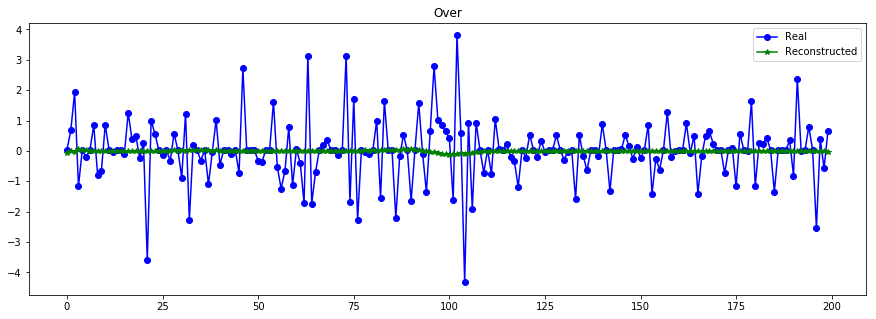

----------------------------------------------------------------


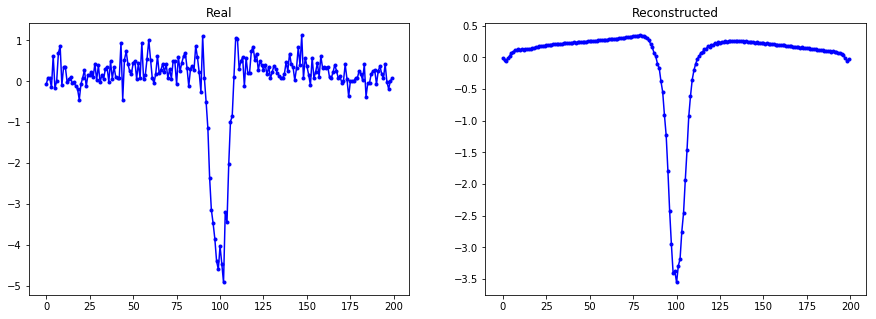

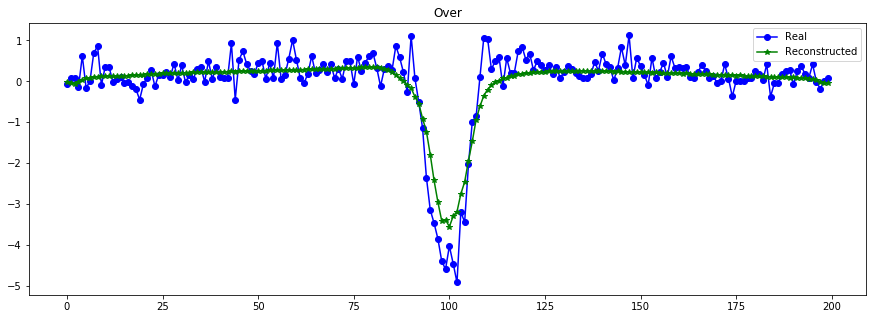

----------------------------------------------------------------


In [65]:
print("Errores ",vae.evaluate([X_test_t,X_test], X_test, batch_size=512))
X_train_hat = vae.predict([X_train_t,X_train], batch_size=512)
plot_n_lc(X_train[:,:,0], X_train_hat, n= 10) ###con 200 epochs T=200 global (CURVAS TRANSITO) std rep con MSE

SI SIGUE MAL:
* BAJAR PESO A KL (0.1)
* AGREGAR DENSE ANTES DE REPEAT


### KL 0.1

In [467]:
x_lc = Input(shape = (T, channels) , name="LC_inp")
x_t = Input(shape = (T, 1) , name ="T_inp")

x = Concatenate(axis=-1)([x_t, x_lc]) #add time encode

f1 = Bidirectional(CuDNNGRU(64, return_sequences=True))(x) #bidirectional
f1 = Bidirectional(CuDNNGRU(64, return_sequences=False))(f1) #bidirectional

z_mean = Dense(latent_dim,activation='linear')(f1)
z_log_var = Dense(latent_dim,activation='linear')(f1)

encoder = Model([x_t, x_lc], z_mean, name="encoder")
z = Lambda(sampling, output_shape=(latent_dim,), name='sample')([z_mean, z_log_var])
samp_encoder = Model([x_t, x_lc], z, name="encoder_sampling")


decoder_input = Input(shape=(latent_dim,))

#decode = Dense(latent_dim, activation='relu')(decoder_input)
decode = RepeatVector(T)(decoder_input)

decode = Concatenate(axis=-1)([x_t, decode]) #add time decode

decode = Bidirectional(CuDNNGRU(64, return_sequences=True))(decode) #bidirectional
decode = Bidirectional(CuDNNGRU(64, return_sequences=True))(decode) #bidirectional

decode = TimeDistributed(Dense(1, activation='linear'))(decode)
generator = Model([x_t, decoder_input], decode, name="generator")

# instantiate VAE model
out = generator([x_t, samp_encoder([x_t, x_lc]) ])
vae = Model([x_t, x_lc], out)

vae.compile(optimizer='adam', loss=vae_loss, metrics = [KL_loss, MSE_loss])
vae.summary()

batch_size = 64
vae.fit([X_train_t,X_train], X_train, epochs=200, batch_size=batch_size, 
        validation_data=([X_test_t,X_test], X_test))

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
T_inp (InputLayer)              (None, 200, 1)       0                                            
__________________________________________________________________________________________________
LC_inp (InputLayer)             (None, 200, 1)       0                                            
__________________________________________________________________________________________________
encoder_sampling (Model)        (None, 32)           108864      T_inp[0][0]                      
                                                                 LC_inp[0][0]                     
__________________________________________________________________________________________________
generator (Model)               (None, 200, 1)       112641      T_inp[0][0]                      
          

8634/8634 [==============================] - 19s 2ms/step - loss: 0.7622 - KL_loss: 2.4532e-04 - MSE_loss: 0.7622
Epoch 55/500
8634/8634 [==============================] - 20s 2ms/step - loss: 0.7590 - KL_loss: 2.2139e-04 - MSE_loss: 0.7589
Epoch 56/500
8634/8634 [==============================] - 20s 2ms/step - loss: 0.7569 - KL_loss: 2.2078e-04 - MSE_loss: 0.7569
Epoch 57/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.7623 - KL_loss: 1.8016e-04 - MSE_loss: 0.7623
Epoch 58/500
8634/8634 [==============================] - 20s 2ms/step - loss: 0.7541 - KL_loss: 1.8938e-04 - MSE_loss: 0.7541
Epoch 59/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.7561 - KL_loss: 1.7863e-04 - MSE_loss: 0.7561
Epoch 60/500
8634/8634 [==============================] - 21s 2ms/step - loss: 0.7627 - KL_loss: 1.9265e-04 - MSE_loss: 0.7627
Epoch 61/500
8634/8634 [==============================] - 20s 2ms/step - loss: 0.7621 - KL_loss: 2.2139e-04 - MSE_loss: 0.76

8634/8634 [==============================] - 19s 2ms/step - loss: 0.7441 - KL_loss: 8.5686e-04 - MSE_loss: 0.7441
Epoch 183/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.7812 - KL_loss: 3.8873e-04 - MSE_loss: 0.7812
Epoch 184/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.7429 - KL_loss: 2.4404e-04 - MSE_loss: 0.7429
Epoch 185/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.7387 - KL_loss: 1.4825e-04 - MSE_loss: 0.7387
Epoch 186/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.7345 - KL_loss: 1.6202e-04 - MSE_loss: 0.7344
Epoch 187/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.7539 - KL_loss: 3.1513e-04 - MSE_loss: 0.7538
Epoch 188/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.7715 - KL_loss: 3.8342e-04 - MSE_loss: 0.7714
Epoch 189/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.7518 - KL_loss: 6.0395e-04 - MSE_los

8634/8634 [==============================] - 20s 2ms/step - loss: 0.7524 - KL_loss: 0.0269 - MSE_loss: 0.7497
Epoch 313/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.7530 - KL_loss: 0.0138 - MSE_loss: 0.7516
Epoch 314/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.7400 - KL_loss: 0.0037 - MSE_loss: 0.7397
Epoch 315/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.7397 - KL_loss: 0.0012 - MSE_loss: 0.7396
Epoch 316/500
8634/8634 [==============================] - 20s 2ms/step - loss: 0.7506 - KL_loss: 0.0011 - MSE_loss: 0.7505
Epoch 317/500
8634/8634 [==============================] - 20s 2ms/step - loss: 0.7366 - KL_loss: 3.1239e-04 - MSE_loss: 0.7365
Epoch 318/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.7356 - KL_loss: 1.7440e-04 - MSE_loss: 0.7355
Epoch 319/500
8634/8634 [==============================] - 20s 2ms/step - loss: 0.7614 - KL_loss: 0.0026 - MSE_loss: 0.7611
Epoch 320/500


Epoch 377/500
8634/8634 [==============================] - 20s 2ms/step - loss: 0.7618 - KL_loss: 8.1554e-04 - MSE_loss: 0.7618
Epoch 378/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.7549 - KL_loss: 0.0014 - MSE_loss: 0.7548
Epoch 379/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.7323 - KL_loss: 3.1956e-04 - MSE_loss: 0.7322
Epoch 380/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.7312 - KL_loss: 1.4697e-04 - MSE_loss: 0.7312
Epoch 381/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.7300 - KL_loss: 1.3537e-04 - MSE_loss: 0.7300
Epoch 382/500
8634/8634 [==============================] - 20s 2ms/step - loss: 0.7412 - KL_loss: 3.9840e-04 - MSE_loss: 0.7411
Epoch 383/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.9608 - KL_loss: 1.7697e-04 - MSE_loss: 0.9608
Epoch 384/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.8067 - KL_loss: 6.0996e-05

Errores  []


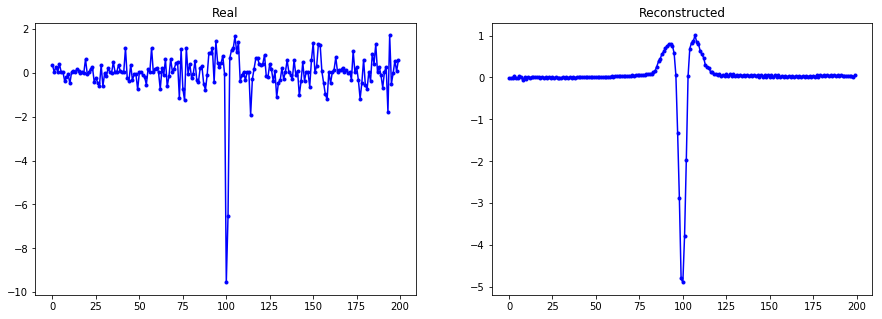

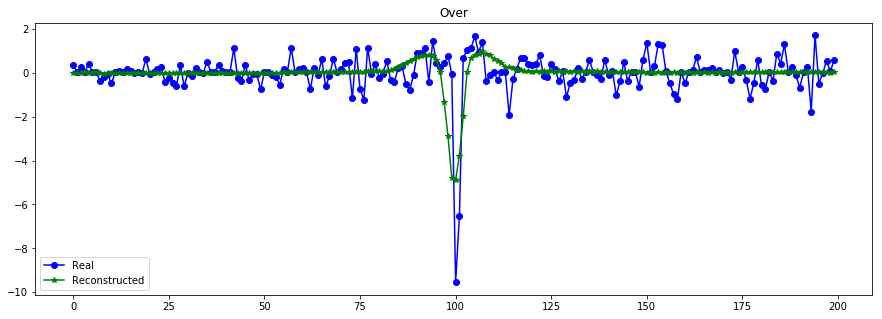

----------------------------------------------------------------


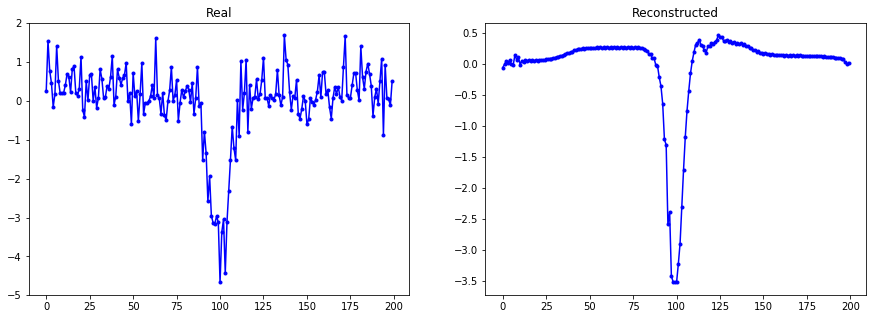

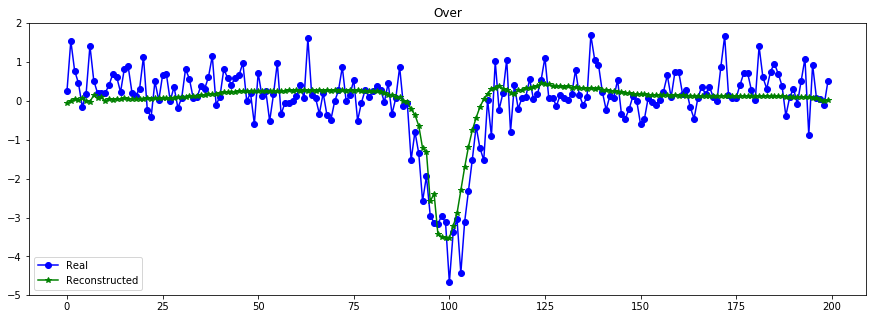

----------------------------------------------------------------


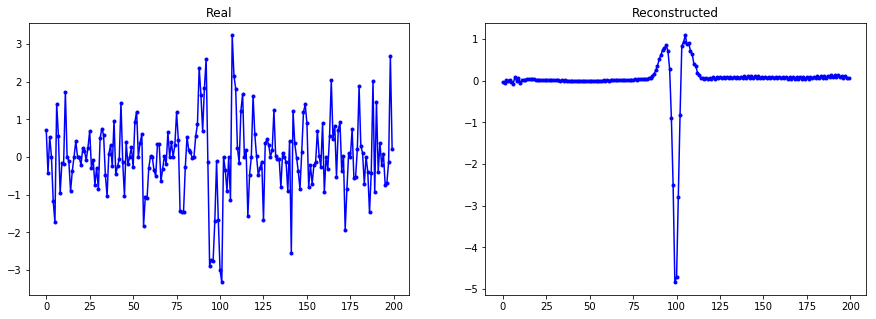

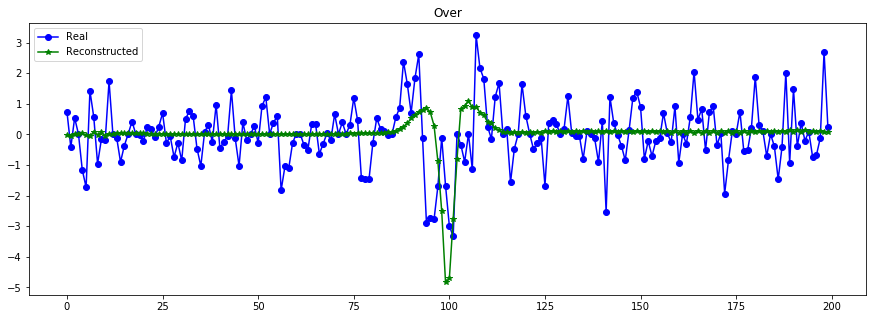

----------------------------------------------------------------


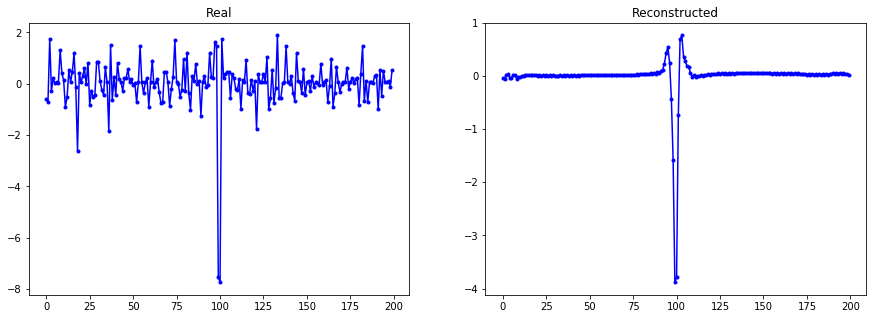

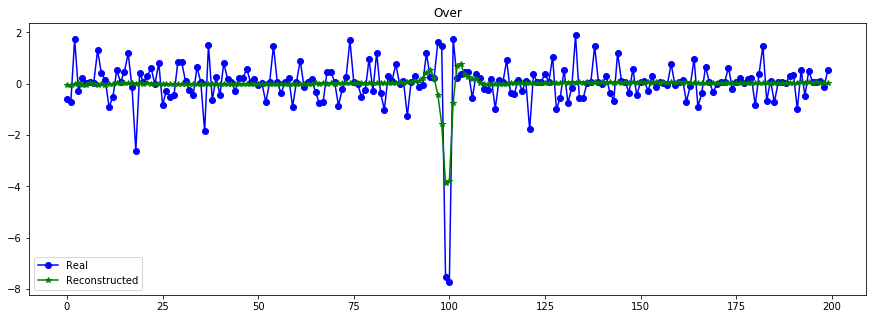

----------------------------------------------------------------


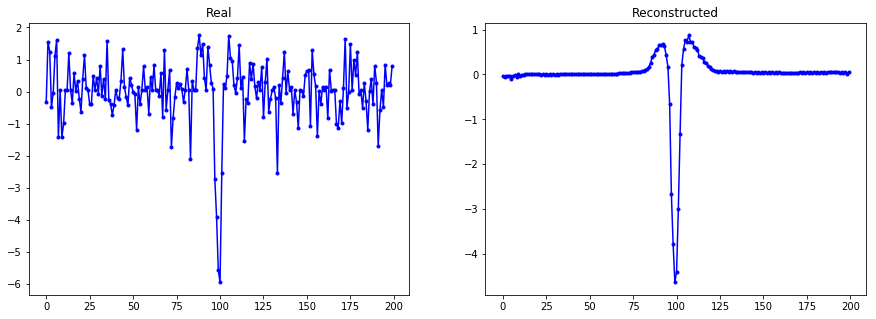

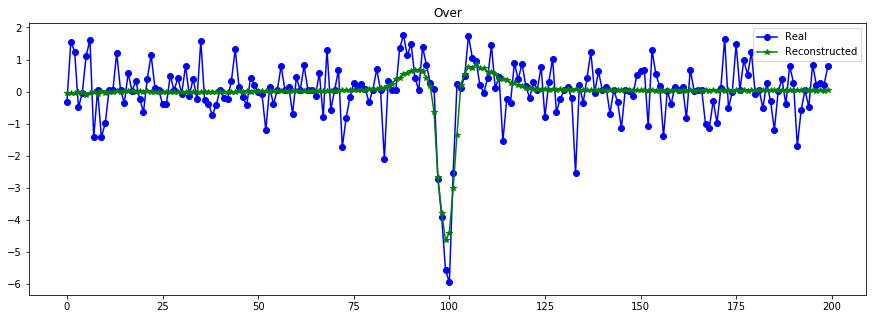

----------------------------------------------------------------


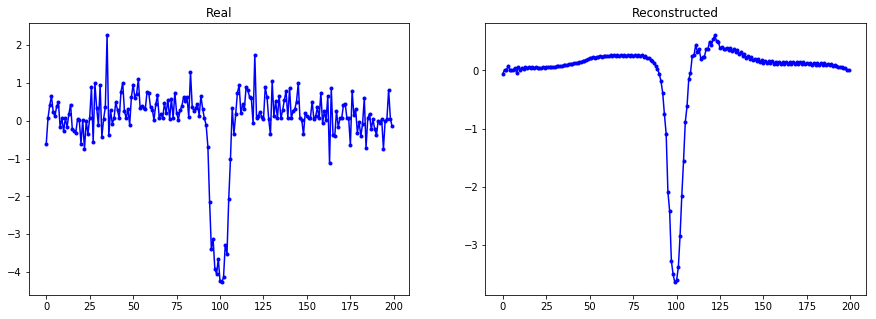

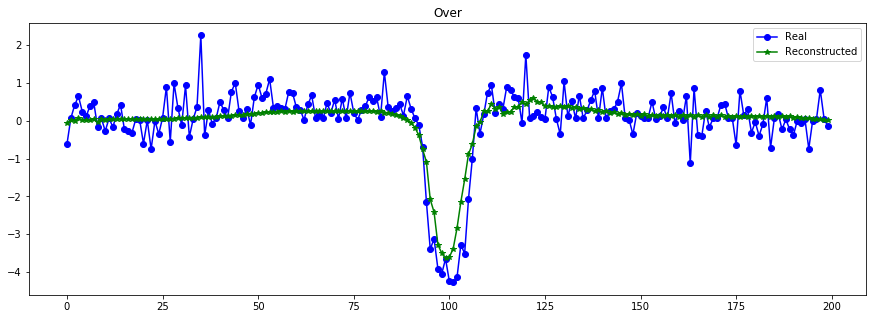

----------------------------------------------------------------


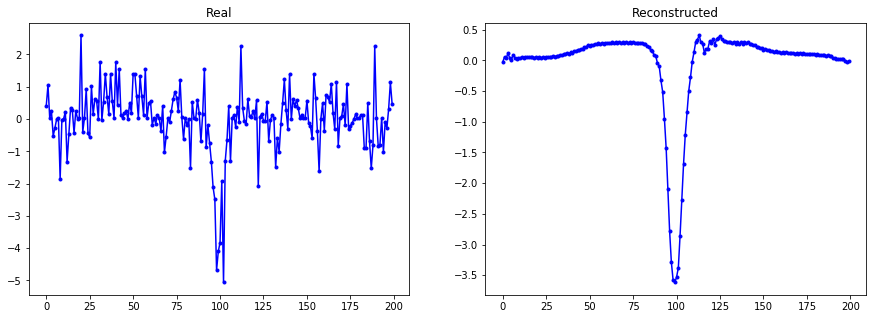

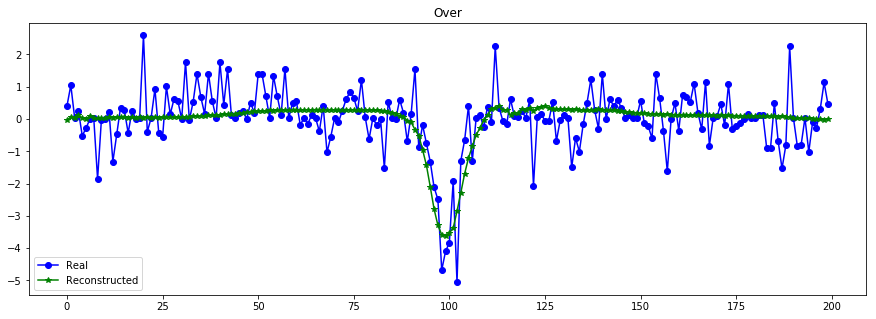

----------------------------------------------------------------


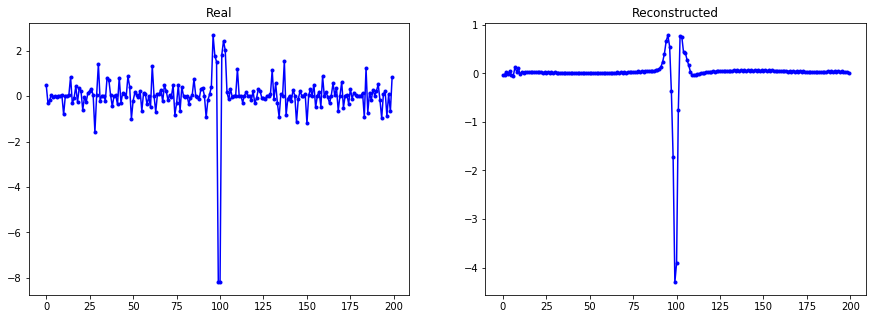

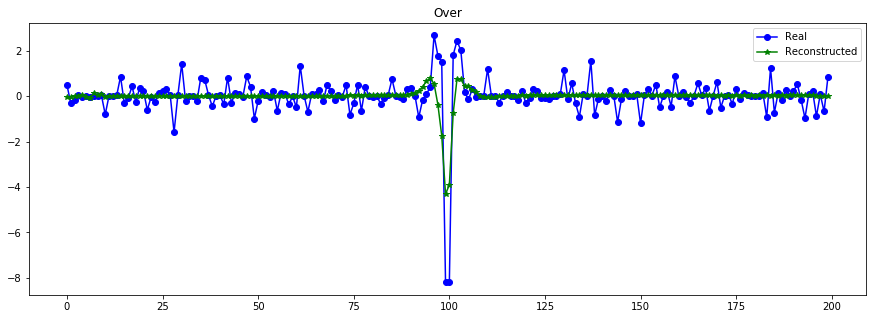

----------------------------------------------------------------


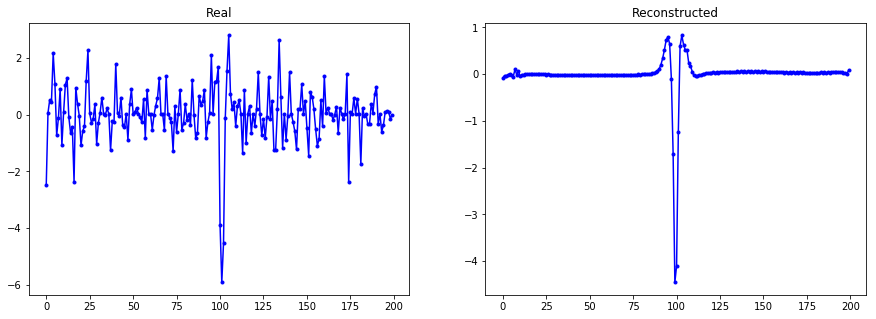

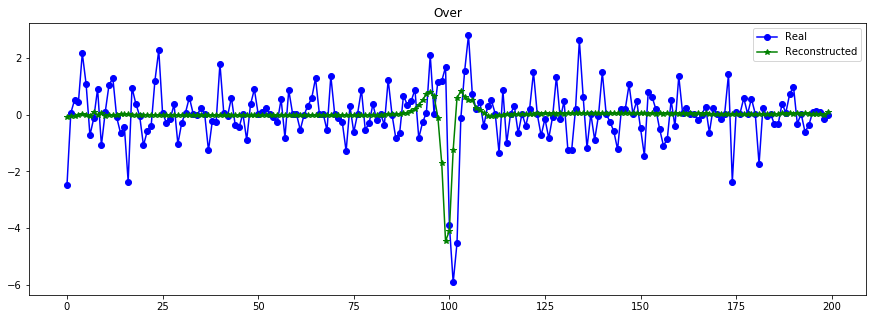

----------------------------------------------------------------


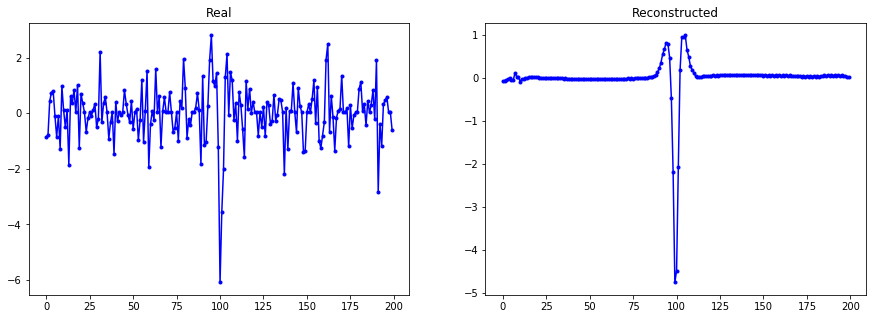

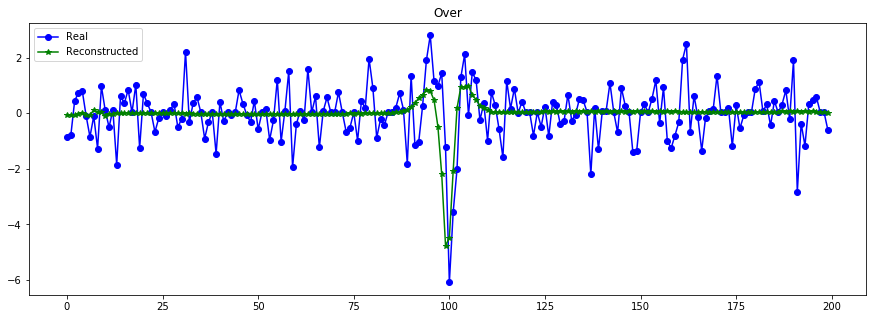

----------------------------------------------------------------


In [468]:
print("Errores ",vae.evaluate([X_test_t,X_test], X_test, batch_size=512))
X_train_hat = vae.predict([X_train_t,X_train], batch_size=512)
plot_n_lc(X_train[:,:,0], X_train_hat, n= 10) ###con 200 epochs T=200 global (CURVAS TRANSITO) std rep +KL(0.1)

In [159]:
#https://plot.ly/python/v3/fft-filters/
#https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.butter.html
#https://scipy-cookbook.readthedocs.io/items/ButterworthBandpass.html

from scipy.signal import butter, lfilter

def butter_bandpass(lowcut, highcut, fs, order=5):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    #b, a = butter(order, high, btype='highpass')
    #b, a = butter(order, low, btype='lowpass')
    return b, a

def butter_bandpass_filter(data, lowcut, highcut, fs, order=5):
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    y = lfilter(b, a, data)
    return y

lowcut  = 1 #300. #2000. #con order 3
highcut = 500 #2500 #2500. # 500. #0.1
fs =  10000.

In [160]:
def map_filter(x):
    return_v = np.squeeze(x.copy())
    for i in range(x.shape[0]):
        return_v[i] = butter_bandpass_filter(np.squeeze(x[i]), lowcut, highcut, fs, order=3)
    return return_v
X_train_filter = map_filter(X_train)

X_train_filter

array([[-4.58188115e-06, -9.82083512e-05, -5.38105394e-04, ...,
         1.74243610e-02,  1.59578148e-02,  1.54491605e-02],
       [ 2.66050944e-03,  1.60930631e-02,  4.26504406e-02, ...,
        -1.19152720e-01, -9.82695748e-02, -7.08222164e-02],
       [-1.73623512e-03, -5.64547920e-03, -5.20165501e-03, ...,
         7.82919461e-02,  6.64392387e-02,  4.80504763e-02],
       ...,
       [ 2.01574217e-03,  9.06981018e-03,  1.84009665e-02, ...,
        -9.45022373e-02, -8.90016254e-02, -7.80618383e-02],
       [ 1.74357395e-03,  1.27651495e-02,  3.98218785e-02, ...,
        -1.76971708e-01, -1.79663192e-01, -1.85026366e-01],
       [-3.94748516e-03, -2.01124811e-02, -4.91760592e-02, ...,
         1.56823771e-01,  1.44761527e-01,  1.24795318e-01]])

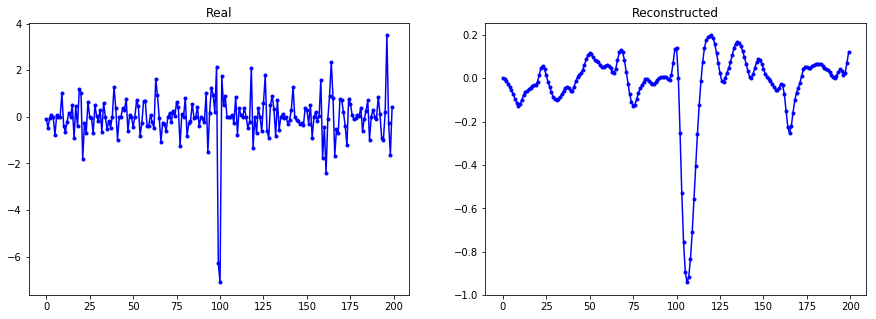

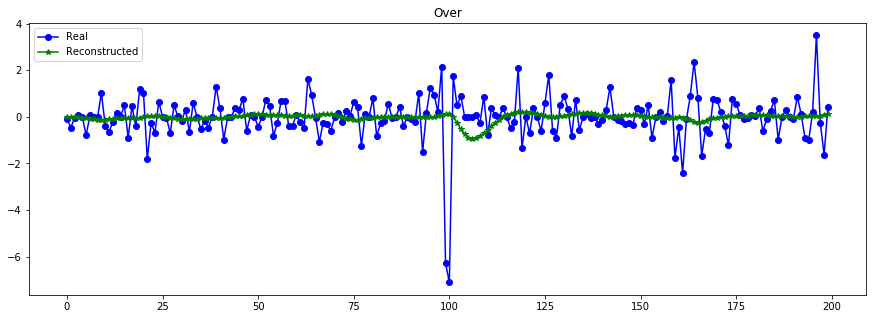

----------------------------------------------------------------


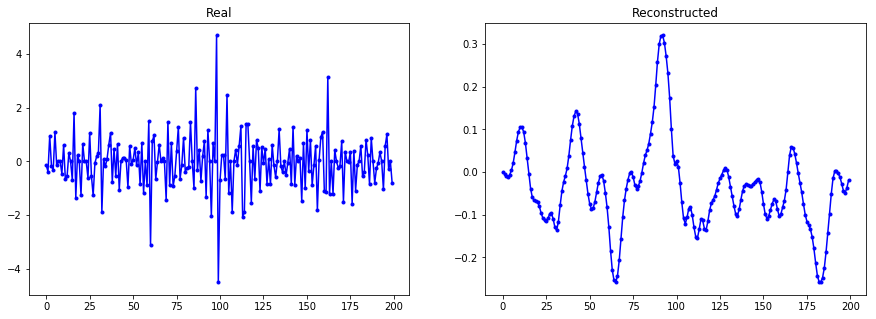

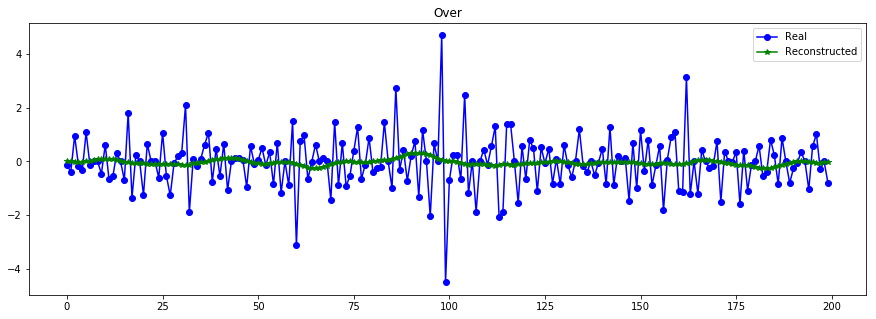

----------------------------------------------------------------


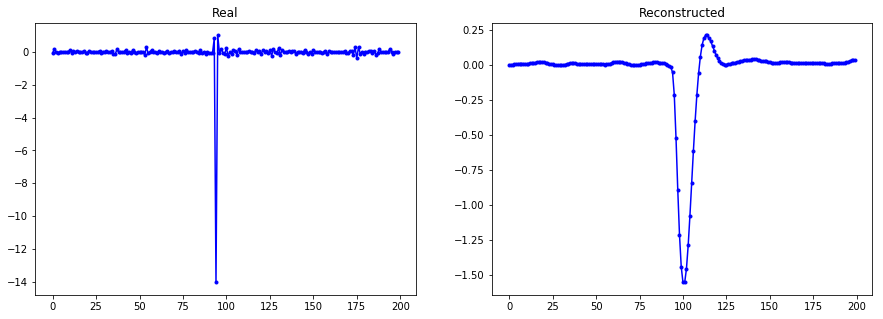

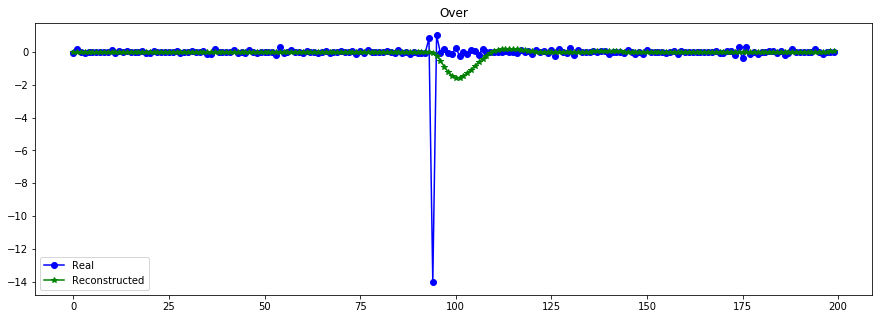

----------------------------------------------------------------


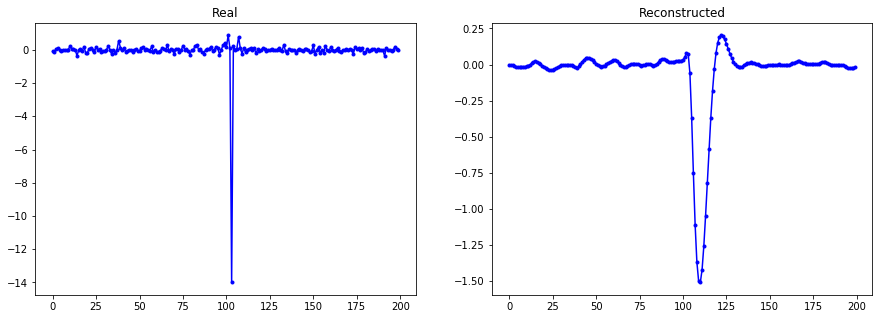

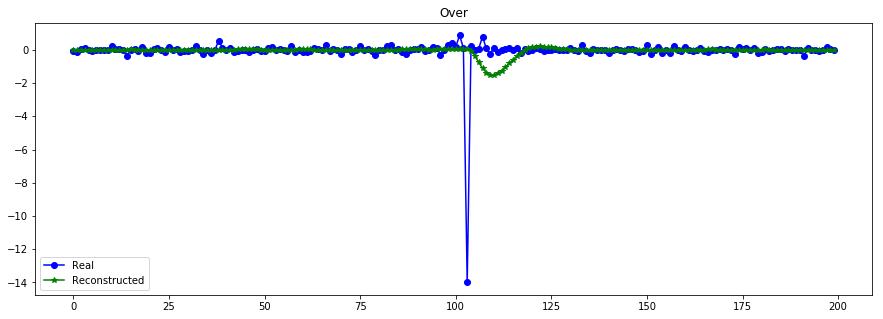

----------------------------------------------------------------


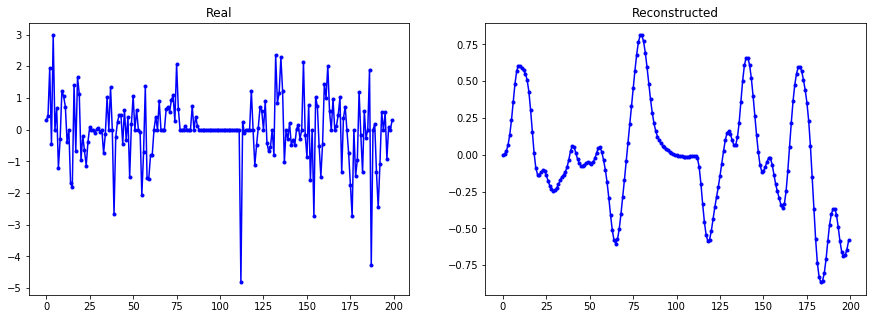

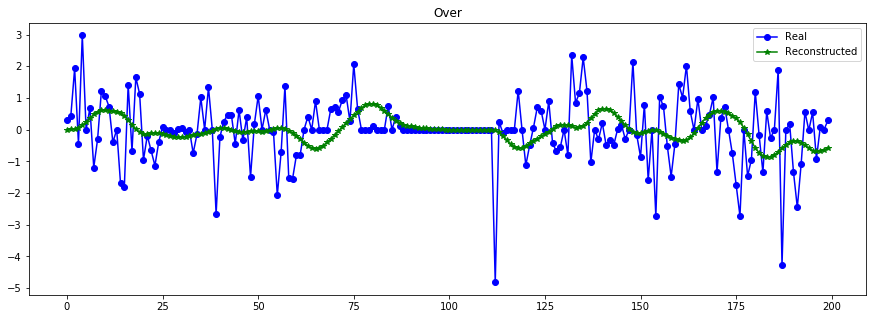

----------------------------------------------------------------


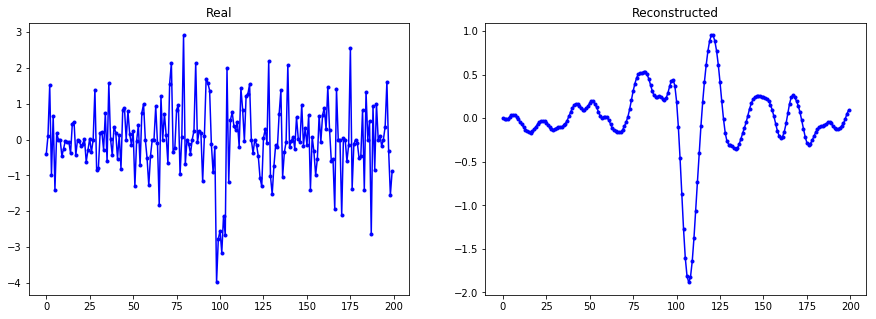

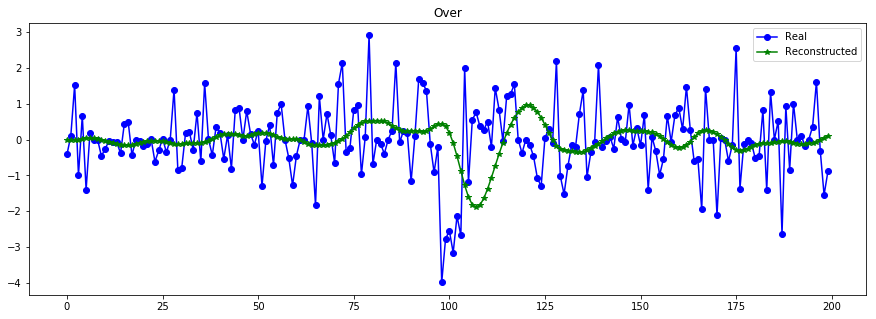

----------------------------------------------------------------


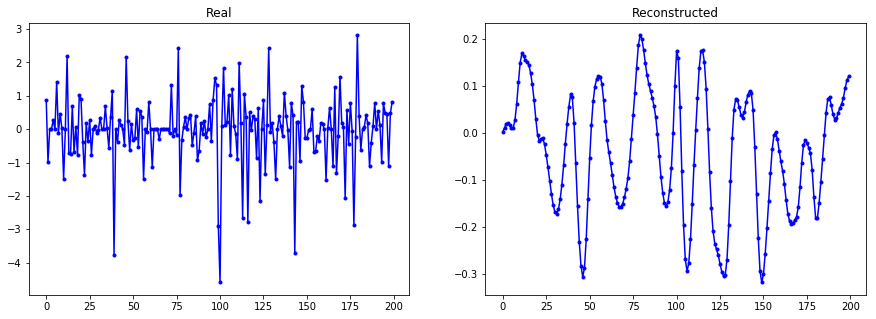

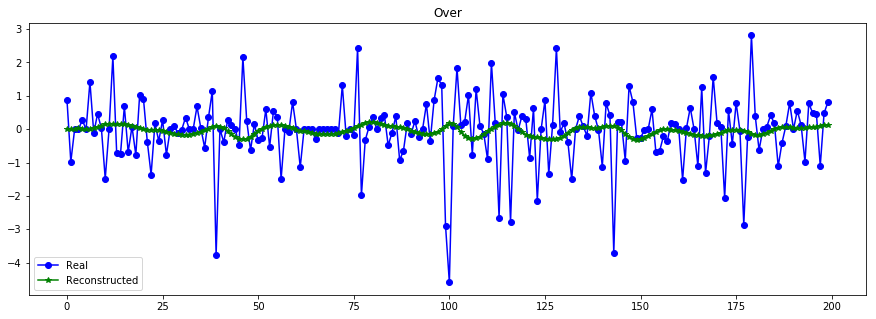

----------------------------------------------------------------


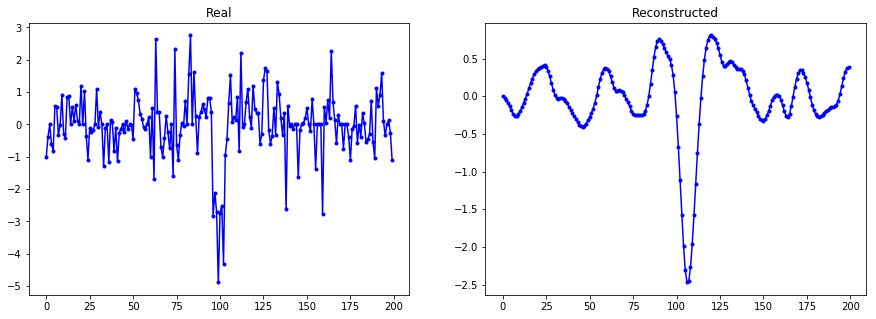

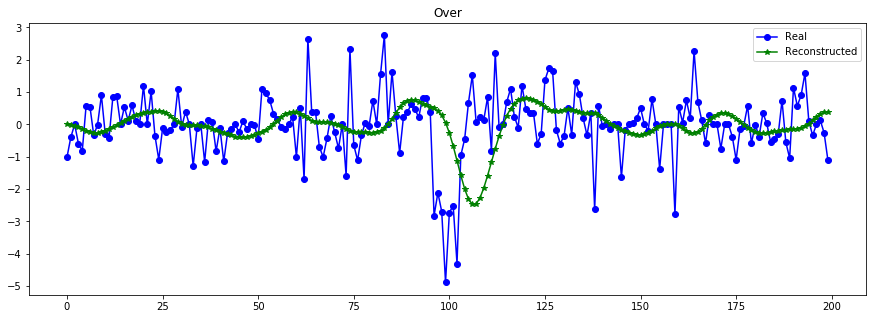

----------------------------------------------------------------


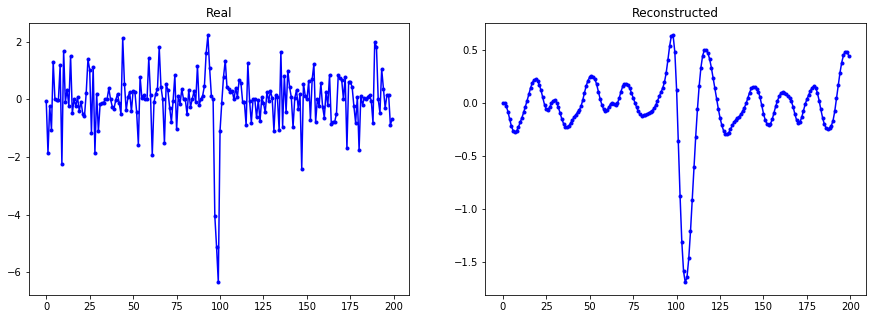

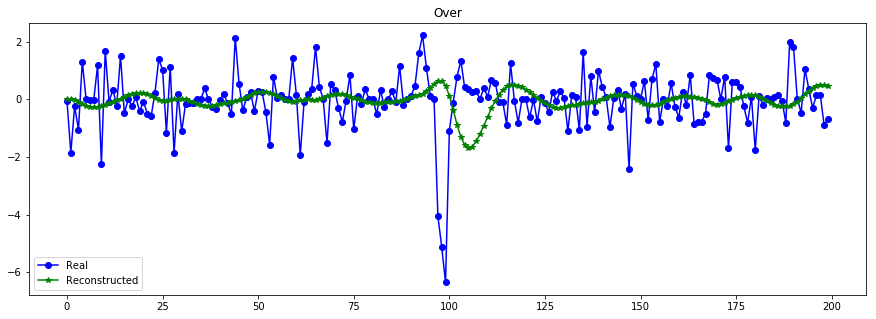

----------------------------------------------------------------


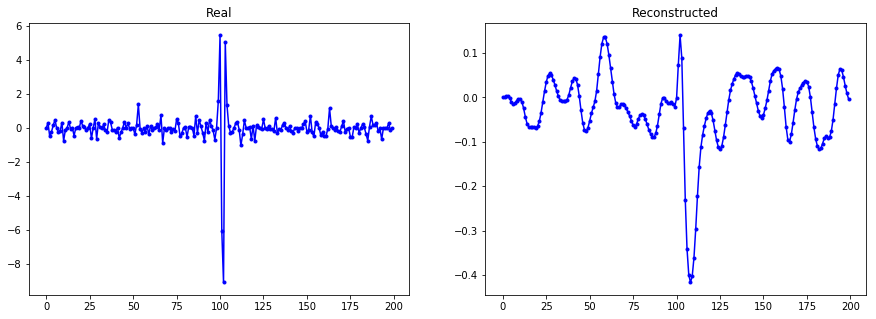

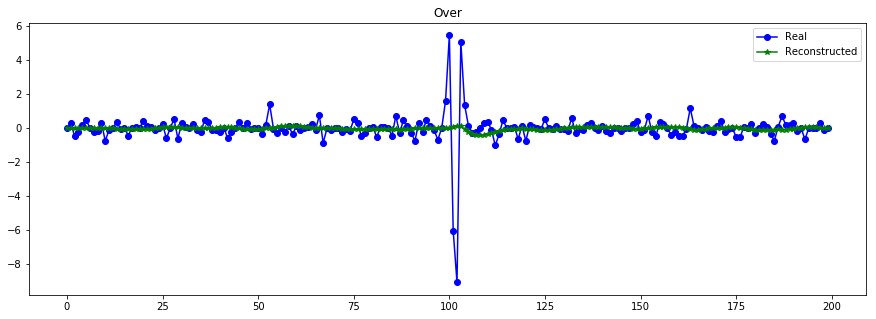

----------------------------------------------------------------


In [161]:
plot_n_lc(X_train[:,:,0], X_train_filter, n= 10)

In [ ]:
## un metodo de denoising borraria los transitos...


In [128]:
df = pd.DataFrame(X_train[:,:,0])
df.head()

,0,1,2,3,4,5,6,7,8,9,...,190,191,192,193,194,195,196,197,198,199
0,-0.001590,-0.025528,-0.027490,-0.007376,0.071444,0.000000,-0.001159,-0.001858,-0.003290,-0.012983,...,-0.004612,0.000000,-0.016977,0.001322,-0.016613,-0.015197,0.000334,0.010448,0.017679,0.016550
1,0.923023,0.622175,-1.315577,-0.092240,0.074952,-0.757655,-1.198035,-0.173272,0.000000,0.586486,...,-1.069091,0.000000,0.056618,0.347644,0.431844,0.492213,-1.106873,0.610281,0.000000,0.318541
2,-0.602360,1.278955,-0.346153,-0.131274,0.484661,0.976514,-0.967190,-0.370055,0.000000,-0.528061,...,0.000000,0.184454,0.210683,-1.084544,0.830202,-0.265806,-0.307078,0.000000,0.000000,0.000000
3,0.003934,-0.004337,0.049863,0.059361,0.034746,0.198219,-0.004092,0.082151,0.063270,0.096195,...,-0.028894,0.000000,-0.080536,0.000000,0.052542,-0.028218,0.000000,0.045424,-0.032743,-0.059767
4,-0.495306,0.161124,0.000000,-0.107549,0.000000,1.507745,-0.404227,0.000000,-1.180275,0.261397,...,-0.624675,-0.707173,0.324012,0.000000,0.000000,-0.069399,-1.764951,2.325822,0.023251,-0.549276


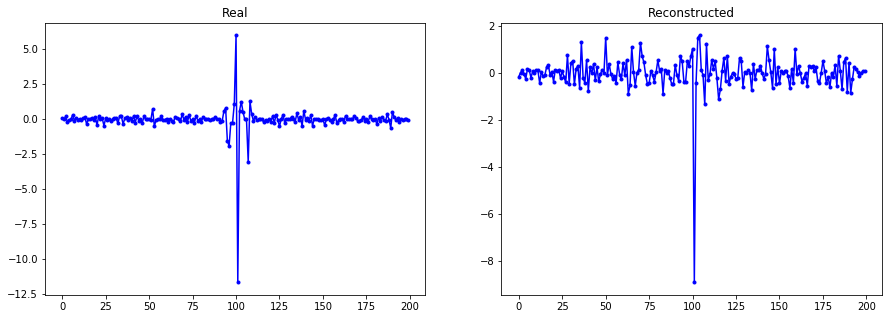

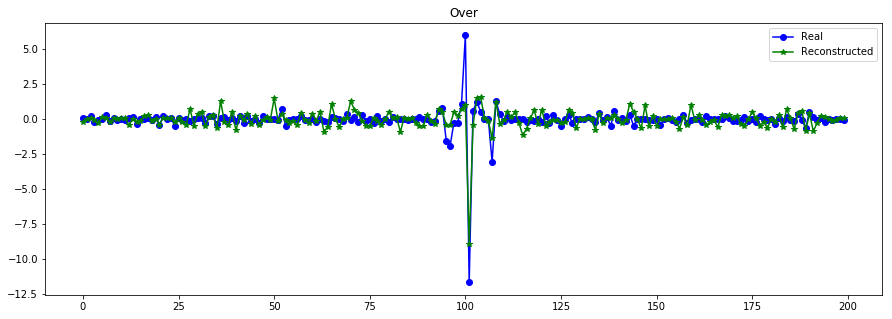

----------------------------------------------------------------


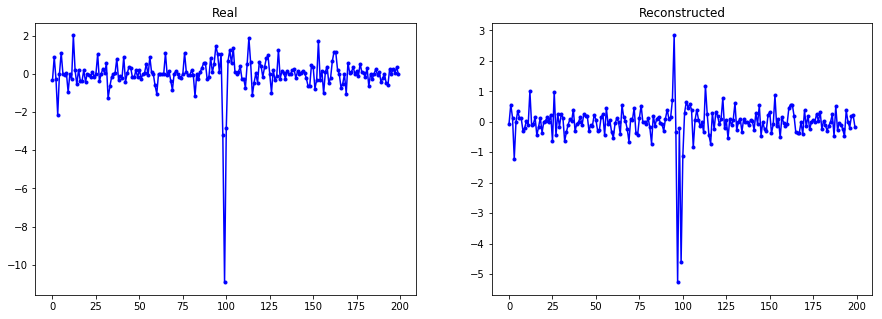

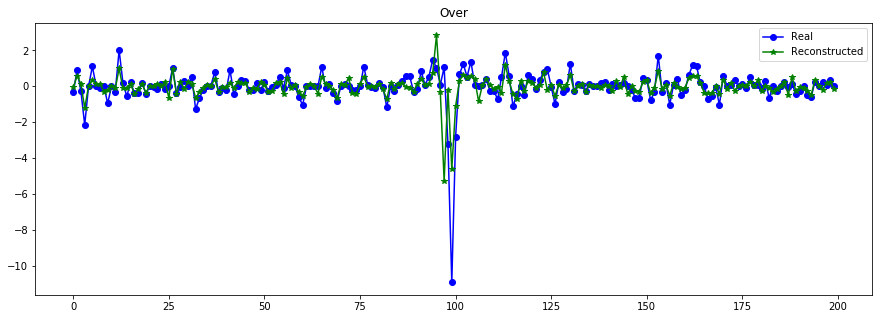

----------------------------------------------------------------


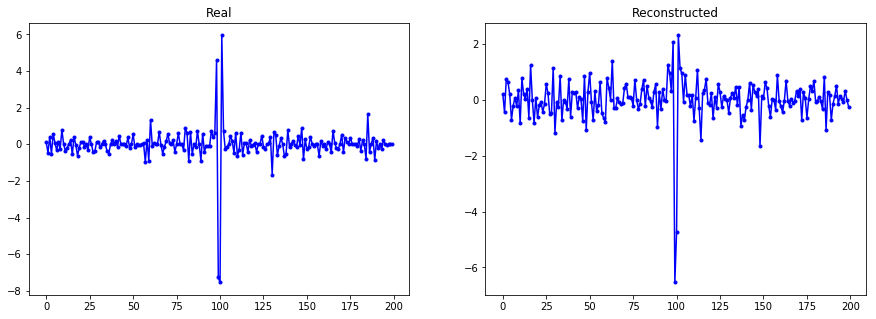

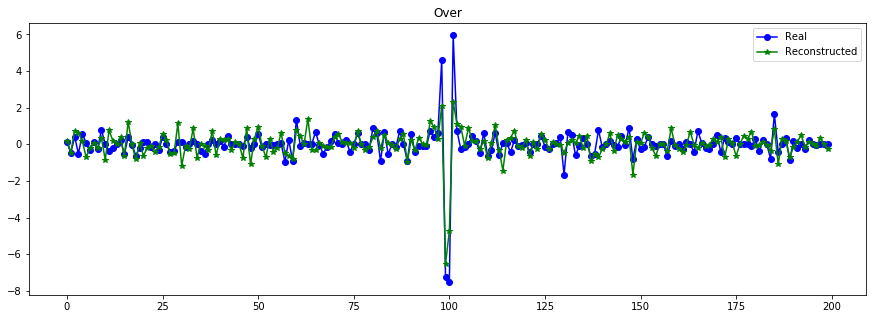

----------------------------------------------------------------


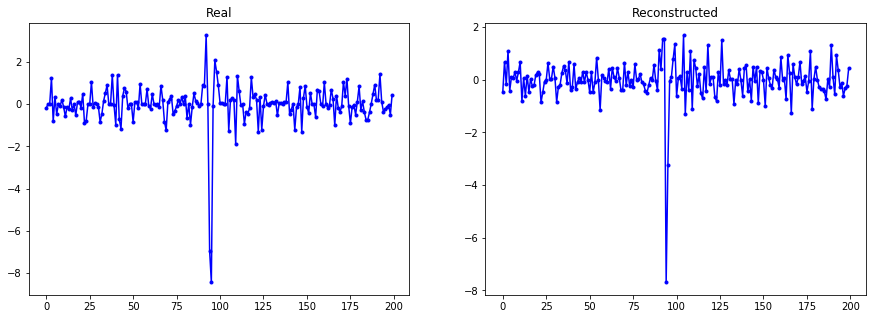

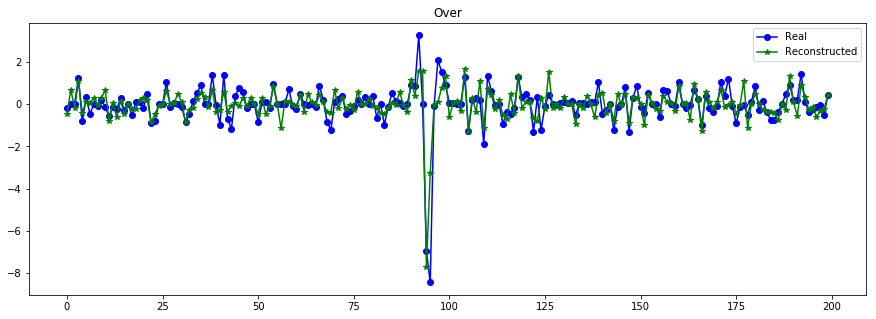

----------------------------------------------------------------


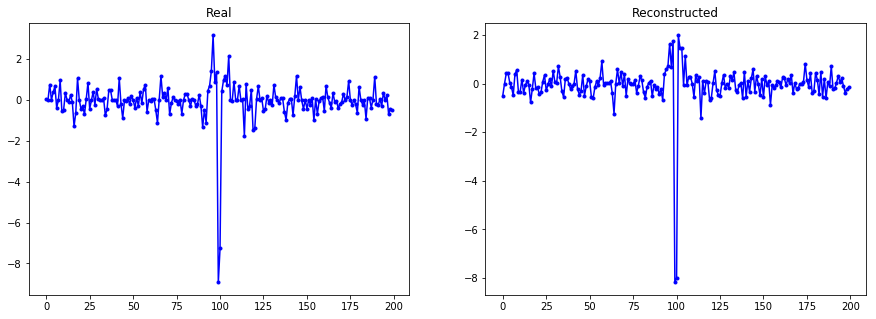

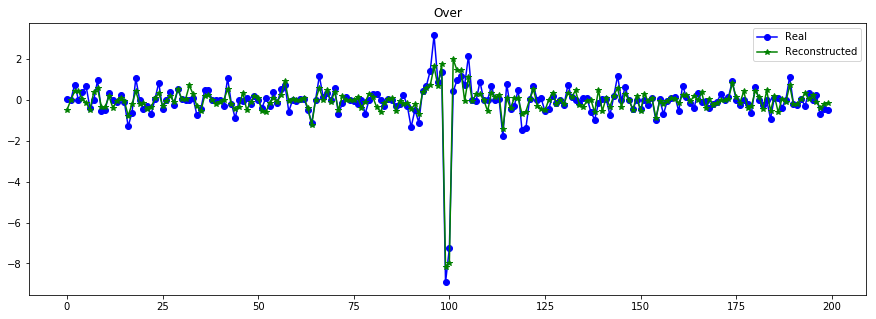

----------------------------------------------------------------


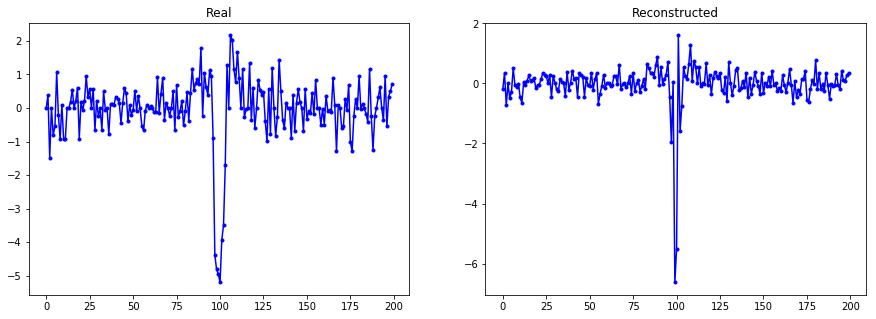

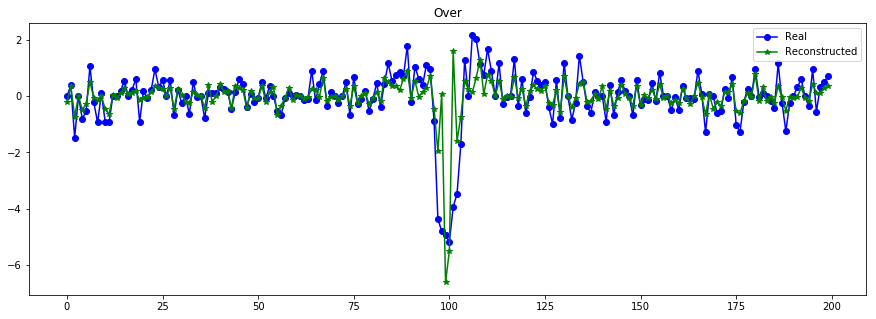

----------------------------------------------------------------


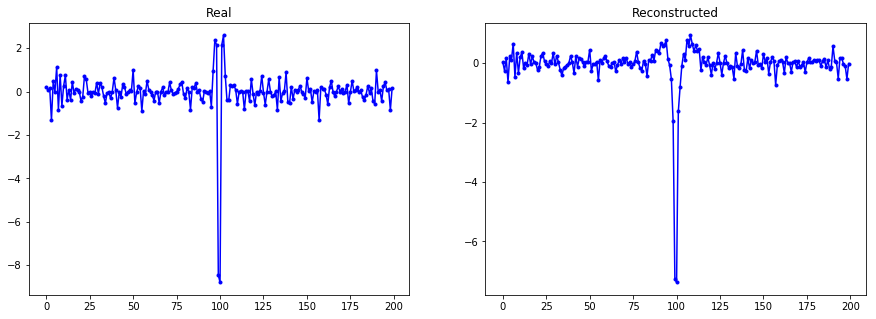

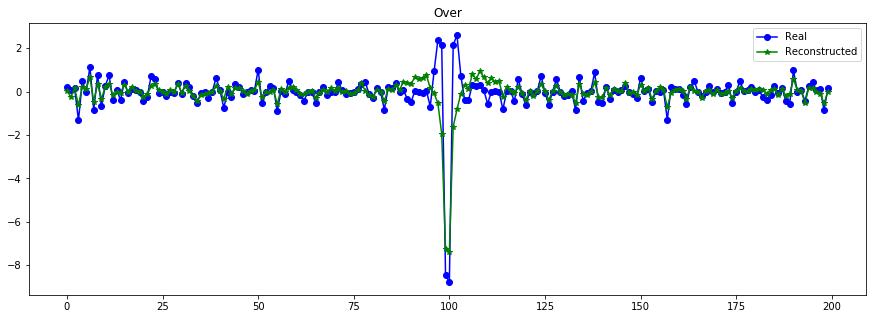

----------------------------------------------------------------


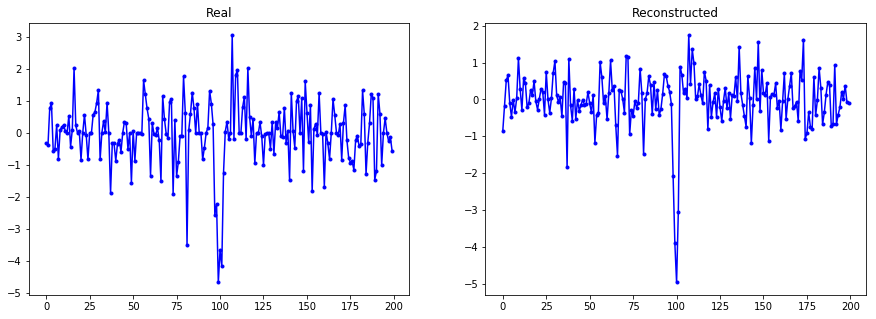

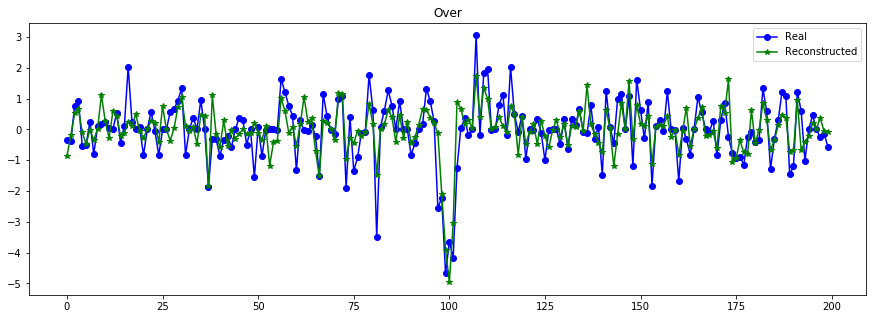

----------------------------------------------------------------


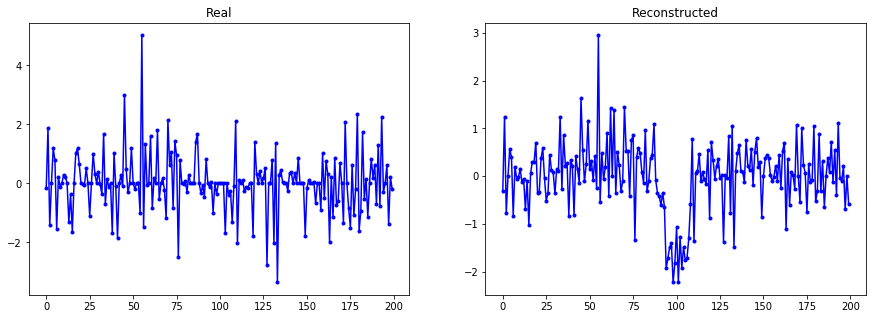

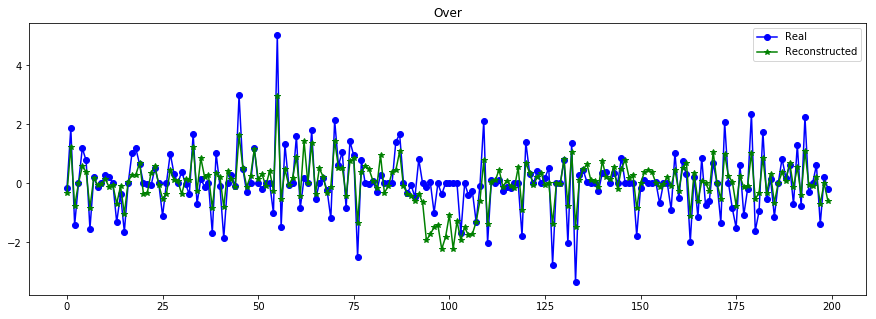

----------------------------------------------------------------


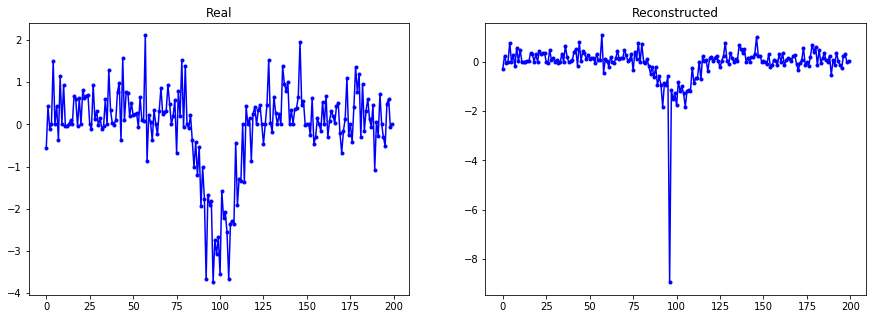

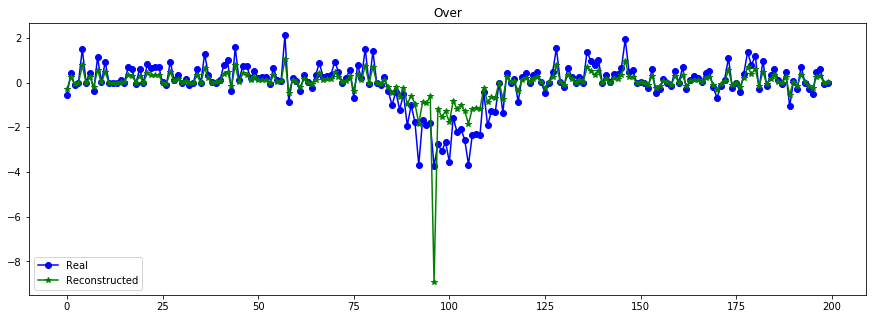

----------------------------------------------------------------


In [131]:
X_train_filter = df.rolling(window=2).mean().values
plot_n_lc(X_train[:,:,0], X_train_filter, n= 10)

1048/1048 [==============================] - 0s 349us/step
Errores  [137.3857623384199, 33.87695868688685, 0.6699903570968686]


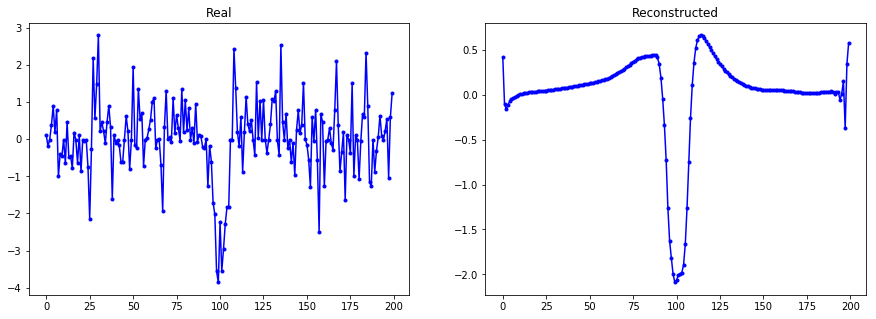

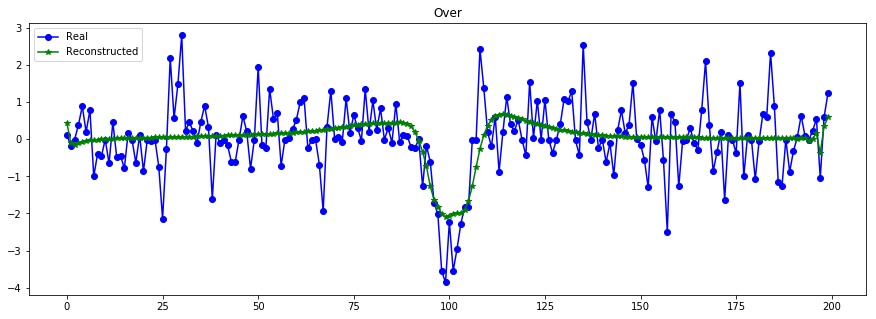

----------------------------------------------------------------


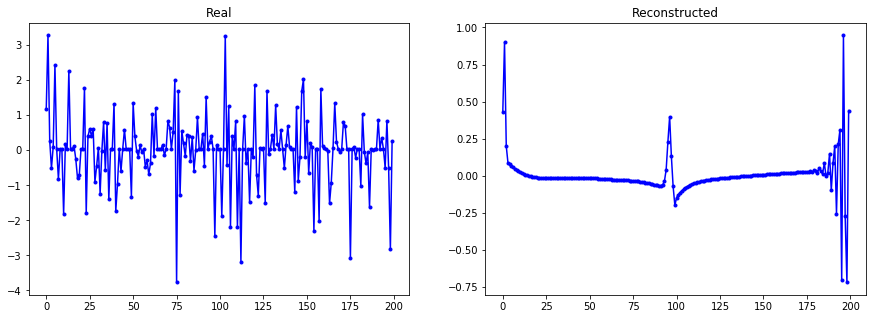

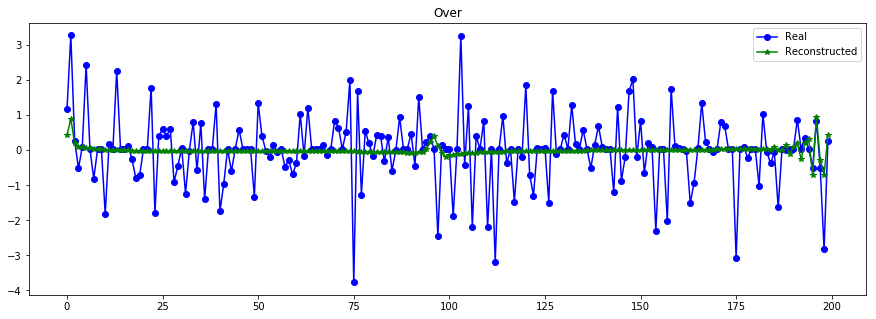

----------------------------------------------------------------


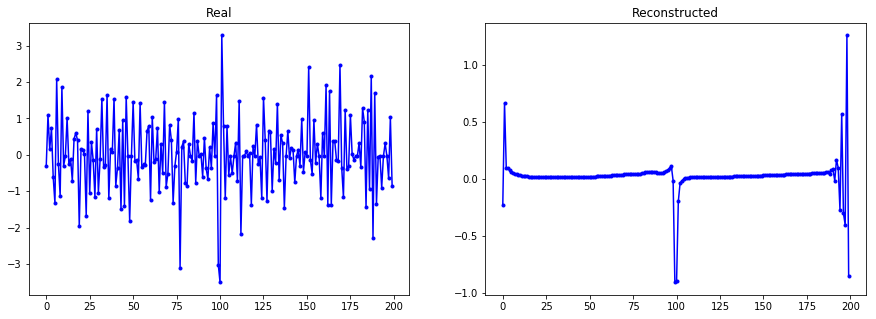

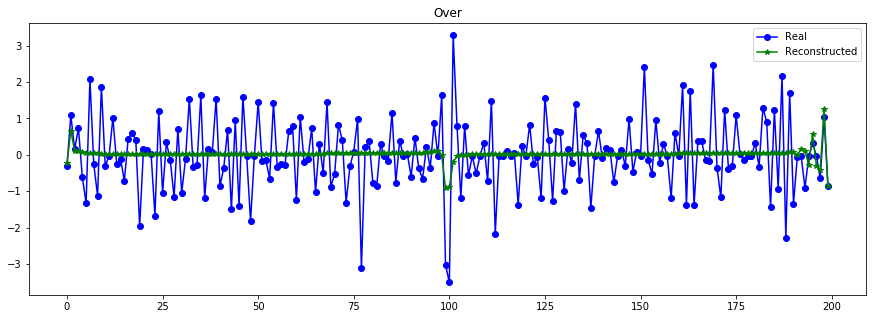

----------------------------------------------------------------


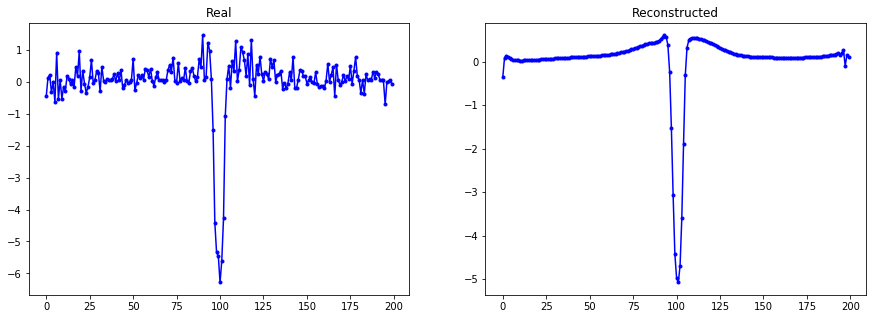

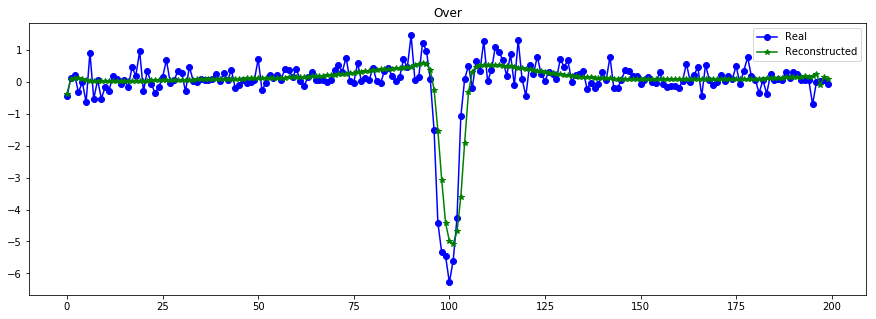

----------------------------------------------------------------


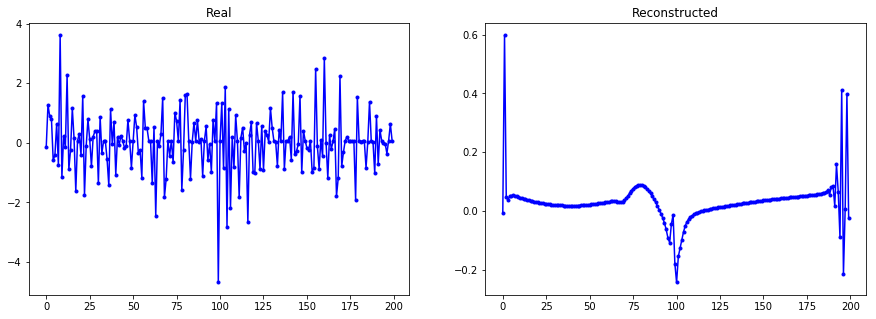

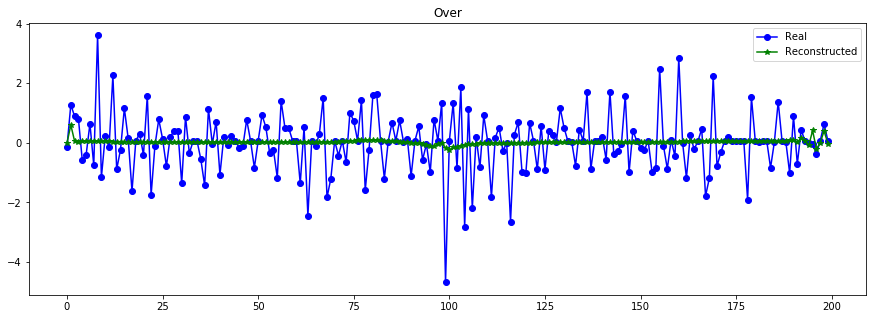

----------------------------------------------------------------


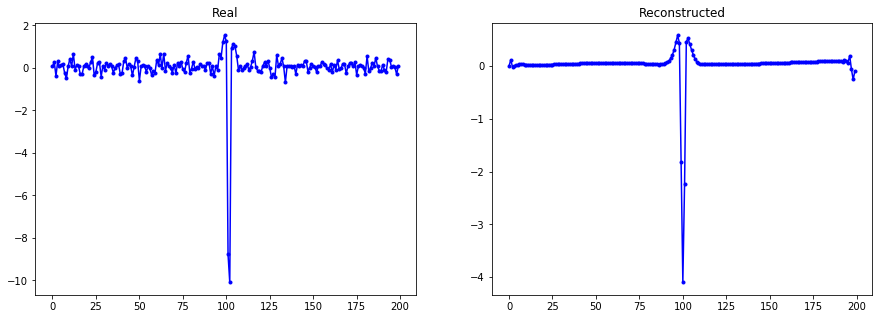

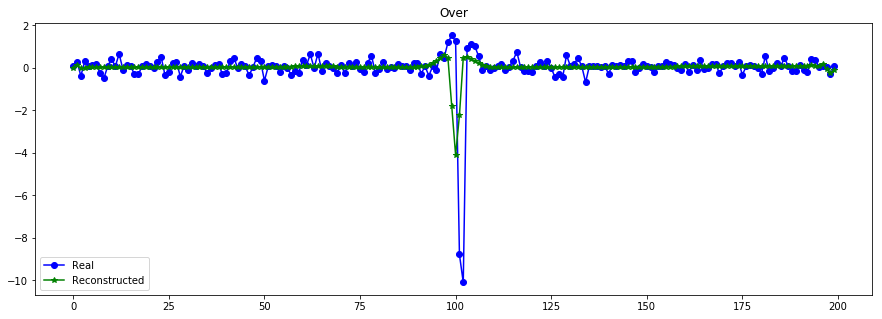

----------------------------------------------------------------


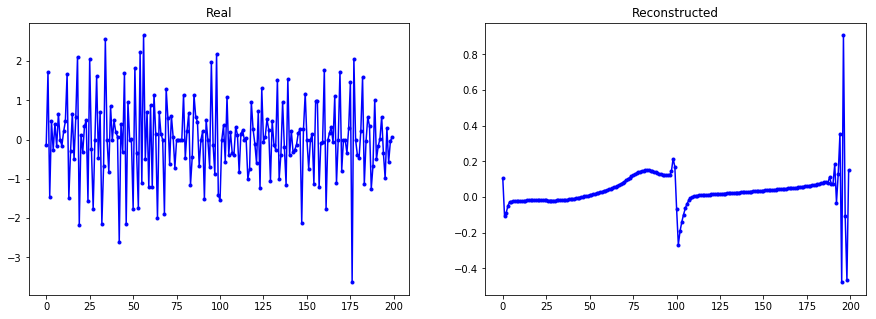

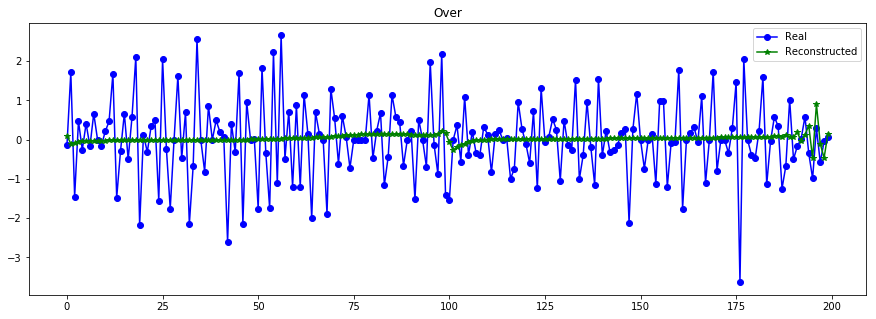

----------------------------------------------------------------


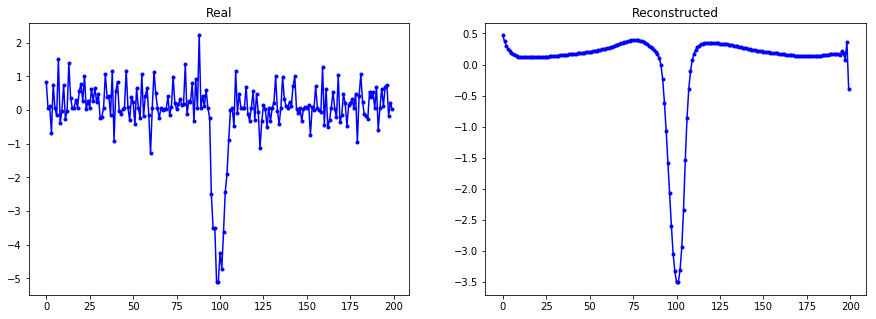

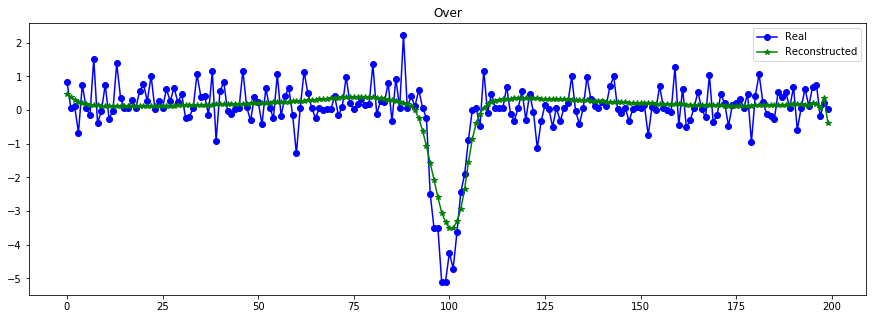

----------------------------------------------------------------


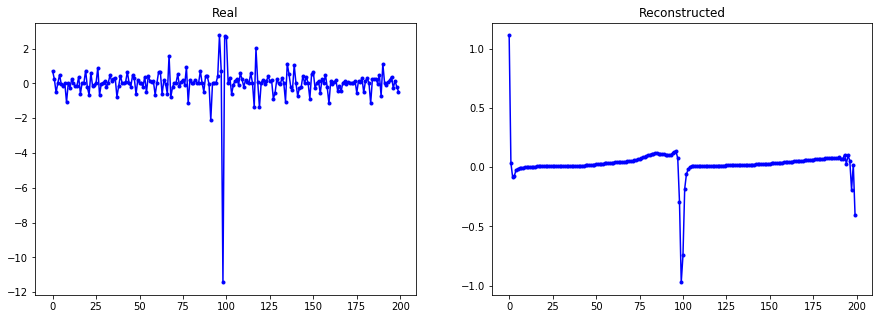

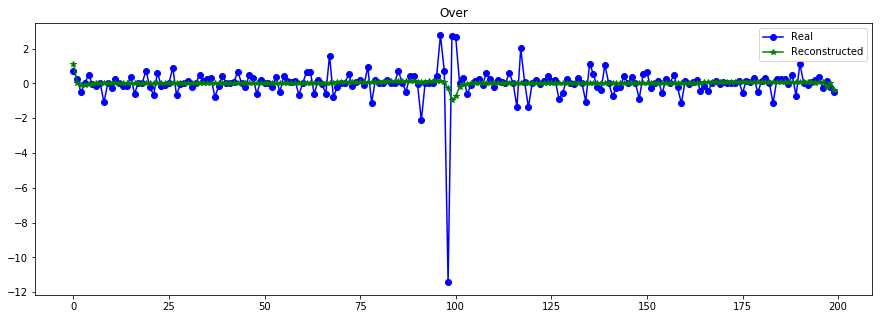

----------------------------------------------------------------


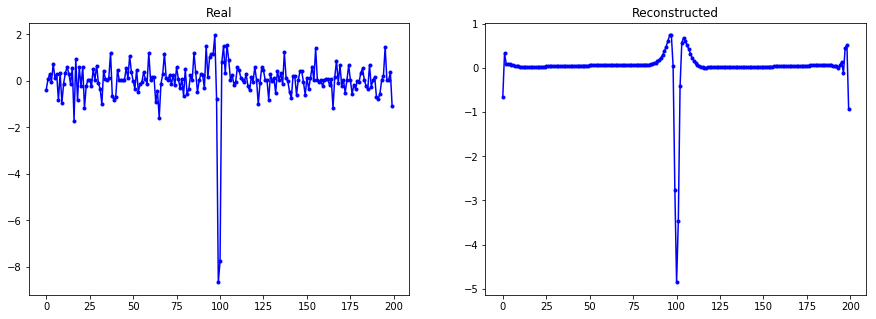

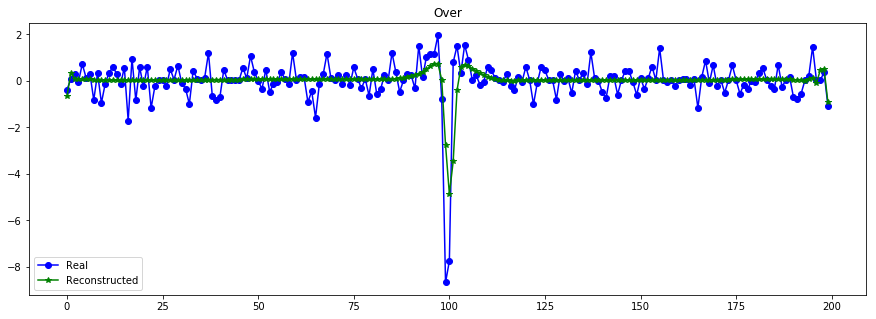

----------------------------------------------------------------


In [17]:
print("Errores ",vae.evaluate([X_test_t,X_test], X_test, batch_size=512))
X_train_hat = vae.predict([X_train_t,X_train], batch_size=512)
plot_n_lc(X_train[:,:,0], X_train_hat, n= 10) ###con 200 epochs T=200 global (CURVAS TRANSITO) std rep +KL(0.1)

1100/1100 [==============================] - 1s 577us/step
Errores  [269.91815795898435, 53.60177388971502, 0.6613950133323669]


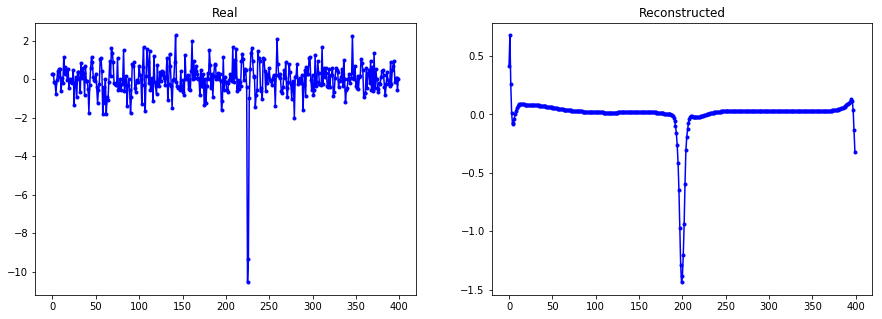

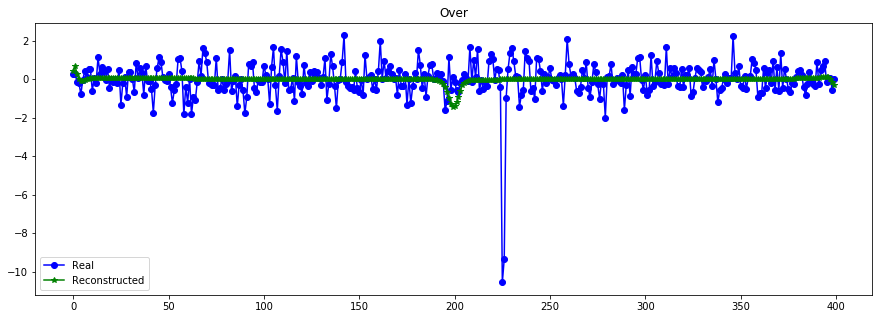

----------------------------------------------------------------


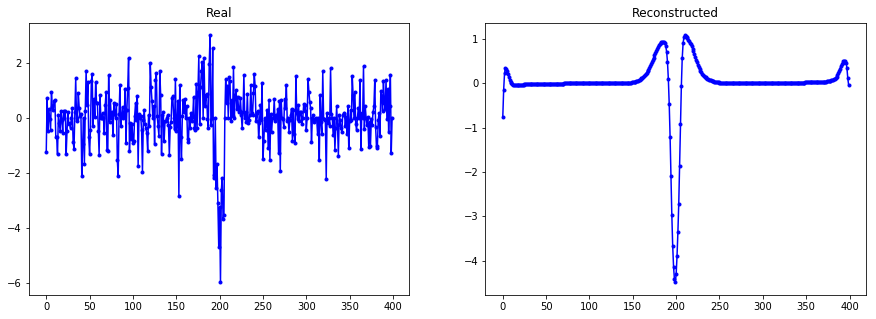

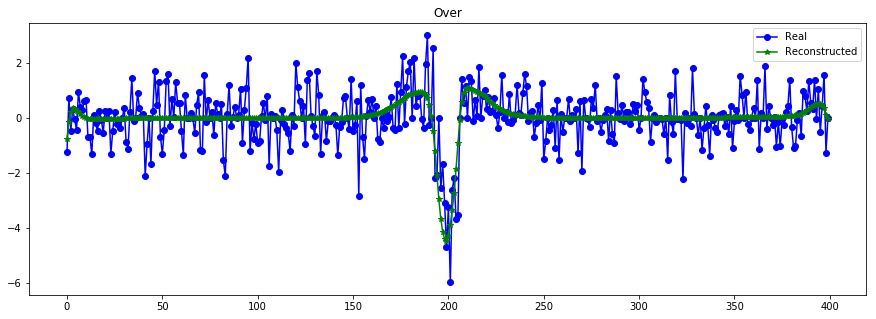

----------------------------------------------------------------


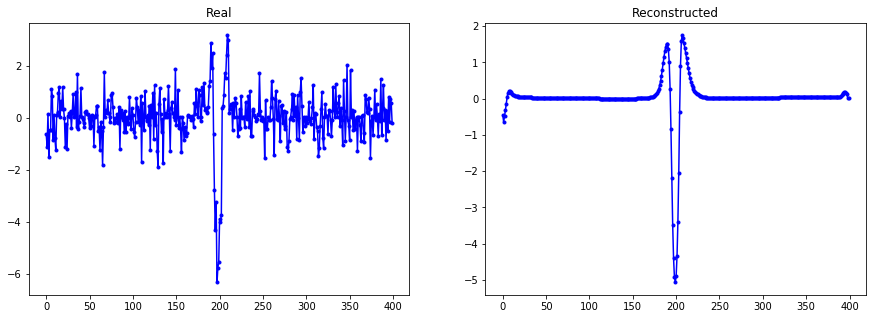

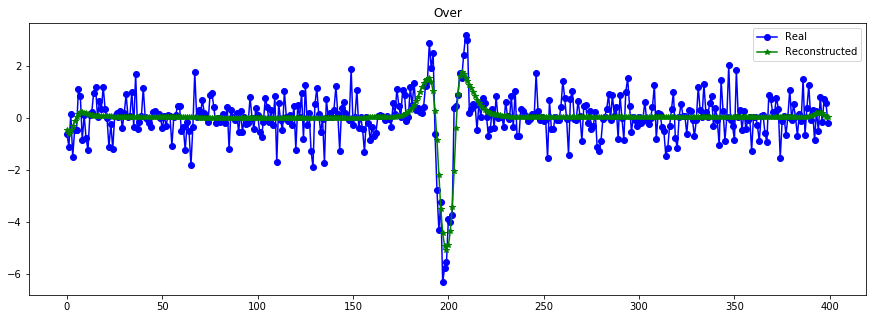

----------------------------------------------------------------


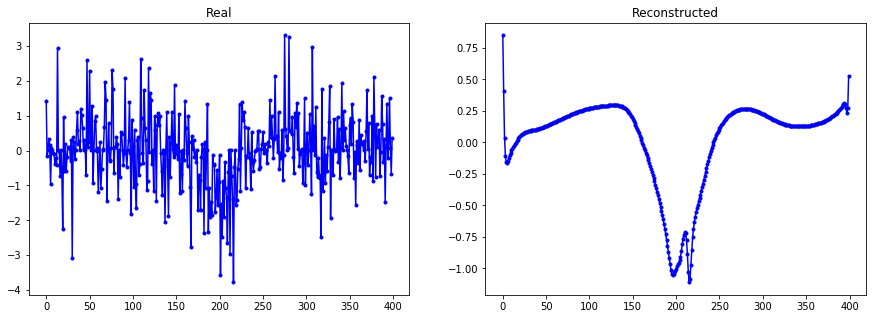

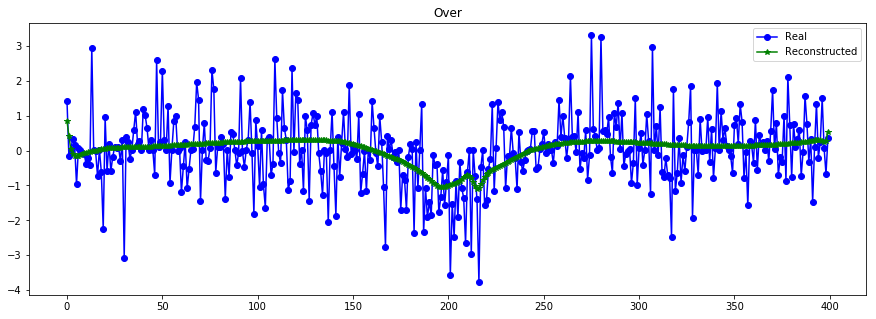

----------------------------------------------------------------


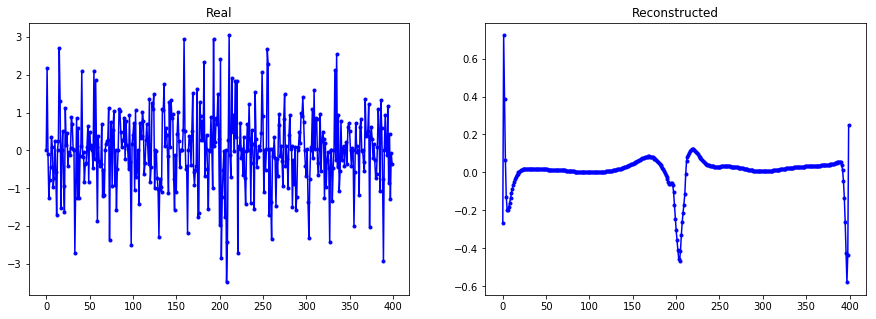

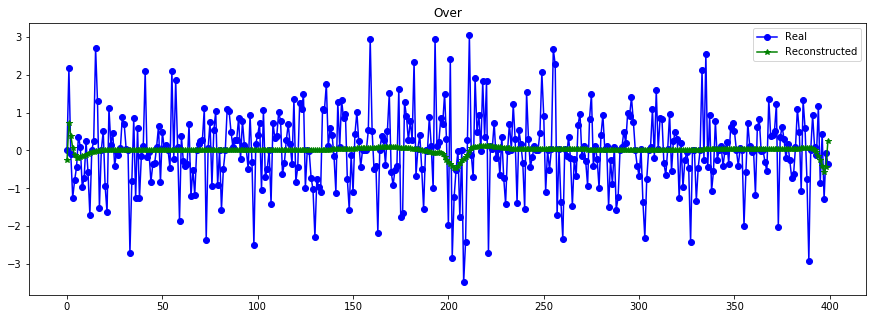

----------------------------------------------------------------


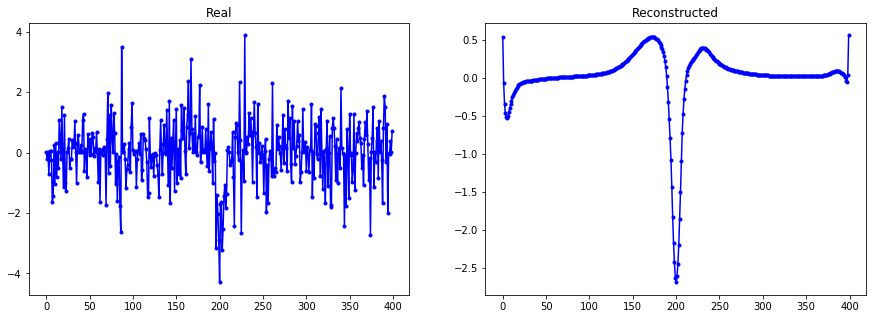

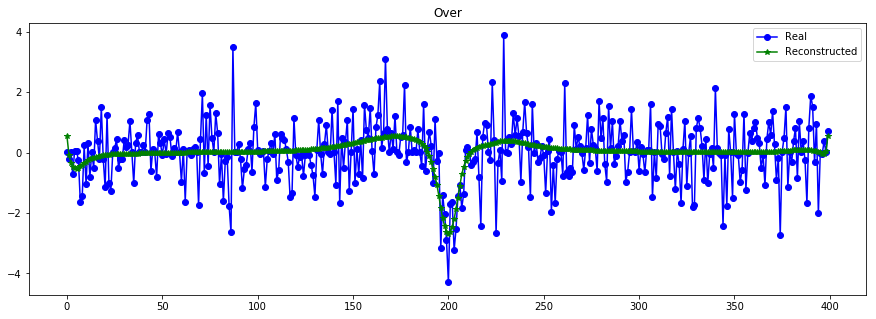

----------------------------------------------------------------


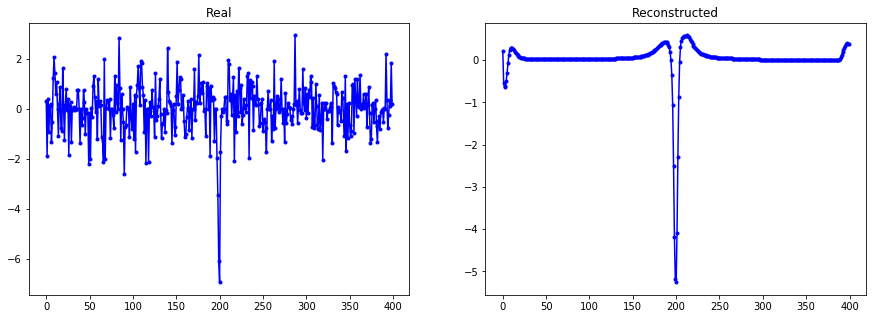

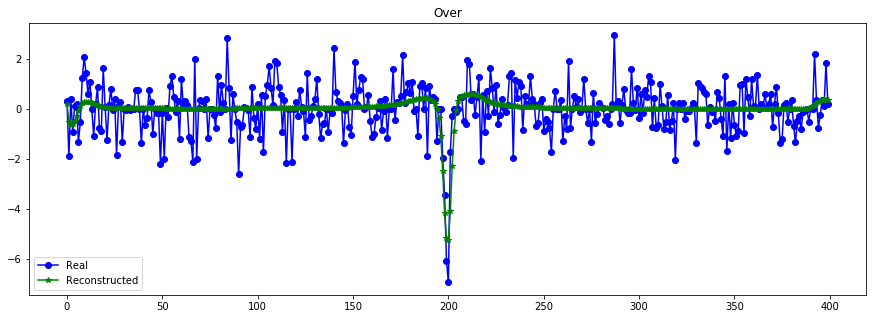

----------------------------------------------------------------


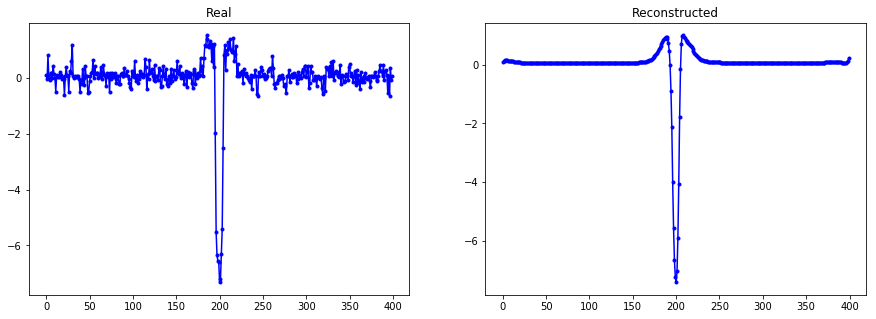

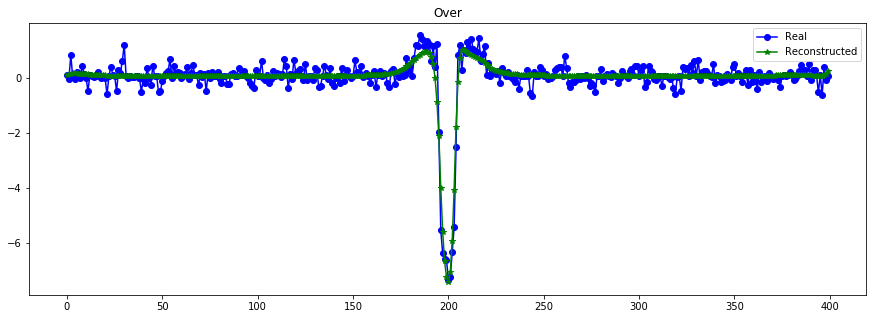

----------------------------------------------------------------


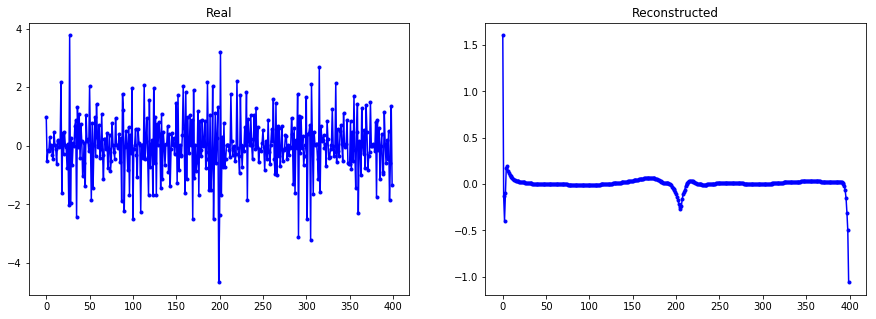

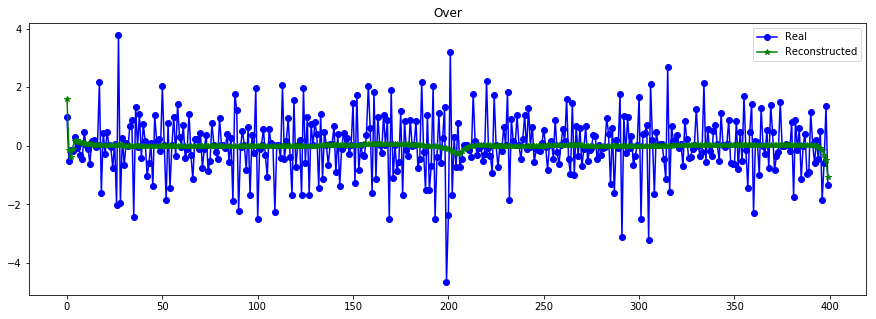

----------------------------------------------------------------


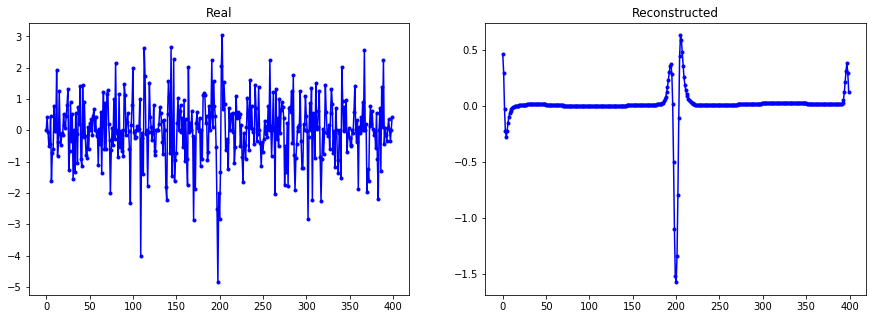

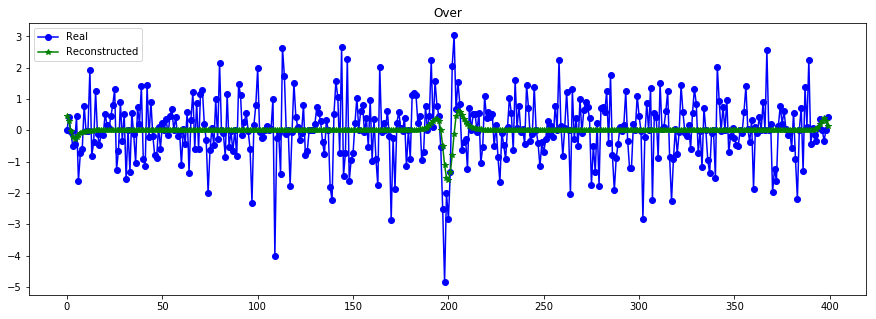

----------------------------------------------------------------


In [34]:
print("Errores ",vae.evaluate([X_test_t,X_test], X_test, batch_size=512))
X_train_hat = vae.predict([X_train_t,X_train], batch_size=512)
plot_n_lc(X_train[:,:,0], X_train_hat, n= 10) #con T=400 epochs

### KL 0.01

In [471]:
x_lc = Input(shape = (T, channels) , name="LC_inp")
x_t = Input(shape = (T, 1) , name ="T_inp")

x = Concatenate(axis=-1)([x_t, x_lc]) #add time encode

f1 = Bidirectional(CuDNNGRU(64, return_sequences=True))(x) #bidirectional
f1 = Bidirectional(CuDNNGRU(64, return_sequences=False))(f1) #bidirectional

z_mean = Dense(latent_dim,activation='linear')(f1)
z_log_var = Dense(latent_dim,activation='linear')(f1)

encoder = Model([x_t, x_lc], z_mean, name="encoder")
z = Lambda(sampling, output_shape=(latent_dim,), name='sample')([z_mean, z_log_var])
samp_encoder = Model([x_t, x_lc], z, name="encoder_sampling")


decoder_input = Input(shape=(latent_dim,))

#decode = Dense(latent_dim, activation='relu')(decoder_input)
decode = RepeatVector(T)(decoder_input)

decode = Concatenate(axis=-1)([x_t, decode]) #add time decode

decode = Bidirectional(CuDNNGRU(64, return_sequences=True))(decode) #bidirectional
decode = Bidirectional(CuDNNGRU(64, return_sequences=True))(decode) #bidirectional

decode = TimeDistributed(Dense(1, activation='linear'))(decode)
generator = Model([x_t, decoder_input], decode, name="generator")

# instantiate VAE model
out = generator([x_t, samp_encoder([x_t, x_lc]) ])
vae = Model([x_t, x_lc], out)

vae.compile(optimizer='adam', loss=vae_loss, metrics = [KL_loss, MSE_loss])
vae.summary()

batch_size = 64
vae.fit([X_train_t,X_train], X_train, epochs=200, batch_size=batch_size, 
        validation_data=([X_test_t,X_test], X_test))

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
T_inp (InputLayer)              (None, 200, 1)       0                                            
__________________________________________________________________________________________________
LC_inp (InputLayer)             (None, 200, 1)       0                                            
__________________________________________________________________________________________________
encoder_sampling (Model)        (None, 32)           108864      T_inp[0][0]                      
                                                                 LC_inp[0][0]                     
__________________________________________________________________________________________________
generator (Model)               (None, 200, 1)       112641      T_inp[0][0]                      
          

8634/8634 [==============================] - 18s 2ms/step - loss: 0.7439 - KL_loss: 1.9182 - MSE_loss: 0.7247
Epoch 122/500
8634/8634 [==============================] - 18s 2ms/step - loss: 0.7231 - KL_loss: 1.8610 - MSE_loss: 0.7045
Epoch 123/500
8634/8634 [==============================] - 18s 2ms/step - loss: 0.6858 - KL_loss: 2.0622 - MSE_loss: 0.6652
Epoch 124/500
8634/8634 [==============================] - 18s 2ms/step - loss: 0.6865 - KL_loss: 2.1830 - MSE_loss: 0.6647
Epoch 125/500
8634/8634 [==============================] - 18s 2ms/step - loss: 0.6861 - KL_loss: 2.0760 - MSE_loss: 0.6654
Epoch 126/500
8634/8634 [==============================] - 18s 2ms/step - loss: 0.7546 - KL_loss: 1.7916 - MSE_loss: 0.7367
Epoch 127/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.6881 - KL_loss: 2.0044 - MSE_loss: 0.6681
Epoch 128/500
8634/8634 [==============================] - 18s 2ms/step - loss: 0.6890 - KL_loss: 2.0371 - MSE_loss: 0.6686
Epoch 129/500
8634/863

8634/8634 [==============================] - 18s 2ms/step - loss: 0.6998 - KL_loss: 1.9996 - MSE_loss: 0.6798
Epoch 254/500
8634/8634 [==============================] - 18s 2ms/step - loss: 0.7081 - KL_loss: 2.0126 - MSE_loss: 0.6879
Epoch 255/500
8634/8634 [==============================] - 18s 2ms/step - loss: 0.6827 - KL_loss: 2.0396 - MSE_loss: 0.6623
Epoch 256/500
8634/8634 [==============================] - 18s 2ms/step - loss: 0.6810 - KL_loss: 2.1130 - MSE_loss: 0.6598
Epoch 257/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.7031 - KL_loss: 2.0781 - MSE_loss: 0.6823
Epoch 258/500
8634/8634 [==============================] - 18s 2ms/step - loss: 0.7097 - KL_loss: 1.9257 - MSE_loss: 0.6904
Epoch 259/500
8634/8634 [==============================] - 18s 2ms/step - loss: 0.6774 - KL_loss: 2.0600 - MSE_loss: 0.6568
Epoch 260/500
8634/8634 [==============================] - 18s 2ms/step - loss: 0.7165 - KL_loss: 3.2881 - MSE_loss: 0.6836
Epoch 261/500
8634/863

8634/8634 [==============================] - 18s 2ms/step - loss: 0.8168 - KL_loss: 5.0413 - MSE_loss: 0.7664
Epoch 386/500
8634/8634 [==============================] - 18s 2ms/step - loss: 0.8049 - KL_loss: 5.0413 - MSE_loss: 0.7545
Epoch 387/500
8634/8634 [==============================] - 18s 2ms/step - loss: 0.7835 - KL_loss: 5.0413 - MSE_loss: 0.7331
Epoch 388/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.7821 - KL_loss: 5.0413 - MSE_loss: 0.7317
Epoch 389/500
8634/8634 [==============================] - 18s 2ms/step - loss: 0.7795 - KL_loss: 5.0413 - MSE_loss: 0.7291
Epoch 390/500
8634/8634 [==============================] - 18s 2ms/step - loss: 0.7744 - KL_loss: 5.0413 - MSE_loss: 0.7240
Epoch 391/500
8634/8634 [==============================] - 18s 2ms/step - loss: 0.7711 - KL_loss: 5.0413 - MSE_loss: 0.7207
Epoch 392/500
8634/8634 [==============================] - 18s 2ms/step - loss: 0.7685 - KL_loss: 5.0413 - MSE_loss: 0.7181
Epoch 393/500
8634/863

Errores  []


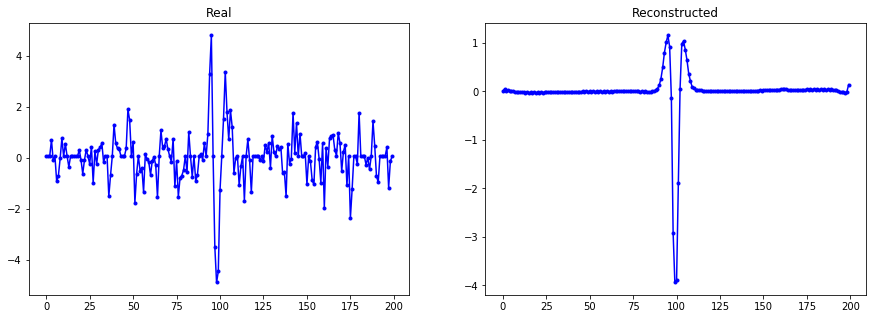

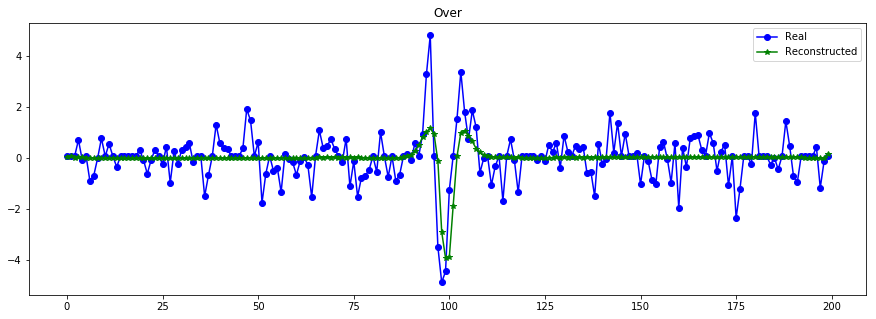

----------------------------------------------------------------


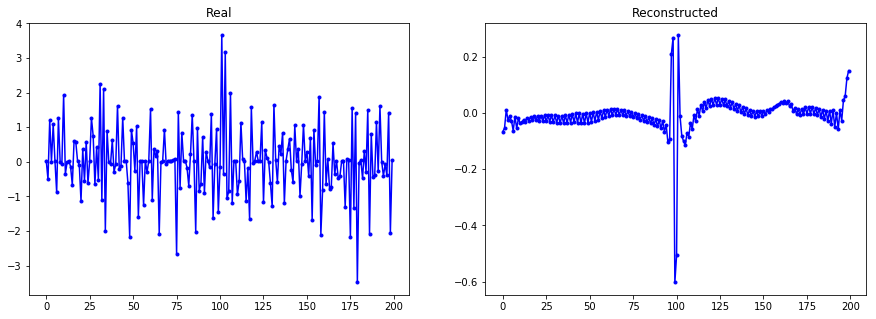

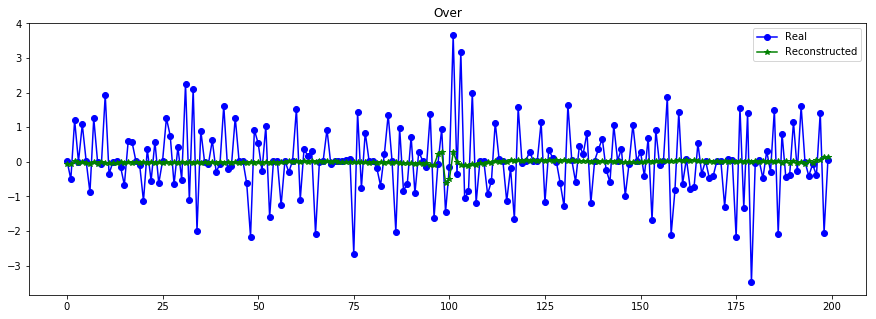

----------------------------------------------------------------


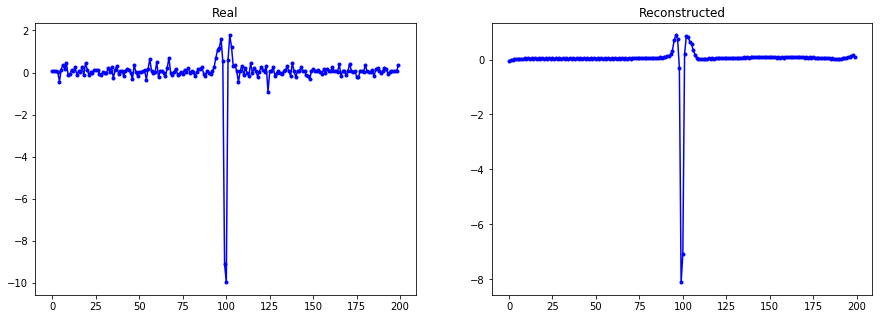

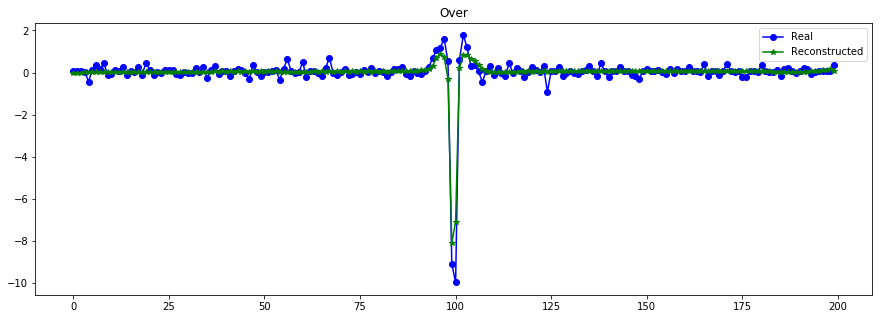

----------------------------------------------------------------


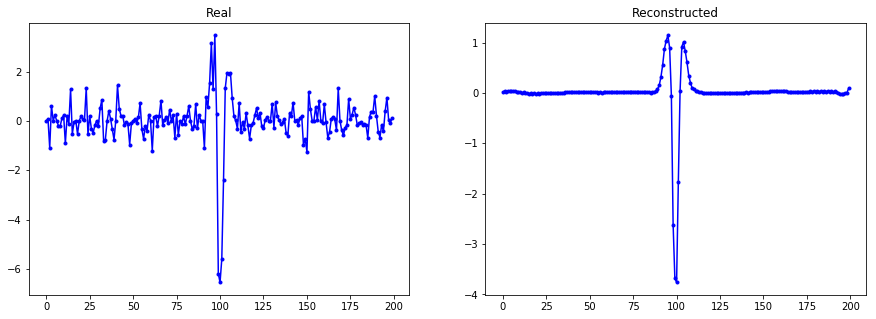

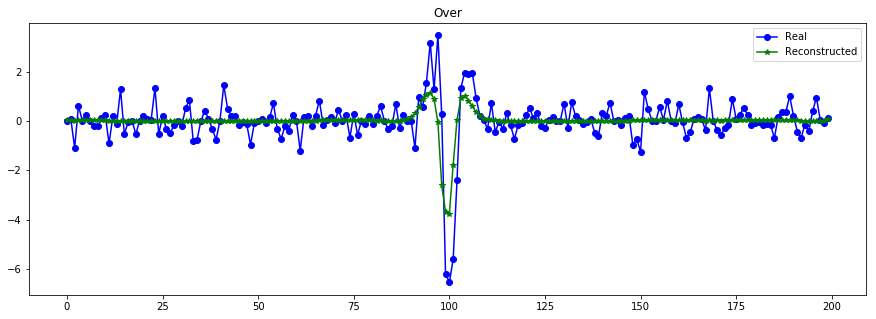

----------------------------------------------------------------


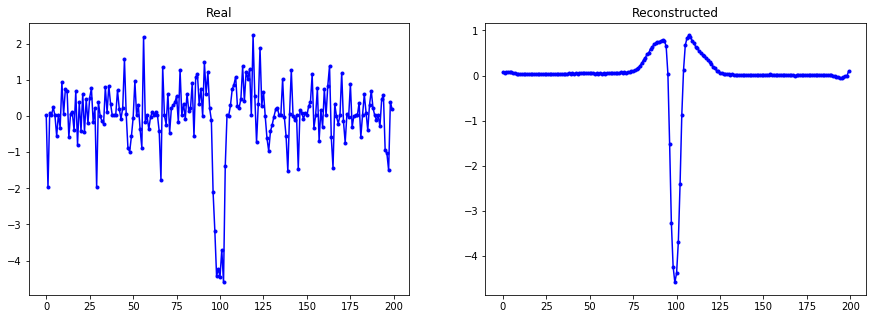

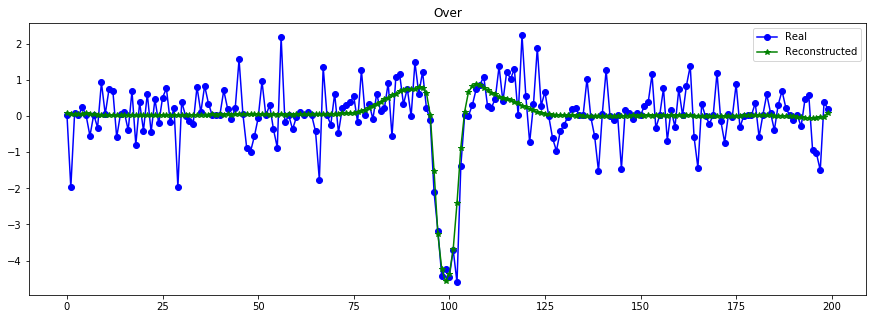

----------------------------------------------------------------


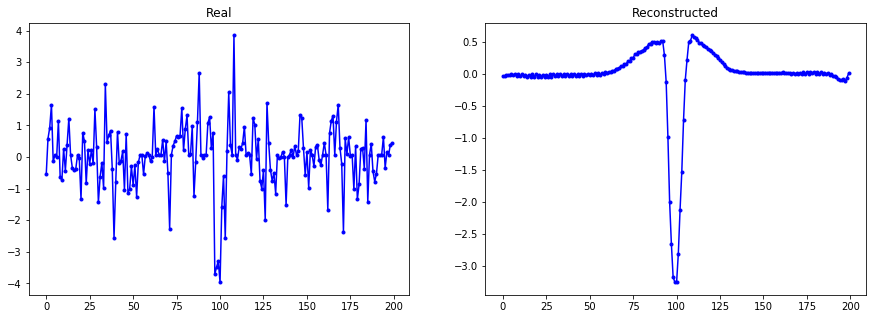

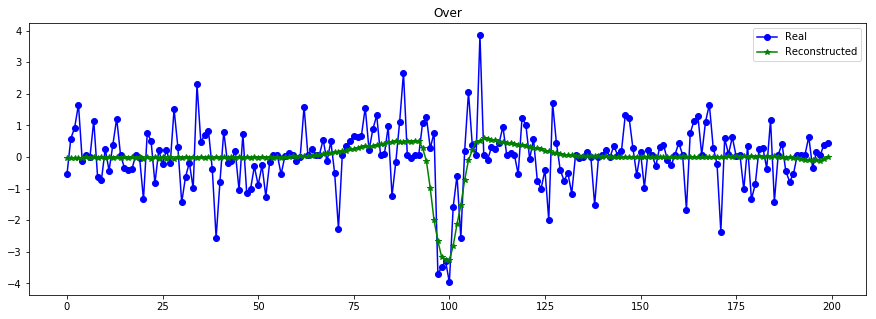

----------------------------------------------------------------


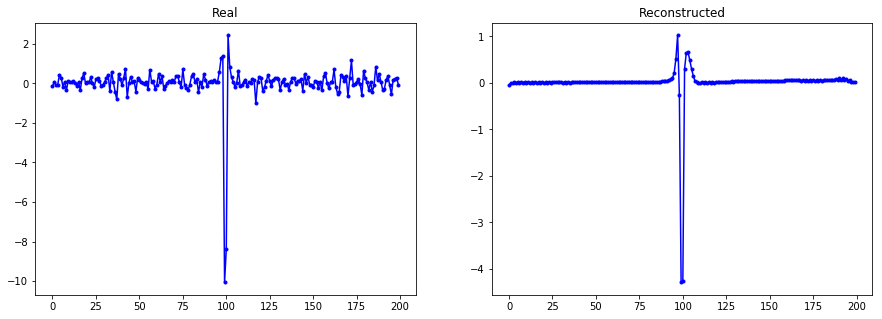

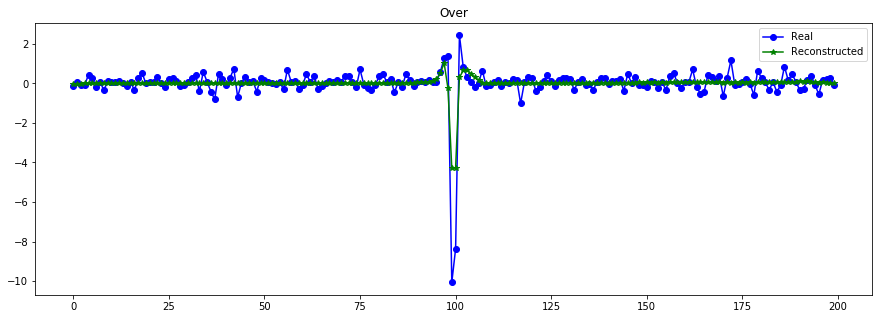

----------------------------------------------------------------


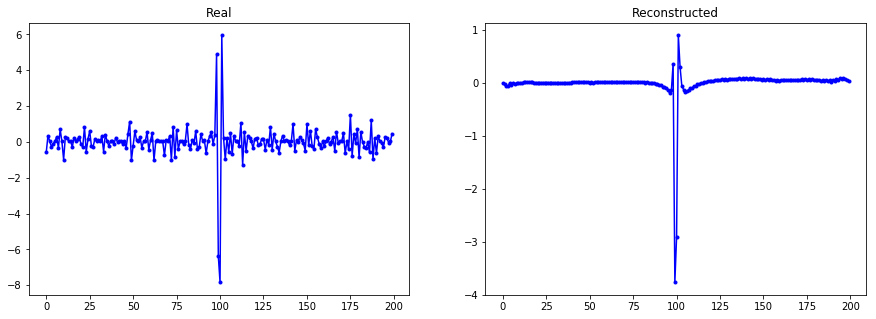

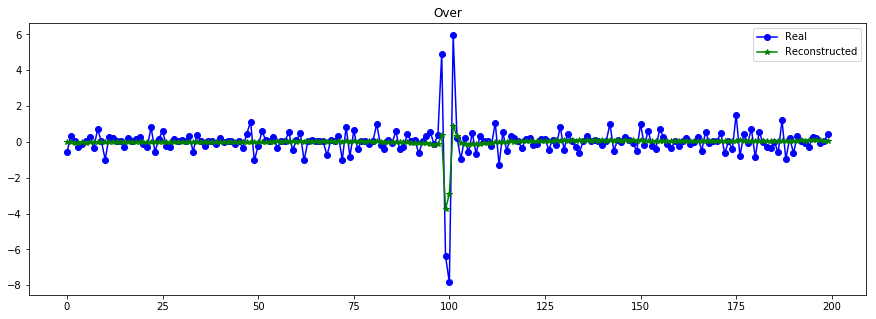

----------------------------------------------------------------


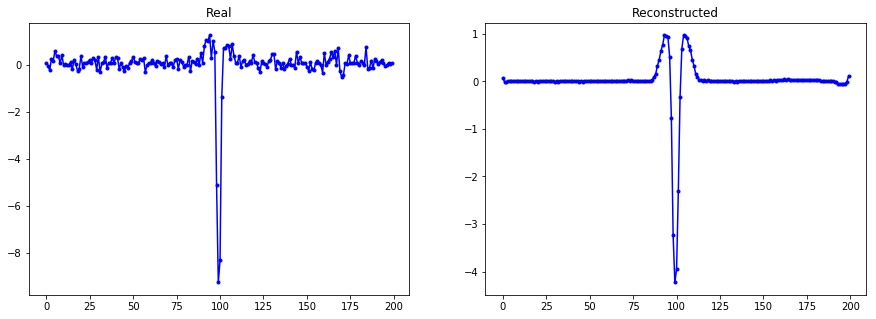

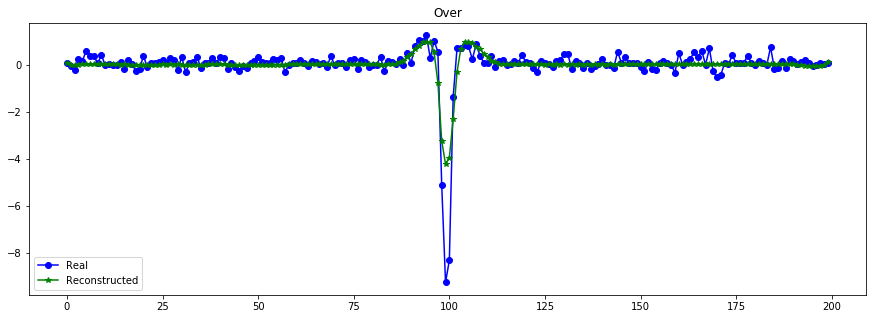

----------------------------------------------------------------


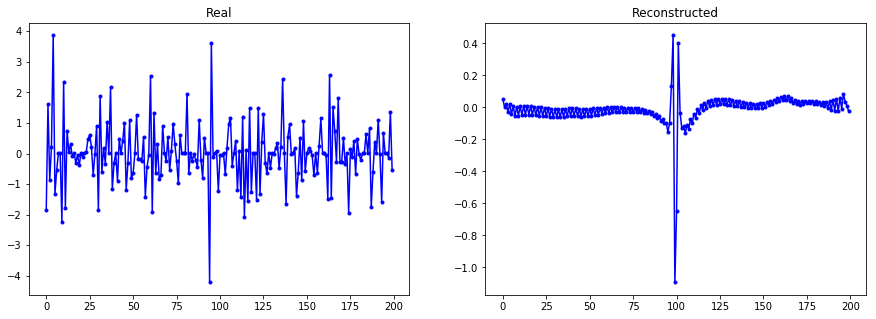

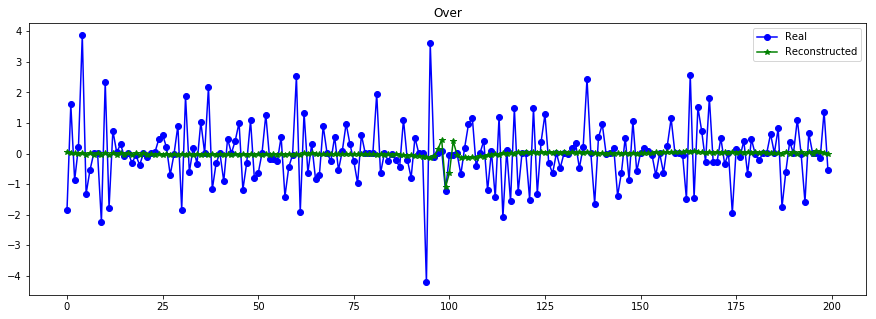

----------------------------------------------------------------


In [472]:
print("Errores ",vae.evaluate([X_test_t,X_test], X_test, batch_size=512))
X_train_hat = vae.predict([X_train_t,X_train], batch_size=512)
plot_n_lc(X_train[:,:,0], X_train_hat, n= 10) ###con 200 epochs T=200 global (CURVAS TRANSITO) 

In [ ]:
## KL con sse llegaba a KL_loss: 136.8248

1048/1048 [==============================] - 0s 350us/step
Errores  [125.63422941251565, 136.82457203173456, 0.6213298767577601]


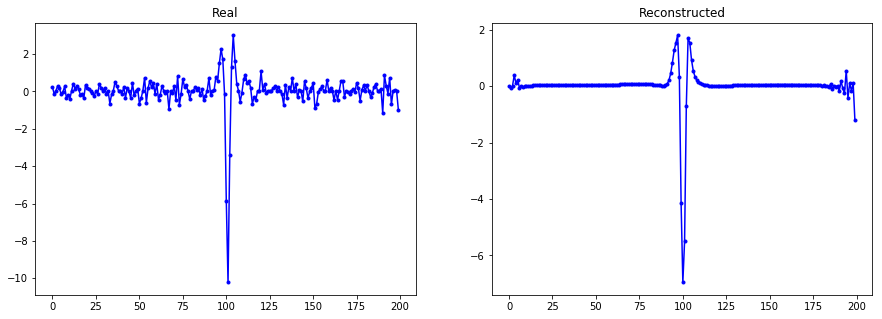

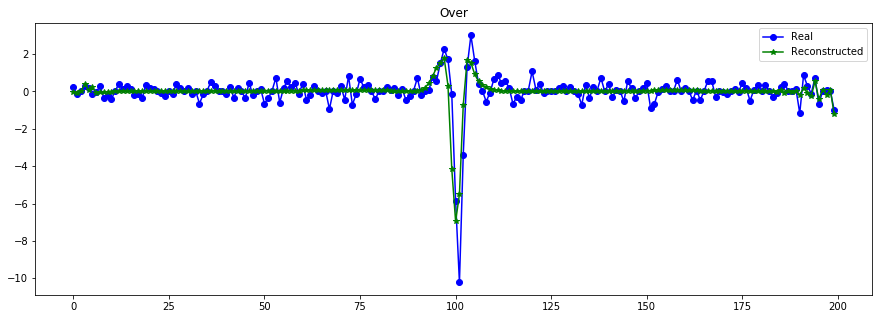

----------------------------------------------------------------


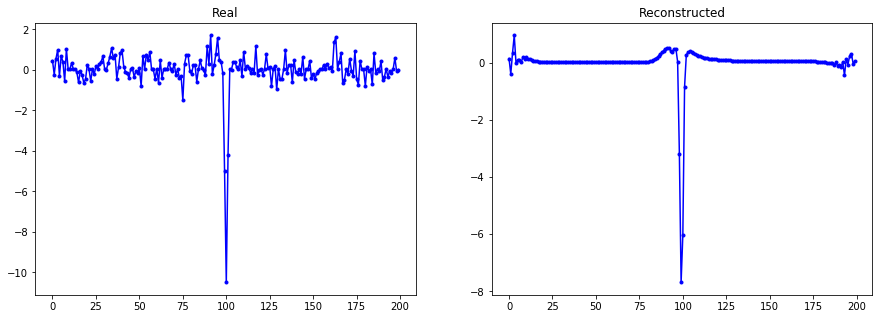

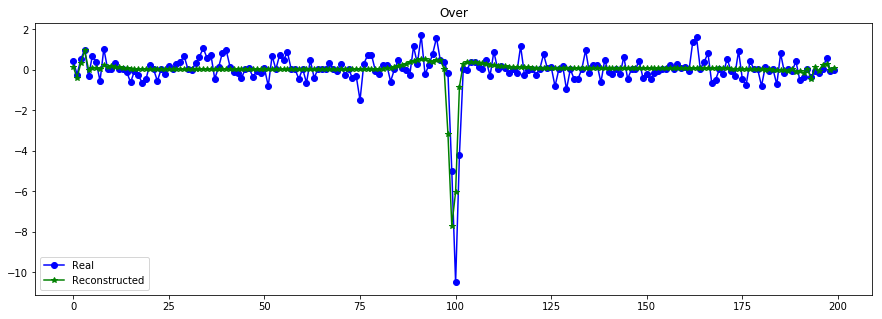

----------------------------------------------------------------


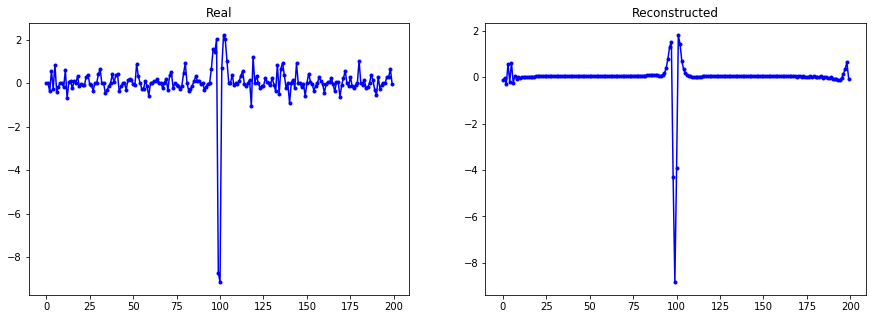

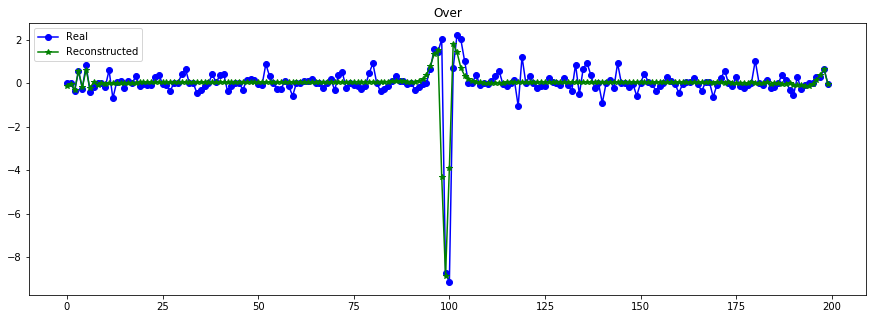

----------------------------------------------------------------


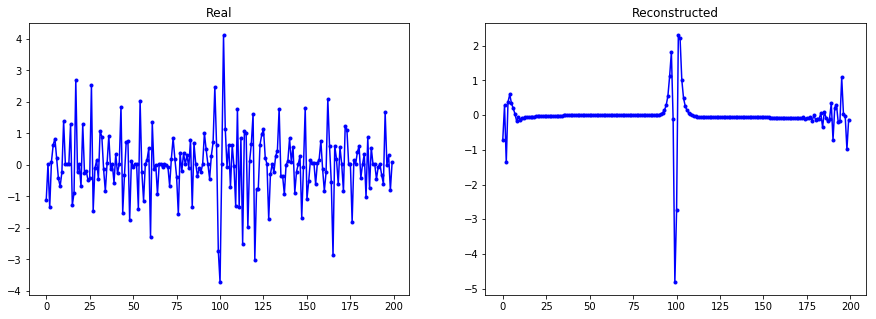

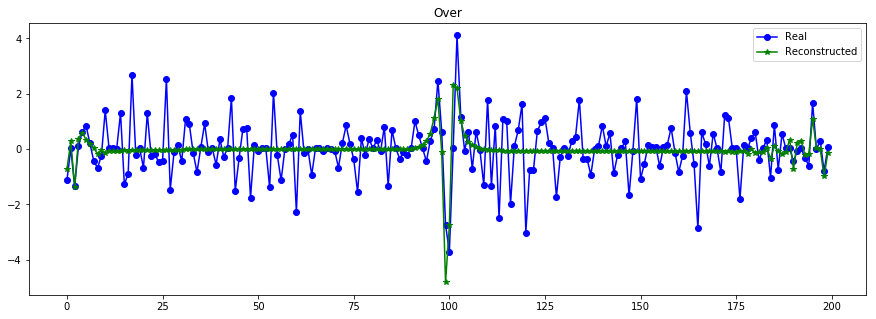

----------------------------------------------------------------


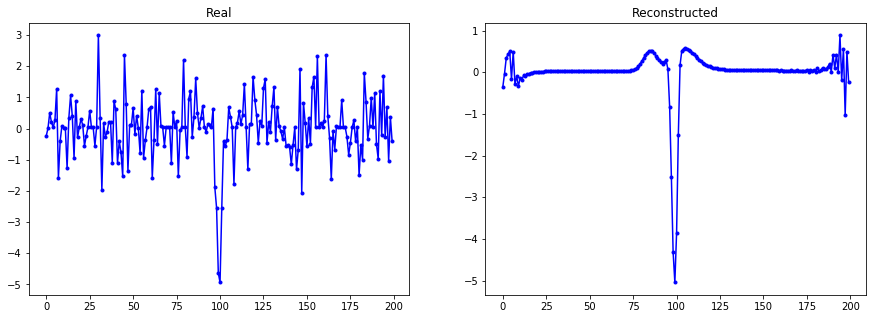

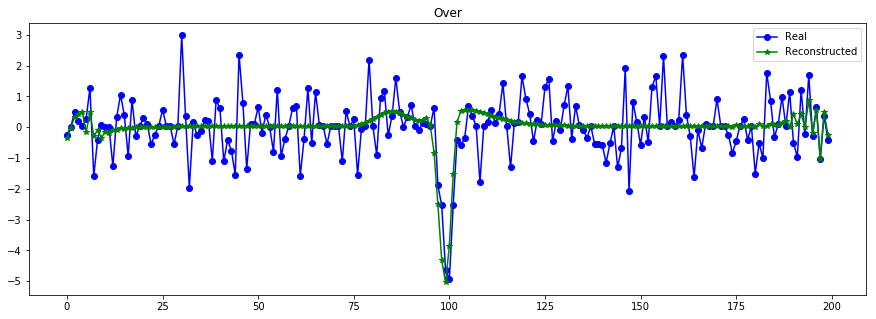

----------------------------------------------------------------


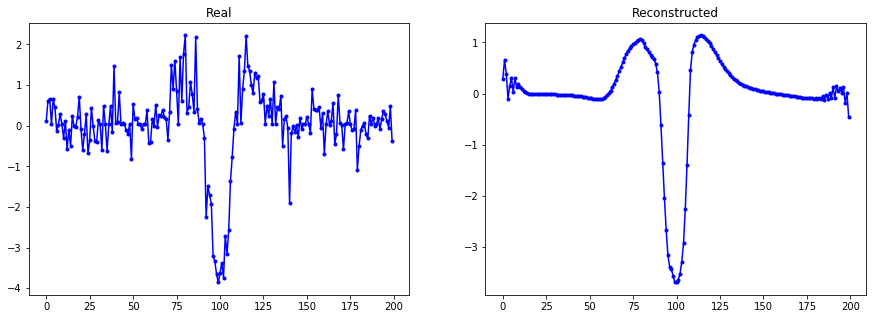

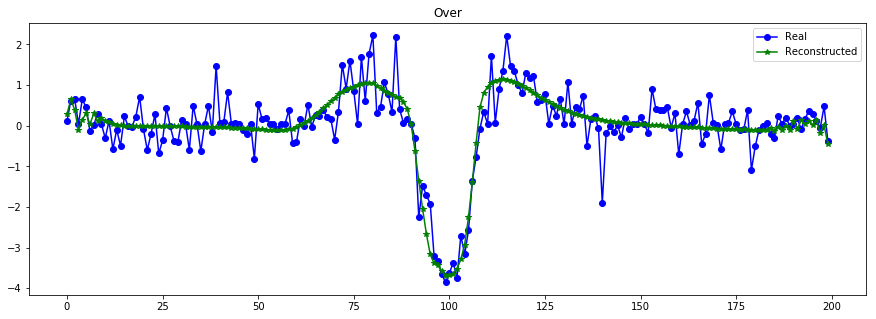

----------------------------------------------------------------


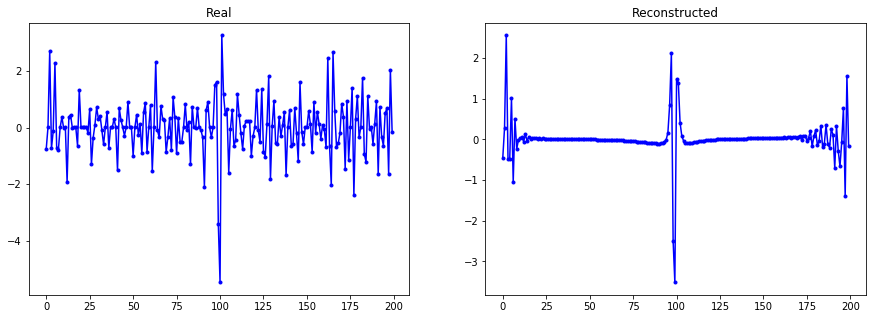

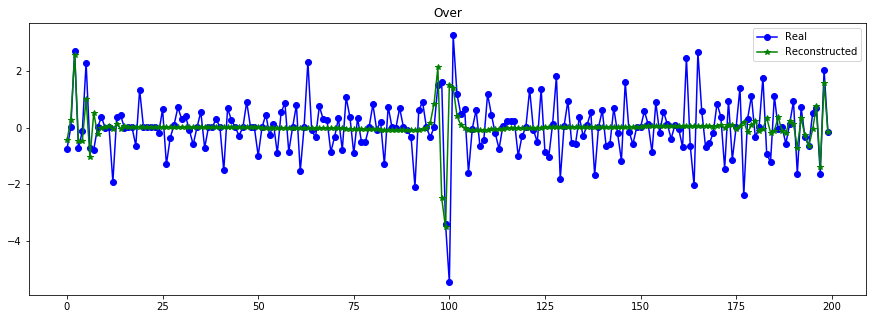

----------------------------------------------------------------


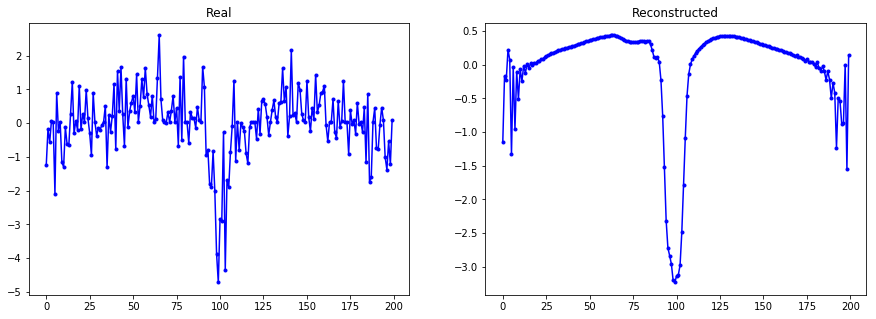

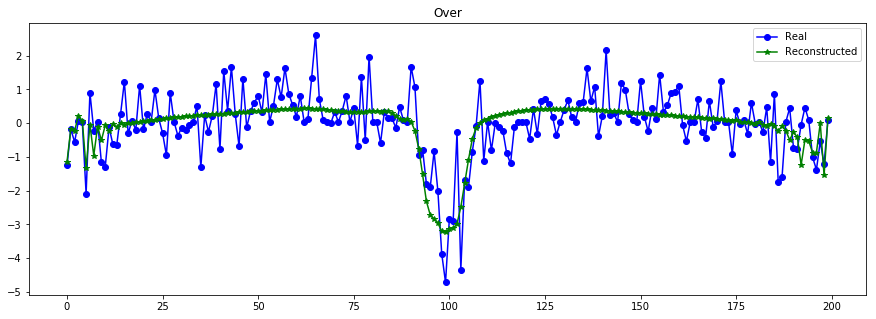

----------------------------------------------------------------


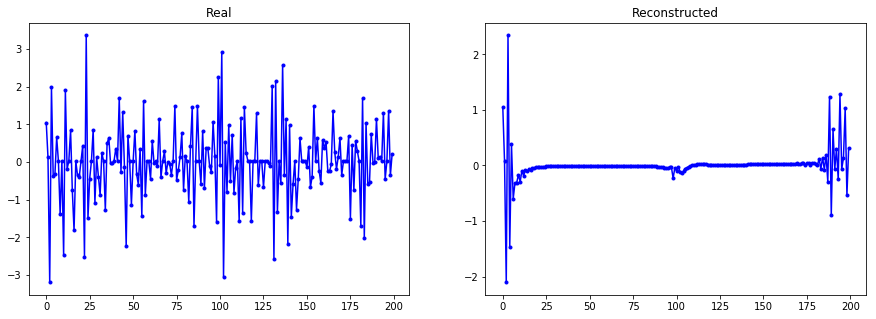

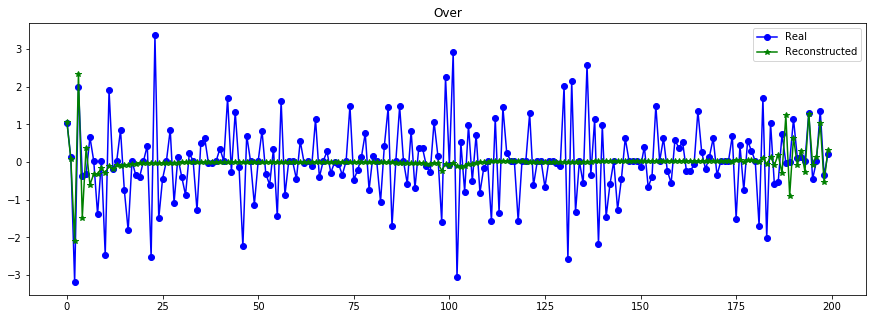

----------------------------------------------------------------


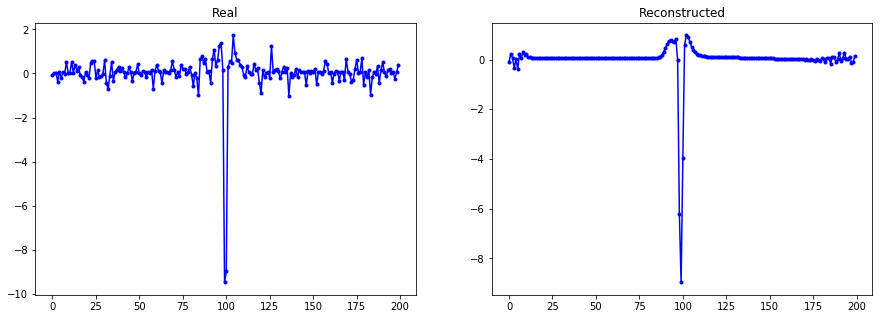

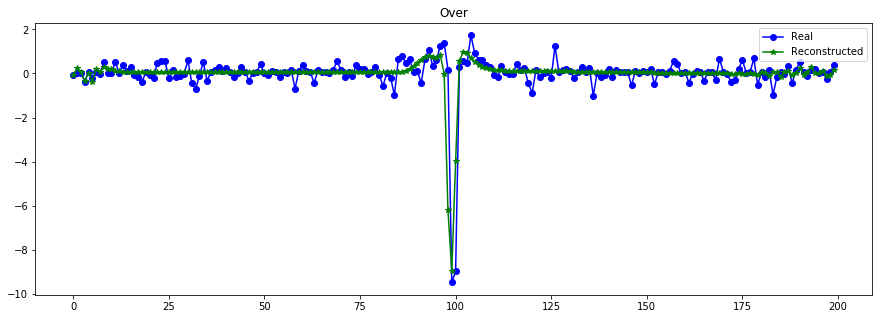

----------------------------------------------------------------


In [21]:
print("Errores ",vae.evaluate([X_test_t,X_test], X_test, batch_size=512))
X_train_hat = vae.predict([X_train_t,X_train], batch_size=512)
plot_n_lc(X_train[:,:,0], X_train_hat, n= 10) ###con 200 epochs T=200 global (CURVAS TRANSITO) 

1113/1113 [==============================] - 1s 572us/step
Errores  [239.80187434413256, 141.17351901456246, 0.5959753518905708]


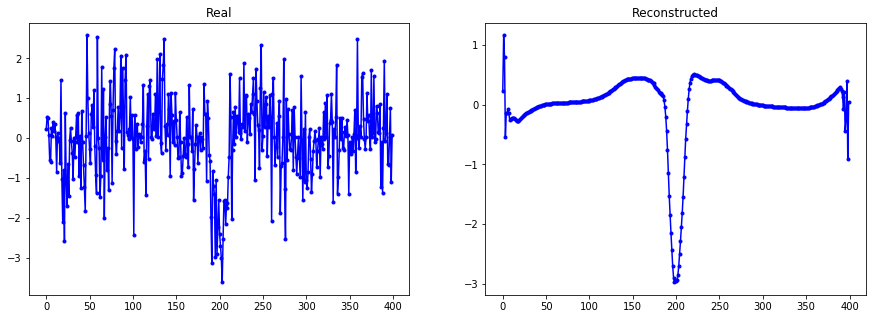

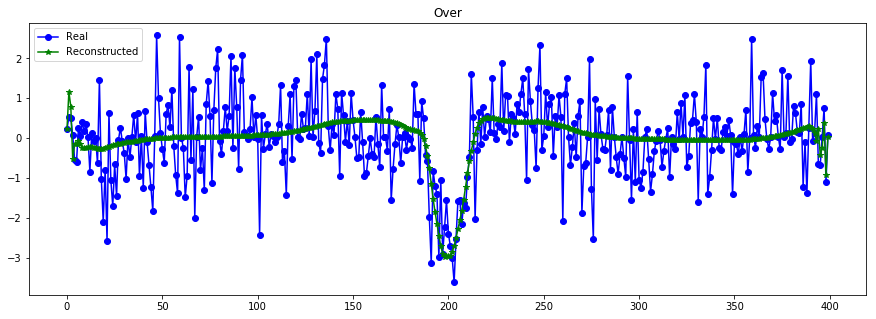

----------------------------------------------------------------


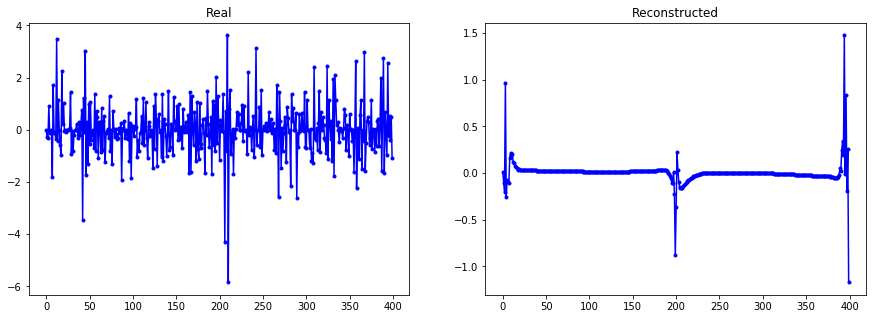

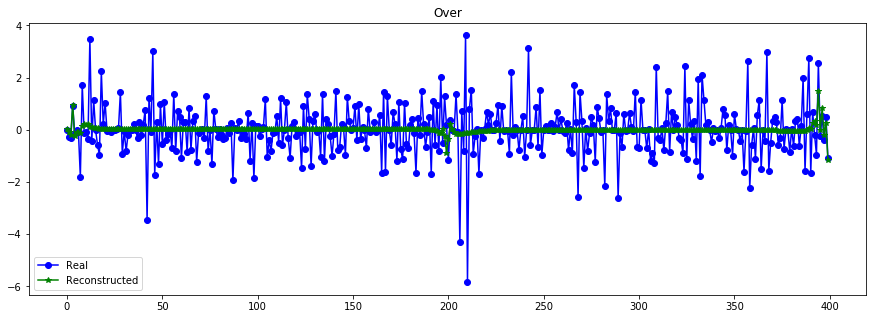

----------------------------------------------------------------


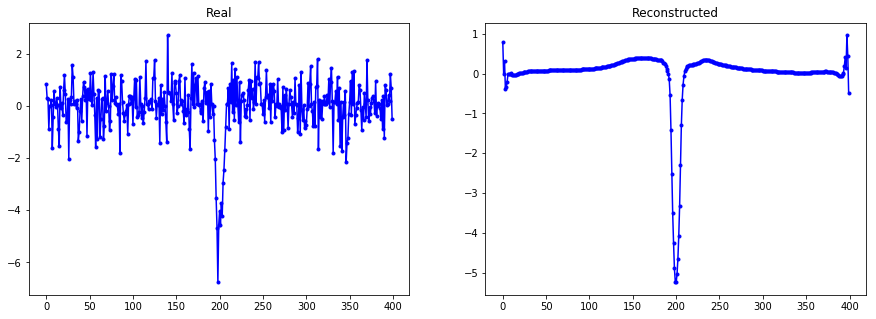

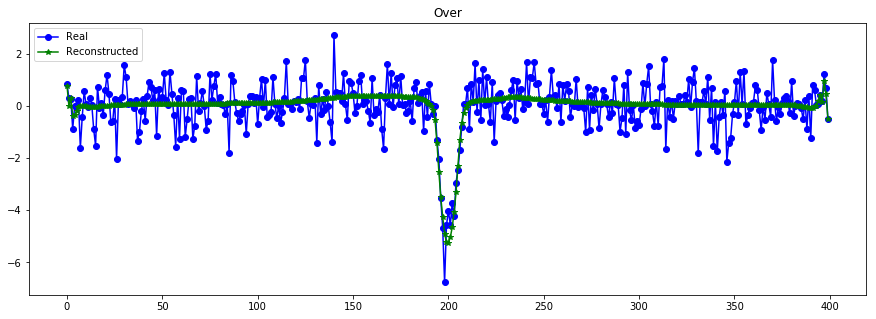

----------------------------------------------------------------


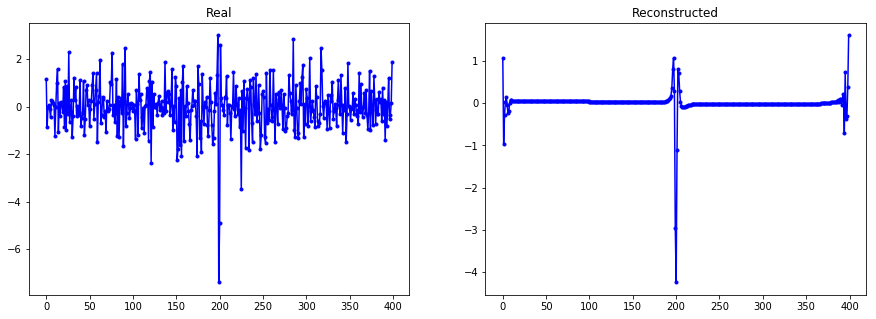

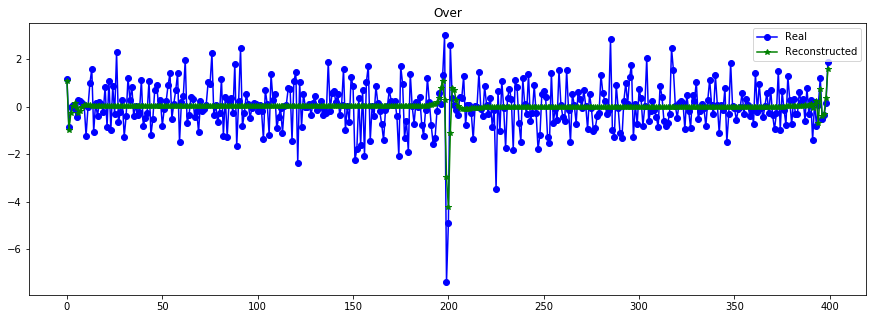

----------------------------------------------------------------


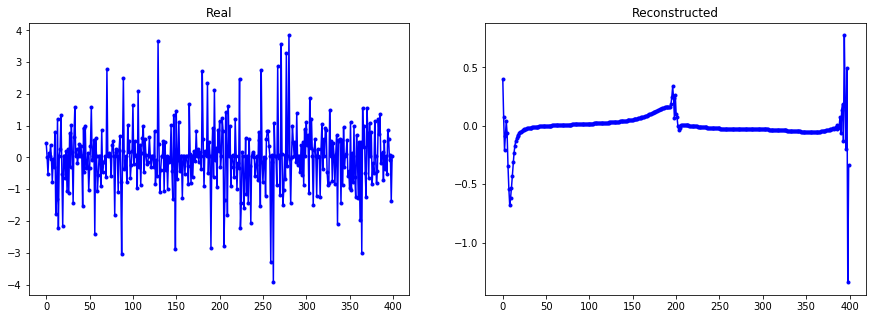

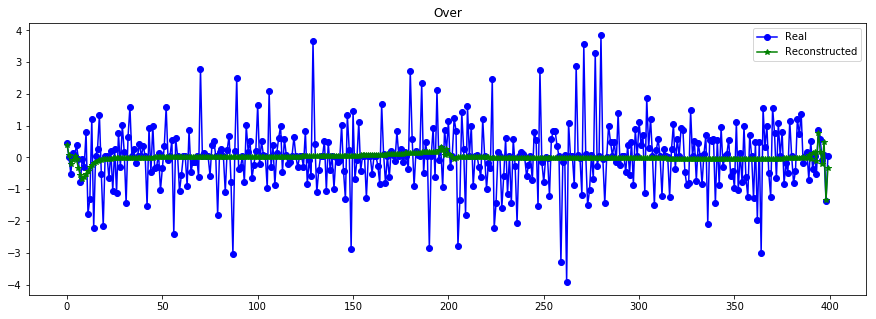

----------------------------------------------------------------


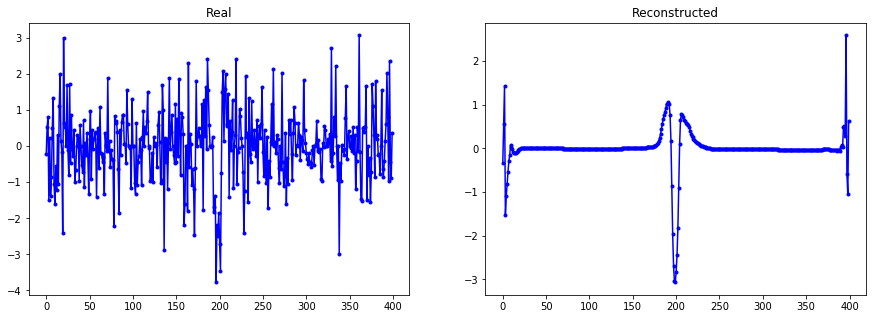

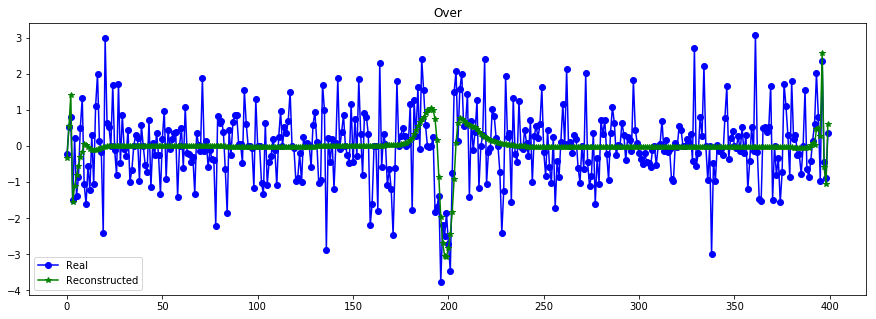

----------------------------------------------------------------


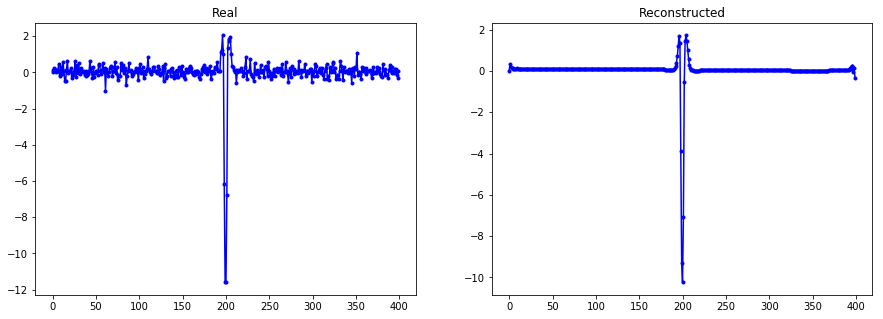

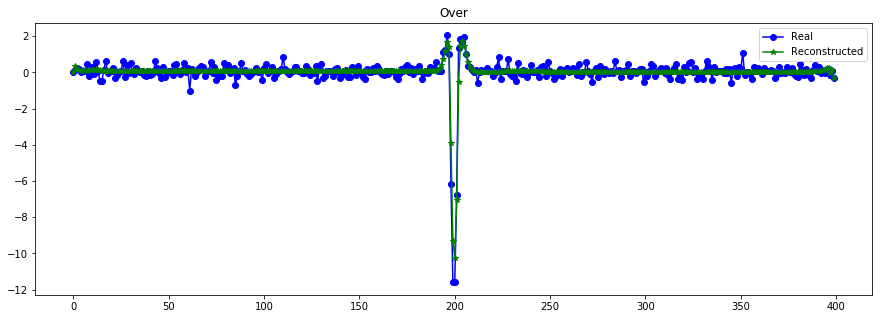

----------------------------------------------------------------


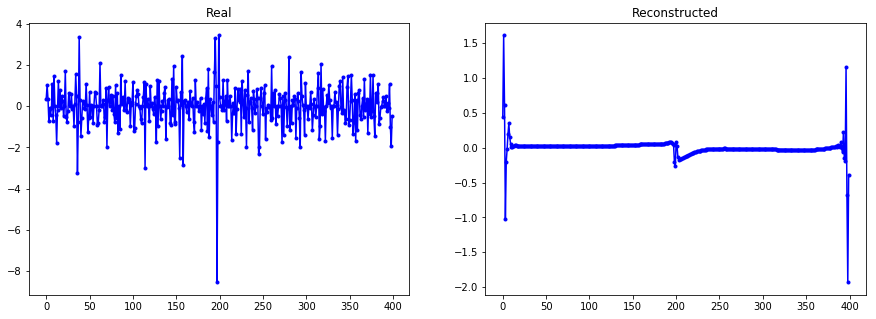

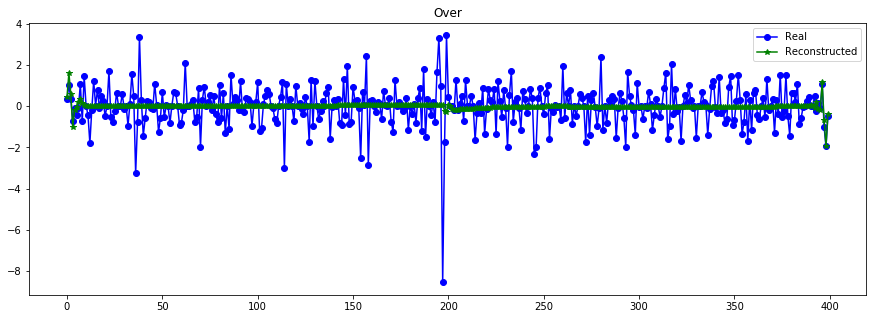

----------------------------------------------------------------


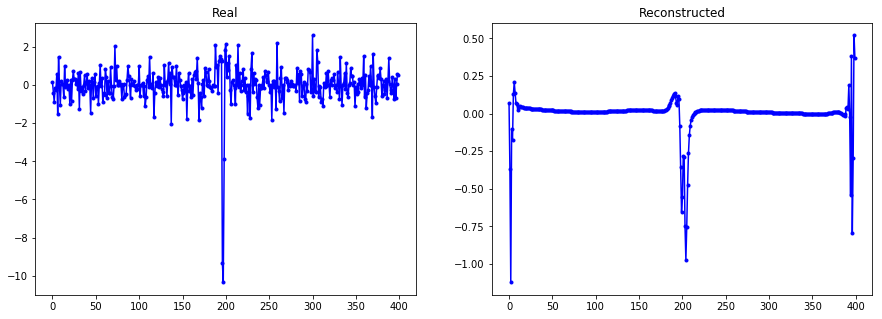

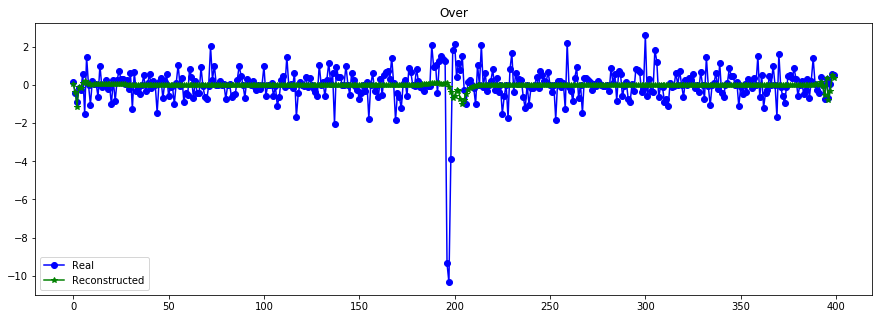

----------------------------------------------------------------


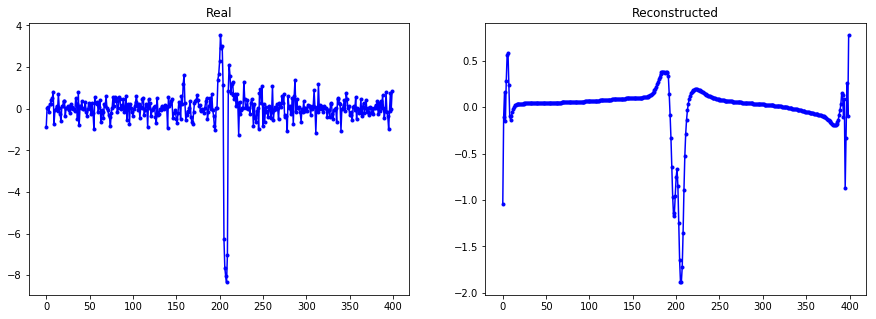

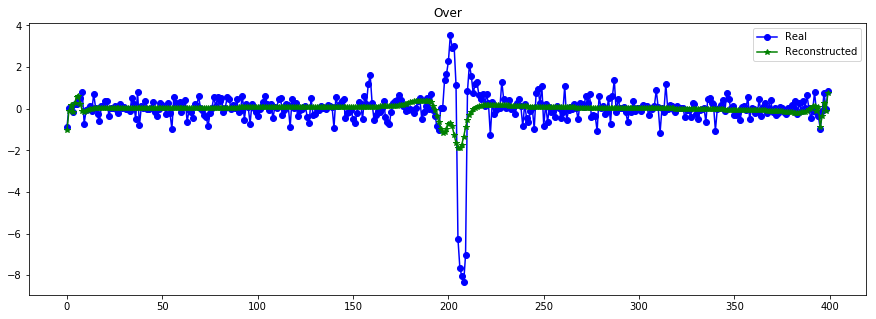

----------------------------------------------------------------


In [19]:
print("Errores ",vae.evaluate([X_test_t,X_test], X_test, batch_size=512))
X_train_hat = vae.predict([X_train_t,X_train], batch_size=512)
plot_n_lc(X_train[:,:,0], X_train_hat, n= 10) ###con T=400

### KL 0.001

In [18]:
x_lc = Input(shape = (T, channels) , name="LC_inp")
x_t = Input(shape = (T, 1) , name ="T_inp")

x = Concatenate(axis=-1)([x_t, x_lc]) #add time encode

f1 = Bidirectional(CuDNNGRU(64, return_sequences=True))(x) #bidirectional
f1 = Bidirectional(CuDNNGRU(64, return_sequences=False))(f1) #bidirectional

z_mean = Dense(latent_dim,activation='linear')(f1)
z_log_var = Dense(latent_dim,activation='linear')(f1)

encoder = Model([x_t, x_lc], z_mean, name="encoder")
z = Lambda(sampling, output_shape=(latent_dim,), name='sample')([z_mean, z_log_var])
samp_encoder = Model([x_t, x_lc], z, name="encoder_sampling")


decoder_input = Input(shape=(latent_dim,))

#decode = Dense(latent_dim, activation='relu')(decoder_input)
decode = RepeatVector(T)(decoder_input)

decode = Concatenate(axis=-1)([x_t, decode]) #add time decode

decode = Bidirectional(CuDNNGRU(64, return_sequences=True))(decode) #bidirectional
decode = Bidirectional(CuDNNGRU(64, return_sequences=True))(decode) #bidirectional

decode = TimeDistributed(Dense(1, activation='linear'))(decode)
generator = Model([x_t, decoder_input], decode, name="generator")

# instantiate VAE model
out = generator([x_t, samp_encoder([x_t, x_lc]) ])
vae = Model([x_t, x_lc], out)

vae.compile(optimizer='adam', loss=vae_loss, metrics = [KL_loss, MSE_loss])
vae.summary()

batch_size = 64
vae.fit([X_train_t,X_train], X_train, epochs=500, batch_size=batch_size, 
        validation_data=([X_test_t,X_test], X_test))

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
T_inp (InputLayer)              (None, 200, 1)       0                                            
__________________________________________________________________________________________________
LC_inp (InputLayer)             (None, 200, 1)       0                                            
__________________________________________________________________________________________________
encoder_sampling (Model)        (None, 32)           108864      T_inp[0][0]                      
                                                                 LC_inp[0][0]                     
__________________________________________________________________________________________________
generator (Model)               (None, 200, 1)       112641      T_inp[0][0]                      
          

8634/8634 [==============================] - 19s 2ms/step - loss: 0.6757 - KL_loss: 16.5537 - MSE_loss: 0.6591
Epoch 122/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.6707 - KL_loss: 16.7067 - MSE_loss: 0.6540
Epoch 123/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.6546 - KL_loss: 16.8448 - MSE_loss: 0.6377
Epoch 124/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.7098 - KL_loss: 15.8102 - MSE_loss: 0.6939
Epoch 125/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.6562 - KL_loss: 16.7658 - MSE_loss: 0.6395
Epoch 126/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.6804 - KL_loss: 16.4952 - MSE_loss: 0.6640
Epoch 127/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.7125 - KL_loss: 15.7384 - MSE_loss: 0.6968
Epoch 128/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.6673 - KL_loss: 16.6728 - MSE_loss: 0.6506
Epoch 129/500


8634/8634 [==============================] - 19s 2ms/step - loss: 0.5898 - KL_loss: 18.7328 - MSE_loss: 0.5711
Epoch 252/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.6121 - KL_loss: 18.4764 - MSE_loss: 0.5936
Epoch 253/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.5933 - KL_loss: 18.2822 - MSE_loss: 0.5750
Epoch 254/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.6436 - KL_loss: 18.7090 - MSE_loss: 0.6249
Epoch 255/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.6242 - KL_loss: 18.4056 - MSE_loss: 0.6058
Epoch 256/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.5901 - KL_loss: 19.1393 - MSE_loss: 0.5710
Epoch 257/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.6085 - KL_loss: 18.6772 - MSE_loss: 0.5898
Epoch 258/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.6079 - KL_loss: 18.7266 - MSE_loss: 0.5892
Epoch 259/500


8634/8634 [==============================] - 19s 2ms/step - loss: 0.5462 - KL_loss: 19.1006 - MSE_loss: 0.5271
Epoch 382/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.6227 - KL_loss: 18.9437 - MSE_loss: 0.6038
Epoch 383/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.5590 - KL_loss: 19.2324 - MSE_loss: 0.5398
Epoch 384/500
8634/8634 [==============================] - 18s 2ms/step - loss: 0.5478 - KL_loss: 19.0730 - MSE_loss: 0.5288
Epoch 385/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.6084 - KL_loss: 19.5696 - MSE_loss: 0.5888
Epoch 386/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.5679 - KL_loss: 19.5679 - MSE_loss: 0.5483
Epoch 387/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.5671 - KL_loss: 19.5712 - MSE_loss: 0.5476
Epoch 388/500
8634/8634 [==============================] - 19s 2ms/step - loss: 0.5591 - KL_loss: 19.7061 - MSE_loss: 0.5394
Epoch 389/500


Errores  []


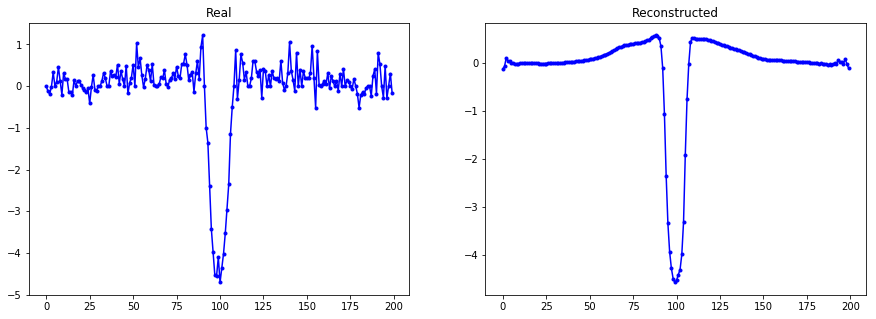

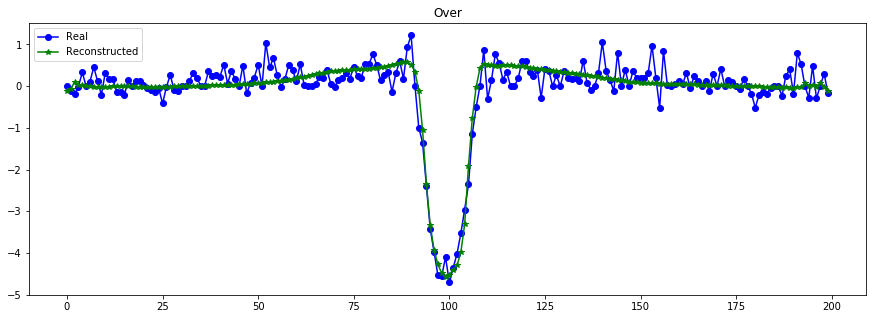

----------------------------------------------------------------


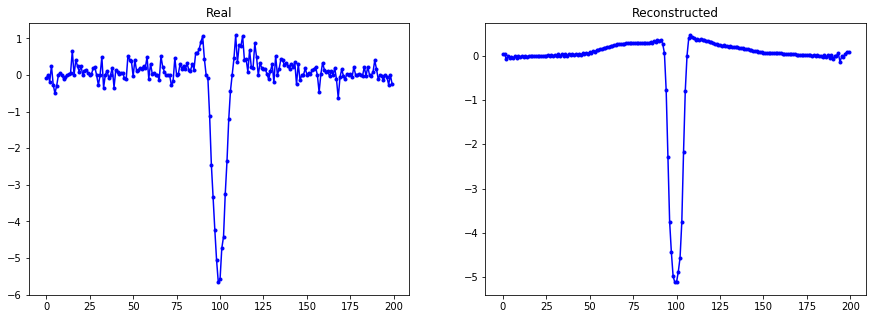

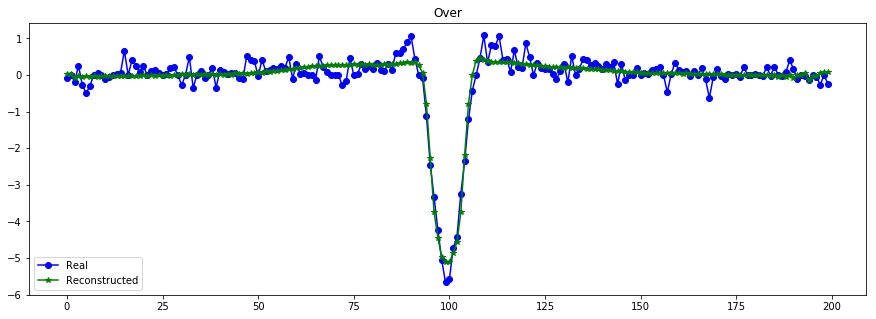

----------------------------------------------------------------


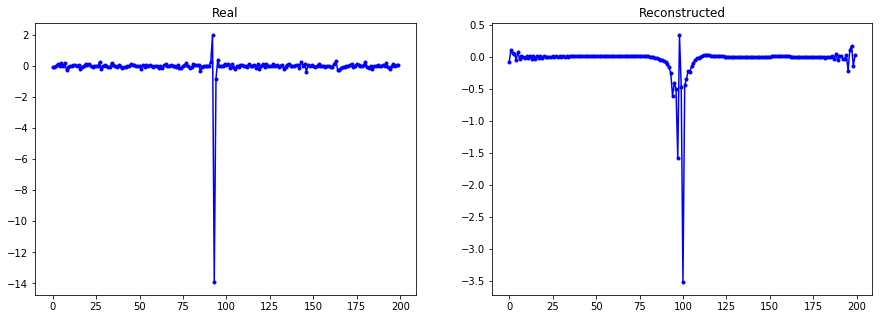

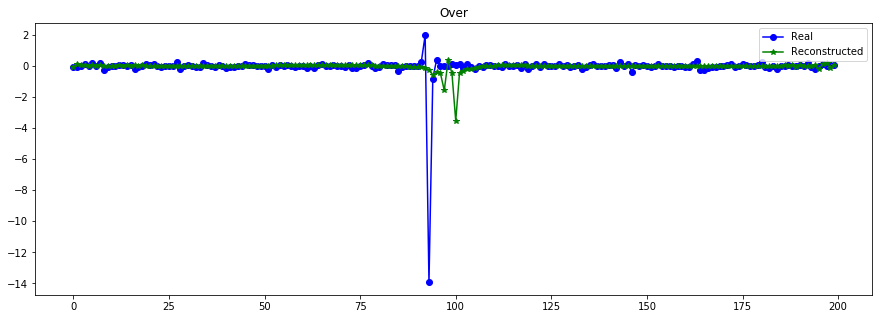

----------------------------------------------------------------


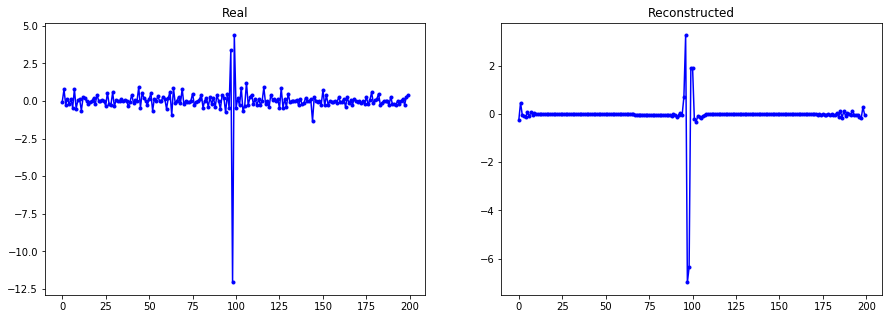

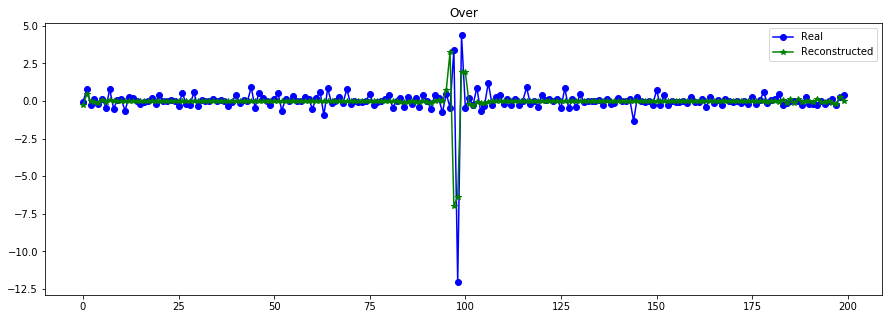

----------------------------------------------------------------


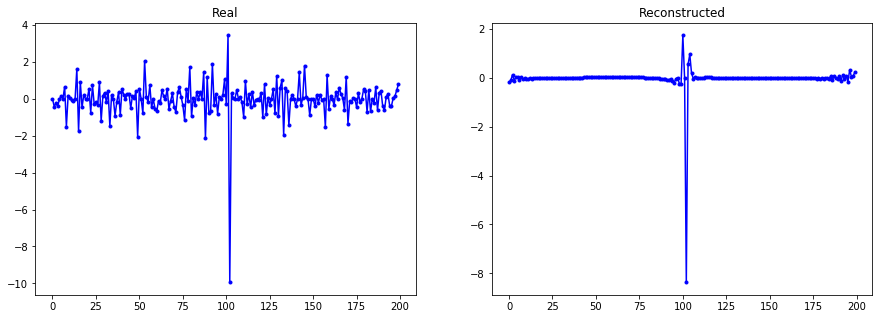

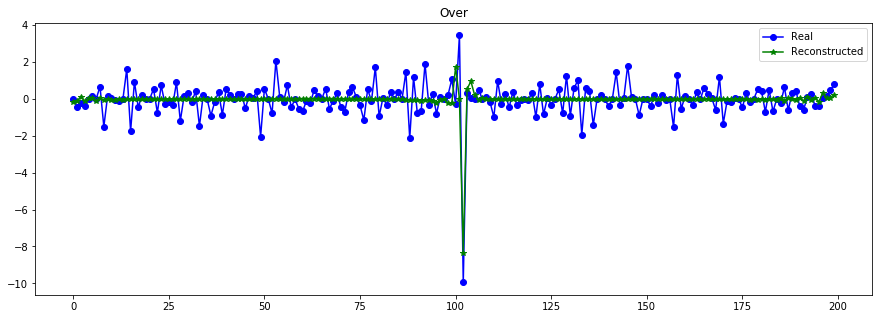

----------------------------------------------------------------


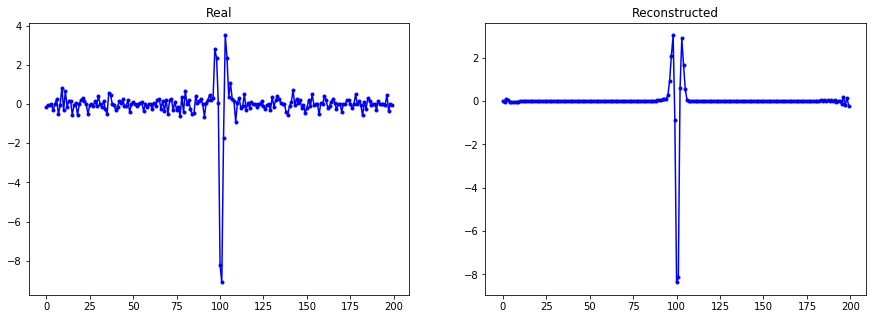

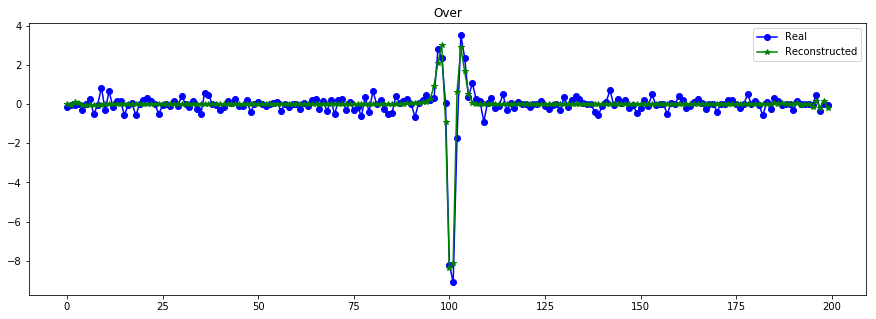

----------------------------------------------------------------


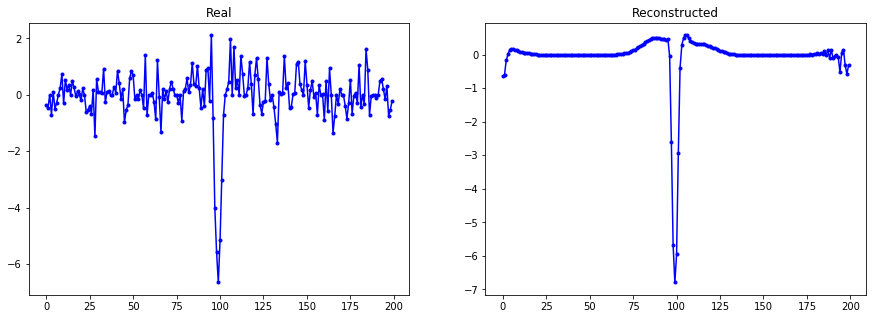

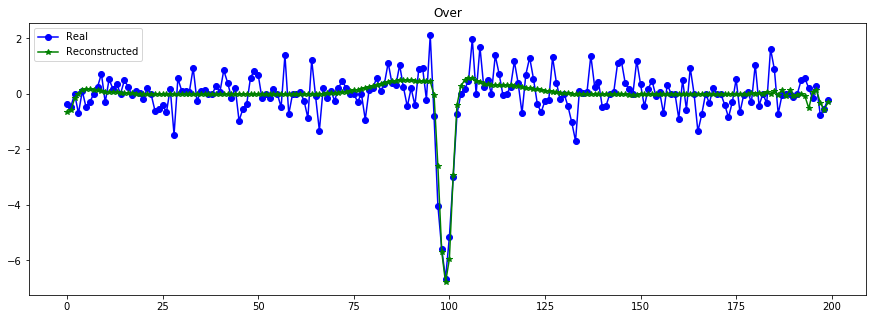

----------------------------------------------------------------


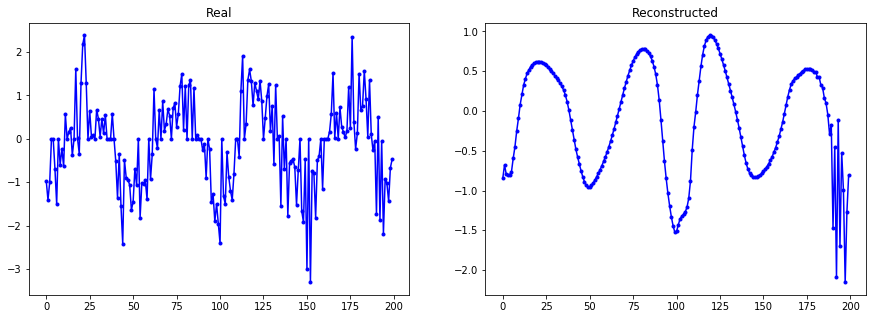

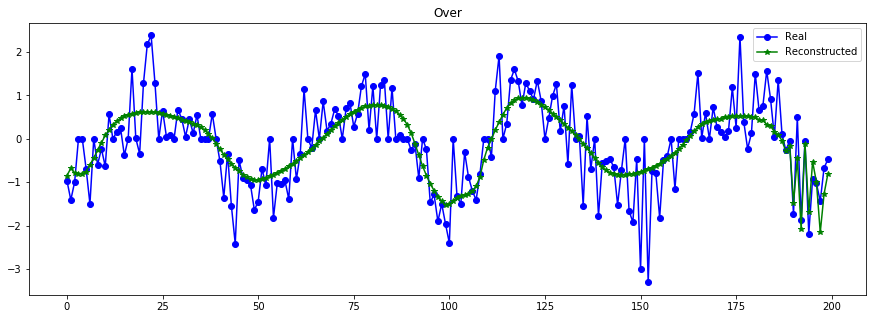

----------------------------------------------------------------


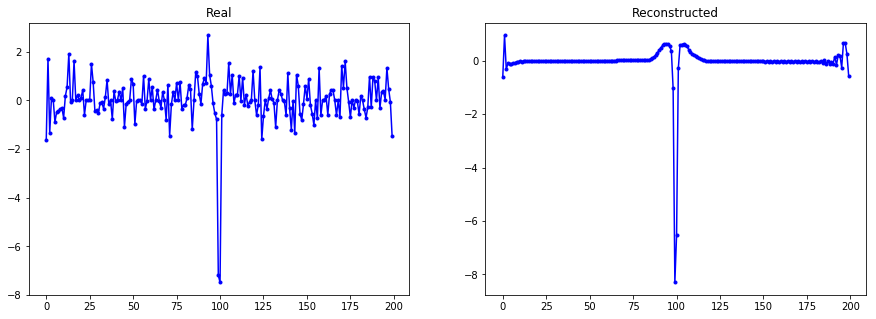

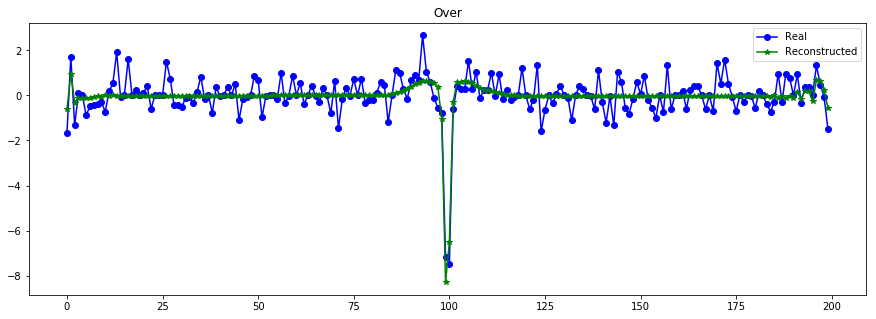

----------------------------------------------------------------


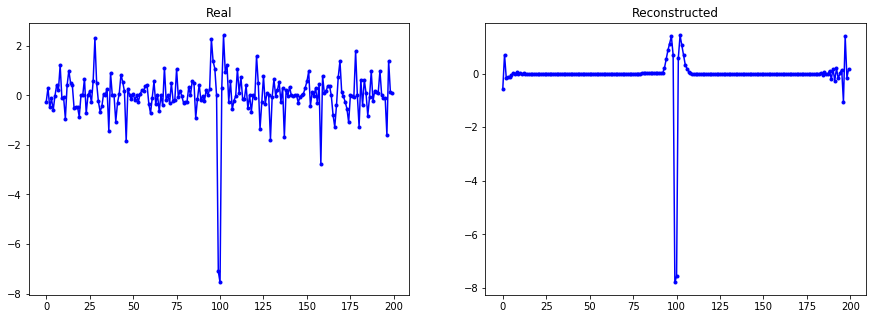

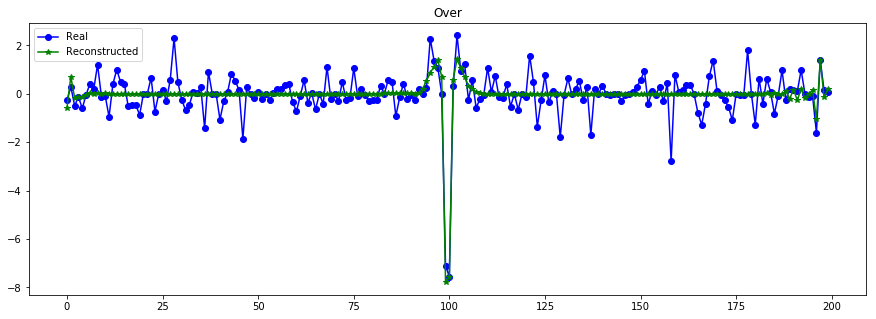

----------------------------------------------------------------


In [19]:
print("Errores ",vae.evaluate([X_test_t,X_test], X_test, batch_size=512))
X_train_hat = vae.predict([X_train_t,X_train], batch_size=512)
plot_n_lc(X_train[:,:,0], X_train_hat, n= 10) ###con 200 epochs T=200 global (CURVAS TRANSITO) 

In [80]:
x_lc = Input(shape = (T, channels) , name="LC_inp")
x_t = Input(shape = (T, 1) , name ="T_inp")

x = Concatenate(axis=-1)([x_t, x_lc]) #add time encode

f1 = Bidirectional(CuDNNGRU(64, return_sequences=True))(x) #bidirectional
f1 = Bidirectional(CuDNNGRU(64, return_sequences=False))(f1) #bidirectional

z_mean = Dense(latent_dim,activation='linear')(f1)
z_log_var = Dense(latent_dim,activation='linear')(f1)

encoder = Model([x_t, x_lc], z_mean, name="encoder")
z = Lambda(sampling, output_shape=(latent_dim,), name='sample')([z_mean, z_log_var])
samp_encoder = Model([x_t, x_lc], z, name="encoder_sampling")


decoder_input = Input(shape=(latent_dim,))

#decode = Dense(latent_dim, activation='relu')(decoder_input)
decode = RepeatVector(T)(decoder_input)

decode = Concatenate(axis=-1)([x_t, decode]) #add time decode

decode = Bidirectional(CuDNNGRU(64, return_sequences=True))(decode) #bidirectional
decode = Bidirectional(CuDNNGRU(64, return_sequences=True))(decode) #bidirectional

decode = TimeDistributed(Dense(1, activation='linear'))(decode)
generator = Model([x_t, decoder_input], decode, name="generator")

# instantiate VAE model
out = generator([x_t, samp_encoder([x_t, x_lc]) ])
vae = Model([x_t, x_lc], out)

vae.compile(optimizer='adam', loss=vae_loss, metrics = [KL_loss, MSE_loss])
vae.summary()

batch_size = 64
vae.fit([X_train_t,X_train], X_train, epochs=200, batch_size=batch_size, 
        validation_data=([X_test_t,X_test], X_test))

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
T_inp (InputLayer)              (None, 400, 1)       0                                            
__________________________________________________________________________________________________
LC_inp (InputLayer)             (None, 400, 1)       0                                            
__________________________________________________________________________________________________
encoder_sampling (Model)        (None, 32)           108864      T_inp[0][0]                      
                                                                 LC_inp[0][0]                     
__________________________________________________________________________________________________
generator (Model)               (None, 400, 1)       112641      T_inp[0][0]                      
          

Epoch 35/200
6496/6496 [==============================] - 31s 5ms/step - loss: 5361.6012 - KL_loss: 72.2605 - MSE_loss: 13.3859 - val_loss: 14620.6267 - val_KL_loss: 60.7865 - val_MSE_loss: 36.5364
Epoch 36/200
6496/6496 [==============================] - 30s 5ms/step - loss: 5396.5356 - KL_loss: 60.2144 - MSE_loss: 13.4763 - val_loss: 14621.5697 - val_KL_loss: 60.8261 - val_MSE_loss: 36.5387
Epoch 37/200
6496/6496 [==============================] - 28s 4ms/step - loss: 5378.8796 - KL_loss: 60.6224 - MSE_loss: 13.4320 - val_loss: 14556.9950 - val_KL_loss: 65.1323 - val_MSE_loss: 36.3762
Epoch 38/200
6496/6496 [==============================] - 29s 4ms/step - loss: 5444.3323 - KL_loss: 88.2518 - MSE_loss: 13.5888 - val_loss: 14641.5596 - val_KL_loss: 71.8054 - val_MSE_loss: 36.5859
Epoch 39/200
6496/6496 [==============================] - 29s 4ms/step - loss: 5404.1320 - KL_loss: 65.7765 - MSE_loss: 13.4939 - val_loss: 14597.9342 - val_KL_loss: 61.6800 - val_MSE_loss: 36.4794
Epoch 40/2

6496/6496 [==============================] - 27s 4ms/step - loss: 5111.4737 - KL_loss: 119.7755 - MSE_loss: 12.7487 - val_loss: 14260.7796 - val_KL_loss: 115.6421 - val_MSE_loss: 35.6230
Epoch 118/200
6496/6496 [==============================] - 27s 4ms/step - loss: 5071.9570 - KL_loss: 108.8474 - MSE_loss: 12.6527 - val_loss: 14449.0857 - val_KL_loss: 115.9227 - val_MSE_loss: 36.0937
Epoch 119/200
6496/6496 [==============================] - 26s 4ms/step - loss: 5151.7293 - KL_loss: 106.4326 - MSE_loss: 12.8527 - val_loss: 14516.5475 - val_KL_loss: 106.9810 - val_MSE_loss: 36.2646
Epoch 120/200
6496/6496 [==============================] - 26s 4ms/step - loss: 5168.1011 - KL_loss: 105.9403 - MSE_loss: 12.8938 - val_loss: 14888.4950 - val_KL_loss: 115.6043 - val_MSE_loss: 37.1923
Epoch 121/200
6496/6496 [==============================] - 27s 4ms/step - loss: 5234.3739 - KL_loss: 111.5327 - MSE_loss: 13.0581 - val_loss: 13922.3107 - val_KL_loss: 98.2654 - val_MSE_loss: 34.7812
Epoch 122/

Epoch 158/200
6496/6496 [==============================] - 26s 4ms/step - loss: 4982.6419 - KL_loss: 112.1084 - MSE_loss: 12.4286 - val_loss: 14008.8459 - val_KL_loss: 109.3268 - val_MSE_loss: 34.9948
Epoch 159/200
6496/6496 [==============================] - 26s 4ms/step - loss: 5023.6807 - KL_loss: 107.7473 - MSE_loss: 12.5323 - val_loss: 13712.5833 - val_KL_loss: 106.5816 - val_MSE_loss: 34.2548
Epoch 160/200
6496/6496 [==============================] - 27s 4ms/step - loss: 5159.1413 - KL_loss: 108.6761 - MSE_loss: 12.8707 - val_loss: 14662.6446 - val_KL_loss: 107.9693 - val_MSE_loss: 36.6296
Epoch 161/200
6496/6496 [==============================] - 27s 4ms/step - loss: 5268.7841 - KL_loss: 105.0263 - MSE_loss: 13.1457 - val_loss: 13074.7272 - val_KL_loss: 96.0334 - val_MSE_loss: 32.6628
Epoch 162/200
6496/6496 [==============================] - 27s 4ms/step - loss: 5041.4694 - KL_loss: 95.8669 - MSE_loss: 12.5797 - val_loss: 13584.4811 - val_KL_loss: 96.3809 - val_MSE_loss: 33.937

Epoch 199/200
6496/6496 [==============================] - 26s 4ms/step - loss: 4914.7681 - KL_loss: 132.9103 - MSE_loss: 12.2537 - val_loss: 13201.2584 - val_KL_loss: 120.0502 - val_MSE_loss: 32.9731
Epoch 200/200
6496/6496 [==============================] - 26s 4ms/step - loss: 4724.0886 - KL_loss: 117.5971 - MSE_loss: 11.7808 - val_loss: 12021.2723 - val_KL_loss: 112.5826 - val_MSE_loss: 30.0250


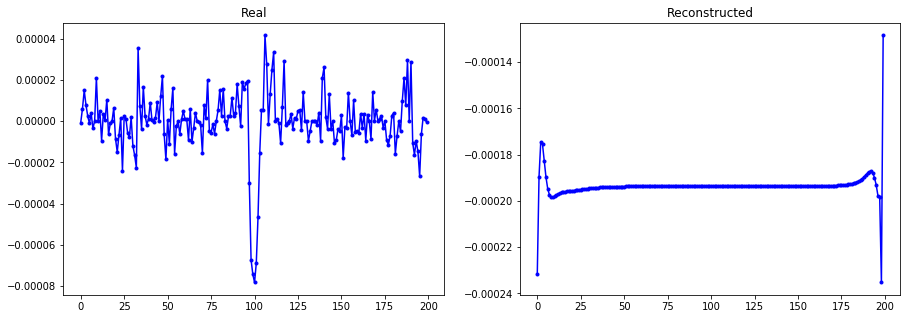

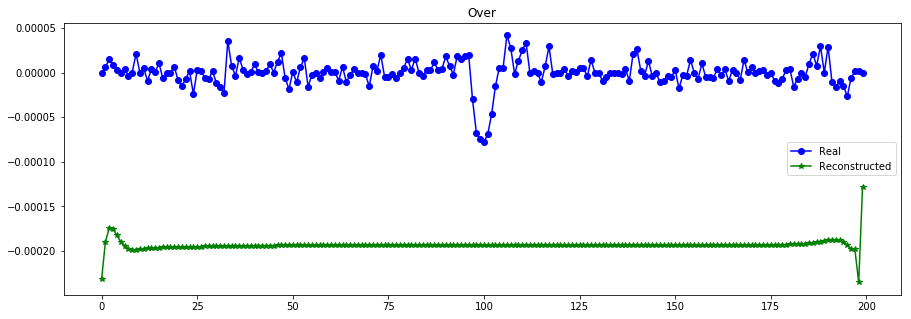

----------------------------------------------------------------


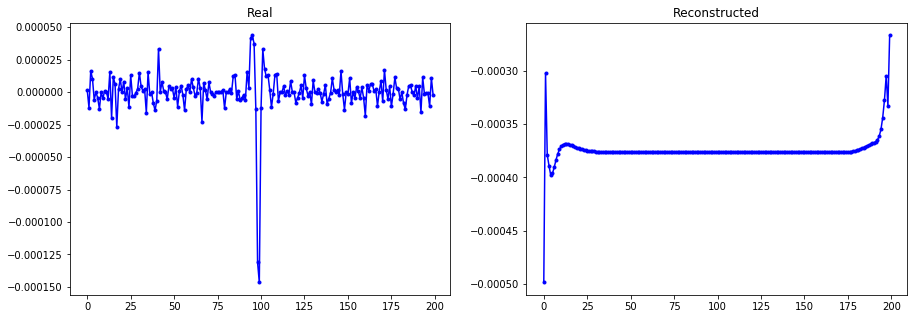

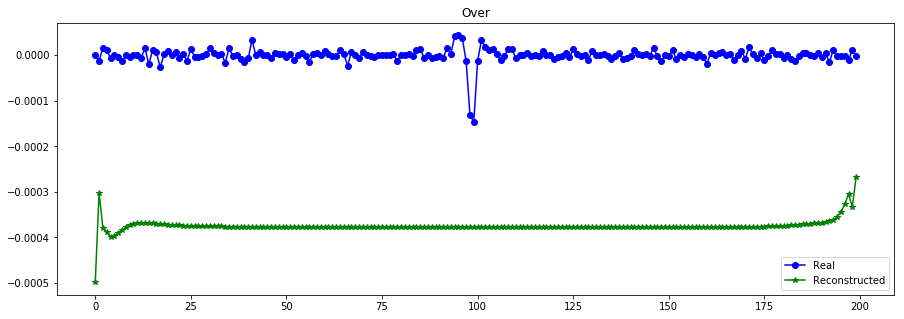

----------------------------------------------------------------


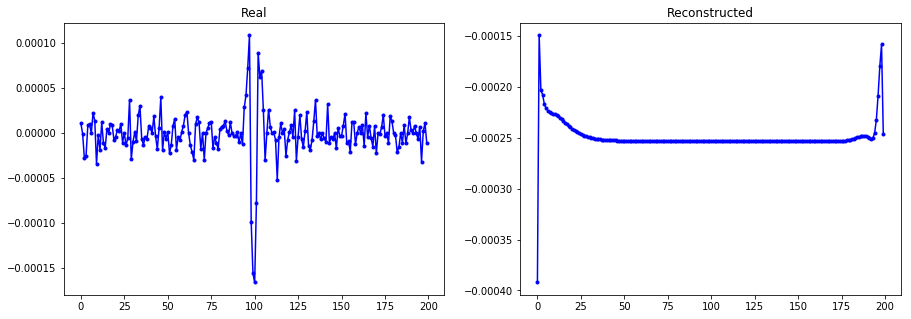

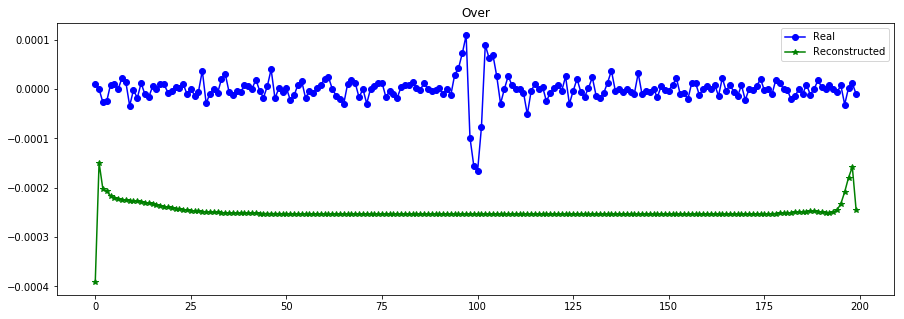

----------------------------------------------------------------


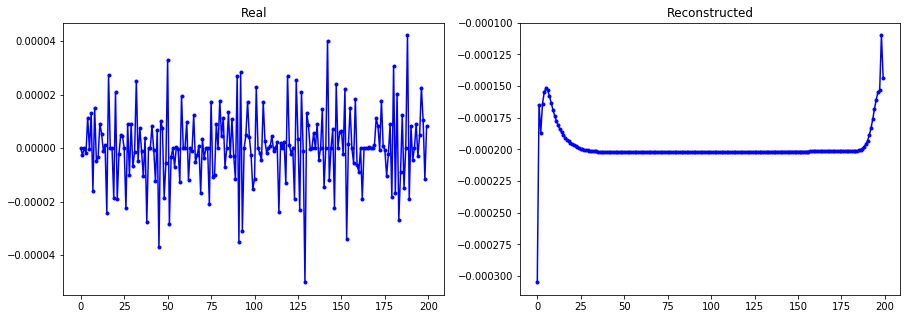

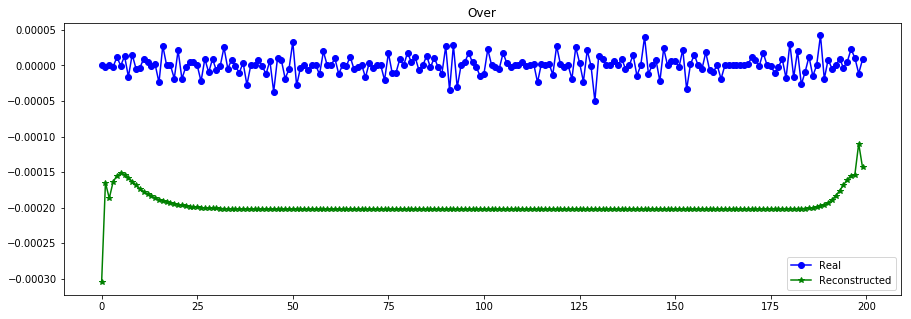

----------------------------------------------------------------


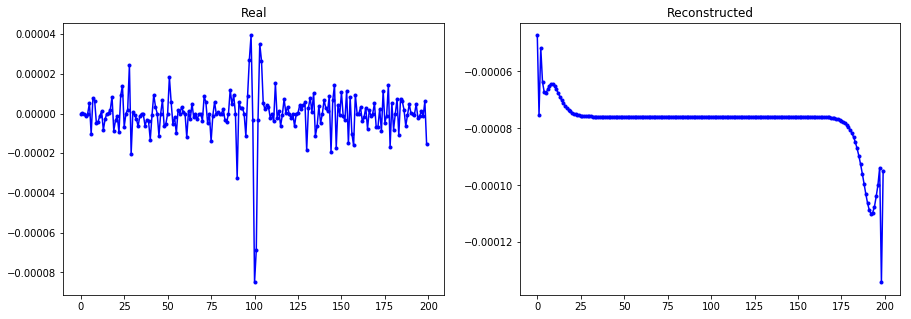

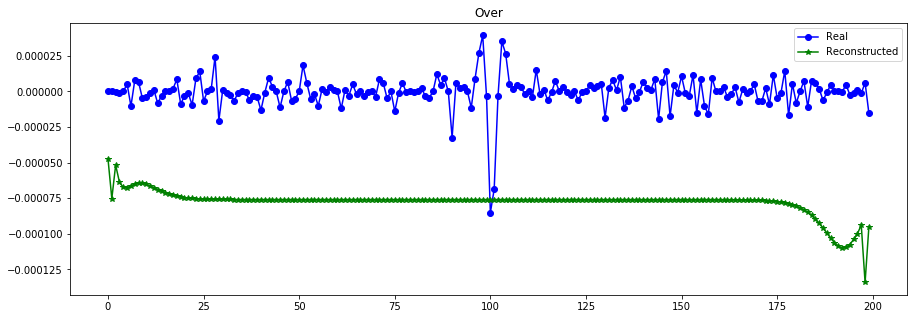

----------------------------------------------------------------


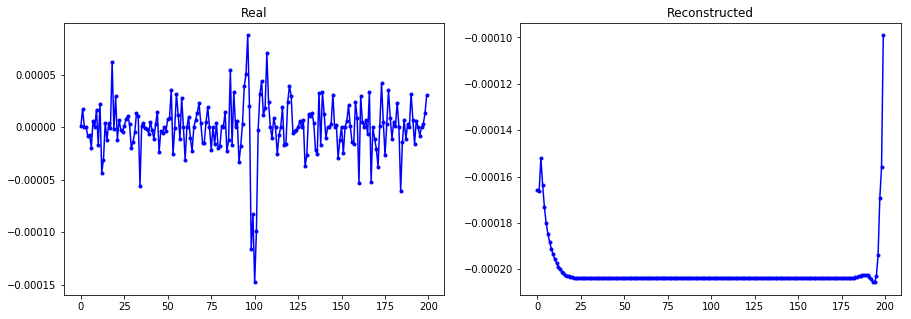

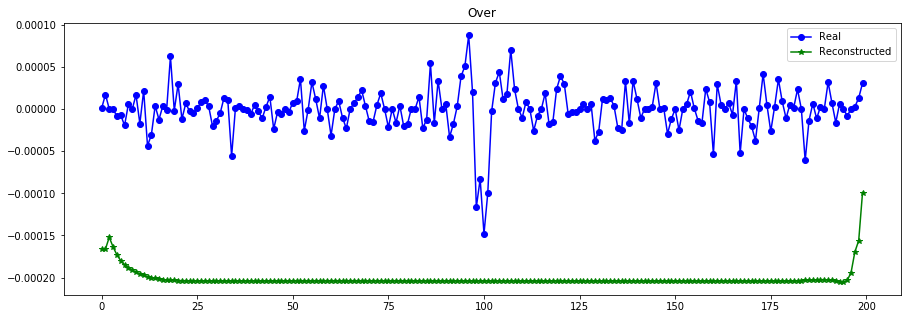

----------------------------------------------------------------


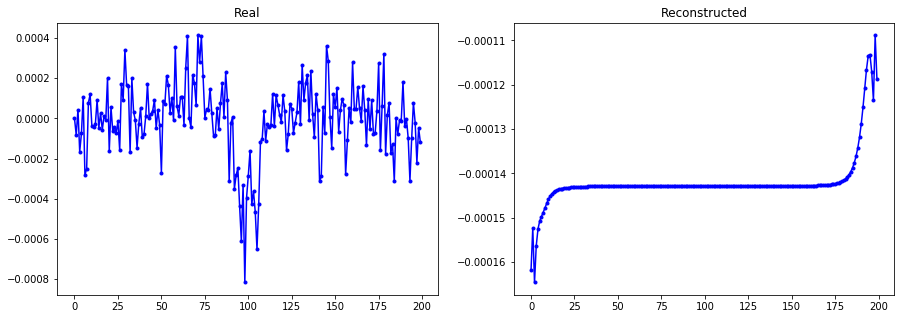

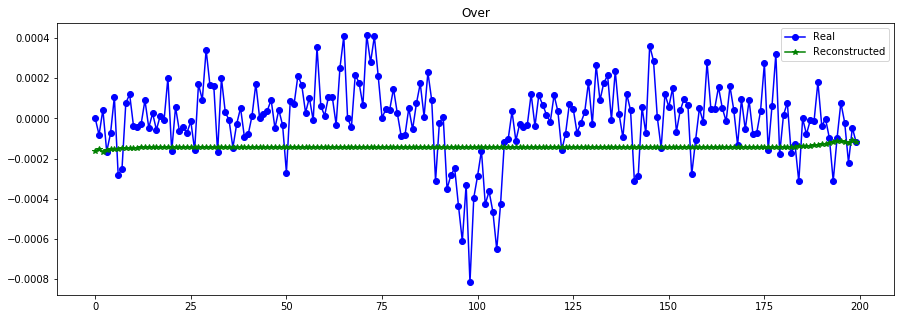

----------------------------------------------------------------


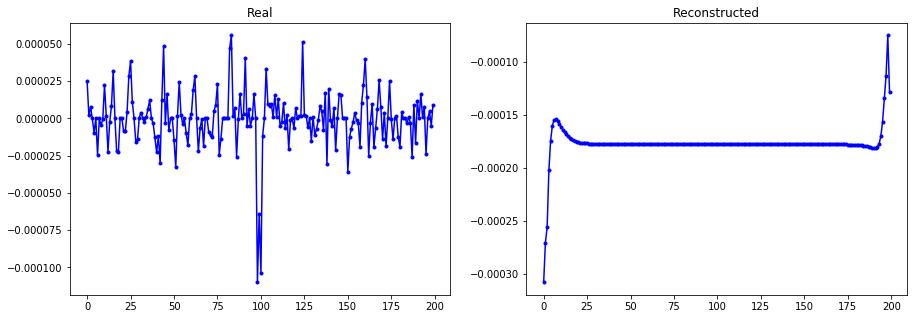

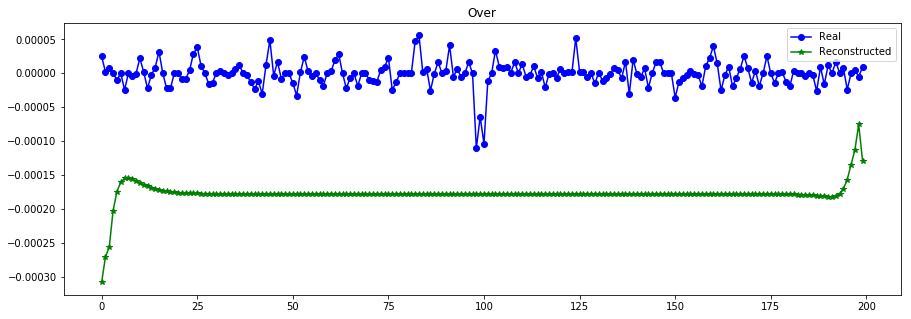

----------------------------------------------------------------


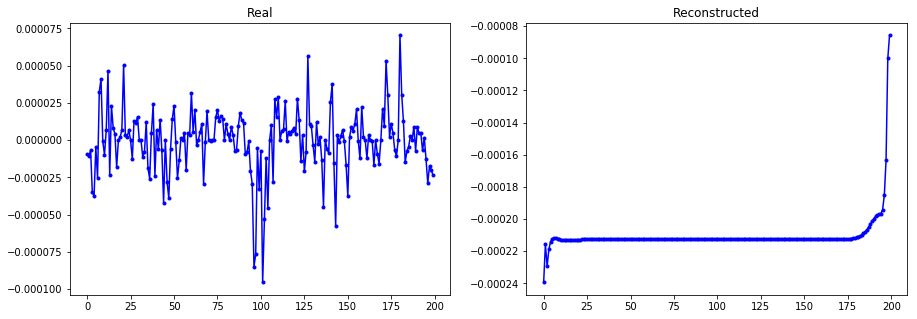

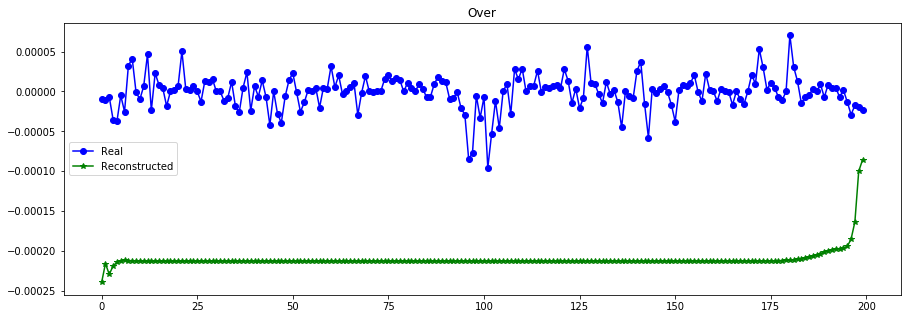

----------------------------------------------------------------


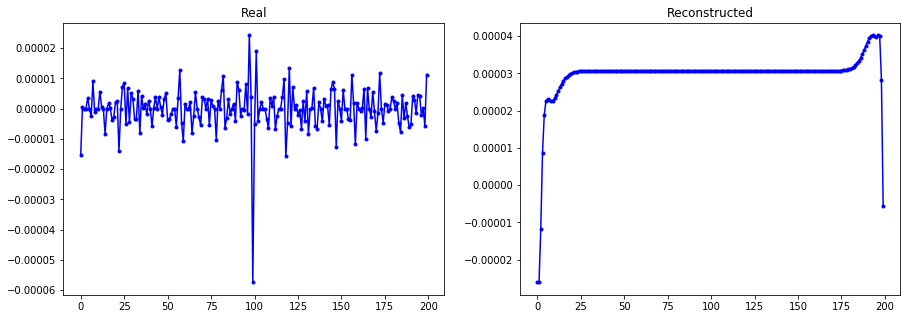

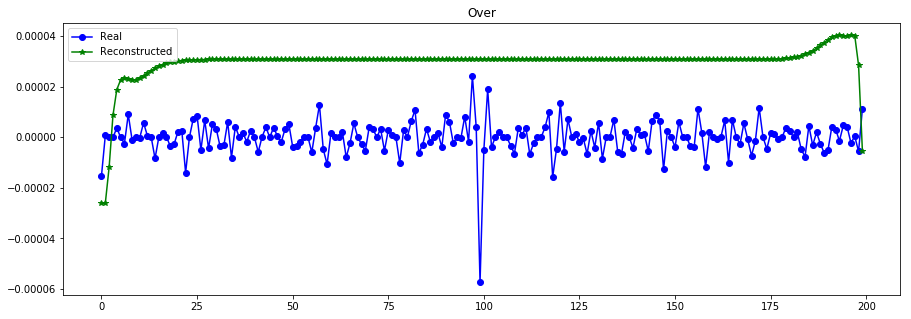

----------------------------------------------------------------


In [55]:
X_train_hat = vae.predict([X_train_t,X_train], batch_size=512)
plot_n_lc(X_train[:,:,0], X_train_hat, n= 10) ###con 200 epochs T=200 global (CURVAS TRANSITO) normal

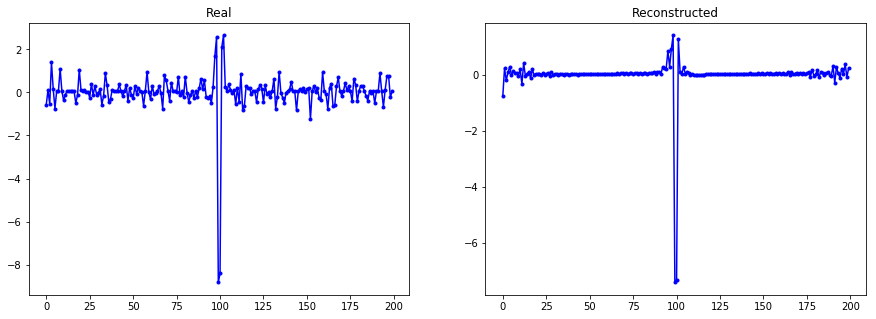

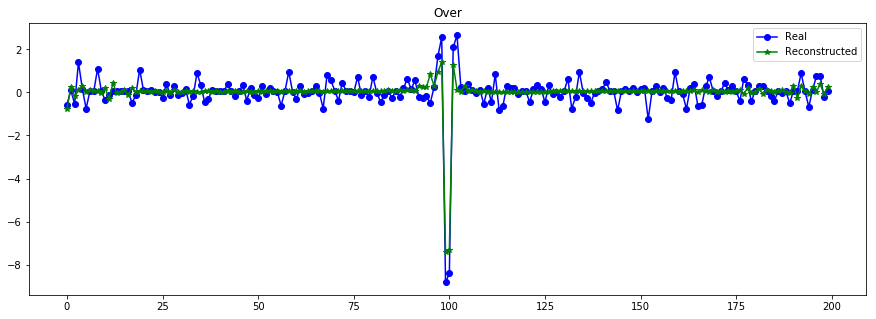

----------------------------------------------------------------


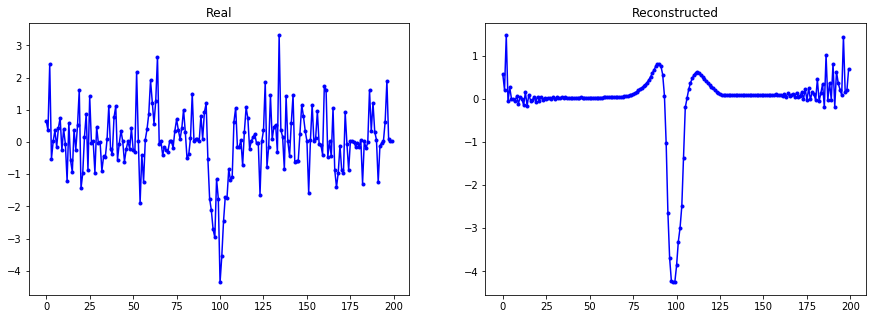

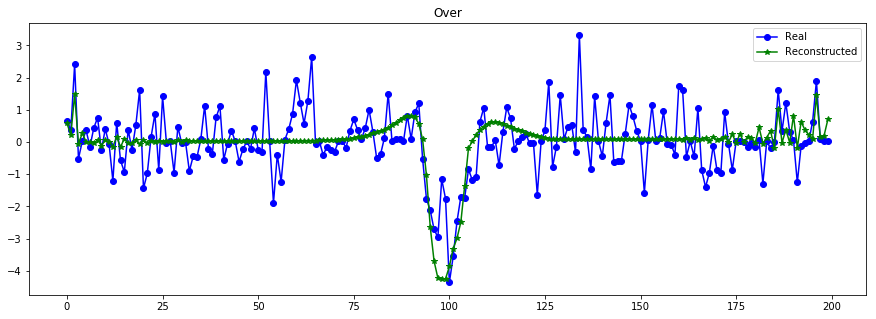

----------------------------------------------------------------


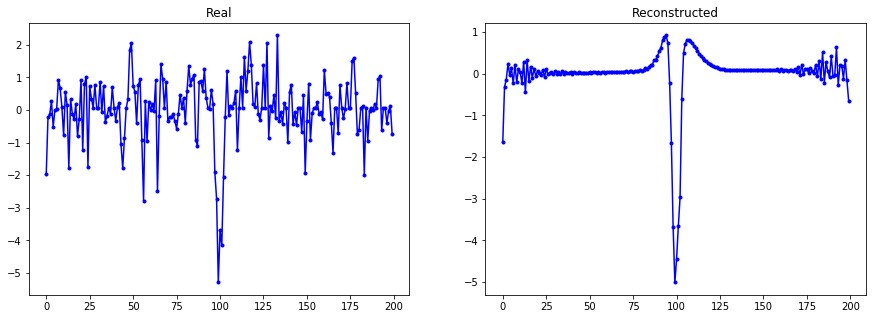

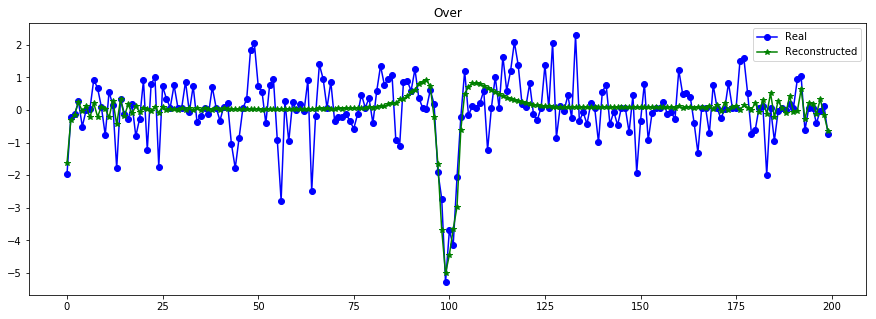

----------------------------------------------------------------


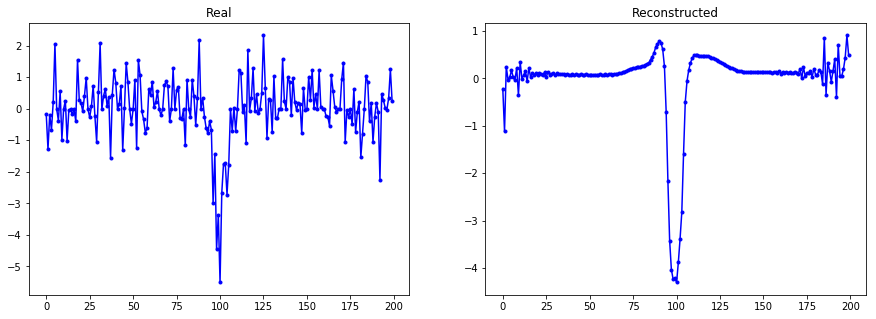

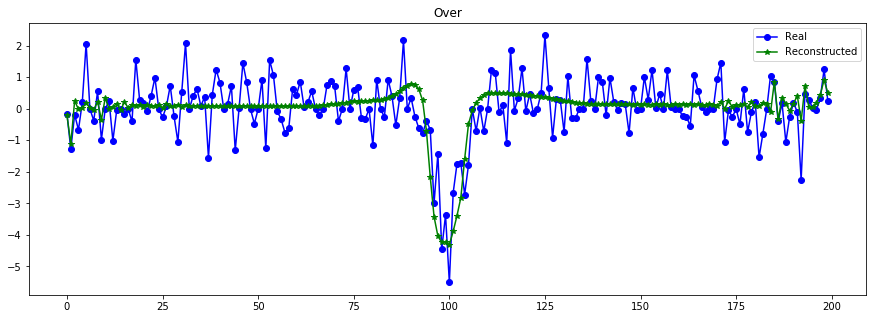

----------------------------------------------------------------


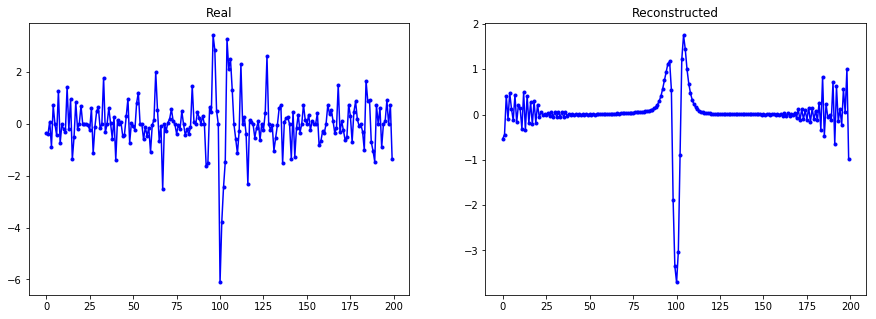

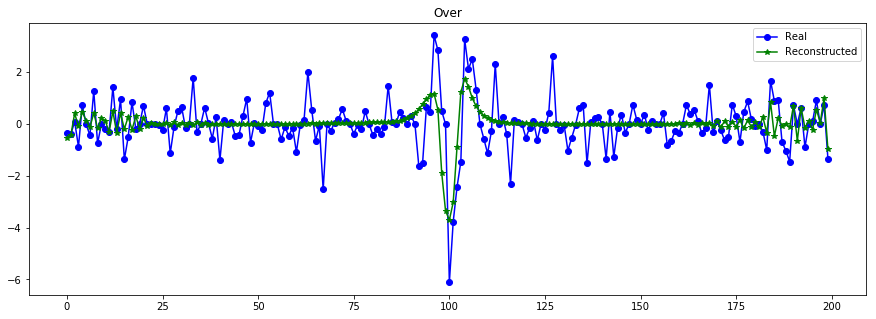

----------------------------------------------------------------


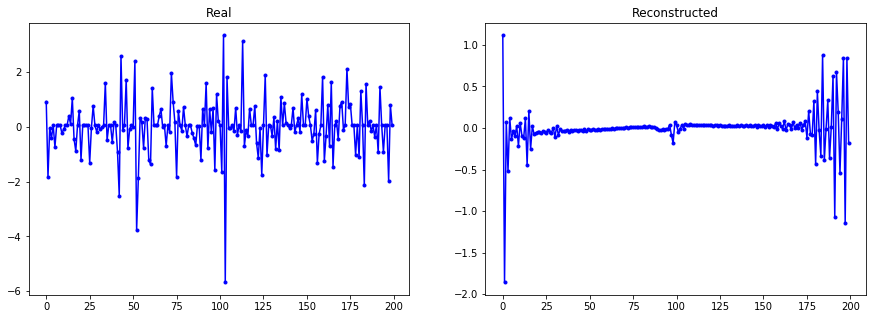

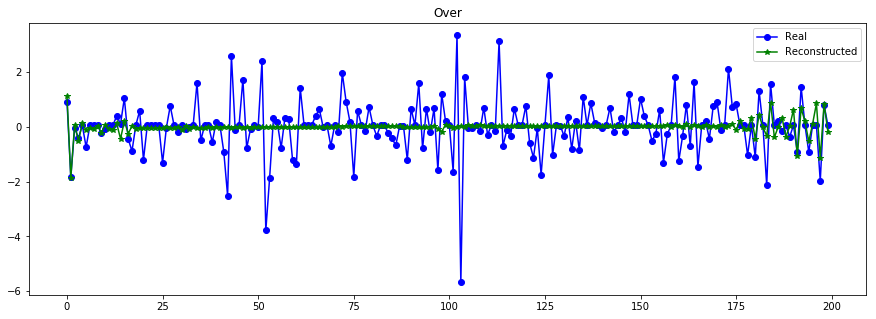

----------------------------------------------------------------


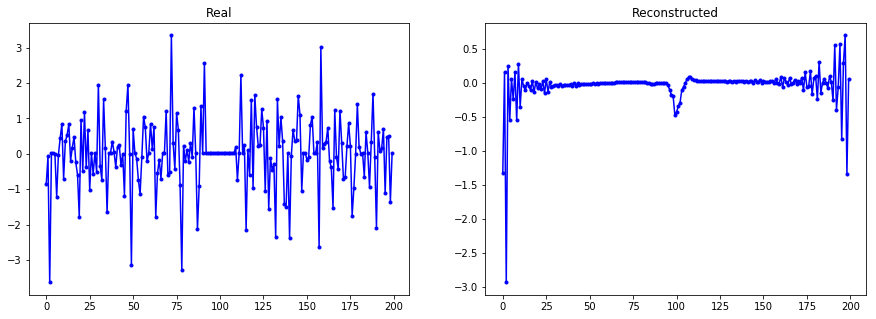

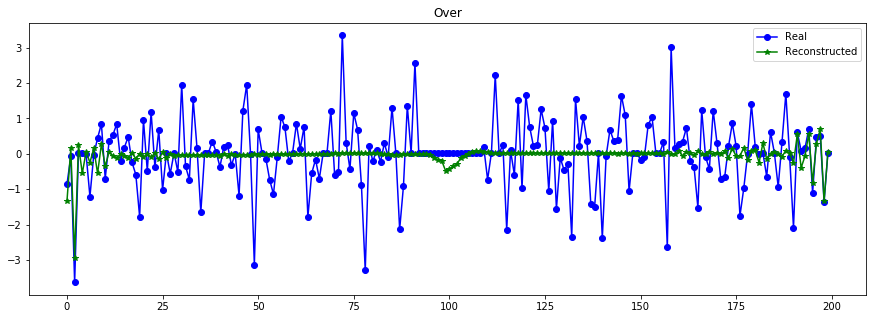

----------------------------------------------------------------


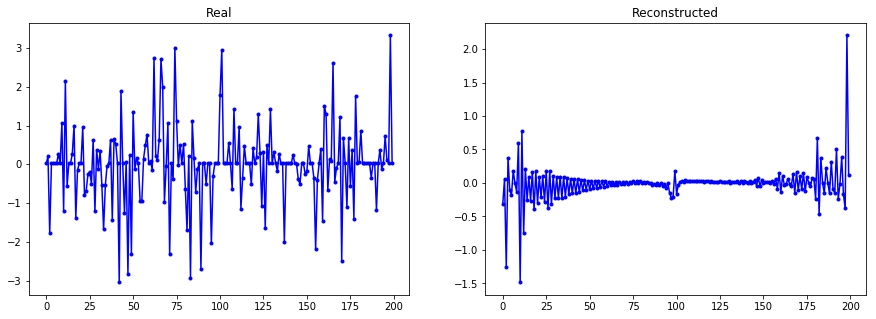

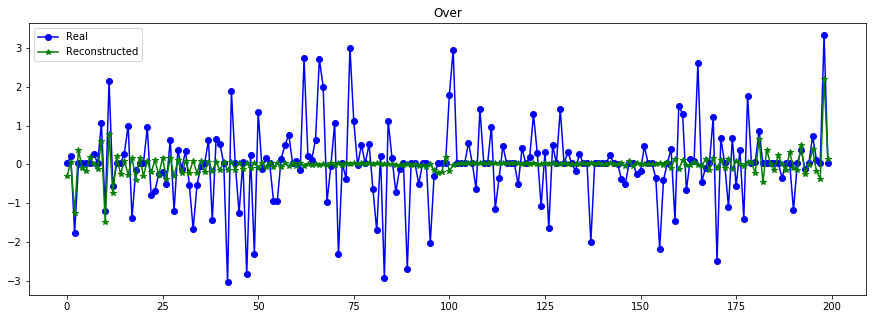

----------------------------------------------------------------


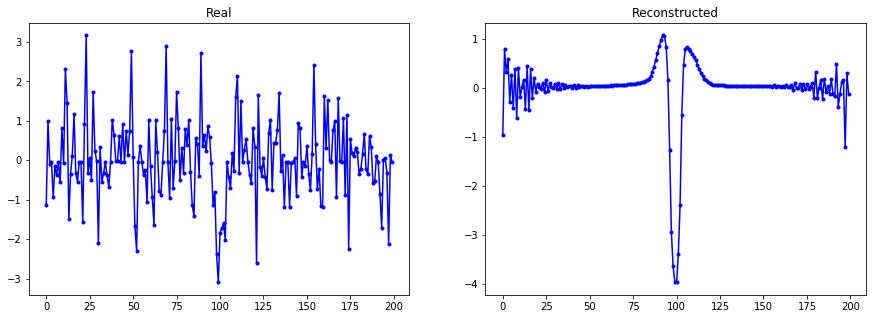

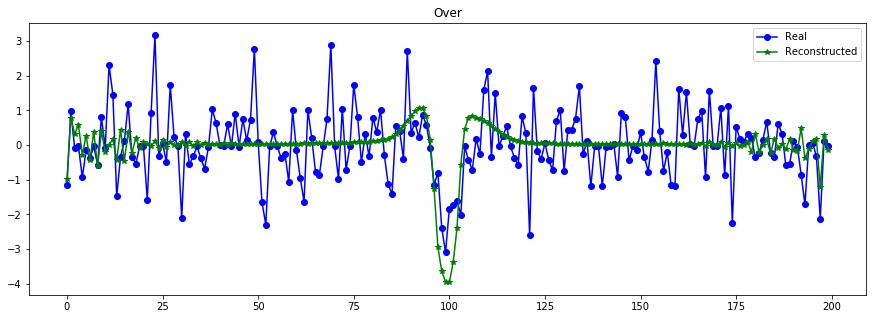

----------------------------------------------------------------


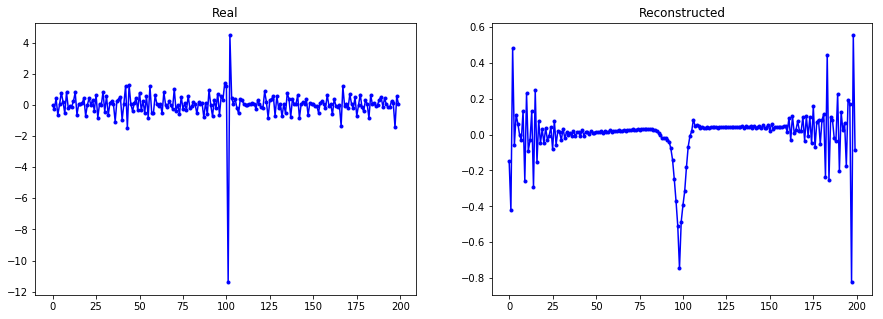

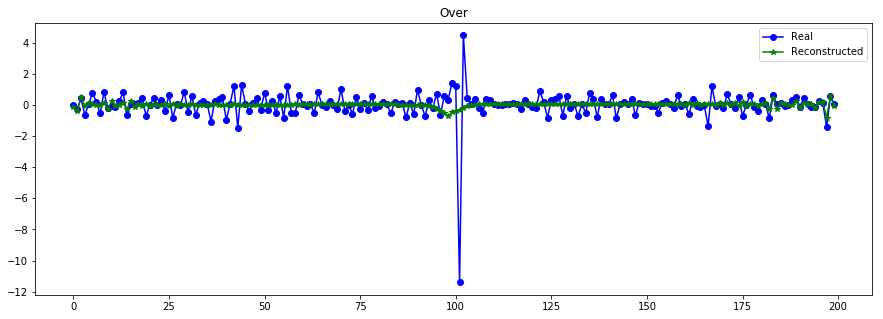

----------------------------------------------------------------


In [32]:
X_train_hat = vae.predict([X_train_t,X_train], batch_size=512)
plot_n_lc(X_train[:,:,0], X_train_hat, n= 10) ###con 200 epochs T=200 global (CURVAS TRANSITO) std rep

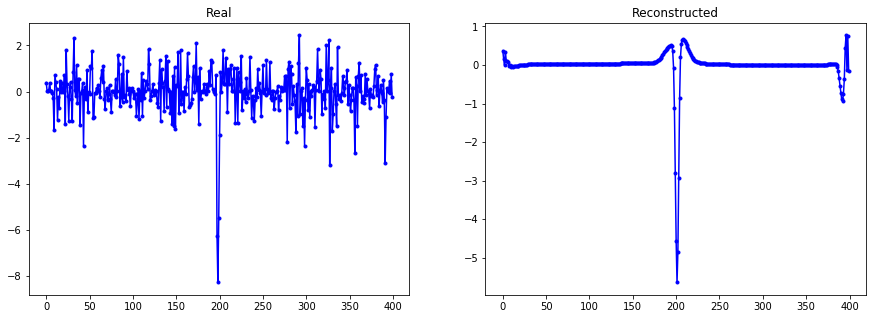

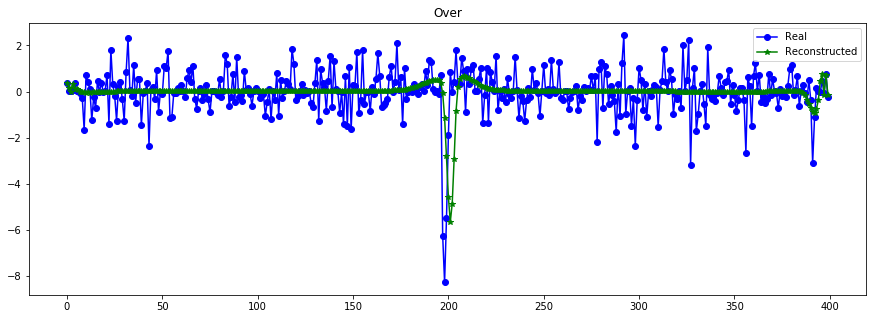

----------------------------------------------------------------


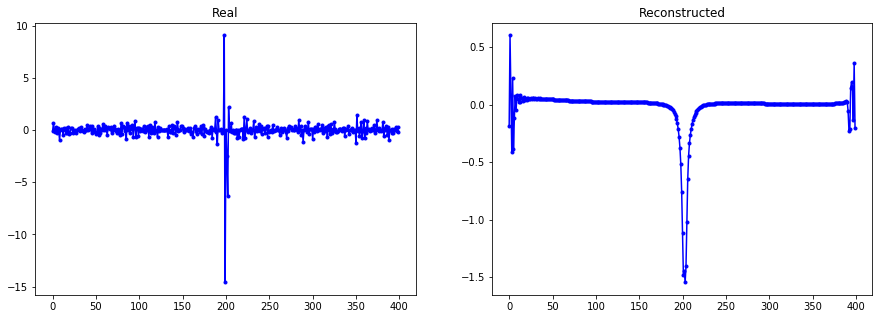

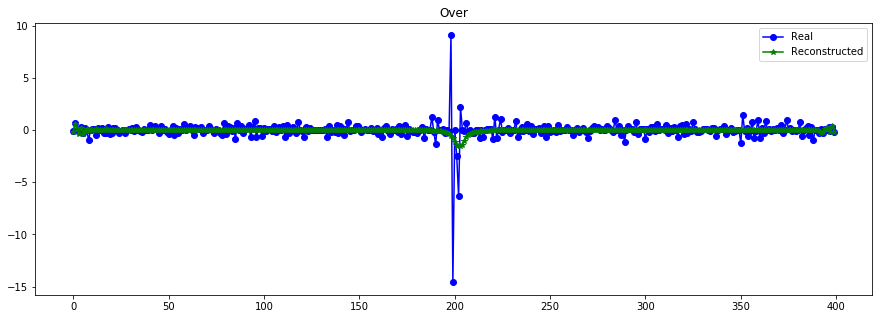

----------------------------------------------------------------


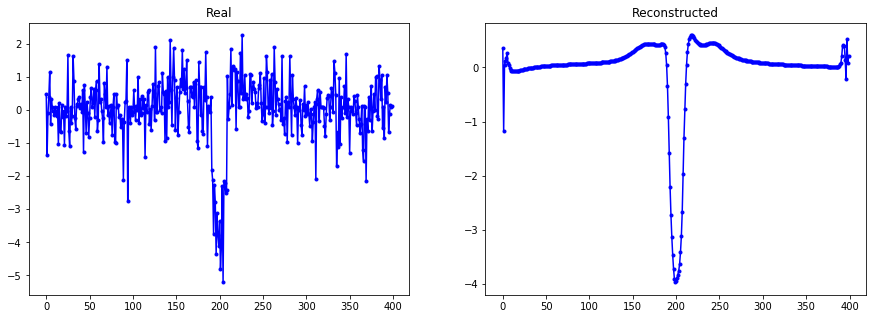

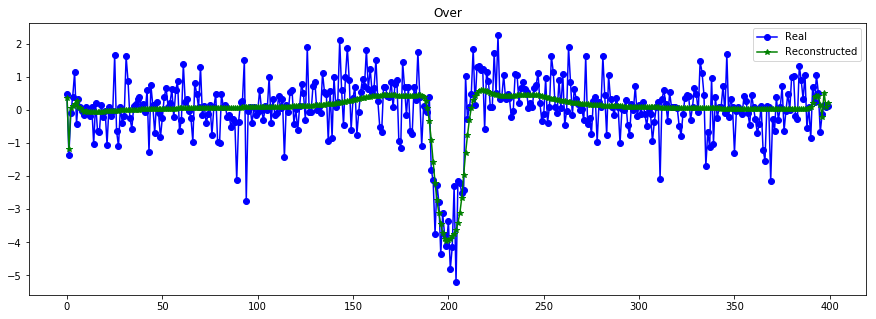

----------------------------------------------------------------


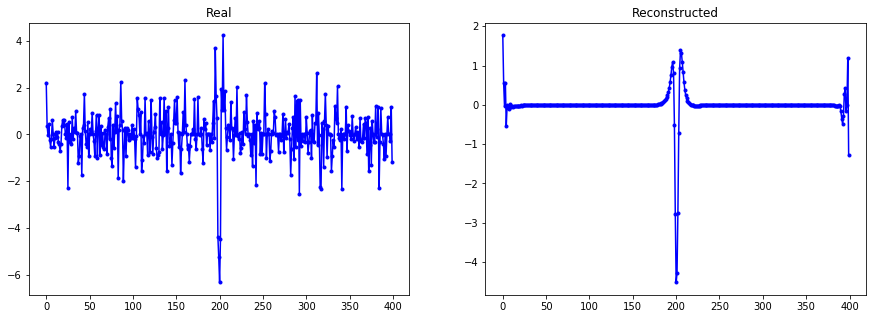

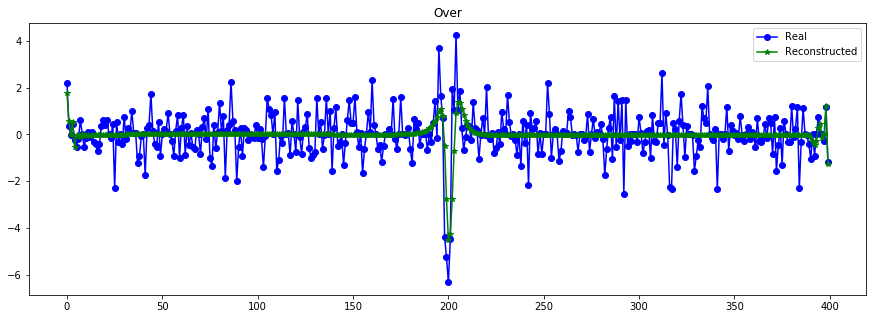

----------------------------------------------------------------


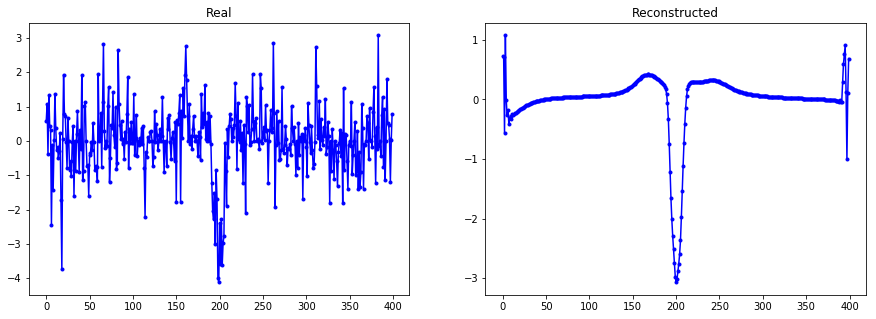

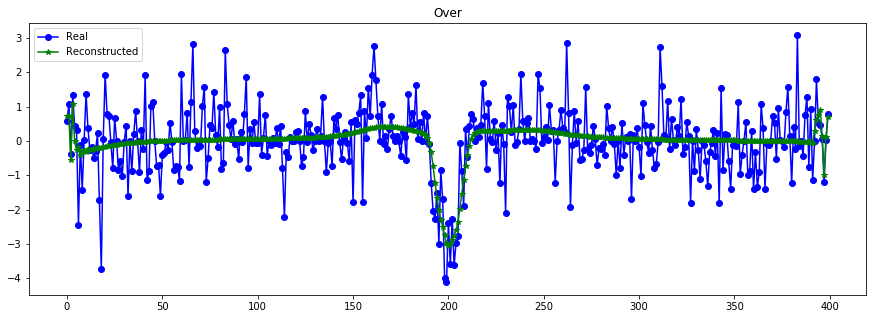

----------------------------------------------------------------


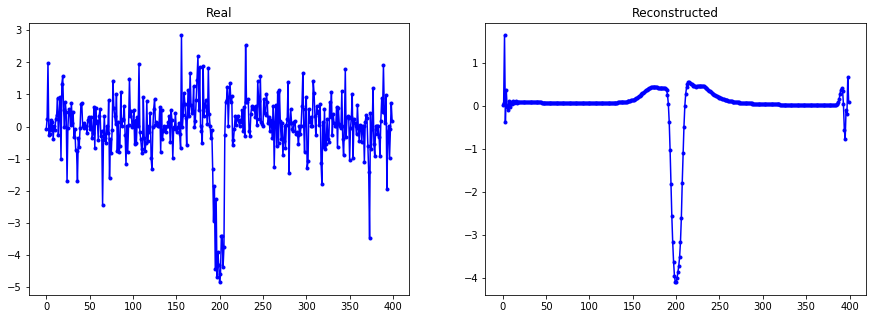

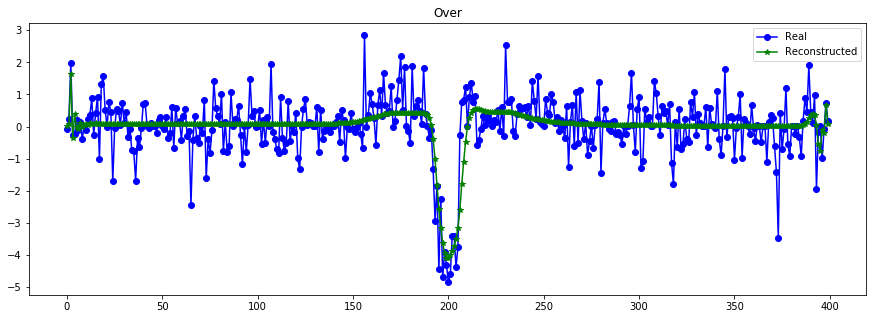

----------------------------------------------------------------


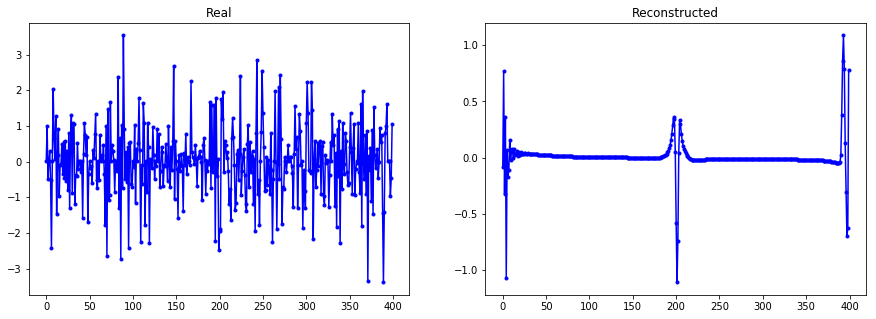

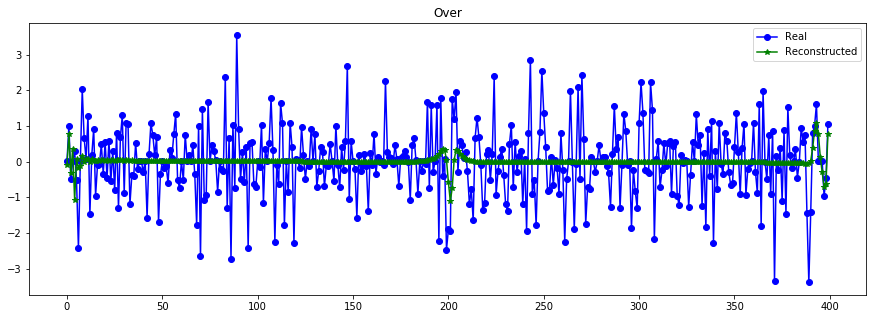

----------------------------------------------------------------


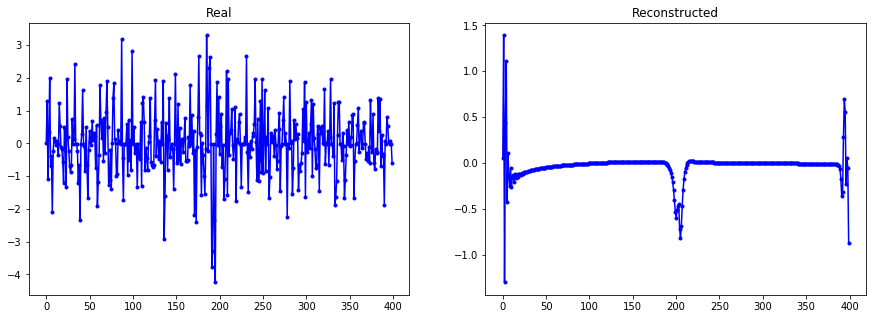

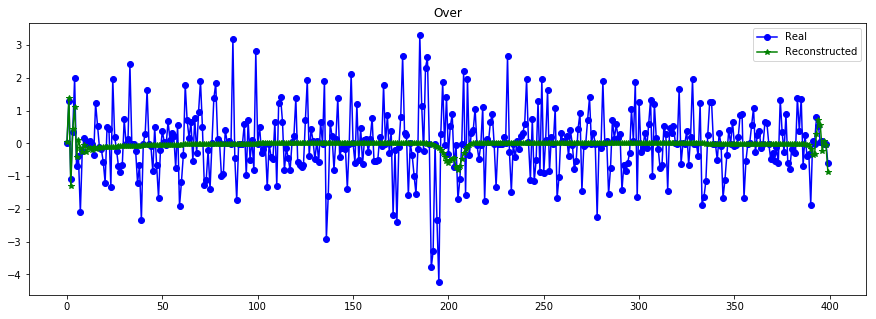

----------------------------------------------------------------


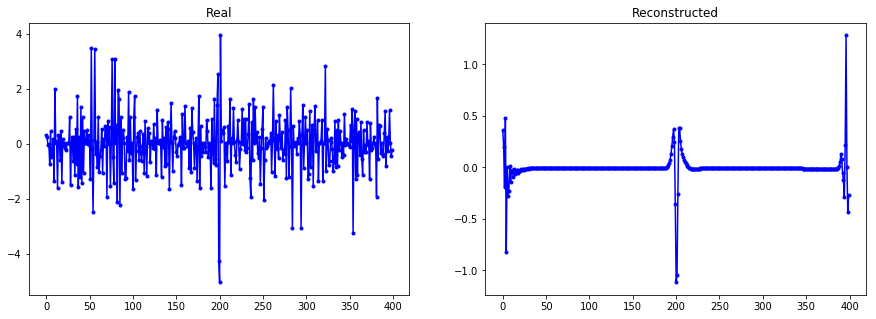

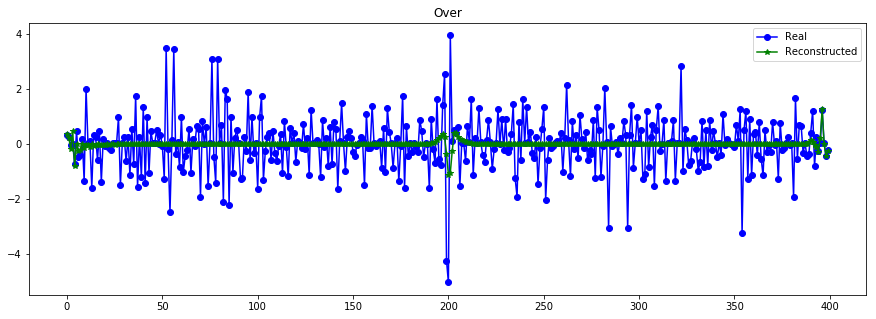

----------------------------------------------------------------


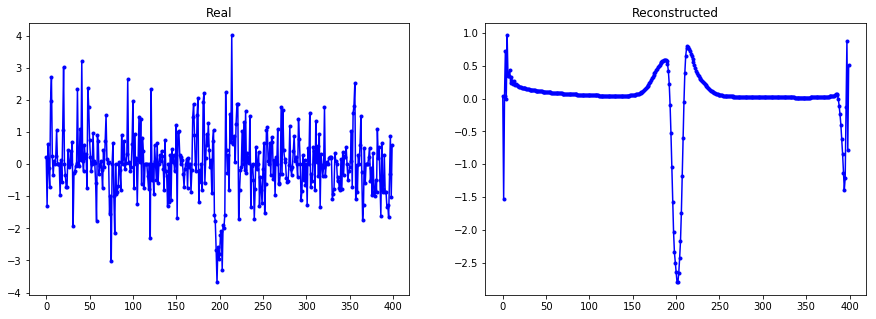

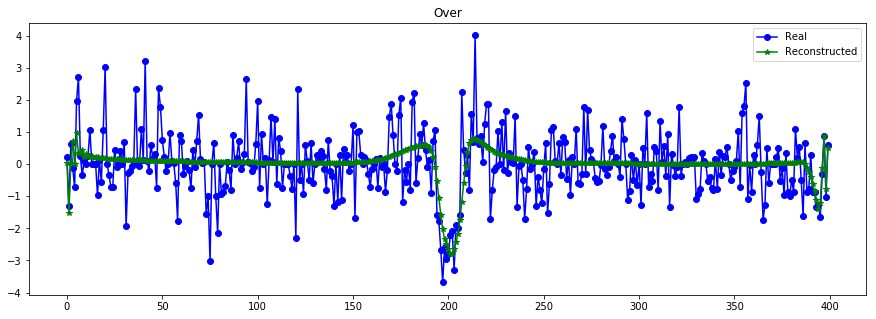

----------------------------------------------------------------


In [38]:
X_train_hat = vae.predict([X_train_t,X_train], batch_size=512)
plot_n_lc(X_train[:,:,0], X_train_hat, n= 10) ###con 200 epochs T=400 global (CURVAS TRANSITO) std rep

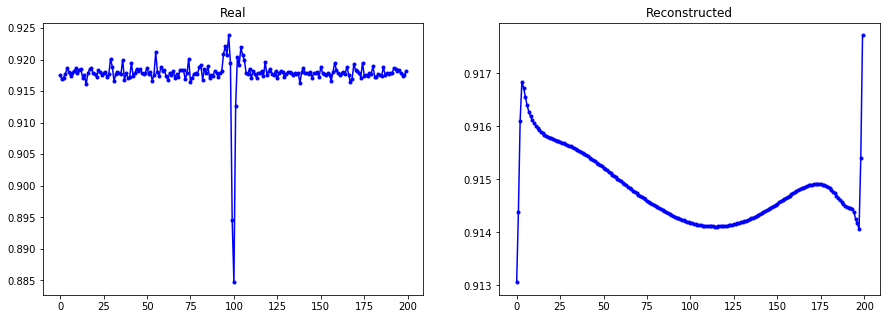

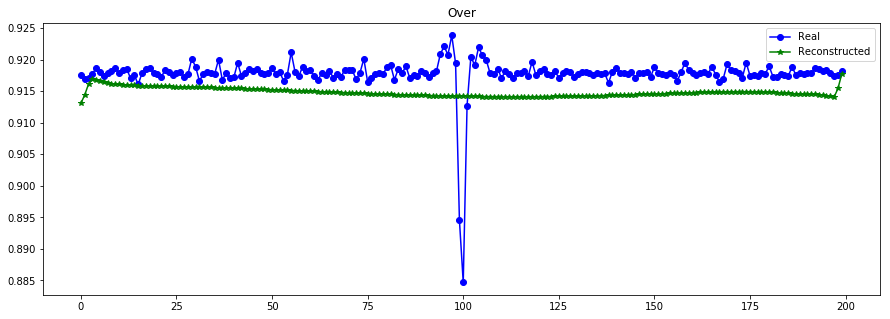

----------------------------------------------------------------


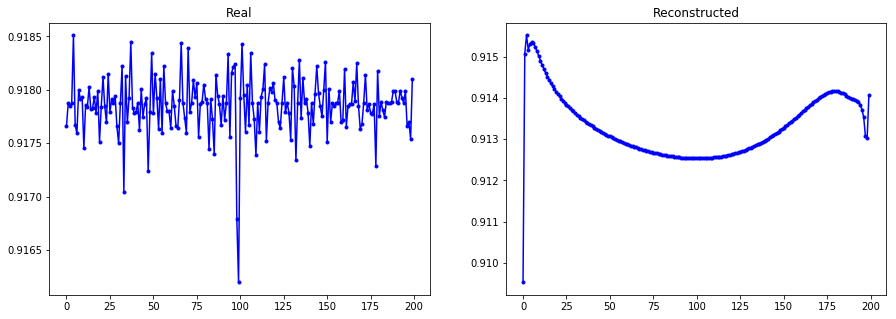

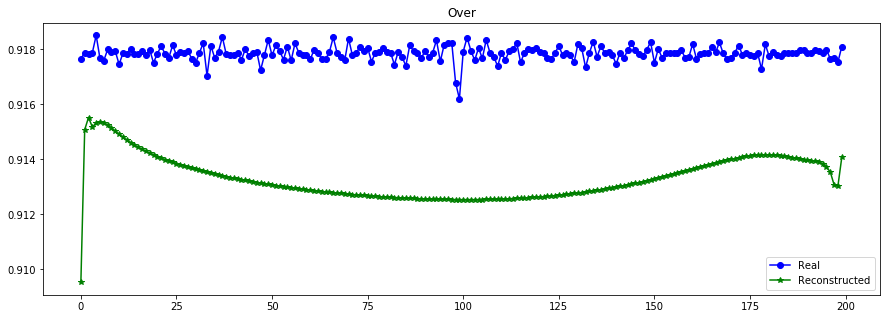

----------------------------------------------------------------


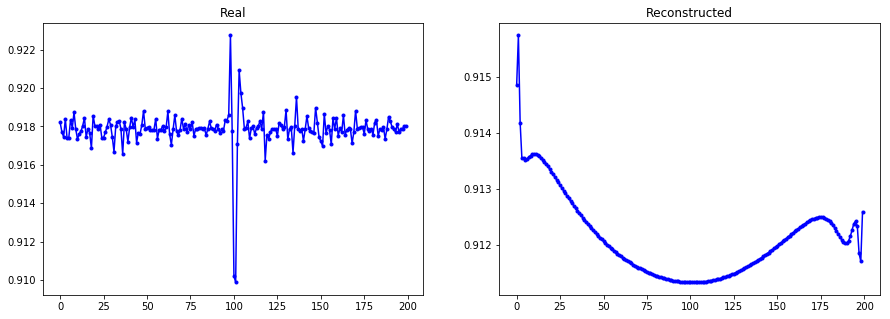

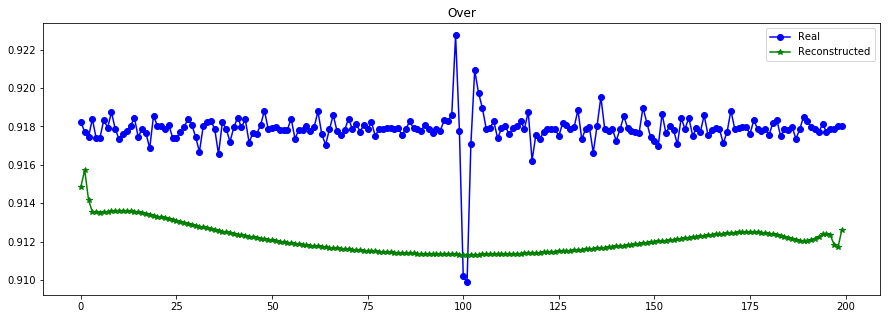

----------------------------------------------------------------


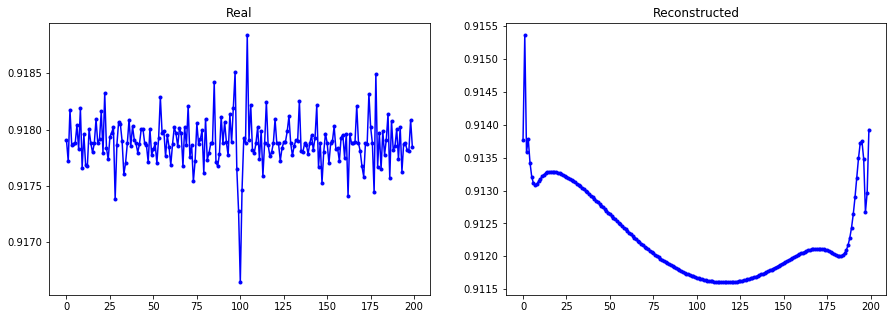

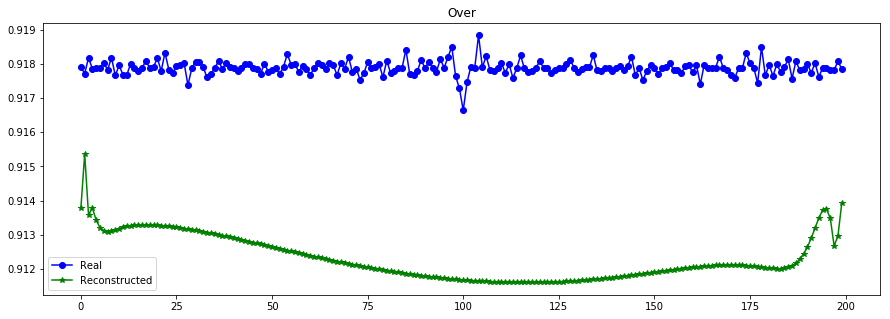

----------------------------------------------------------------


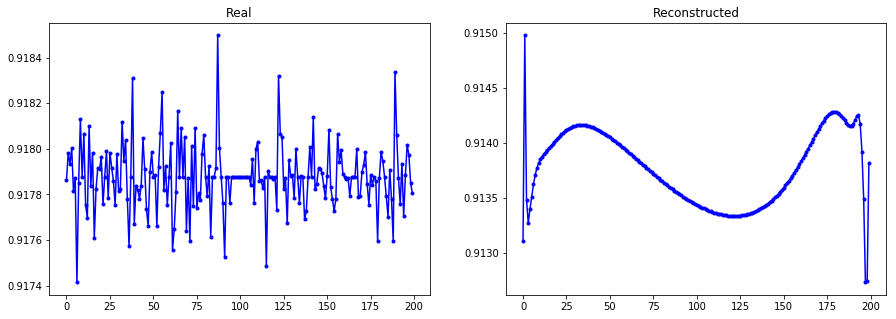

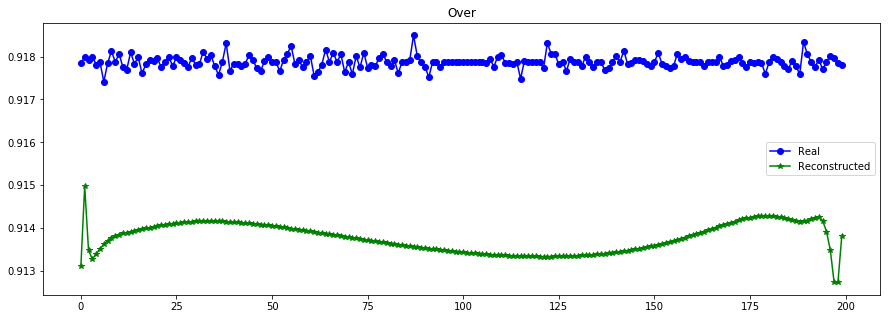

----------------------------------------------------------------


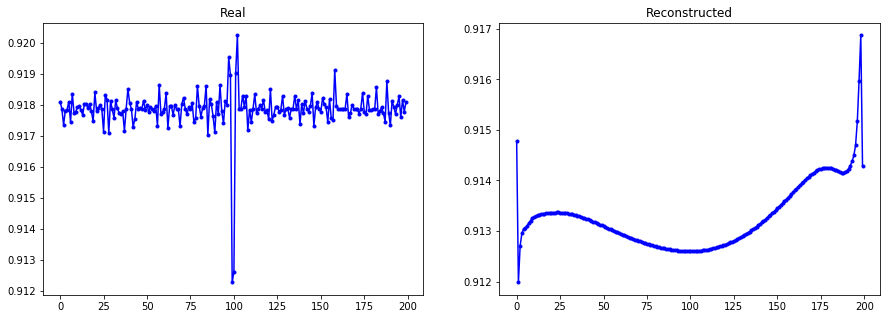

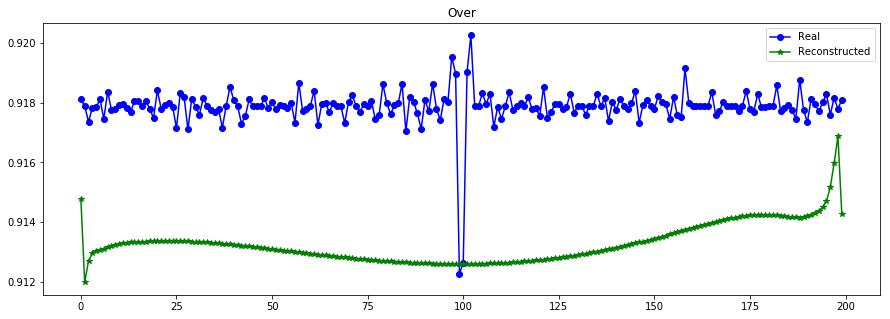

----------------------------------------------------------------


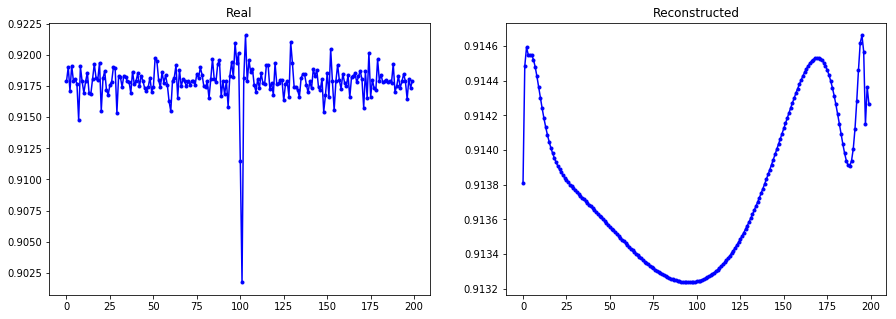

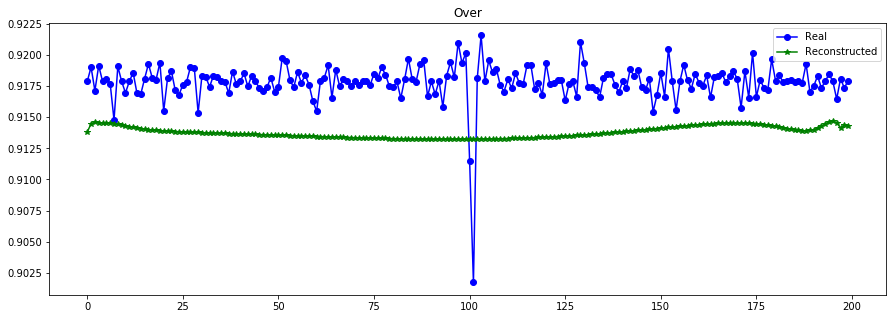

----------------------------------------------------------------


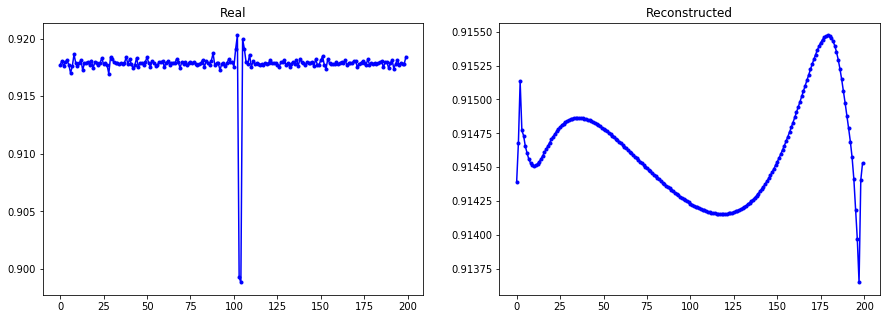

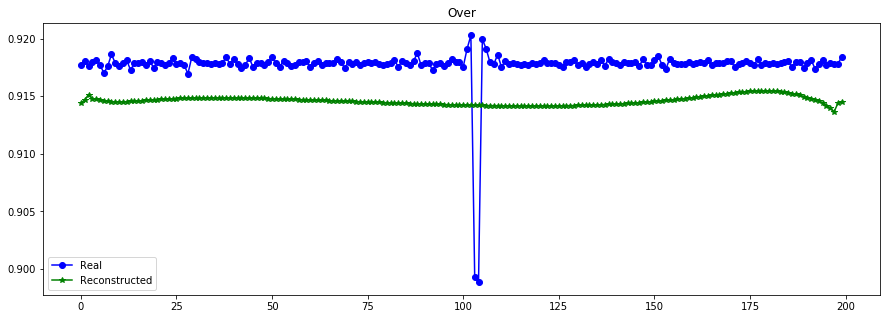

----------------------------------------------------------------


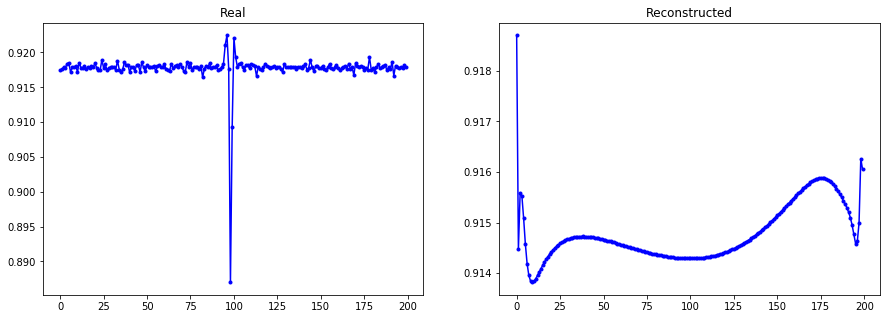

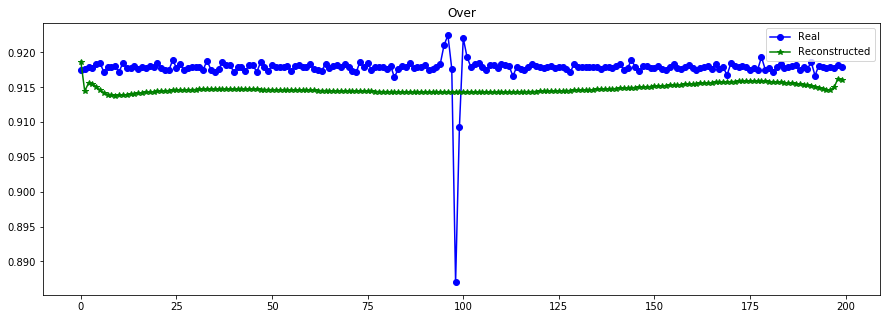

----------------------------------------------------------------


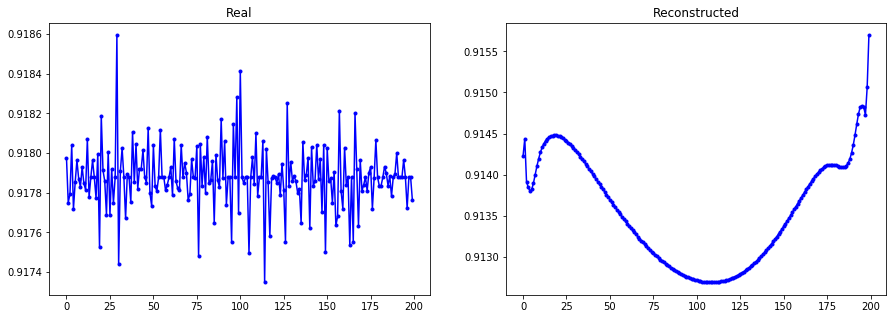

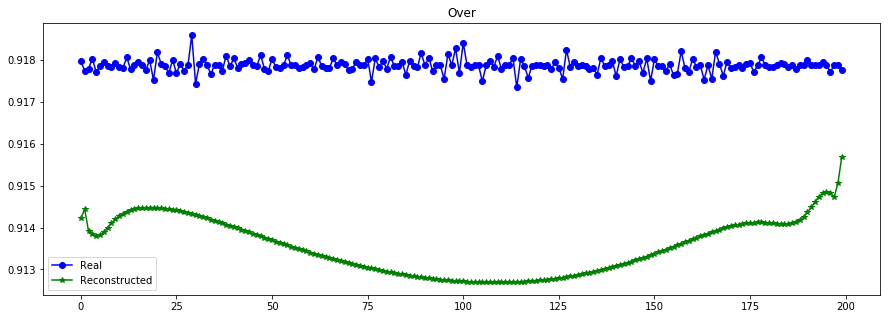

----------------------------------------------------------------


In [48]:
X_train_hat = vae.predict([X_train_t,X_train], batch_size=512)
plot_n_lc(X_train[:,:,0], X_train_hat, n= 10) ###con 200 epochs T=200 global (CURVAS TRANSITO) 0-1 rep

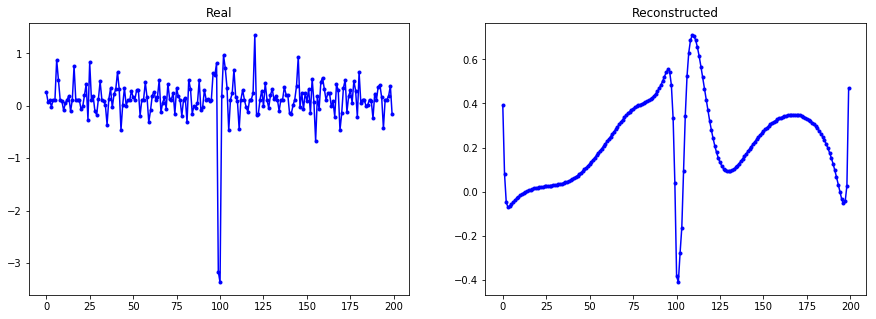

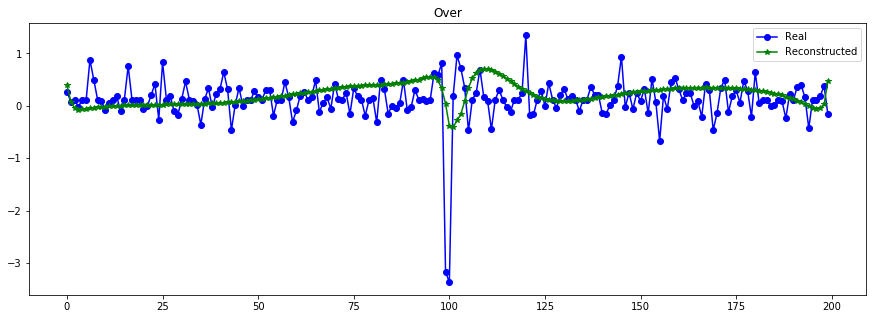

----------------------------------------------------------------


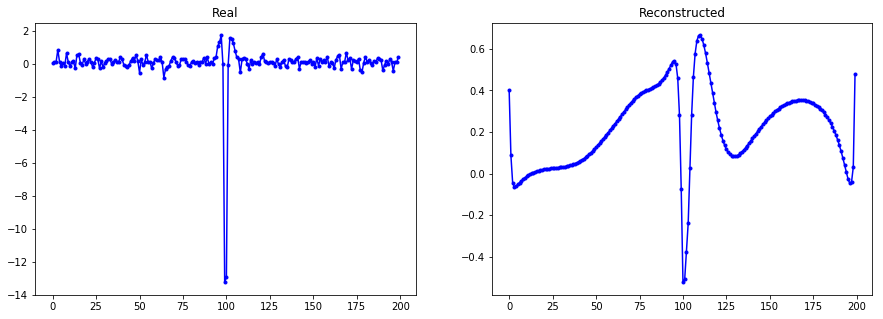

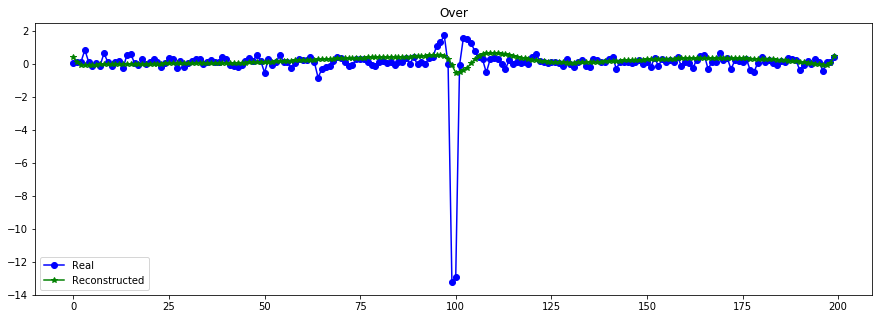

----------------------------------------------------------------


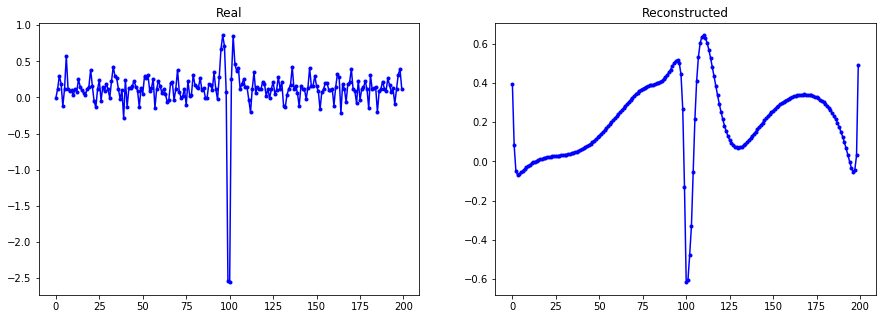

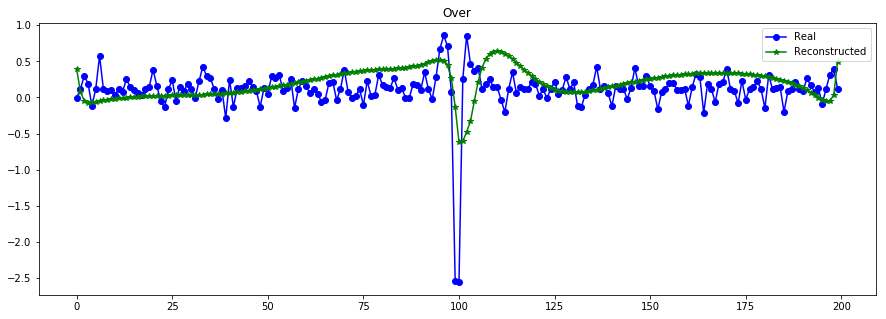

----------------------------------------------------------------


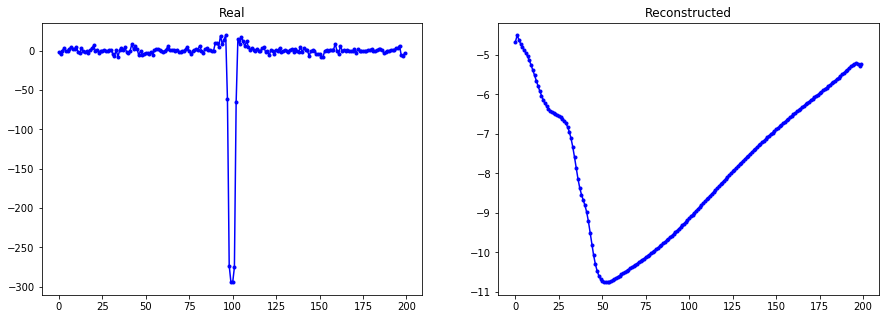

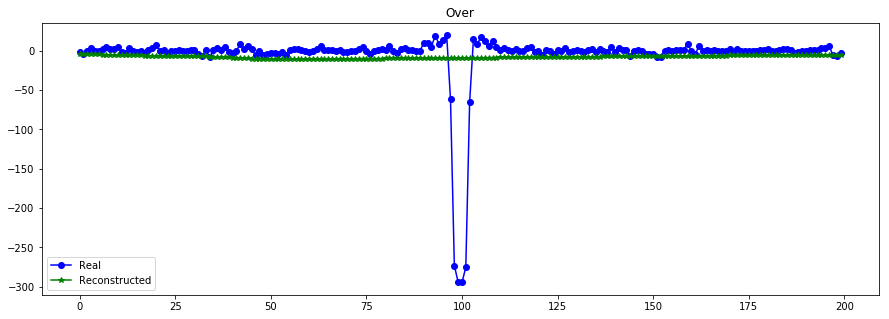

----------------------------------------------------------------


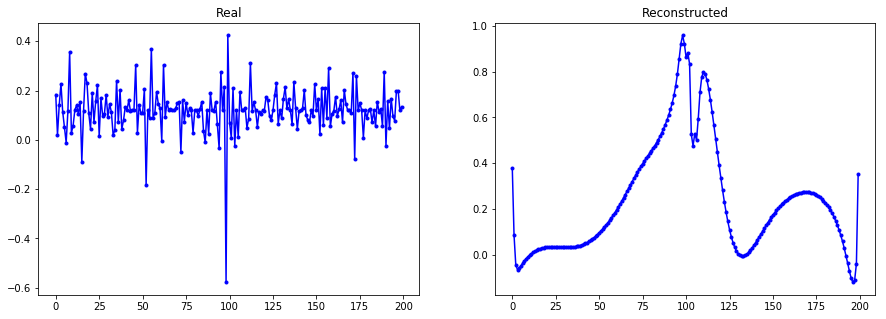

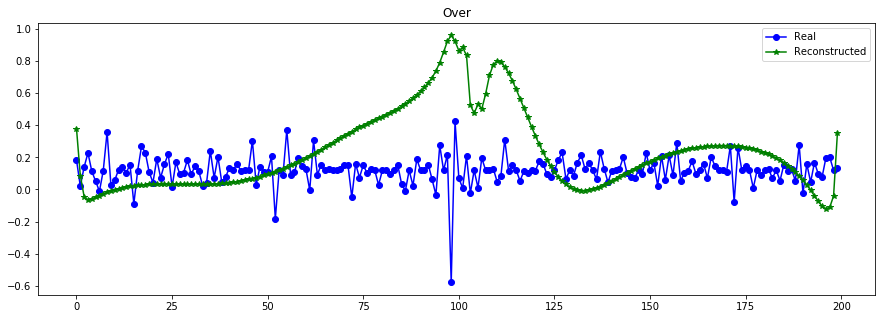

----------------------------------------------------------------


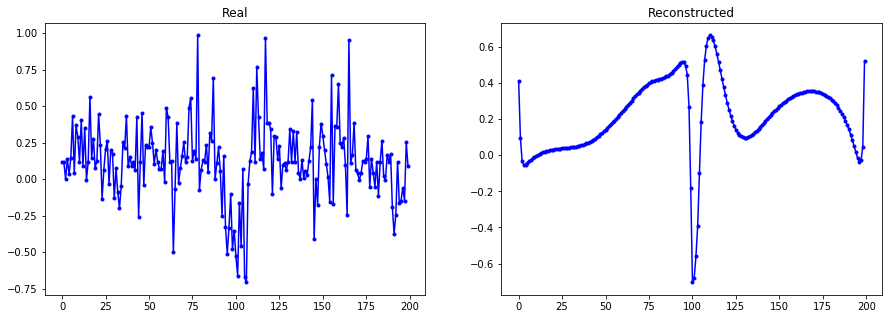

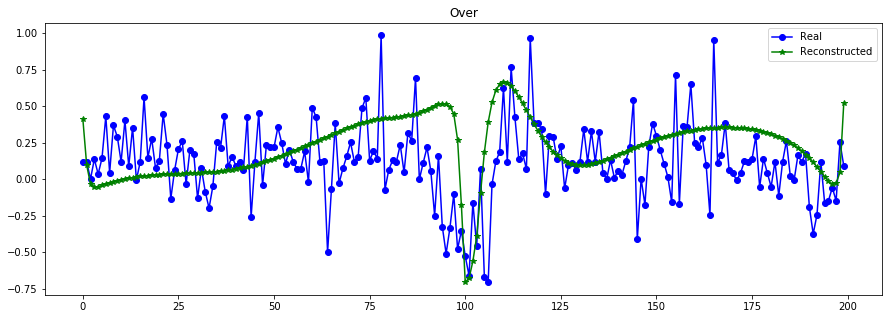

----------------------------------------------------------------


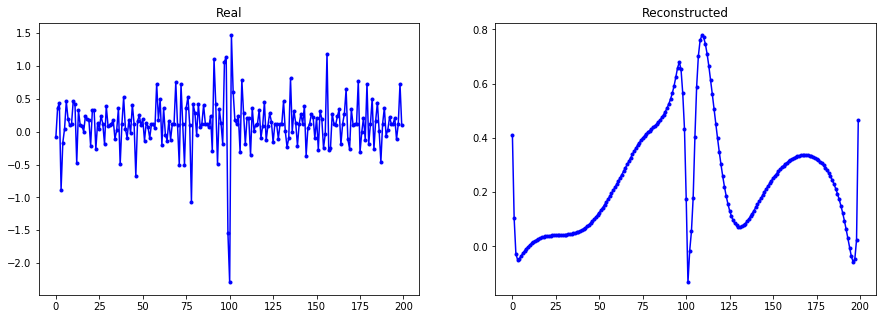

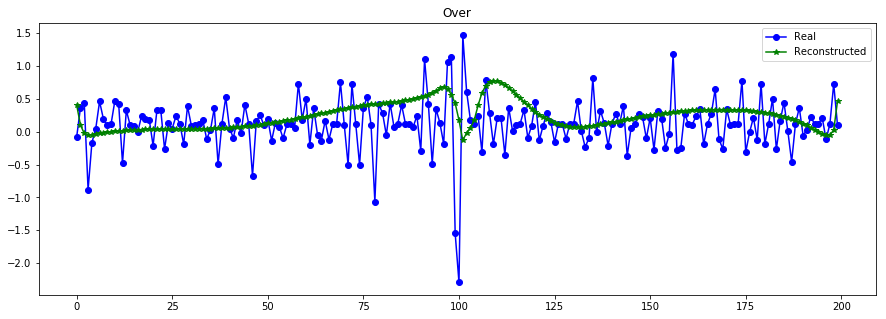

----------------------------------------------------------------


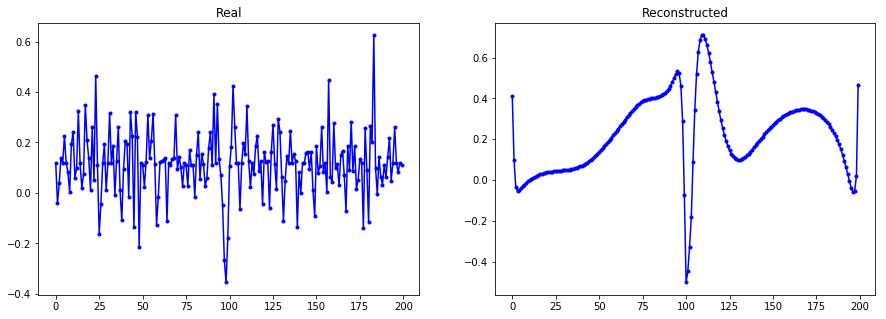

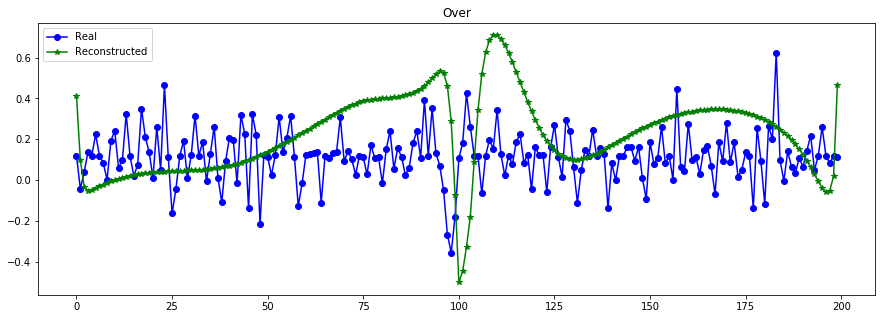

----------------------------------------------------------------


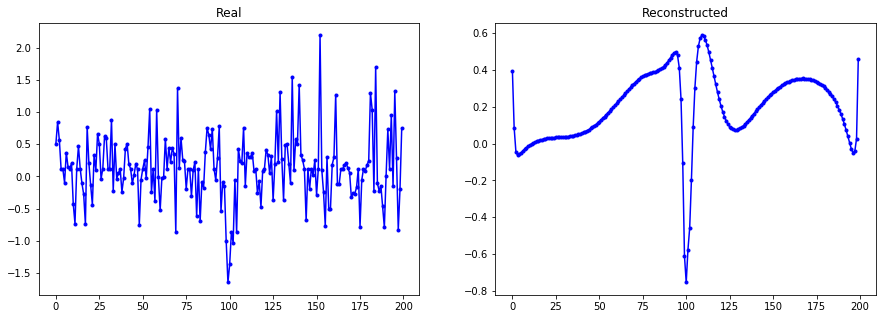

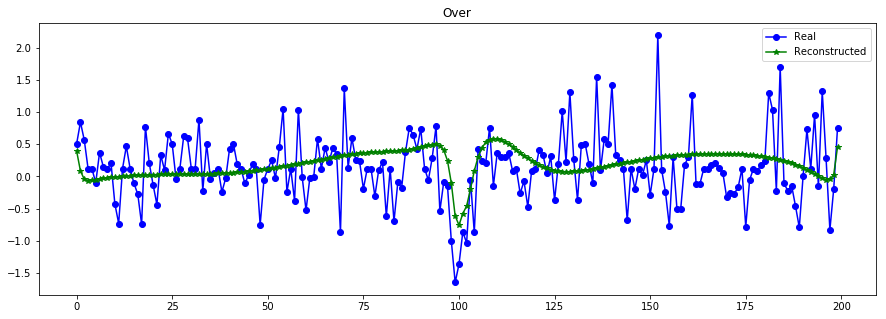

----------------------------------------------------------------


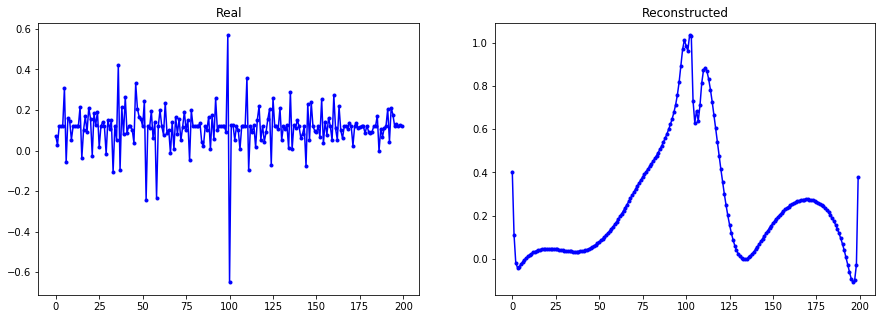

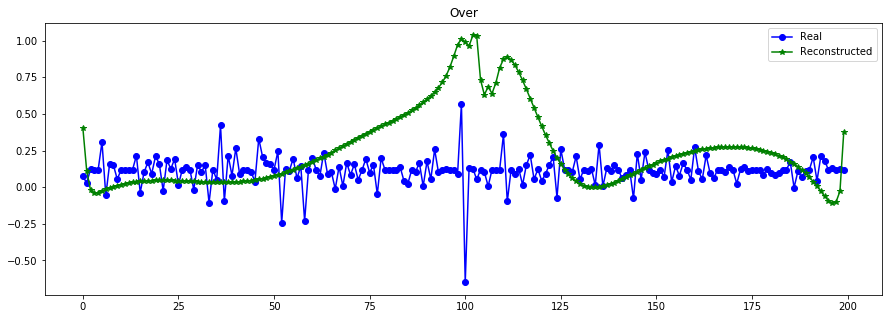

----------------------------------------------------------------


In [69]:
X_train_hat = vae.predict([X_train_t,X_train], batch_size=512)
plot_n_lc(X_train[:,:,0], X_train_hat, n= 10) ###con 200 epochs T=200 global (CURVAS TRANSITO) std global

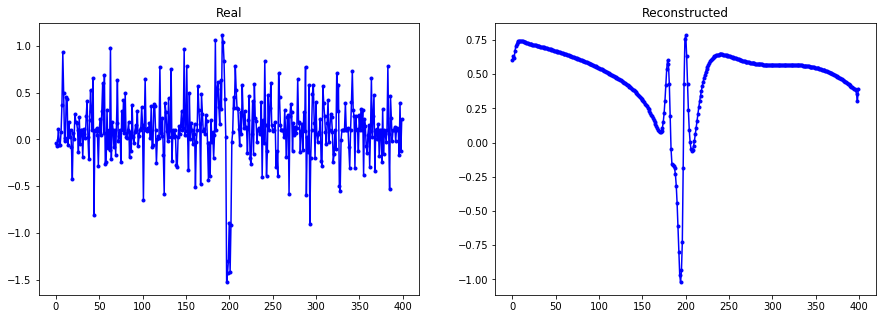

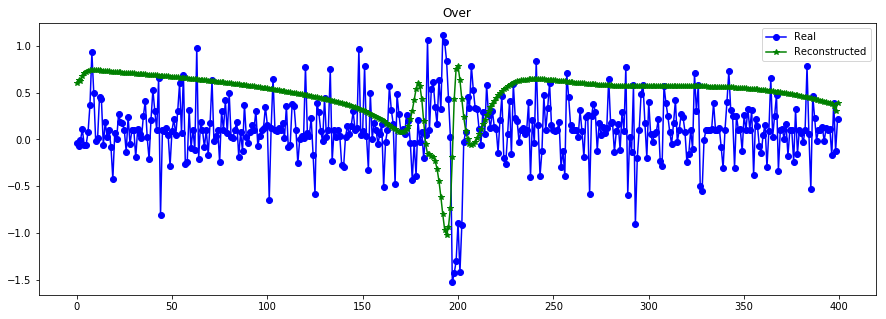

----------------------------------------------------------------


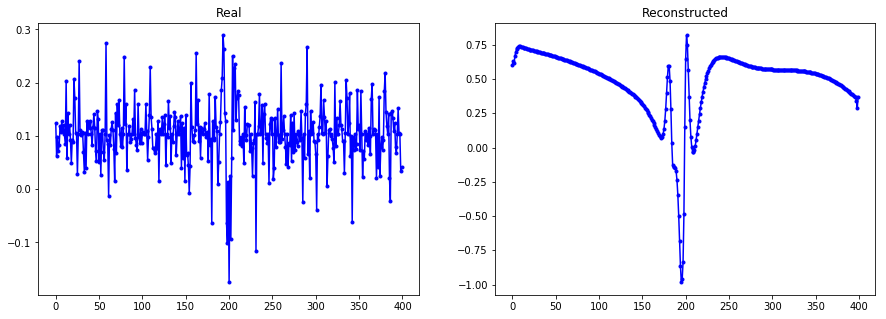

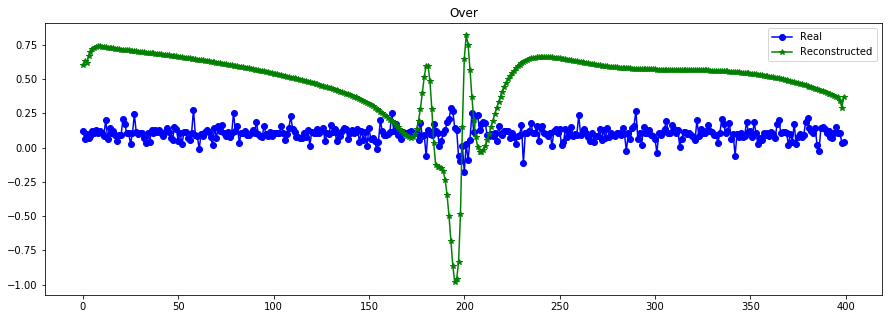

----------------------------------------------------------------


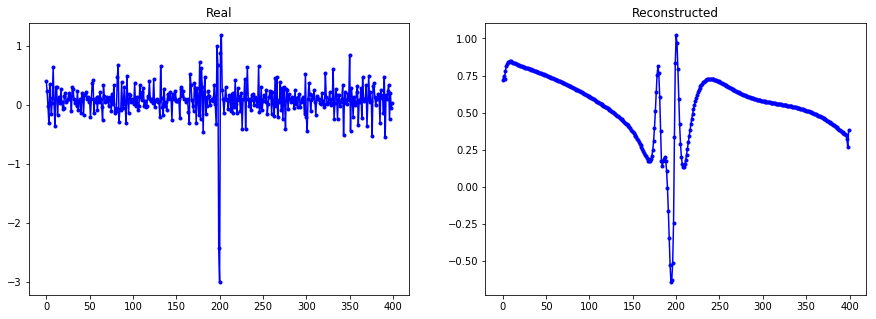

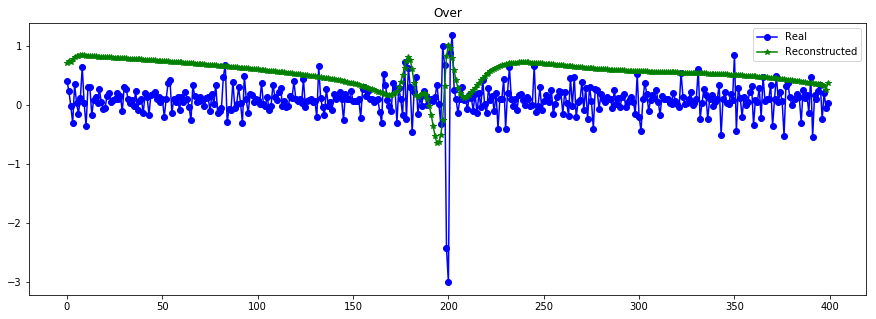

----------------------------------------------------------------


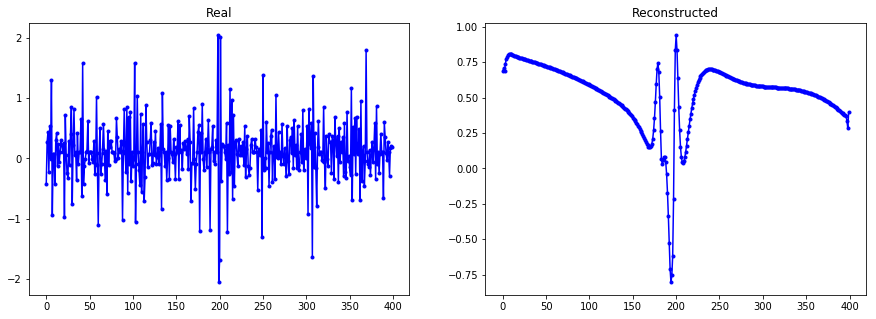

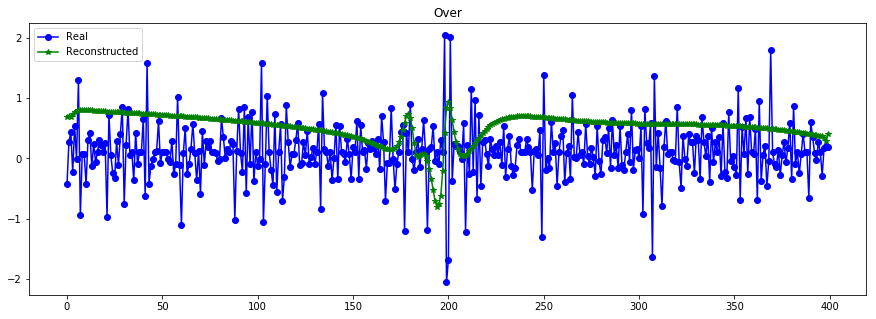

----------------------------------------------------------------


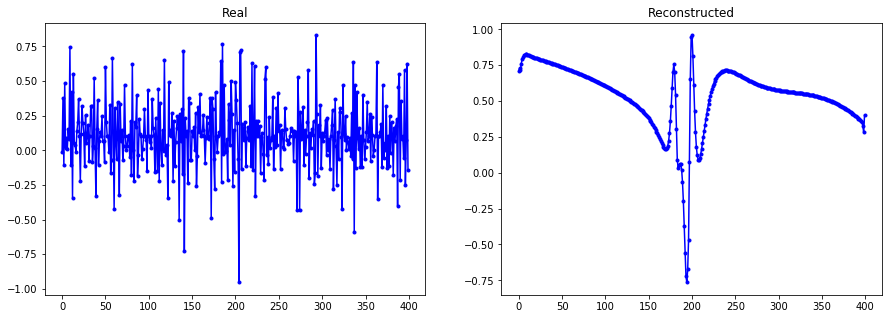

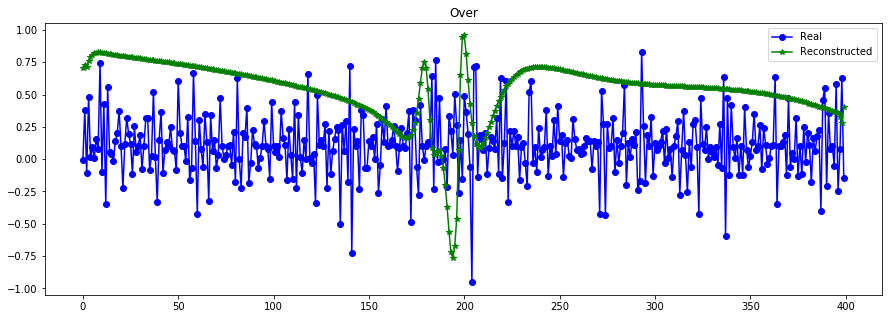

----------------------------------------------------------------


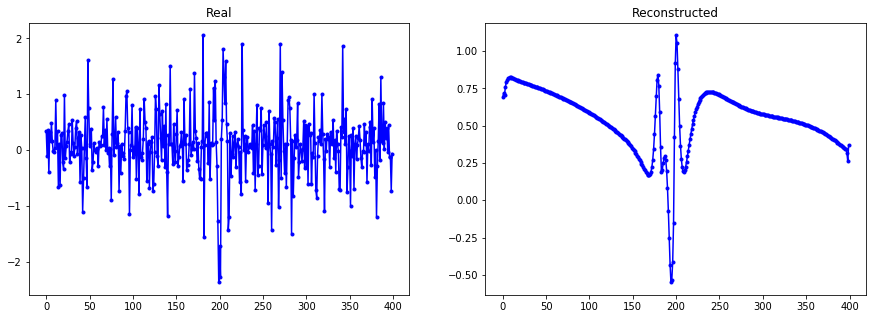

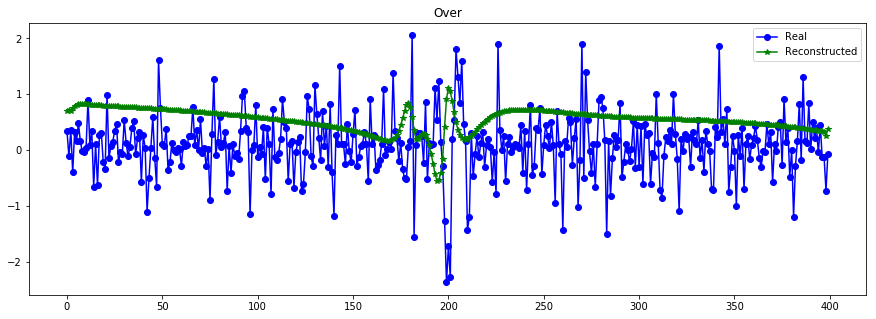

----------------------------------------------------------------


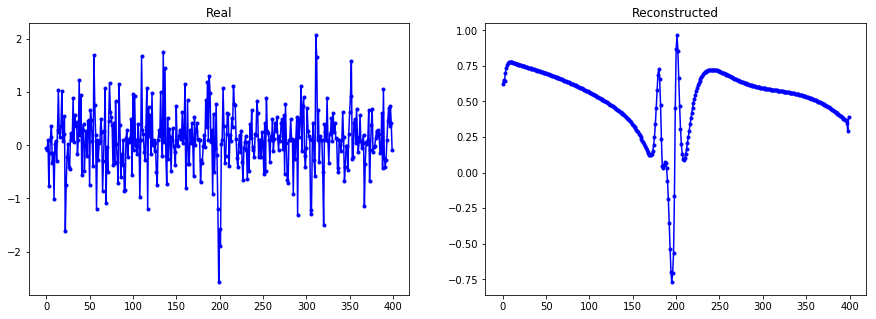

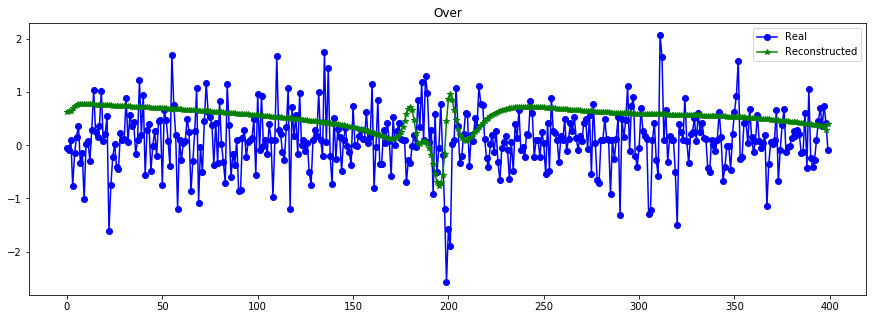

----------------------------------------------------------------


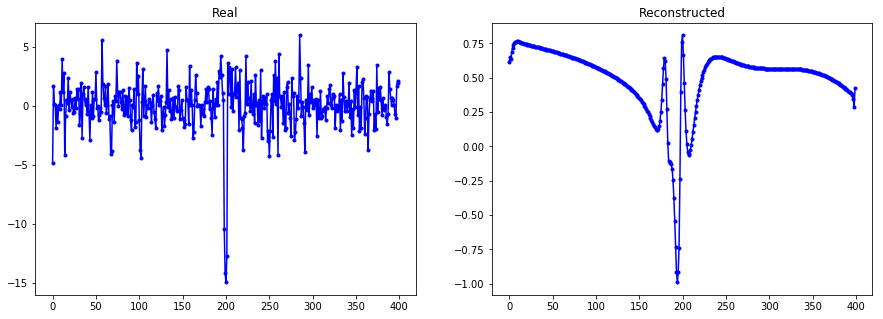

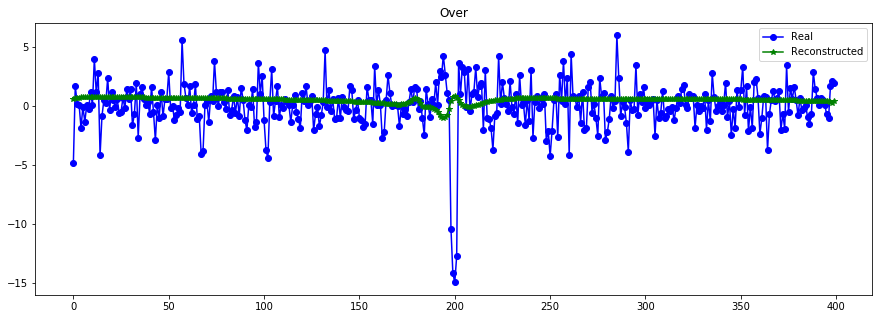

----------------------------------------------------------------


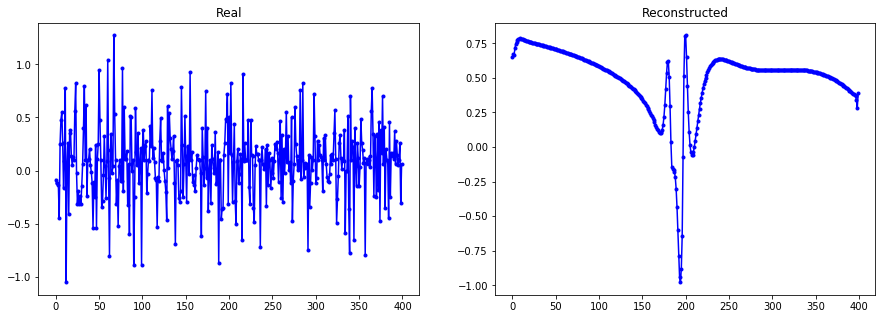

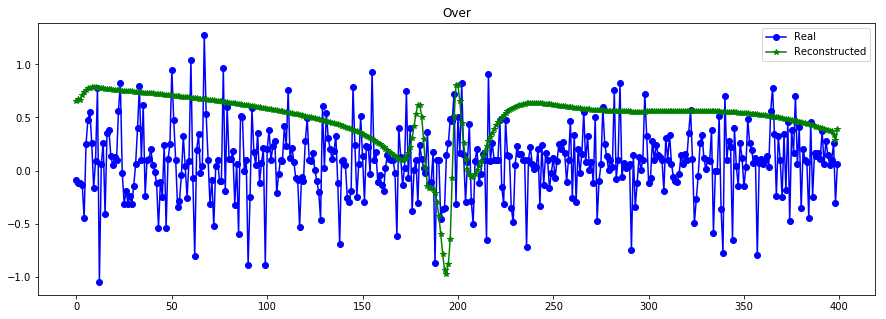

----------------------------------------------------------------


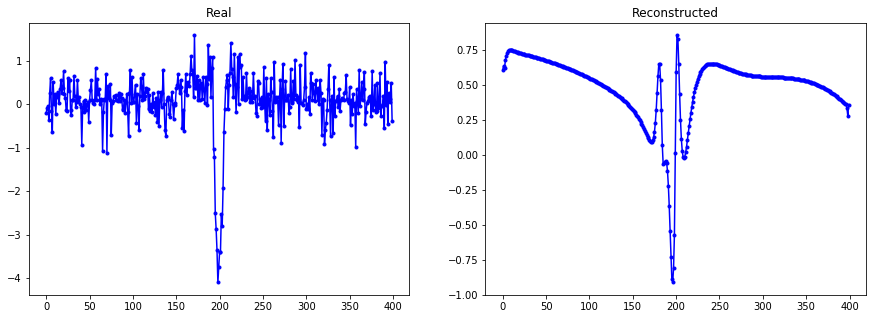

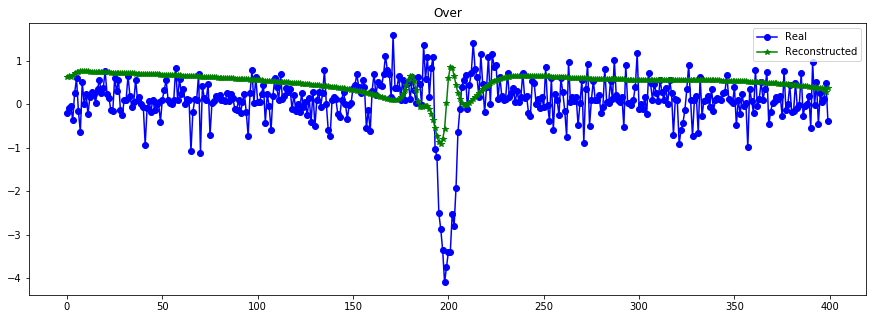

----------------------------------------------------------------


In [81]:
X_train_hat = vae.predict([X_train_t,X_train], batch_size=512)
plot_n_lc(X_train[:,:,0], X_train_hat, n= 10) ###con 200 epochs T=400 global (CURVAS TRANSITO) std global

{'whiskers': [<matplotlib.lines.Line2D at 0x2aed7f739a58>,
 'caps': [<matplotlib.lines.Line2D at 0x2aededb51a90>,
 'boxes': [<matplotlib.lines.Line2D at 0x2aededb41f98>],
 'medians': [<matplotlib.lines.Line2D at 0x2aededb51e80>],
 'fliers': [<matplotlib.lines.Line2D at 0x2aededb51f60>],
 'means': []}

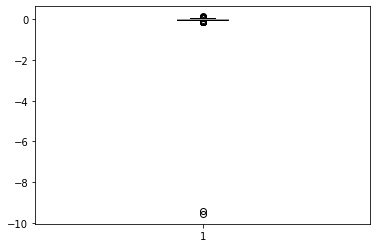

In [24]:
plt.boxplot(X_train[0,:,0])

In [ ]:
#https://towardsdatascience.com/deep-quantile-regression-c85481548b5a
#https://arxiv.org/pdf/1808.08798.pdf
def vae_titled_loss(q):
    l = 0.001 #menor peso 
    def loss(y_true, y_pred):
        e = y_true - y_pred #residuals
        return K.flatten(K.sum( K.maximum(q*e, (q-1)*e), axis=1)) + l*KL_loss(y_true,y_pred)
    return loss

In [ ]:
x_lc = Input(shape = (T, channels) , name="LC_inp")
x_t = Input(shape = (T, channels) , name ="T_inp")

x = Concatenate(axis=-1)([x_t, x_lc]) #add time encode

f1 = Bidirectional(GRU(64, return_sequences=True))(x) #bidirectional
f1 = Bidirectional(GRU(64, return_sequences=False))(f1) #bidirectional

z_mean = Dense(latent_dim,activation='linear')(f1)
z_log_var = Dense(latent_dim,activation='linear')(f1)
encoder = Model([x_t, x_lc], z_mean, name="encoder")
z = Lambda(sampling, output_shape=(latent_dim,), name='sample')([z_mean, z_log_var])
samp_encoder = Model([x_t, x_lc], z, name="encoder_sampling")

decoder_input = Input(shape=(latent_dim,))

decode = RepeatVector(T)(decoder_input)

decode = Concatenate(axis=-1)([x_t, decode]) #add time decode

decode = Bidirectional(GRU(64, return_sequences=True))(decode) #bidirectional
decode = Bidirectional(GRU(64, return_sequences=True))(decode) #bidirectional

decode = TimeDistributed(Dense(1, activation='linear'))(decode)
generator = Model([x_t, decoder_input], decode, name="generator")

# instantiate VAE model
out = generator([x_t, samp_encoder([x_t, x_lc]) ])
vae = Model([x_t, x_lc], out)

vae.compile(optimizer='adam', loss=vae_titled_loss(0.25), metrics = [KL_loss, MSE_loss])

vae.summary()

batch_size = 64
vae.fit([X_train_t,X_train], X_train, epochs=40, batch_size=batch_size, 
        validation_data=([X_test_t,X_test], X_test))

In [ ]:
X_train_hat = vae.predict([X_train_t,X_train], batch_size=512)
plot_n_lc(X_train, X_train_hat, n= 10)

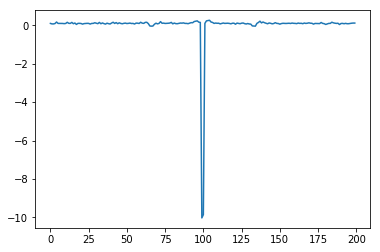

In [372]:
plt.plot(X_train[0])
plt.show()

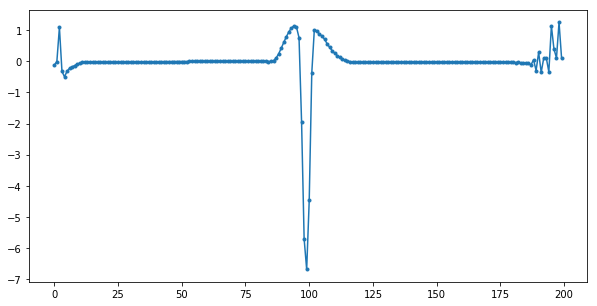

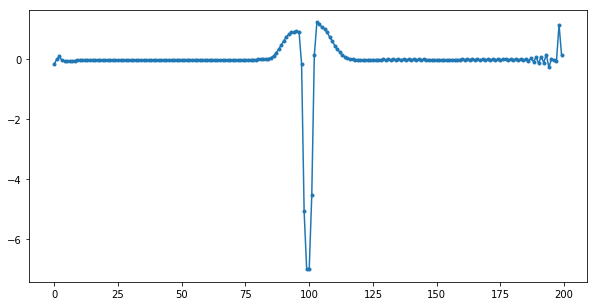

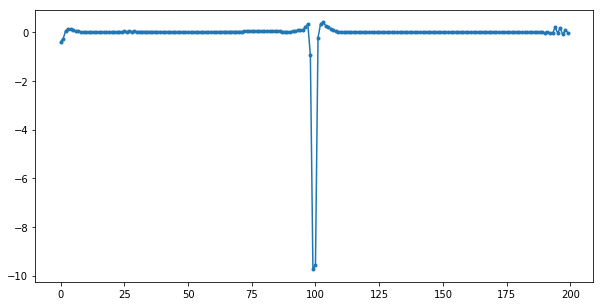

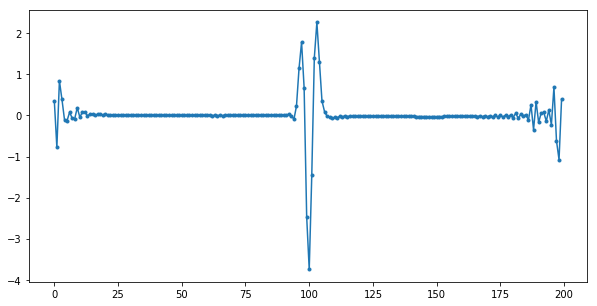

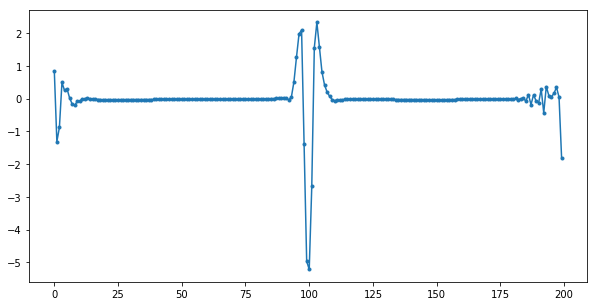

...

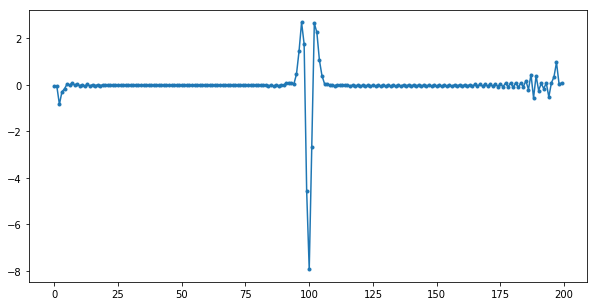

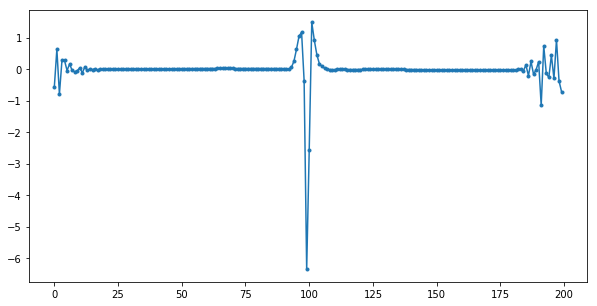

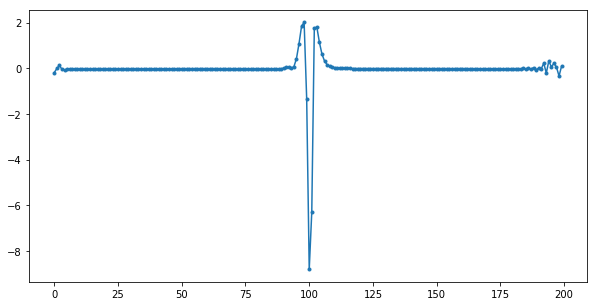

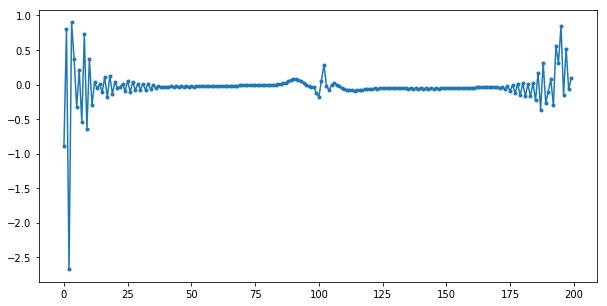

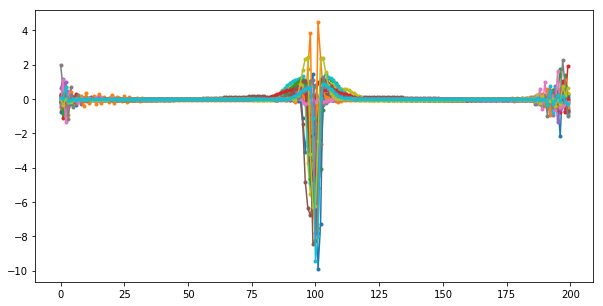

In [36]:
## generate random
n = 20

for i in range(n):
    z_sampleds = np.random.normal(0, 1, size=(1,latent_dim))
    time_i = X_train_t[0][None,:,:]
    
    x_decoded = generator.predict([time_i, z_sampleds])

    plt.figure(figsize=(10,5))
    plt.plot(x_decoded[0,:,0], '.-')
    plt.show()
    
    
plt.figure(figsize=(10,5))
for i in range(n):
    z_sampleds = np.random.normal(0, 1, size=(1,latent_dim))
    time_i = X_train_t[0][None,:,:]
    
    x_decoded = generator.predict([time_i, z_sampleds])

    plt.plot(x_decoded[0,:,0], '.-')
plt.show()

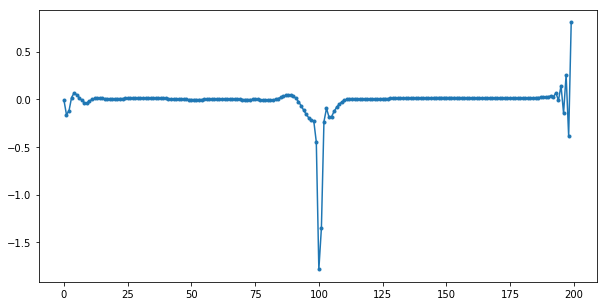

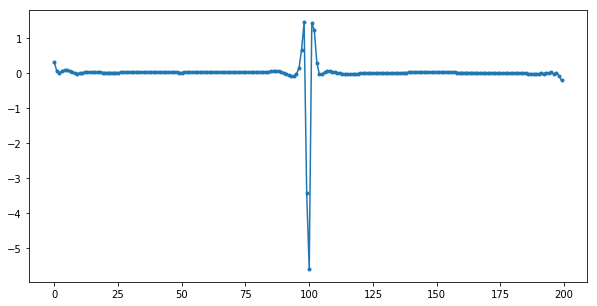

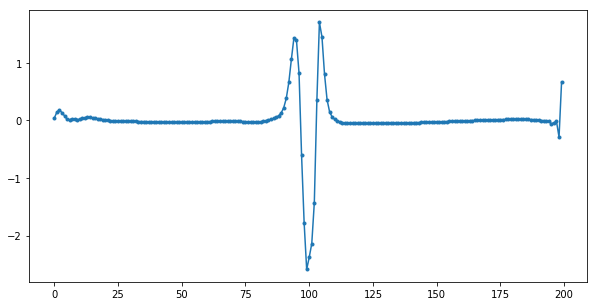

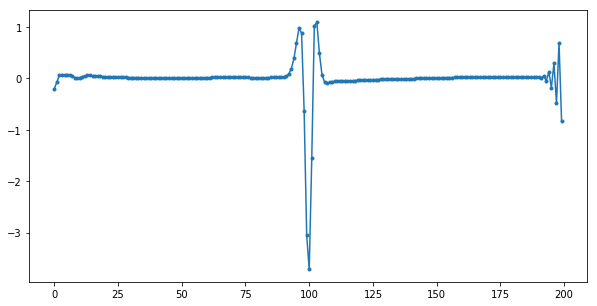

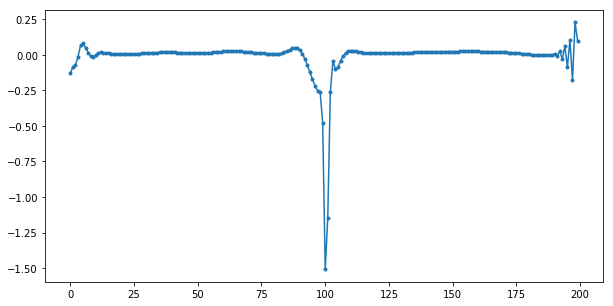

...

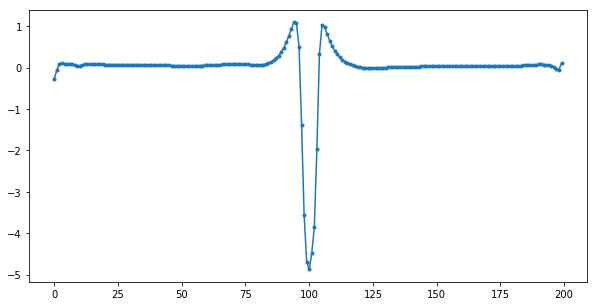

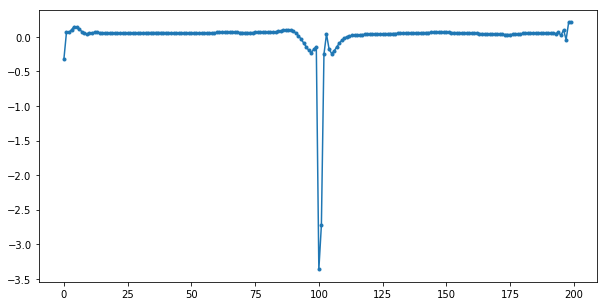

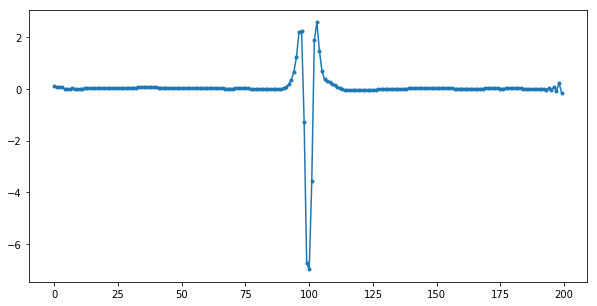

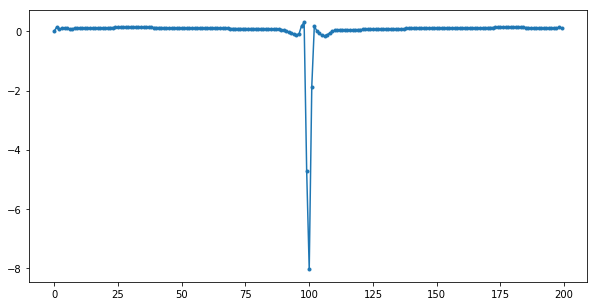

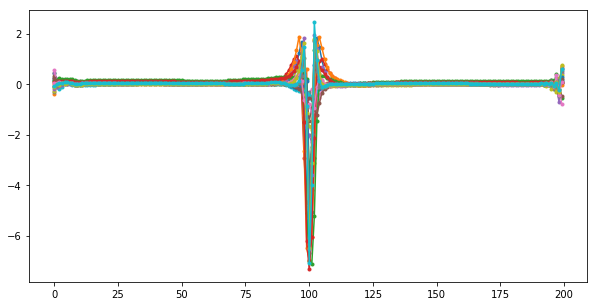

In [111]:
## generate random
n = 20

for i in range(n):
    z_sampleds = np.random.normal(0, 1, size=(1,latent_dim))
    time_i = X_test_t[0][None,:,:]
    
    x_decoded = generator.predict([time_i, z_sampleds])

    plt.figure(figsize=(10,5))
    plt.plot(x_decoded[0,:,0], '.-')
    plt.show()
    
    
plt.figure(figsize=(10,5))
for i in range(n):
    z_sampleds = np.random.normal(0, 1, size=(1,latent_dim))
    time_i = X_test_t[0][None,:,:]
    
    x_decoded = generator.predict([time_i, z_sampleds])

    plt.plot(x_decoded[0,:,0], '.-')
plt.show()

### load vae

In [20]:
!ls labsj_py
folder = "./labsj_py/"

250T_32D_0.01l_200e_VAE_glo.h5	 400T_32D_0.001l_500e_VAE_glo.h5
250T_32D_0.01l_500e_VAE_glo.h5	 400T_32D_0.01l_200e_VAE_glo.h5
400T_32D_0.001l_200e_VAE_glo.h5  400T_32D_0.1l_200e_VAE_glo.h5


In [28]:
vae.load_weights(folder+"300T_32D_0.001l_500e_VAE_glo.h5")
print(vae.evaluate([X_test_t,X_test], X_test))

671/671 [==============================] - 19s 29ms/step


[379.63844160600144, 71.05816676542052, 0.9490961039830249]